In [2]:
%matplotlib notebook
import time
import numpy as np
from scipy import optimize
from scipy.interpolate import interp1d
from scipy.fftpack import fft
import matplotlib.pyplot as plt
import pandas as pd
from pprint import pprint
import os, sys
#from time import sleep, monotonic
from tqdm.notebook import tqdm
from scipy.signal import find_peaks
from scipy.signal import savgol_filter
from scipy.optimize import curve_fit
from scipy.signal import lfilter
import matplotlib.pyplot as plt

import qcodes as qc
from qcodes import Parameter
from qcodes import initialise_or_create_database_at
from qcodes import load_or_create_experiment
from qcodes.dataset.plotting import plot_dataset, plot_by_id
from qcodes.utils.metadata import diff_param_values
from qcodes.instrument.specialized_parameters import ElapsedTimeParameter

# sys.path.append('M:\\tnw\\ns\\qt\\2D Topo\\code\\qcodes')

In [3]:
dirpath = os.getcwd()
# sample_name = dirpath.split('\\')[-2]
# wafer_name = dirpath.split('\\')[-3]
db_path = dirpath.rsplit('\\',0)[0]

In [4]:
files = []
# r=root, d=directories, f = files
for r, d, f in os.walk(db_path):
    for file in f:
        if '.db' in file:
            files.append(os.path.join(r, file))

for f in files:
    print(f)

C:\Users\chung\SynologyDrive\5. manuscript\Publications\Symmetry control PtTe2\Data\PtTe2_NbTi_B7_2024-07-02_01.db


In [5]:
db_path = os.path.join(db_path, 'PtTe2_NbTi_B7_2024-07-02_01.db')
initialise_or_create_database_at(db_path)

# List experiments

In [1]:
qc.experiments()

NameError: name 'qc' is not defined

# Loading data

In [ ]:
runid=265
dataset = qc.load_by_id(runid)

In [ ]:
V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
# Keithley2 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
# Bx_field =dataset.get_parameter_data()['meas_voltage_K2']['x_field']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
# Bz_field =dataset.get_parameter_data()['meas_voltage_K2']['z_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

In [ ]:
# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N
# NVg=s//N
print('size of the field array', NB)
# print('size of the gate array', NVg)
print('size of the current', NI)

In [ ]:
R_DC1=None
I=None

In [ ]:
#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
# R_DC1 = Keithley2/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
# R_DC1 = R_DC1.reshape(NVg,NI)
# R_DC2 = Keithley2/(I[2]-I[1])
# R_DC2 = R_DC2.reshape(NB,NI)
# R_DC2 = R_DC2.reshape(NVg,NI)
# R_DC2 = np.diff(R_DC2, axis = 1)
# R_DC1=R_DC1.transpose()
I=I.reshape(NB,NI)
# I=I.reshape(NVg,NI)
# I=I.transpose()
# Bx_field =Bx_field.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)
# Keithley2 = Keithley2.reshape(NB,NI)
# Vg = Vg.reshape(NVg,NI)
# crymag_field=crymag_field.transpose()

In [ ]:
np.savetxt('I_Dev011_Run50.csv', np.transpose(I), fmt='%s', delimiter=',')
np.savetxt('By_Dev011_Run50.csv', np.transpose(By_field), fmt='%s', delimiter=',')
np.savetxt('V_Dev011_Run50.csv', np.transpose(Keithley1), fmt='%s', delimiter=',')

# Accessing snapshot

In [ ]:
dataset = qc.load_by_id(23)
pprint(dataset.snapshot['station']['parameters'])

In [ ]:
pprint(diff_param_values(qc.load_by_id(12).snapshot, qc.load_by_id(17).snapshot).changed)

# Accessing raw data for analysis and plotting

In [ ]:
dataset = qc.load_by_id(8)
cmap = plt.get_cmap('hot')
plot_dataset(dataset, cmap = cmap)
plt.title('Fraunhofer')
plt.xlabel('By field (mT)')
plt.ylabel('Current ( A)')

In [ ]:
#junyi modified
pd_test = dataset.to_pandas_dataframe().reset_index()

In [ ]:
pd_1dtest = pd_test[pd_test["y_field"]==-0.005]

In [ ]:
plt.plot(pd_1dtest['appl_current'], pd_1dtest['meas_voltage_K1'])
plt.show()

In [ ]:
%matplotlib inline
print(pd_test["y_field"].unique())

In [ ]:
dataset.get_parameter_data()['meas_voltage_Lockin1'].keys()

In [ ]:
N_times = np.size(np.unique(time))
N_current = np.size(np.unique(current))
print(N_times, N_current)

In [ ]:
voltage = voltage.reshape(N_times, N_current)
current = current.reshape(N_times, N_current)
time = time.reshape(N_times, N_current)

In [ ]:
current[1]

In [ ]:
time[:,1]


In [ ]:
fig, ax = plt.subplots()
cmap = plt.get_cmap('hot')
im = ax.pcolormesh(time, current, voltage, cmap = cmap)
fig.colorbar(im, ax=ax)
#plt.grid()
plt.show()

In [ ]:
dif_voltage = np.diff(voltage, axis = 1)
dif_current = np.diff(current, axis = 1)
dif_resistance = dif_voltage/dif_current

In [ ]:
fig, ax = plt.subplots()

cmap = plt.get_cmap('hot')
im = ax.pcolormesh(time, current, dif_resistance, cmap = cmap)
fig.colorbar(im,ax=ax)

plt.show()

In [ ]:
from scipy.ndimage import gaussian_filter

In [ ]:
dif_resistance_filt = gaussian_filter( dif_resistance, sigma=(0.1,4))
fig, ax = plt.subplots()

cmap = plt.get_cmap('hot')
im = ax.pcolormesh(time, current, dif_resistance_filt, cmap = cmap)
fig.colorbar(im,ax=ax)

plt.show()

In [ ]:
def export_as_dat(data_id, filename):
    dataset = qc.load_by_id(data_id)

    all_keys = []
    all_vals = {}
    x_key = None
    y_key = None

    for key in dataset.get_parameter_data().keys():
        nested_set = dataset.get_parameter_data()[key]
        for i, nested_key in enumerate(nested_set.keys()):
            if i == 1:
                x_key = nested_key
            if i == 2:
                y_key = x_key
                x_key = nested_key
            if nested_key not in all_keys:
                all_keys.append(nested_key)
                all_vals[nested_key] = dataset.get_parameter_data()[key][nested_key]

    Nx = np.size(np.unique(all_vals[x_key]))
    if y_key:
        Ny = np.size(np.unique(all_vals[y_key]))
    else:
        Ny = 1

    #print(x_key, y_key)

    #print(Nx, Ny)

    all_values_ordered = {}
    all_values_ordered[x_key] = all_vals[x_key]
    all_vals.pop(x_key)
    if y_key:
        all_values_ordered[y_key] = all_vals[y_key]
        all_vals.pop(y_key)
    for key in all_vals.keys():
        all_values_ordered[key] = all_vals[key]

    f=open(filename,'a')
    for y_ind in range(Ny):
        #print(y_ind)
        np.savetxt(f, np.stack(list(all_values_ordered.values()), axis=-1)[y_ind*Nx:(y_ind+1)*Nx, :], delimiter = '\t')
        f.writelines(os.linesep)
    f.close()

In [ ]:
export_as_dat(56, 'J6_1_56.dat')

## JJ

In [ ]:
run=117
dataset = qc.load_by_id(run)
cmap = plt.get_cmap('hot')
plot_dataset(dataset, cmap = cmap)
plt.title('')
plt.xlabel('B field (T)')
plt.ylabel('Bias (V)')

In [ ]:
Vg = dataset.snapshot['station']['parameters']['appl_TG7']['raw_value']
print(Vg)

# L 02 JJ2

## Run 210 and 211 for JDE at Bx=0

In [8]:
runid=210
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [9]:
By_210=By_field
I_210=I
V_210=V
R_210=R_DC1

np.savetxt('L01_210_By.csv', (By_210), fmt='%s', delimiter=',')
np.savetxt('L01_210_I.csv', (I_210), fmt='%s', delimiter=',')
np.savetxt('L01_210_V.csv', (V_210), fmt='%s', delimiter=',')
np.savetxt('L01_210_R.csv', (R_210), fmt='%s', delimiter=',')

In [5]:
By_210=np.loadtxt('L01_210_By.csv', delimiter=",")
I_210=np.loadtxt('L01_210_I.csv', delimiter=",")
V_210=np.loadtxt('L01_210_V.csv', delimiter=",")
R_210=np.loadtxt('L01_210_R.csv', delimiter=",")
Is_210=np.loadtxt('Is_210.csv', delimiter=",")
Ir_210=np.loadtxt('Ir_210.csv', delimiter=",")

In [33]:
saiz=np.shape(V_210)
# print(saiz)
Is_210=np.zeros(saiz[0])
Ir_210=np.zeros(saiz[0])
fV_210=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_210)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_210[i,20:40])
        if V_210[i,j]-DCoff > 0.5e-6:
            Is_210[i]=I_210[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_210[i,20:40])
        if -V_210[i,j]-DCoff < 0.5e-6:
            Ir_210[i]=I_210[i,j]
            break


<IPython.core.display.Javascript object>


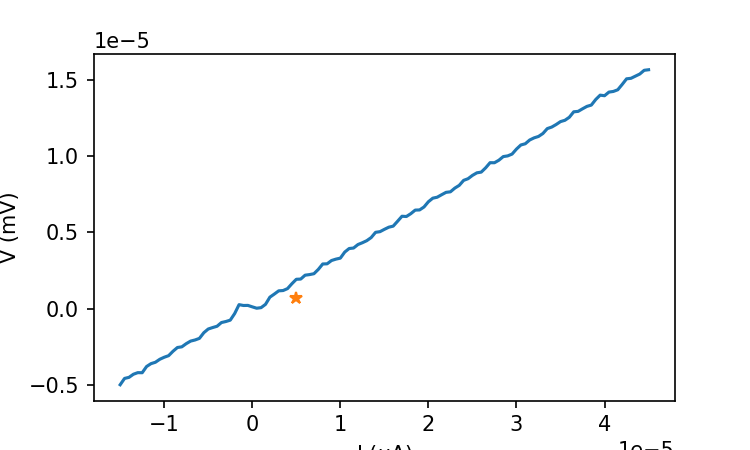

6.58493815e-07


In [23]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_210[150,20:40])
plt.plot(I_210[10,:],V_210[10,:]-DCoff)
# plt.plot(V_210[150,:])
plt.plot(I_210[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


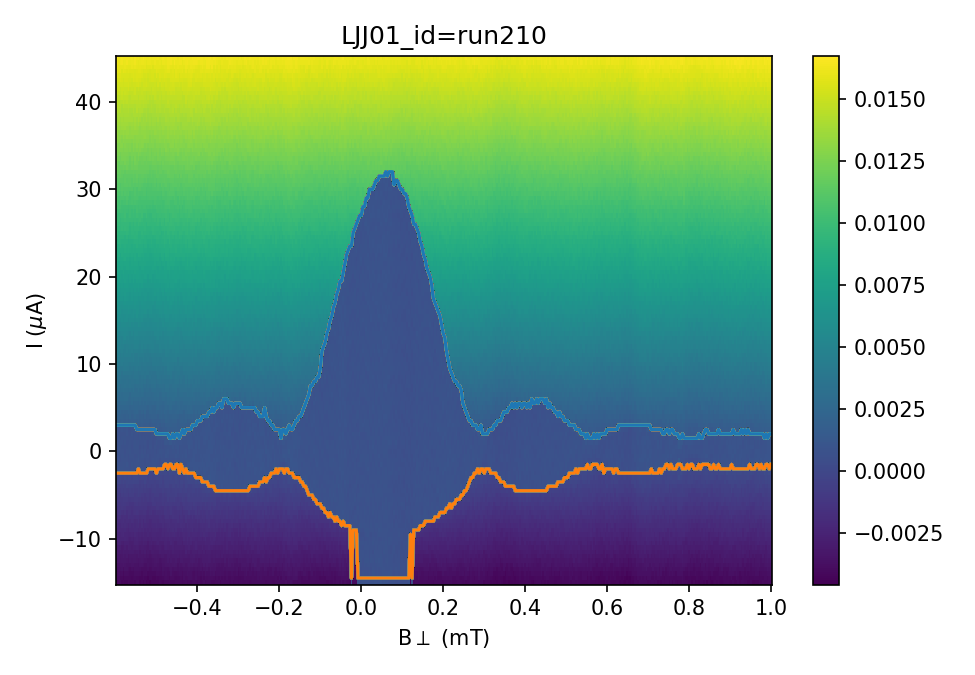

In [34]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_210[Arange:Brange,:]/1e-3, I_210[Arange:Brange,:]/1e-6, V_210[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run210')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_210[Arange:Brange,:]/1e-3,Is_210[Arange:Brange]/1e-6)
plt.plot(By_210[Arange:Brange,:]/1e-3,Ir_210[Arange:Brange]/1e-6)

np.savetxt('Is_210.csv', (Is_210), fmt='%s', delimiter=',')
np.savetxt('Ir_210.csv', (Ir_210), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

In [40]:
runid=211
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [41]:
By_211=By_field
I_211=I
V_211=V
R_211=R_DC1

np.savetxt('L01_211_By.csv', (By_211), fmt='%s', delimiter=',')
np.savetxt('L01_211_I.csv', (I_211), fmt='%s', delimiter=',')
np.savetxt('L01_211_V.csv', (V_211), fmt='%s', delimiter=',')
np.savetxt('L01_211_R.csv', (R_211), fmt='%s', delimiter=',')

In [6]:
By_211=np.loadtxt('L01_211_By.csv', delimiter=",")
I_211=np.loadtxt('L01_211_I.csv', delimiter=",")
V_211=np.loadtxt('L01_211_V.csv', delimiter=",")
R_211=np.loadtxt('L01_211_R.csv', delimiter=",")
Is_211=np.loadtxt('Is_211.csv', delimiter=",")
Ir_211=np.loadtxt('Ir_211.csv', delimiter=",")

<IPython.core.display.Javascript object>


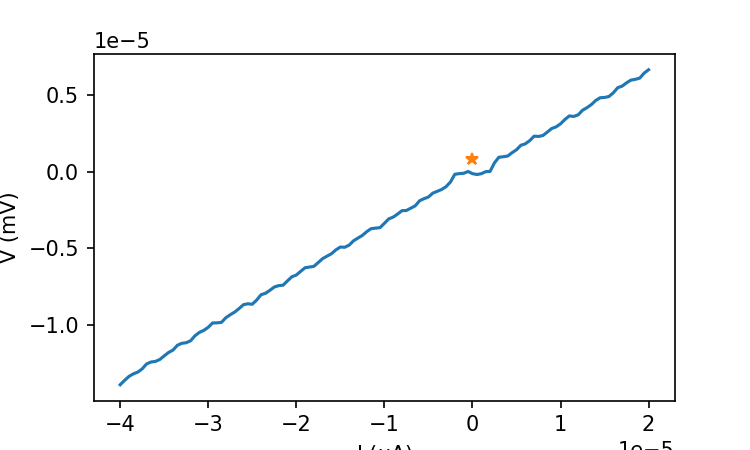

8.247260350000001e-07


In [58]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_211[110,30:50])
plt.plot(I_211[110,:],V_211[110,:]-DCoff)
# plt.plot(V_211[150,:])
plt.plot(I_211[110,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [65]:
saiz=np.shape(V_211)
# print(saiz)
Is_211=np.zeros(saiz[0])
Ir_211=np.zeros(saiz[0])
fV_211=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_211)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_211[i,30:50])
        if V_211[i,j]-DCoff < 0.5e-6:
            Is_211[i]=I_211[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_211[i,30:50])
        if -V_211[i,j]-DCoff > 5e-7:
            Ir_211[i]=I_211[i,j]
            break


<IPython.core.display.Javascript object>


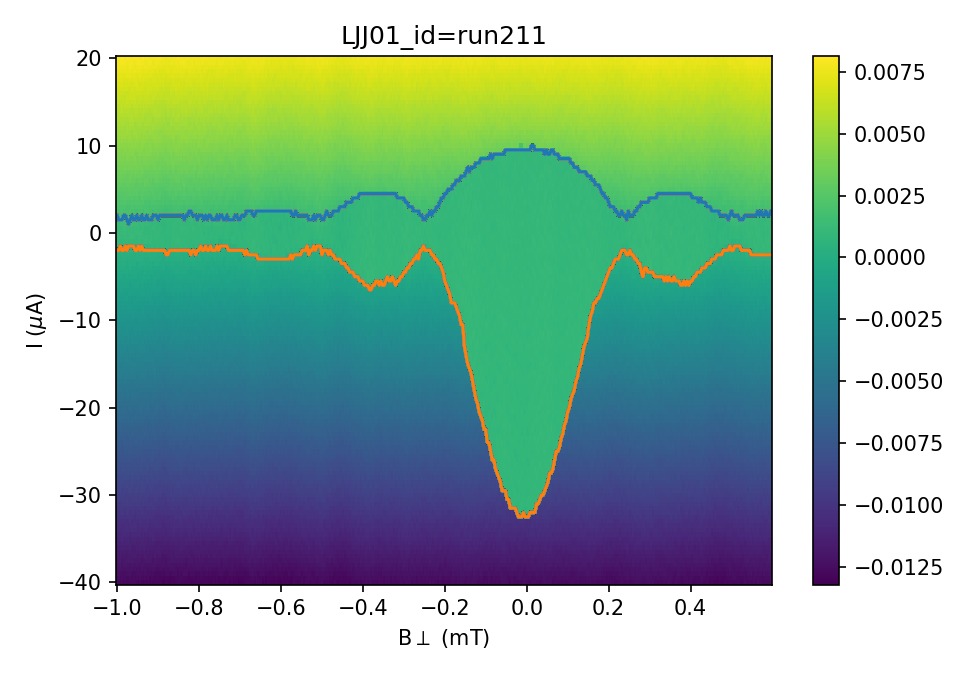

In [66]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_211[Arange:Brange,:]/1e-3, I_211[Arange:Brange,:]/1e-6, V_211[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run211')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_211[Arange:Brange,:]/1e-3,Is_211[Arange:Brange]/1e-6)
plt.plot(By_211[Arange:Brange,:]/1e-3,Ir_211[Arange:Brange]/1e-6)

np.savetxt('Is_211.csv', (Is_211), fmt='%s', delimiter=',')
np.savetxt('Ir_211.csv', (Ir_211), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()


<IPython.core.display.Javascript object>


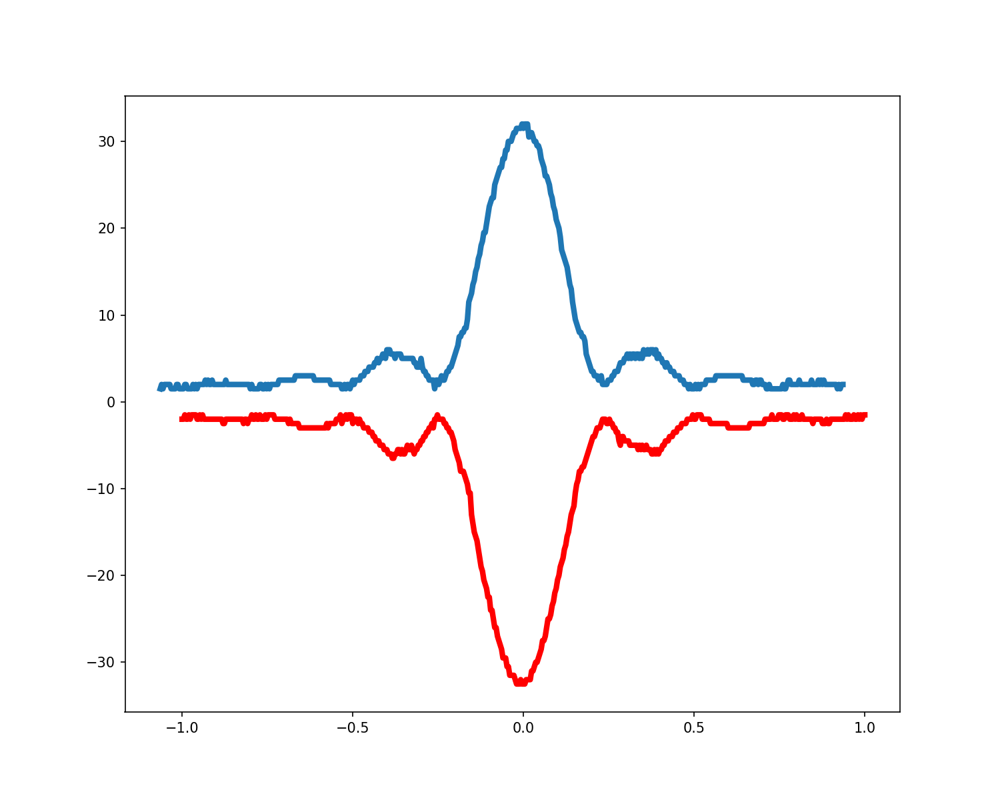

In [15]:
By_211=np.loadtxt('L01_211_By.csv', delimiter=",")
By_210=np.loadtxt('L01_210_By.csv', delimiter=",")
Is_210=np.loadtxt('Is_210.csv', delimiter=",")
Ir_211=np.loadtxt('Ir_211.csv', delimiter=",")
plt.figure(figsize=(10, 8))
plt.plot((By_210[:,1]-0.064e-3)/1e-3,Is_210[:]/1e-6, linewidth=4)
# plt.plot(By_211[:,1]/1e-3,np.abs(Ir_211[:]/1e-6),'r')
plt.plot(By_211[:,1]/1e-3,Ir_211[:]/1e-6,'r', linewidth=4)

<IPython.core.display.Javascript object>


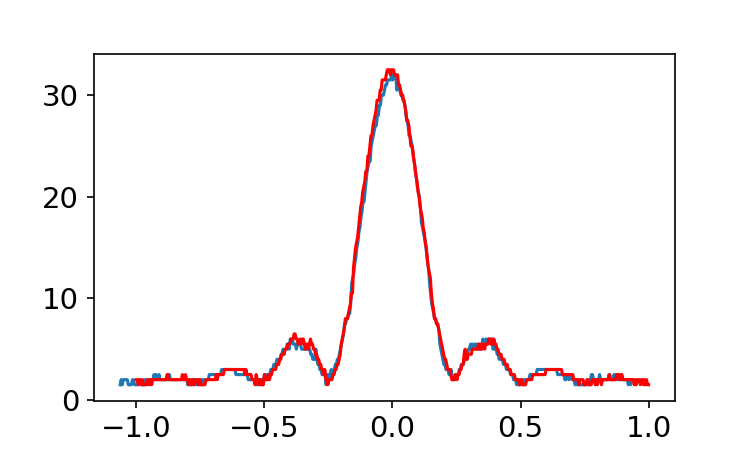

In [63]:
plt.figure(figsize=(5, 3))
plt.plot((By_210[:,1]-0.063e-3)/1e-3,Is_210[:]/1e-6)
plt.plot(By_211[:,1]/1e-3,np.abs(Ir_211[:]/1e-6),'r')
# plt.plot(By_211[:,1]/1e-3,Ir_211[:]/1e-6,'r')

<IPython.core.display.Javascript object>


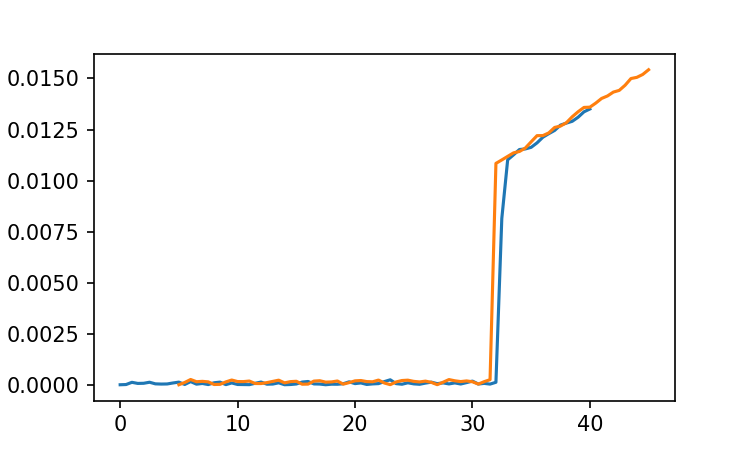

In [62]:
By_210=np.loadtxt('L01_210_By.csv', delimiter=",")
By_211=np.loadtxt('L01_211_By.csv', delimiter=",")
Is_210=np.loadtxt('Is_210.csv', delimiter=",")
Ir_211=np.loadtxt('Ir_211.csv', delimiter=",")
plt.figure(figsize=(5, 3))
x=np.linspace(0,500,501)
# plt.plot((By_210[:,1]-0.064e-3)/1e-3,Is_210[:]/1e-6)
# plt.plot(By_211[:,1]/1e-3,np.abs(Ir_211[:]/1e-6),'-r')
# plt.plot(np.flipud((x-16)*4e-6-By_210[0,1])/1e-3,Is_210[:]/1e-6)
# plt.plot((x*4e-6+By_211[0,1])/1e-3,np.abs(Ir_211[:]/1e-6),'-b')
# plt.plot(np.abs(Ir_211[:]/1e-6),'-b')

plt.plot(-I_211[247,40:121]/1e-6,np.abs(V_211[247,40:121]-V_211[247,40])/1e-3)
plt.plot((I_210[231,40:121])/1e-6,np.abs(V_210[231,40:121]-V_210[231,40])/1e-3)

## Run 208 and 209 for JDE at Bx=-5mT

In [5]:
runid=208
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [6]:
By_208=By_field
I_208=I
V_208=V
R_208=R_DC1

np.savetxt('L01_208_By.csv', (By_208), fmt='%s', delimiter=',')
np.savetxt('L01_208_I.csv', (I_208), fmt='%s', delimiter=',')
np.savetxt('L01_208_V.csv', (V_208), fmt='%s', delimiter=',')
np.savetxt('L01_208_R.csv', (R_208), fmt='%s', delimiter=',')

In [6]:
By_208=np.loadtxt('L01_208_By.csv', delimiter=",")
I_208=np.loadtxt('L01_208_I.csv', delimiter=",")
V_208=np.loadtxt('L01_208_V.csv', delimiter=",")
R_208=np.loadtxt('L01_208_R.csv', delimiter=",")
Is_208=np.loadtxt('Is_208.csv', delimiter=",")
Ir_208=np.loadtxt('Ir_208.csv', delimiter=",")

<IPython.core.display.Javascript object>


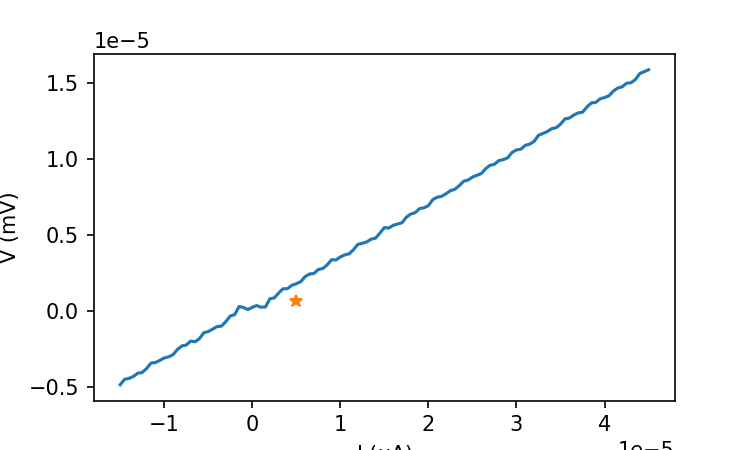

6.5929476e-07


In [18]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_208[10,25:30])
plt.plot(I_208[10,:],V_208[10,:]-DCoff)
# plt.plot(V_208[0,:])
plt.plot(I_208[10,40], DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [35]:
saiz=np.shape(V_208)
# print(saiz)
Is_208=np.zeros(saiz[0])
Ir_208=np.zeros(saiz[0])
fV_208=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_208)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_208[i,25:30])
        if V_208[i,j]-DCoff > 8e-7:
            Is_208[i]=I_208[i,j]
            break

    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_208[i,25:30])
        if -V_208[i,j]-DCoff < 1e-7:
            Ir_208[i]=I_208[i,j]
            break


<IPython.core.display.Javascript object>


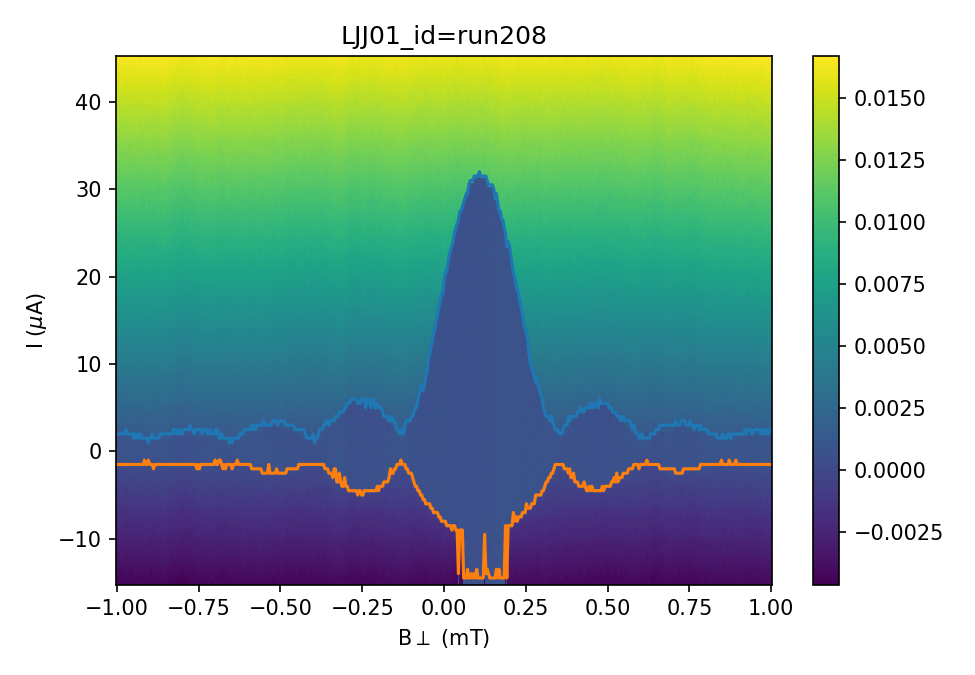

In [36]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_208[Arange:Brange,:]/1e-3, I_208[Arange:Brange,:]/1e-6, V_208[Arange:Brange,:]/1e-3, cmap = 'viridis')
im = ax0.pcolormesh(By_208[:,:]/1e-3, I_208[:,:]/1e-6, V_208[:,:]/1e-3, cmap = 'viridis')
# im = ax0.pcolormesh(V_208[:,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run208')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_208[:,1]/1e-3,Is_208[:]/1e-6)
plt.plot(By_208[:,1]/1e-3,Ir_208[:]/1e-6)

np.savetxt('Is_208.csv', (Is_208), fmt='%s', delimiter=',')
np.savetxt('Ir_208.csv', (Ir_208), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

In [37]:
runid=209
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [38]:
By_209=By_field
I_209=I
V_209=V
R_209=R_DC1

np.savetxt('L01_209_By.csv', (By_209), fmt='%s', delimiter=',')
np.savetxt('L01_209_I.csv', (I_209), fmt='%s', delimiter=',')
np.savetxt('L01_209_V.csv', (V_209), fmt='%s', delimiter=',')
np.savetxt('L01_209_R.csv', (R_209), fmt='%s', delimiter=',')

In [ ]:
By_209=np.loadtxt('L01_209_By.csv', delimiter=",")
I_209=np.loadtxt('L01_209_I.csv', delimiter=",")
V_209=np.loadtxt('L01_209_V.csv', delimiter=",")
R_209=np.loadtxt('L01_209_R.csv', delimiter=",")
# Is_209=np.loadtxt('Is_209.csv', delimiter=",")
# Ir_209=np.loadtxt('Ir_209.csv', delimiter=",")

<IPython.core.display.Javascript object>


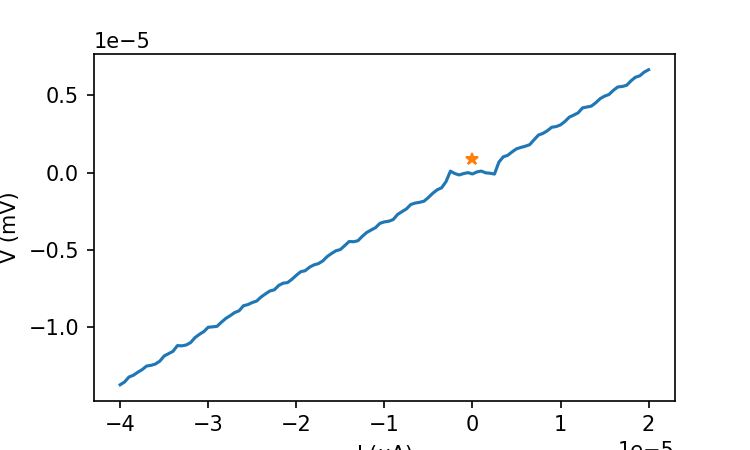

8.7759978e-07


In [42]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_209[150,35:40])
plt.plot(I_209[150,:],V_209[150,:]-DCoff)
# plt.plot(V_209[0,:])
plt.plot(I_209[10,40], DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [43]:
saiz=np.shape(V_209)
# print(saiz)
Is_209=np.zeros(saiz[0])
Ir_209=np.zeros(saiz[0])
fV_209=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_209)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_209[i,35:40])
        if V_209[i,j]-DCoff < 5e-7:
            Is_209[i]=I_209[i,j]
            break

    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_209[i,35:40])
        if -V_209[i,j]-DCoff > 5e-7:
            Ir_209[i]=I_209[i,j]
            break


<IPython.core.display.Javascript object>


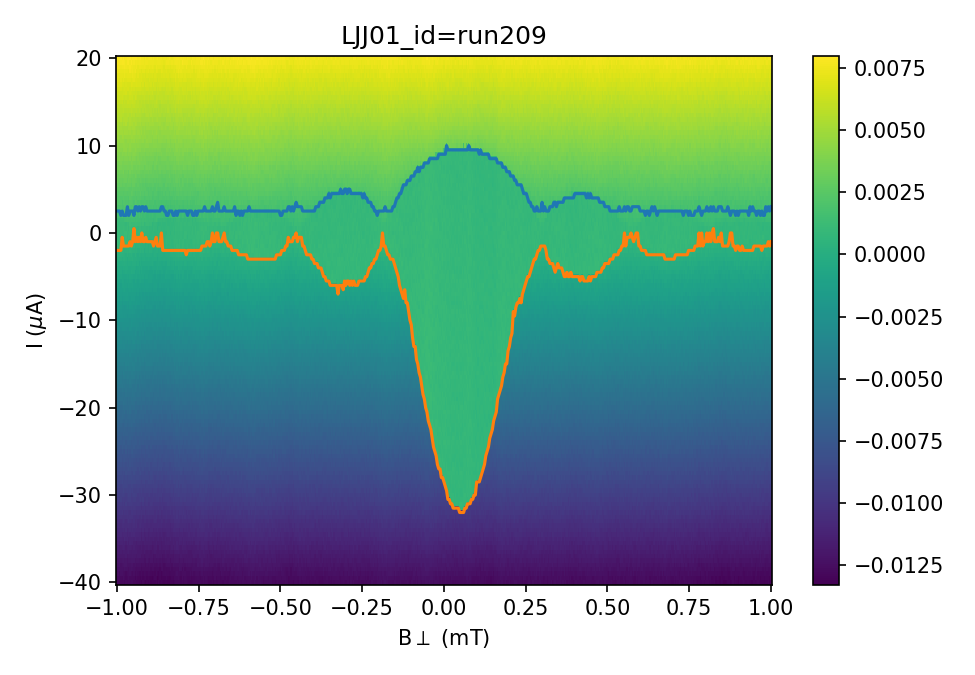

In [45]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_209[Arange:Brange,:]/1e-3, I_209[Arange:Brange,:]/1e-6, V_209[Arange:Brange,:]/1e-3, cmap = 'viridis')
im = ax0.pcolormesh(By_209[:,:]/1e-3, I_209[:,:]/1e-6, V_209[:,:]/1e-3, cmap = 'viridis')
# im = ax0.pcolormesh(V_209[:,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run209')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_209[:,1]/1e-3,Is_209[:]/1e-6)
plt.plot(By_209[:,1]/1e-3,Ir_209[:]/1e-6)

np.savetxt('Is_209.csv', (Is_209), fmt='%s', delimiter=',')
np.savetxt('Ir_209.csv', (Ir_209), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


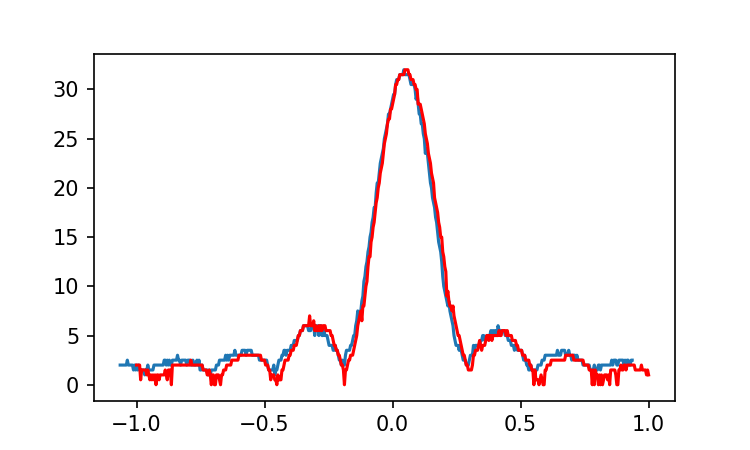

In [81]:
By_209=np.loadtxt('L01_209_By.csv', delimiter=",")
By_208=np.loadtxt('L01_208_By.csv', delimiter=",")
Is_209=np.loadtxt('Is_209.csv', delimiter=",")
Ir_208=np.loadtxt('Ir_208.csv', delimiter=",")
plt.figure(figsize=(5, 3))
plt.plot((By_208[:,1]-0.064e-3)/1e-3,Is_208[:]/1e-6)
plt.plot((By_209[:,1])/1e-3,np.abs(Ir_209[:]/1e-6),'r')

## Run 206 and 207 for JDE Bx=-10 mT

In [60]:
runid=206
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [61]:
By_206=By_field
I_206=I
V_206=V
R_206=R_DC1

np.savetxt('L01_206_By.csv', (By_206), fmt='%s', delimiter=',')
np.savetxt('L01_206_I.csv', (I_206), fmt='%s', delimiter=',')
np.savetxt('L01_206_V.csv', (V_206), fmt='%s', delimiter=',')
np.savetxt('L01_206_R.csv', (R_206), fmt='%s', delimiter=',')

In [7]:
By_206=np.loadtxt('L01_206_By.csv', delimiter=",")
I_206=np.loadtxt('L01_206_I.csv', delimiter=",")
V_206=np.loadtxt('L01_206_V.csv', delimiter=",")
R_206=np.loadtxt('L01_206_R.csv', delimiter=",")
Is_206=np.loadtxt('Is_206.csv', delimiter=",")
Ir_206=np.loadtxt('Ir_206.csv', delimiter=",")

<IPython.core.display.Javascript object>


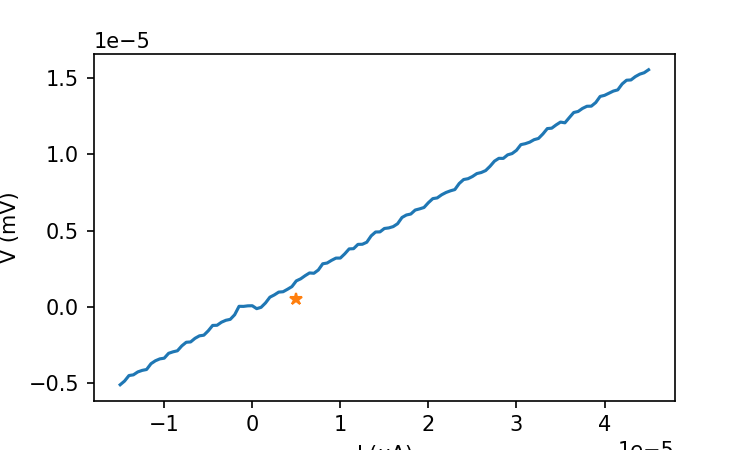

4.910613000000001e-07


In [63]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_206[10,27:33])
plt.plot(I_206[10,:],V_206[10,:]-DCoff)
# plt.plot(V_206[0,:])
plt.plot(I_206[10,40], DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [69]:
saiz=np.shape(V_206)
# print(saiz)
Is_206=np.zeros(saiz[0])
Ir_206=np.zeros(saiz[0])
fV_206=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_206)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_206[i,27:32])
        if V_206[i,j]-DCoff > 5e-7:
            Is_206[i]=I_206[i,j]
            break

    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_206[i,27:32])
        if -V_206[i,j]-DCoff < 3e-7:
            Ir_206[i]=I_206[i,j]
            break


<IPython.core.display.Javascript object>


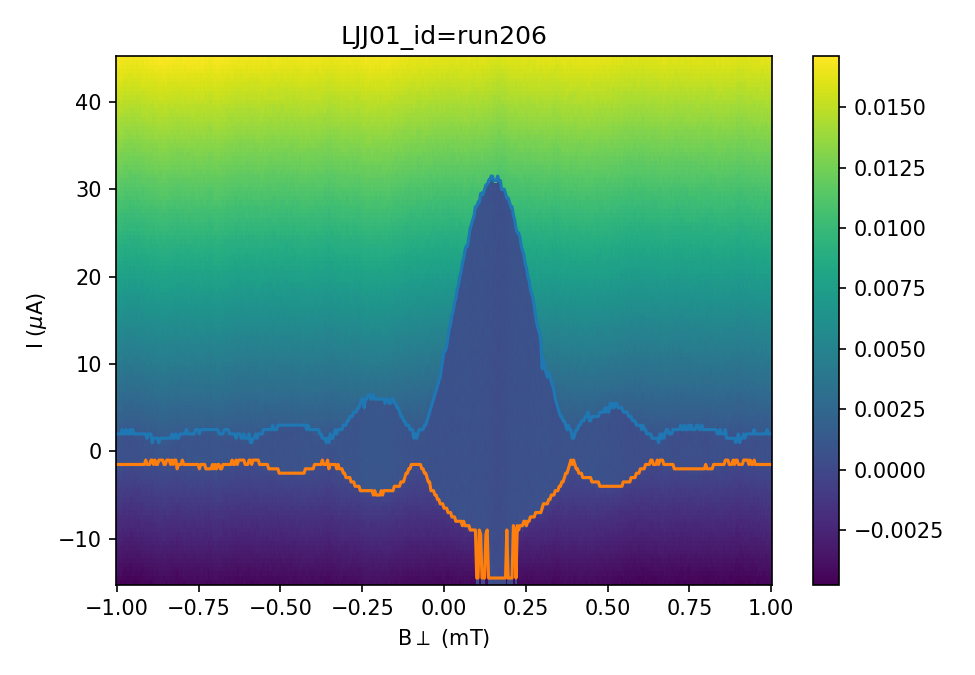

In [70]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_206[Arange:Brange,:]/1e-3, I_206[Arange:Brange,:]/1e-6, V_206[Arange:Brange,:]/1e-3, cmap = 'viridis')
im = ax0.pcolormesh(By_206[:,:]/1e-3, I_206[:,:]/1e-6, V_206[:,:]/1e-3, cmap = 'viridis')
# im = ax0.pcolormesh(V_206[:,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run206')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_206[:,1]/1e-3,Is_206[:]/1e-6)
plt.plot(By_206[:,1]/1e-3,Ir_206[:]/1e-6)

np.savetxt('Is_206.csv', (Is_206), fmt='%s', delimiter=',')
np.savetxt('Ir_206.csv', (Ir_206), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

In [71]:
runid=207
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [72]:
By_207=By_field
I_207=I
V_207=V
R_207=R_DC1

np.savetxt('L01_207_By.csv', (By_207), fmt='%s', delimiter=',')
np.savetxt('L01_207_I.csv', (I_207), fmt='%s', delimiter=',')
np.savetxt('L01_207_V.csv', (V_207), fmt='%s', delimiter=',')
np.savetxt('L01_207_R.csv', (R_207), fmt='%s', delimiter=',')

In [ ]:
By_207=np.loadtxt('L01_207_By.csv', delimiter=",")
I_207=np.loadtxt('L01_207_I.csv', delimiter=",")
V_207=np.loadtxt('L01_207_V.csv', delimiter=",")
R_207=np.loadtxt('L01_207_R.csv', delimiter=",")
# Is_209=np.loadtxt('Is_209.csv', delimiter=",")
# Ir_209=np.loadtxt('Ir_209.csv', delimiter=",")

<IPython.core.display.Javascript object>


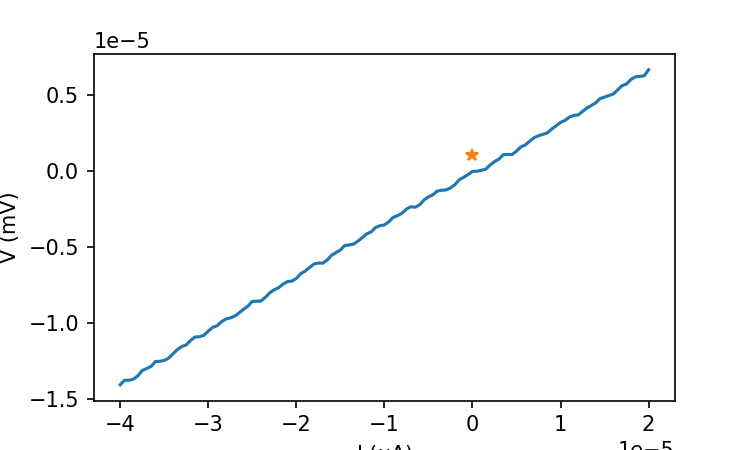

1.10695156e-06


In [76]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_207[150,37:42])
plt.plot(I_207[150,:],V_207[150,:]-DCoff)
# plt.plot(V_207[0,:])
plt.plot(I_207[10,40], DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [77]:
saiz=np.shape(V_207)
# print(saiz)
Is_207=np.zeros(saiz[0])
Ir_207=np.zeros(saiz[0])
fV_207=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_207)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_207[i,37:42])
        if V_207[i,j]-DCoff < 5e-7:
            Is_207[i]=I_207[i,j]
            break

    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_207[i,37:42])
        if -V_207[i,j]-DCoff > 5e-7:
            Ir_207[i]=I_207[i,j]
            break


<IPython.core.display.Javascript object>


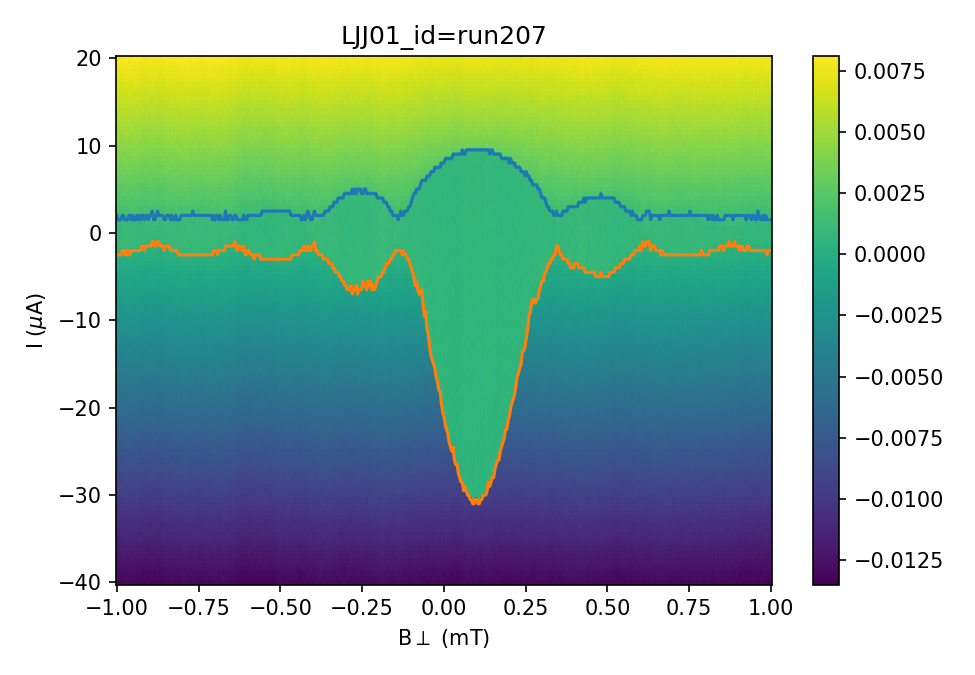

In [78]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_207[Arange:Brange,:]/1e-3, I_207[Arange:Brange,:]/1e-6, V_207[Arange:Brange,:]/1e-3, cmap = 'viridis')
im = ax0.pcolormesh(By_207[:,:]/1e-3, I_207[:,:]/1e-6, V_207[:,:]/1e-3, cmap = 'viridis')
# im = ax0.pcolormesh(V_207[:,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run207')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_207[:,1]/1e-3,Is_207[:]/1e-6)
plt.plot(By_207[:,1]/1e-3,Ir_207[:]/1e-6)

np.savetxt('Is_207.csv', (Is_207), fmt='%s', delimiter=',')
np.savetxt('Ir_207.csv', (Ir_207), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


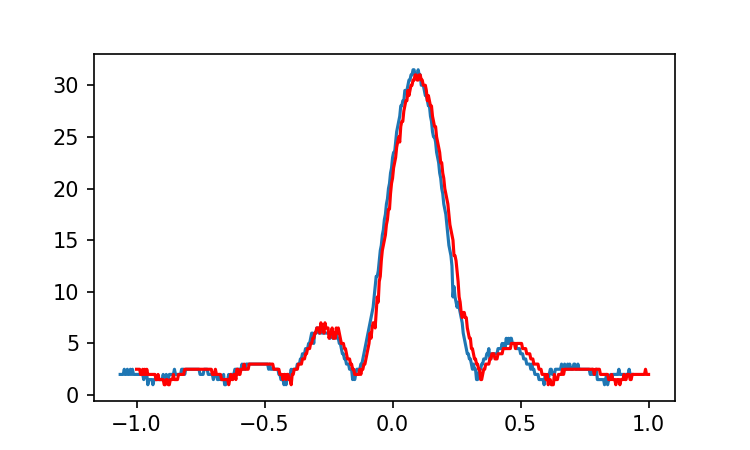

In [80]:
By_207=np.loadtxt('L01_207_By.csv', delimiter=",")
By_206=np.loadtxt('L01_206_By.csv', delimiter=",")
Is_207=np.loadtxt('Is_207.csv', delimiter=",")
Ir_206=np.loadtxt('Ir_206.csv', delimiter=",")
plt.figure(figsize=(5, 3))
plt.plot((By_206[:,1]-0.064e-3)/1e-3,Is_206[:]/1e-6)
plt.plot((By_207[:,1])/1e-3,np.abs(Ir_207[:]/1e-6),'r')

## Run 220 and 221 for JDE at Bx=-20 mT

In [11]:
runid=220
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [12]:
By_220=By_field
I_220=I
V_220=V
R_220=R_DC1

np.savetxt('L01_220_By.csv', (By_220), fmt='%s', delimiter=',')
np.savetxt('L01_220_I.csv', (I_220), fmt='%s', delimiter=',')
np.savetxt('L01_220_V.csv', (V_220), fmt='%s', delimiter=',')
np.savetxt('L01_220_R.csv', (R_220), fmt='%s', delimiter=',')

In [7]:
By_220=np.loadtxt('L01_220_By.csv', delimiter=",")
I_220=np.loadtxt('L01_220_I.csv', delimiter=",")
V_220=np.loadtxt('L01_220_V.csv', delimiter=",")
R_220=np.loadtxt('L01_220_R.csv', delimiter=",")
Is_220=np.loadtxt('Is_220.csv', delimiter=",")
Ir_220=np.loadtxt('Ir_220.csv', delimiter=",")

<IPython.core.display.Javascript object>


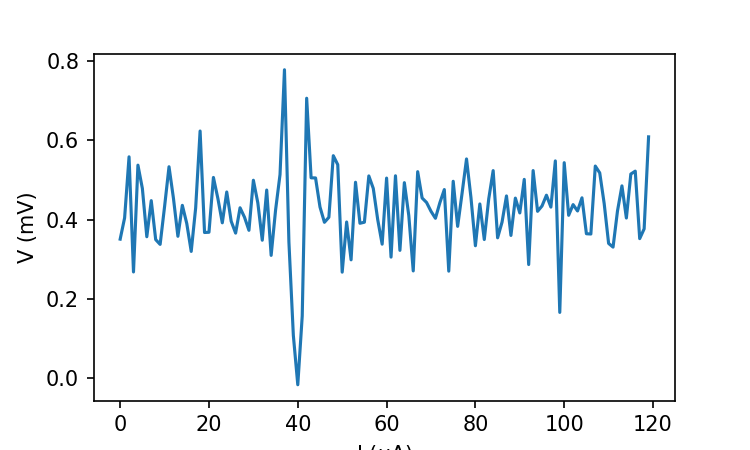

6.162991699999999e-07


In [55]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_220[200,35:45])
# plt.plot(I_220[200,:],V_220[200,:]-DCoff)
plt.plot(R_220[0,:])
# plt.plot(I_220[200,40], DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [68]:
saiz=np.shape(V_220)
# print(saiz)
Is_220=np.zeros(saiz[0])
Ir_220=np.zeros(saiz[0])
fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_220)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_220[i,30:50])
        if V_220[i,j]-DCoff > 0.5e-6:
            Is_220[i]=I_220[i,j]
            break

    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_220[i,30:50])
        if -V_220[i,j]-DCoff < 0.5e-6:
            Ir_220[i]=I_220[i,j]
            break


In [73]:
saiz=np.shape(V_220)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_220)
for i in range(200,255):
    for j in range(40,121):
        if R_220[i,j]-DCoff > 0.6:
            Is_220[i]=I_220[i,j]
            break
 
#      fV_9[i,:]=np.flip(V_9[i,:], 0)
#     for j in range(1,saiz[1]):
#         DCoff=np.mean(-V_220[i,30:50])
#         if -V_220[i,j]-DCoff < 0.5e-6:
#             Ir_220[i]=I_220[i,j]
#             break

(401, 121)


In [45]:
print((saiz[1]-1)/2)

60.0


<IPython.core.display.Javascript object>


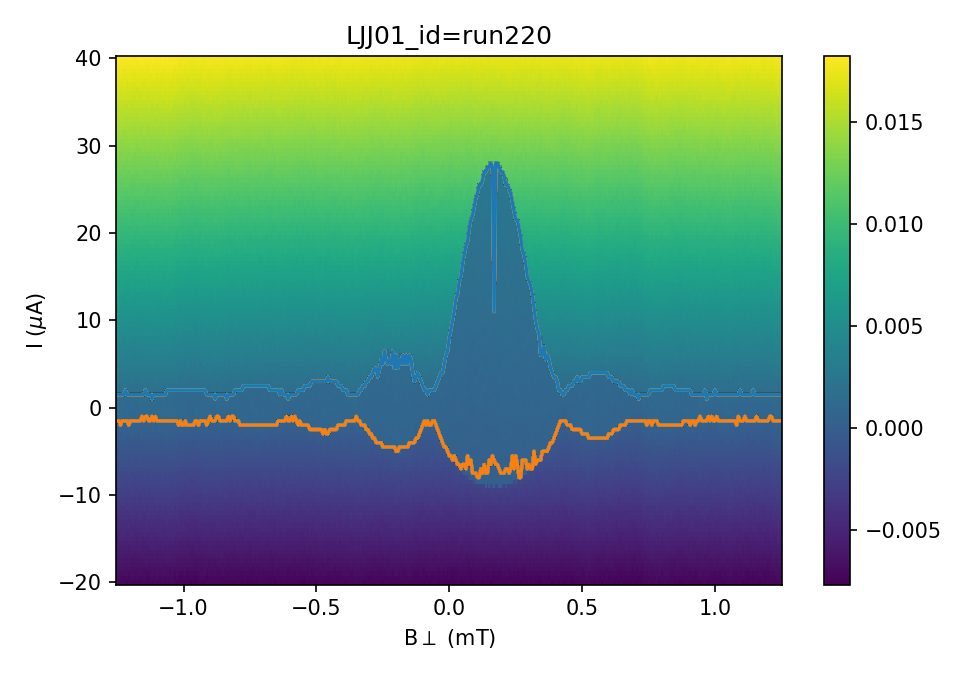

In [74]:
-0.064e-3fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_220[Arange:Brange,:]/1e-3, I_220[Arange:Brange,:]/1e-6, V_220[Arange:Brange,:]/1e-3, cmap = 'viridis')
im = ax0.pcolormesh(By_220[:,:]/1e-3, I_220[:,:]/1e-6, V_220[:,:]/1e-3, cmap = 'viridis')
# im = ax0.pcolormesh(V_220[:,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run220')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_220[Arange:Brange,:]/1e-3,Is_220[Arange:Brange]/1e-6)
plt.plot(By_220[Arange:Brange,:]/1e-3,Ir_220[Arange:Brange]/1e-6)

np.savetxt('Is_220.csv', (Is_220), fmt='%s', delimiter=',')
np.savetxt('Ir_220.csv', (Ir_220), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

In [84]:
runid=221
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [85]:
By_221=By_field
I_221=I
V_221=V
R_221=R_DC1

np.savetxt('L01_221_By.csv', (By_221), fmt='%s', delimiter=',')
np.savetxt('L01_221_I.csv', (I_221), fmt='%s', delimiter=',')
np.savetxt('L01_221_V.csv', (V_221), fmt='%s', delimiter=',')
np.savetxt('L01_221_R.csv', (R_221), fmt='%s', delimiter=',')

In [8]:
By_221=np.loadtxt('L01_221_By.csv', delimiter=",")
I_221=np.loadtxt('L01_221_I.csv', delimiter=",")
V_221=np.loadtxt('L01_221_V.csv', delimiter=",")
R_221=np.loadtxt('L01_221_R.csv', delimiter=",")
Is_221=np.loadtxt('Is_221.csv', delimiter=",")
Ir_221=np.loadtxt('Ir_221.csv', delimiter=",")

<IPython.core.display.Javascript object>


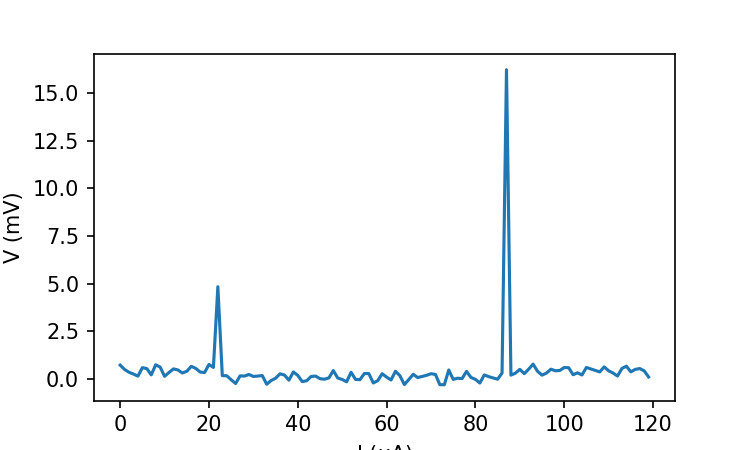

8.6596617e-07


In [107]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_221[200,35:45])
# plt.plot(I_221[200,:],V_221[200,:]-DCoff)
plt.plot(R_221[150,:])
# plt.plot(I_221[200,40], DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [102]:
saiz=np.shape(V_221)
# print(saiz)
Is_221=np.zeros(saiz[0])
Ir_221=np.zeros(saiz[0])
fV_221=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_221)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_221[i,36:43])
        if V_221[i,j]-DCoff < 0.5e-6:
            Is_221[i]=I_221[i,j]
            break

    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_221[i,36:43])
        if -V_221[i,j]-DCoff > 0.5e-6:
            Ir_221[i]=I_221[i,j]
            break


In [108]:
saiz=np.shape(V_221)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_221)
for i in range(130,190):
    for j in range(40,121):
        if R_221[i,j]-DCoff > 0.6:
            Ir_221[i]=I_221[i,j]
            break
 
#      fV_9[i,:]=np.flip(V_9[i,:], 0)
#     for j in range(1,saiz[1]):
#         DCoff=np.mean(-V_220[i,30:50])
#         if -V_220[i,j]-DCoff < 0.5e-6:
#             Ir_220[i]=I_220[i,j]
#             break

(401, 121)


<IPython.core.display.Javascript object>


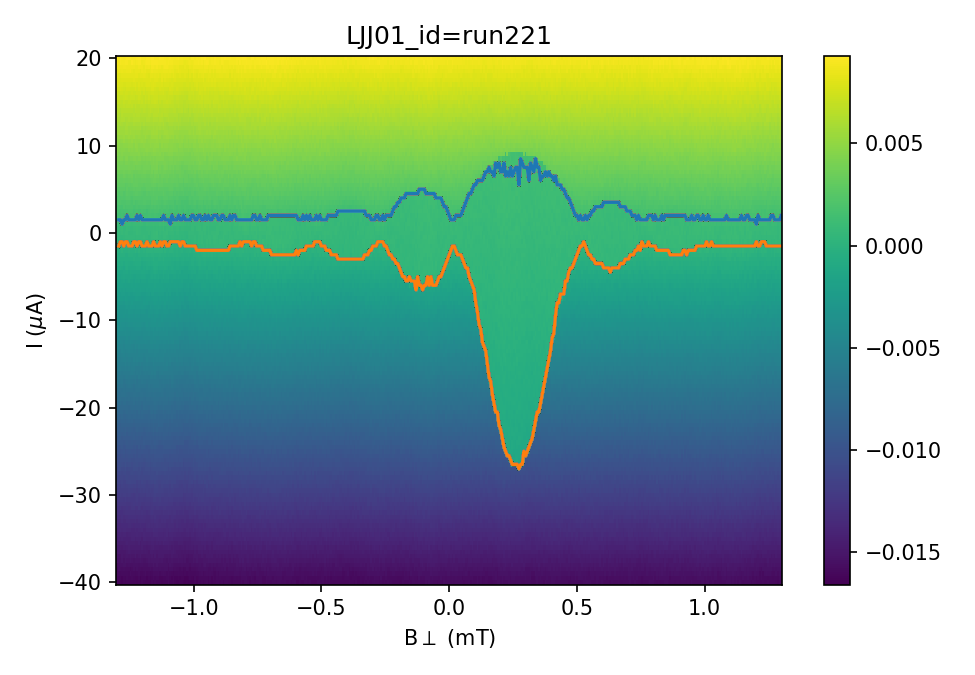

In [109]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_221[Arange:Brange,:]/1e-3, I_221[Arange:Brange,:]/1e-6, V_221[Arange:Brange,:]/1e-3, cmap = 'viridis')
im = ax0.pcolormesh(By_221[:,:]/1e-3, I_221[:,:]/1e-6, V_221[:,:]/1e-3, cmap = 'viridis')
# im = ax0.pcolormesh(V_221[:,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run221')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_221[Arange:Brange,:]/1e-3,Is_221[Arange:Brange]/1e-6)
plt.plot(By_221[Arange:Brange,:]/1e-3,Ir_221[Arange:Brange]/1e-6)

np.savetxt('Is_221.csv', (Is_221), fmt='%s', delimiter=',')
np.savetxt('Ir_221.csv', (Ir_221), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


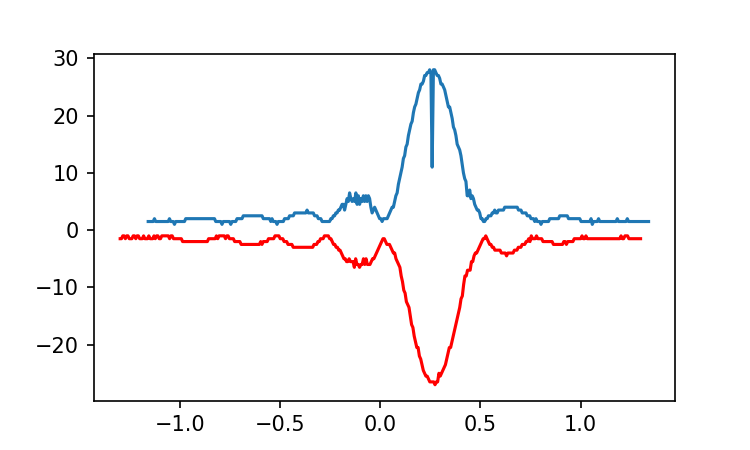

In [9]:
By_220=np.loadtxt('L01_220_By.csv', delimiter=",")
By_221=np.loadtxt('L01_221_By.csv', delimiter=",")
Is_220=np.loadtxt('Is_220.csv', delimiter=",")
Ir_221=np.loadtxt('Ir_221.csv', delimiter=",")
plt.figure(figsize=(5, 3))
plt.plot((By_220[:,1]+0.09e-3)/1e-3,Is_220[:]/1e-6)
# plt.plot(By_221[:,1]/1e-3,np.abs(Ir_221[:]/1e-6),'-r')
plt.plot(By_221[:,1]/1e-3,Ir_221[:]/1e-6,'-r')

## Run 219 and 218 for JDE at Bx=20 mT

In [75]:
runid=219
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [76]:
By_219=By_field
I_219=I
V_219=V
R_219=R_DC1

np.savetxt('L01_219_By.csv', (By_219), fmt='%s', delimiter=',')
np.savetxt('L01_219_I.csv', (I_219), fmt='%s', delimiter=',')
np.savetxt('L01_219_V.csv', (V_219), fmt='%s', delimiter=',')
np.savetxt('L01_219_R.csv', (R_219), fmt='%s', delimiter=',')

In [7]:
By_219=np.loadtxt('L01_219_By.csv', delimiter=",")
I_219=np.loadtxt('L01_219_I.csv', delimiter=",")
V_219=np.loadtxt('L01_219_V.csv', delimiter=",")
R_219=np.loadtxt('L01_219_R.csv', delimiter=",")
Is_219=np.loadtxt('Is_219.csv', delimiter=",")
Ir_219=np.loadtxt('Ir_219.csv', delimiter=",")

<IPython.core.display.Javascript object>


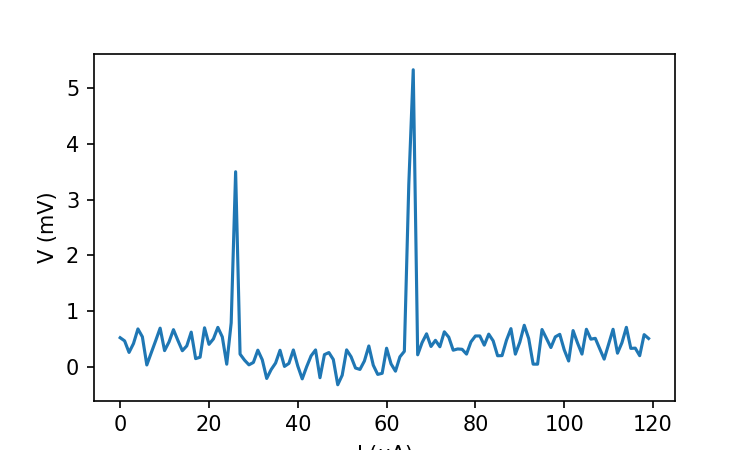

8.254217600000001e-07


In [78]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_219[200,35:45])
# plt.plot(I_220[200,:],V_220[200,:]-DCoff)
plt.plot(R_219[200,:])
# plt.plot(I_219[200,40], DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [93]:
saiz=np.shape(V_219)
# print(saiz)
Is_219=np.zeros(saiz[0])
Ir_219=np.zeros(saiz[0])
fV_219=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_219)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_219[i,30:50])
        if V_219[i,j]-DCoff < 0.5e-6:
            Is_219[i]=I_219[i,j]
            break

    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_219[i,30:50])
        if -V_219[i,j]-DCoff > 0.5e-6:
            Ir_219[i]=I_219[i,j]
            break


In [94]:
saiz=np.shape(V_219)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_219)
for i in range(190,260):
    for j in range(40,121):
        if R_219[i,j]-DCoff > 0.6:
            Ir_219[i]=I_219[i,j]
            break
 
#      fV_9[i,:]=np.flip(V_9[i,:], 0)
#     for j in range(1,saiz[1]):
#         DCoff=np.mean(-V_220[i,30:50])
#         if -V_220[i,j]-DCoff < 0.5e-6:
#             Ir_220[i]=I_220[i,j]
#             break

(401, 121)


<IPython.core.display.Javascript object>


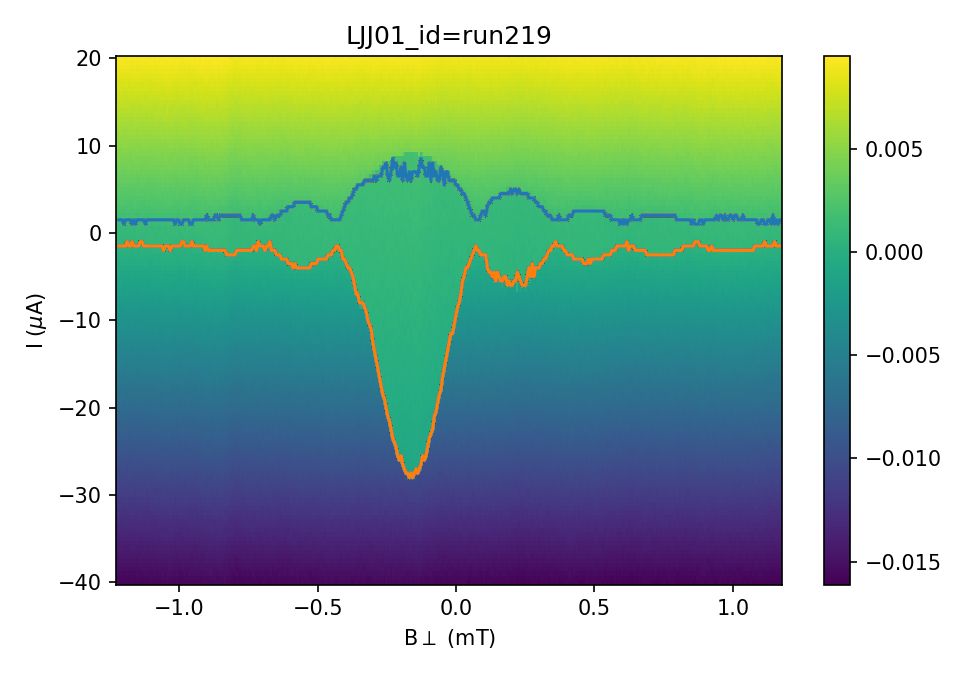

In [95]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_219[Arange:Brange,:]/1e-3, I_219[Arange:Brange,:]/1e-6, V_219[Arange:Brange,:]/1e-3, cmap = 'viridis')
im = ax0.pcolormesh(By_219[:,:]/1e-3, I_219[:,:]/1e-6, V_219[:,:]/1e-3, cmap = 'viridis')
# im = ax0.pcolormesh(V_219[:,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run219')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_219[Arange:Brange,:]/1e-3,Is_219[Arange:Brange]/1e-6)
plt.plot(By_219[Arange:Brange,:]/1e-3,Ir_219[Arange:Brange]/1e-6)

np.savetxt('Is_219.csv', (Is_219), fmt='%s', delimiter=',')
np.savetxt('Ir_219.csv', (Ir_219), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

In [25]:
runid=218
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [26]:
By_218=By_field
I_218=I
V_218=V
R_218=R_DC1

np.savetxt('L01_218_By.csv', (By_218), fmt='%s', delimiter=',')
np.savetxt('L01_218_I.csv', (I_218), fmt='%s', delimiter=',')
np.savetxt('L01_218_V.csv', (V_218), fmt='%s', delimiter=',')
np.savetxt('L01_218_R.csv', (R_218), fmt='%s', delimiter=',')

In [8]:
By_218=np.loadtxt('L01_218_By.csv', delimiter=",")
I_218=np.loadtxt('L01_218_I.csv', delimiter=",")
V_218=np.loadtxt('L01_218_V.csv', delimiter=",")
R_218=np.loadtxt('L01_218_R.csv', delimiter=",")
Is_218=np.loadtxt('Is_218.csv', delimiter=",")
Ir_218=np.loadtxt('Ir_218.csv', delimiter=",")

<IPython.core.display.Javascript object>


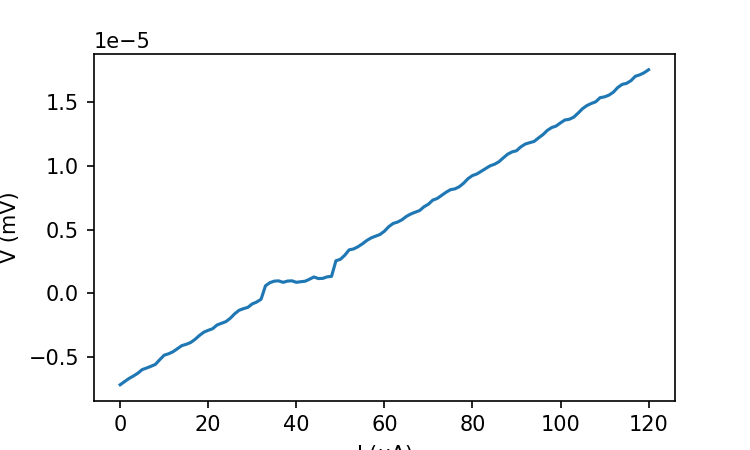

9.6964255e-07


In [29]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_218[100,35:45])
# plt.plot(I_218[200,:],V_218[200,:]-DCoff)
plt.plot(V_218[100,:])
# plt.plot(I_218[200,40], DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [35]:
saiz=np.shape(V_218)
# print(saiz)
Is_218=np.zeros(saiz[0])
Ir_218=np.zeros(saiz[0])
fV_218=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_218)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_218[i,33:46])
        if V_218[i,j]-DCoff > 0.5e-6:
            Is_218[i]=I_218[i,j]
            break

    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_218[i,33:46])
        if -V_218[i,j]-DCoff < 0.5e-6:
            Ir_218[i]=I_218[i,j]
            break


In [36]:
saiz=np.shape(V_218)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_218)
for i in range(130,192):
    for j in range(40,121):
        if R_218[i,j]-DCoff > 0.6:
            Is_218[i]=I_218[i,j]
            break
 
#      fV_9[i,:]=np.flip(V_9[i,:], 0)
#     for j in range(1,saiz[1]):
#         DCoff=np.mean(-V_220[i,30:50])
#         if -V_220[i,j]-DCoff < 0.5e-6:
#             Ir_220[i]=I_220[i,j]
#             break

(401, 121)


<IPython.core.display.Javascript object>


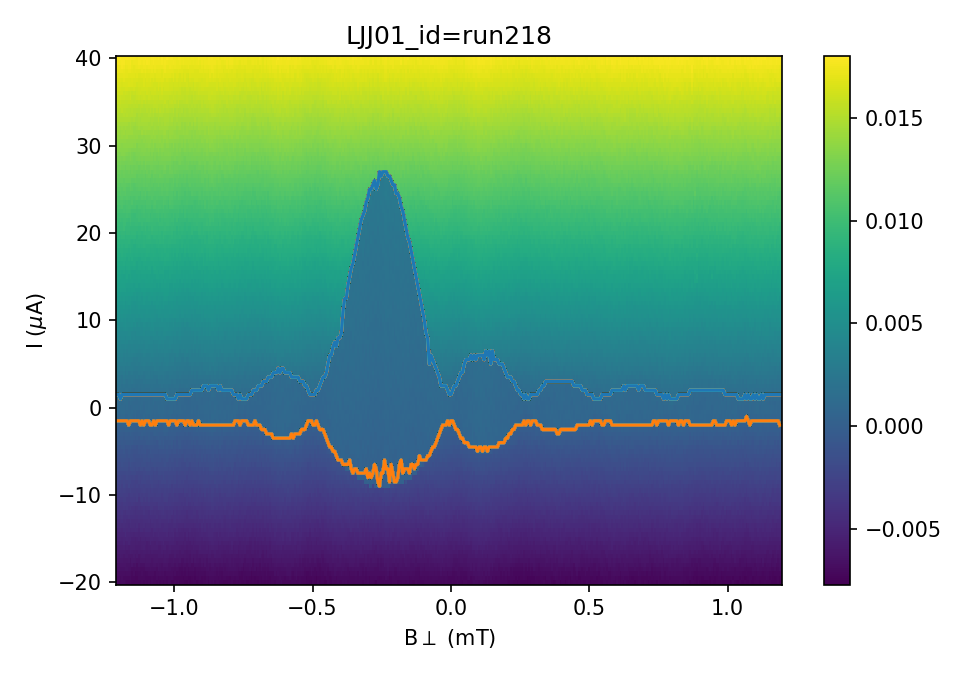

In [37]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_218[Arange:Brange,:]/1e-3, I_218[Arange:Brange,:]/1e-6, V_218[Arange:Brange,:]/1e-3, cmap = 'viridis')
im = ax0.pcolormesh(By_218[:,:]/1e-3, I_218[:,:]/1e-6, V_218[:,:]/1e-3, cmap = 'viridis')
# im = ax0.pcolormesh(V_218[:,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run218')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_218[Arange:Brange,:]/1e-3,Is_218[Arange:Brange]/1e-6)
plt.plot(By_218[Arange:Brange,:]/1e-3,Ir_218[Arange:Brange]/1e-6)

np.savetxt('Is_218.csv', (Is_218), fmt='%s', delimiter=',')
np.savetxt('Ir_218.csv', (Ir_218), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

In [63]:
np.size(By_218[:,1])
(By_219[0,1]-By_219[400,1])/400
By_218[0,1]

-0.001206

<IPython.core.display.Javascript object>


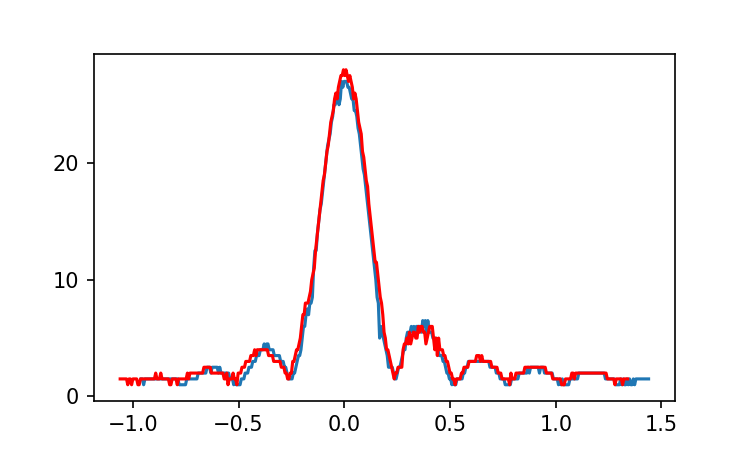

In [10]:
By_218=np.loadtxt('L01_218_By.csv', delimiter=",")
By_219=np.loadtxt('L01_219_By.csv', delimiter=",")
Is_218=np.loadtxt('Is_218.csv', delimiter=",")
Ir_219=np.loadtxt('Ir_219.csv', delimiter=",")
plt.figure(figsize=(5, 3))
x=np.linspace(0,400,401)
plt.plot((By_218[:,1]+0.08e-3)/1e-3+0.165,Is_218[:]/1e-6)
plt.plot(By_219[:,1]/1e-3+0.165,np.abs(Ir_219[:]/1e-6),'-r')
# plt.plot(By_219[:,1]/1e-3+0.165,Ir_219[:]/1e-6,'-r')
plt.rcParams.update({'font.size': 14})
# plt.plot(((x-11)*6e-6+By_218[0,1])/1e-3,Is_218[:]/1e-6)
# plt.plot((-x*6e-6+By_219[0,1])/1e-3,np.abs(Ir_219[:]/1e-6),'-b')

# plt.plot(I_218[211,40:121]/1e-6,(V_218[211,40:121]-V_218[211,40])/1e-3)
# plt.plot(-(I_219[200,40:121])/1e-6,np.abs(V_219[200,40:121]-V_219[200,40])/1e-3)

<IPython.core.display.Javascript object>


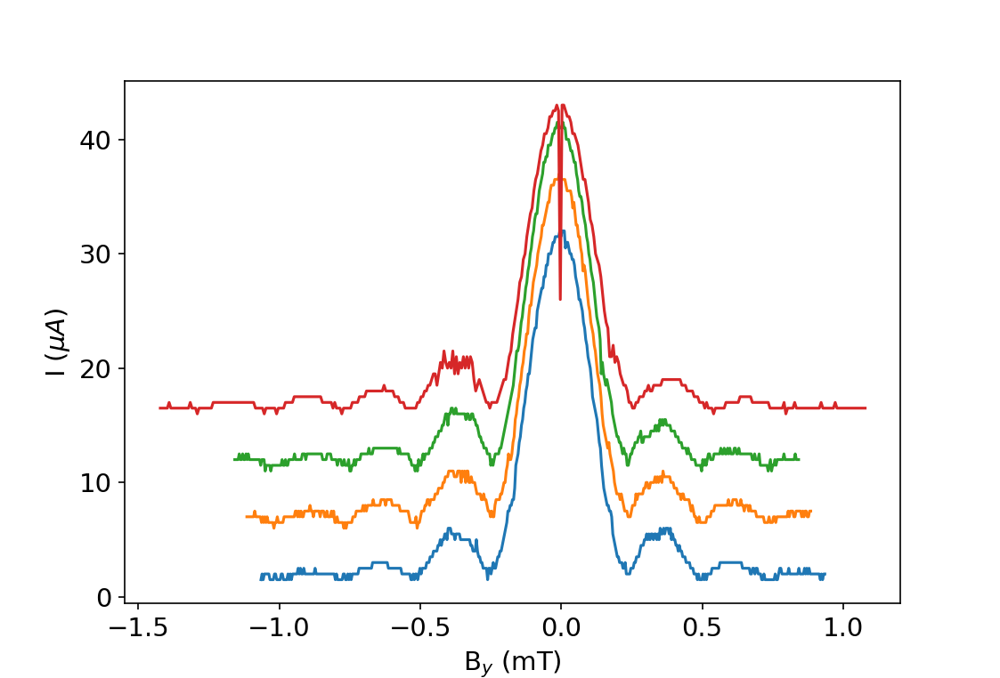

In [15]:
plt.figure(figsize=(5, 3))

x=np.linspace(0,400,401)
plt.plot((By_210[:,1])/1e-3-0.065,Is_210[:]/1e-6) #0mT
plt.plot((By_208[:,1])/1e-3-0.115,Is_208[:]/1e-6+5) # -5mTMT 
plt.plot((By_206[:,1])/1e-3-0.158,Is_206[:]/1e-6+10) # -10mT
plt.plot((By_220[:,1])/1e-3-0.172,Is_220[:]/1e-6+15) # -20 mT
plt.xlabel('B$_y$ (mT)')
plt.ylabel('I ($\mu A$)')

# plt.plot((By_218[:,1]+0.08e-3)/1e-3,Is_218[:]/1e-6)

# plt.plot(By_219[:,1]/1e-3,np.abs(Ir_219[:]/1e-6),'-r')
# plt.plot(By_219[:,1]/1e-3,Ir_219[:]/1e-6,'-r')

plt.rcParams.update({'font.size': 14})

<IPython.core.display.Javascript object>


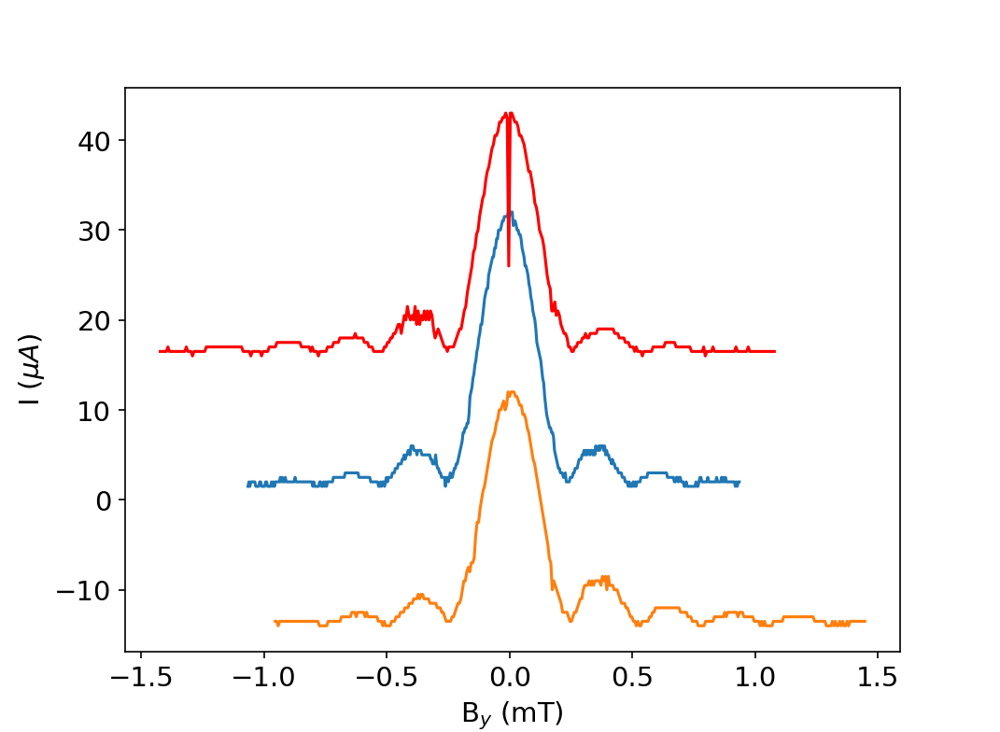

In [14]:
plt.figure(figsize=(5, 3))

x=np.linspace(0,400,401)
plt.plot((By_210[:,1])/1e-3-0.065,Is_210[:]/1e-6) #0mT
# plt.plot((By_208[:,1])/1e-3-0.115,Is_208[:]/1e-6+5) # -5mTMT 
# plt.plot((By_206[:,1])/1e-3-0.158,Is_206[:]/1e-6+10) # -10mT
plt.plot((By_220[:,1])/1e-3-0.172,Is_220[:]/1e-6+15, 'r') # -20 mT
plt.xlabel('B$_y$ (mT)')
plt.ylabel('I ($\mu A$)')

plt.plot((By_218[:,1]+0.08e-3)/1e-3+0.172,Is_218[:]/1e-6-15) # 20 mT

# plt.plot(By_219[:,1]/1e-3,np.abs(Ir_219[:]/1e-6),'-r')
# plt.plot(By_219[:,1]/1e-3,Ir_219[:]/1e-6,'-r')

plt.rcParams.update({'font.size': 14})

### Symmetry check 

<IPython.core.display.Javascript object>


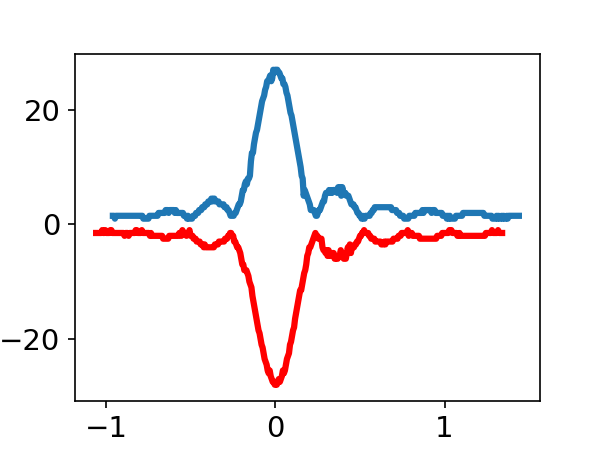

Text(0, 0.5, 'I ($\\mu$A)')

In [8]:
By_218=np.loadtxt('L01_218_By.csv', delimiter=",")
By_219=np.loadtxt('L01_219_By.csv', delimiter=",")
Is_218=np.loadtxt('Is_218.csv', delimiter=",")
Ir_219=np.loadtxt('Ir_219.csv', delimiter=",")

By_220=np.loadtxt('L01_220_By.csv', delimiter=",")
By_221=np.loadtxt('L01_221_By.csv', delimiter=",")
Is_220=np.loadtxt('Is_220.csv', delimiter=",")
Ir_221=np.loadtxt('Ir_221.csv', delimiter=",")

plt.figure(figsize=(4, 3))
x=np.linspace(0,400,401)
plt.plot((By_218[:,1]+0.08e-3)/1e-3+0.165,Is_218[:]/1e-6, label='B$_{\parallel}$', linewidth=3.0)
plt.plot(By_219[:,1]/1e-3+0.165,Ir_219[:]/1e-6,'-r', label='B$_{\parallel}$', linewidth=3.0)
# plt.plot((By_219[:,1]/1e-3+0.165),np.abs(Ir_219[:]/1e-6),'-r', label='abs(I)$^-$*B$_{\perp}$*B$_{\parallel}$')
# plt.plot(((By_220[:,1]+0.09e-3)/1e-3-0.260),Is_220[:]/1e-6, label='-B$_{\parallel}$', linewidth=3.0) # for TPS
# plt.plot(-((By_220[:,1]+0.09e-3)/1e-3-0.260),Is_220[:]/1e-6, label='I$^+$*-B$_{\perp}$*-B$_{\parallel}$')
# plt.plot(By_221[:,1]/1e-3-0.260,Ir_221[:]/1e-6, label='-B$_{\parallel}$', linewidth=3.0) # for TPS
# plt.plot(-(By_221[:,1]/1e-3-0.260),np.abs(Ir_221[:])/1e-6, label='abs(I)$^-$*-B$_{\perp}$*-B$_{\parallel}$')
plt.rcParams.update({'font.size': 14})
# plt.legend(loc='upper right', frameon=False)
plt.xlabel('B$_{\perp}$ (mT)')
plt.ylabel('I ($\mu$A)')

### JDE on the side lobes

In [5]:
#Loading data#
By_220=np.loadtxt('L01_220_By.csv', delimiter=",")
I_220=np.loadtxt('L01_220_I.csv', delimiter=",")
V_220=np.loadtxt('L01_220_V.csv', delimiter=",")
R_220=np.loadtxt('L01_220_R.csv', delimiter=",")
Is_220=np.loadtxt('Is_220.csv', delimiter=",")
Ir_220=np.loadtxt('Ir_220.csv', delimiter=",")

By_221=np.loadtxt('L01_221_By.csv', delimiter=",")
I_221=np.loadtxt('L01_221_I.csv', delimiter=",")
V_221=np.loadtxt('L01_221_V.csv', delimiter=",")
R_221=np.loadtxt('L01_221_R.csv', delimiter=",")
Is_221=np.loadtxt('Is_221.csv', delimiter=",")
Ir_221=np.loadtxt('Ir_221.csv', delimiter=",")

By_219=np.loadtxt('L01_219_By.csv', delimiter=",")
I_219=np.loadtxt('L01_219_I.csv', delimiter=",")
V_219=np.loadtxt('L01_219_V.csv', delimiter=",")
R_219=np.loadtxt('L01_219_R.csv', delimiter=",")
Is_219=np.loadtxt('Is_219.csv', delimiter=",")
Ir_219=np.loadtxt('Ir_219.csv', delimiter=",")

By_218=np.loadtxt('L01_218_By.csv', delimiter=",")
I_218=np.loadtxt('L01_218_I.csv', delimiter=",")
V_218=np.loadtxt('L01_218_V.csv', delimiter=",")
R_218=np.loadtxt('L01_218_R.csv', delimiter=",")
Is_218=np.loadtxt('Is_218.csv', delimiter=",")
Ir_218=np.loadtxt('Ir_218.csv', delimiter=",")

In [6]:
num=By_218[:,:]
saiz=np.shape(num)
for i in range(saiz[1]):
    for j in range(saiz[0]):
        num[j,i]=j+1
# print(num[:,1])

<IPython.core.display.Javascript object>


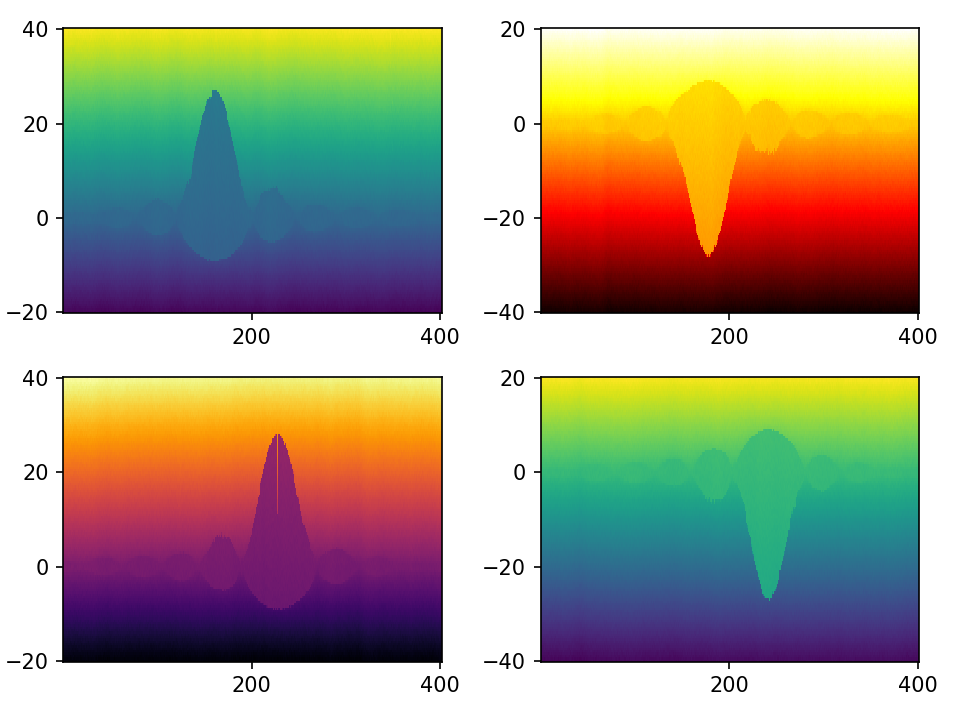

In [59]:
fig, ax = plt.subplots(2, 2)
fig.subplots_adjust(hspace=55)

# ax[0,0].pcolormesh(By_218[:,:]/1e-3+0.256, I_218[:,:]/1e-6, V_218[:,:]/1e-3, cmap = 'viridis')
# ax[0,1].pcolormesh(By_219[:,:]/1e-3+0.172, I_219[:,:]/1e-6, V_219[:,:]/1e-3, cmap = 'viridis')
# ax[1,0].pcolormesh(By_220[:,:]/1e-3-0.17, I_220[:,:]/1e-6, V_220[:,:]/1e-3, cmap = 'viridis')
# ax[1,1].pcolormesh(By_221[:,:]/1e-3-0.25, I_221[:,:]/1e-6, V_221[:,:]/1e-3, cmap = 'viridis')

# note the run 219 and 221 are measured in a reversed direction, therefore need to reverse up down when counting with nummbers
ax[0,0].pcolormesh(num, I_218[:,:]/1e-6, V_218[:,:]/1e-3, cmap = 'viridis')
# ax[0,1].pcolormesh(num, I_219[:,:]/1e-6, V_219[:,:]/1e-3, cmap = 'hot')
ax[0,1].pcolormesh(num, I_219[:,:]/1e-6, np.flipud(V_219[:,:])/1e-3, cmap = 'hot')
ax[1,0].pcolormesh(num, I_220[:,:]/1e-6, V_220[:,:]/1e-3, cmap = 'inferno')
ax[1,1].pcolormesh(num, I_221[:,:]/1e-6, np.flipud(V_221[:,:]/1e-3), cmap = 'viridis')
# ax[1,1].pcolormesh(num, I_221[:,:]/1e-6, V_221[:,:]/1e-3, cmap = 'viridis')

fig.tight_layout()
#plt.grid()
plt.show()

In [73]:
print(I_219[159,40:50])

[-3.38813179e-21 -5.00000000e-07 -1.00000000e-06 -1.50000000e-06
 -2.00000000e-06 -2.50000000e-06 -3.00000000e-06 -3.50000000e-06
 -4.00000000e-06 -4.50000000e-06]


<IPython.core.display.Javascript object>


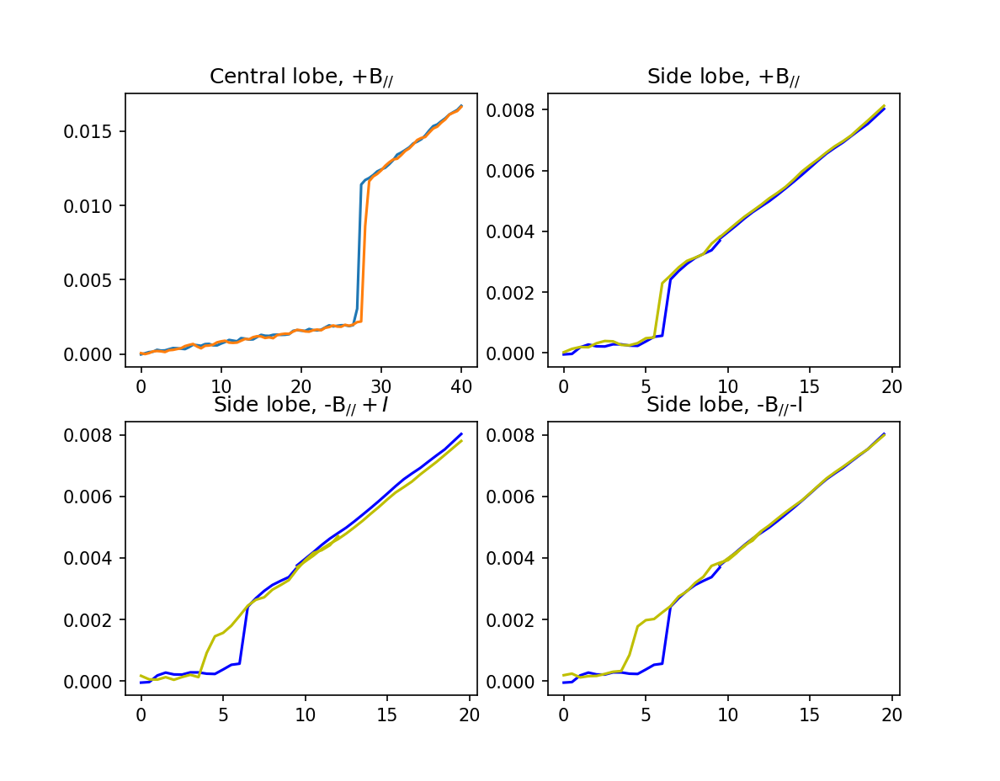

Text(0.5, 1.0, 'Side lobe, -B$_{//}$-I')

In [60]:
fig = plt.figure()

plt.subplot(221)
plt.plot(I_218[159,40:121]/1e-6,V_218[159,40:121]/1e-3-0.0007)
plt.plot(np.abs(I_219[221,40:121])/1e-6,np.abs(V_219[221,40:121]/1e-3-0.001183))

plt.title("Central lobe, +B$_{//}$")

plt.subplot(222)
plt.plot(I_218[221,40:60]/1e-6,V_218[221,40:60]/1e-3-0.001,'b')
plt.plot(I_218[221,59:80]/1e-6,savgol_filter(V_218[221,59:80],5,1)/1e-3-0.001,'b')
plt.plot(np.abs(I_219[162,40:60])/1e-6,np.abs(V_219[162,40:60]/1e-3-0.00082),'y')
plt.plot(np.abs(I_219[162,59:80])/1e-6,savgol_filter(np.abs(V_219[162,59:80]/1e-3-0.00082),5,1),'y')

plt.title("Side lobe, +B$_{//}$")

plt.subplot(223)
plt.plot(I_218[221,40:60]/1e-6,V_218[221,40:60]/1e-3-0.001,'b')
plt.plot(I_218[221,59:80]/1e-6,savgol_filter(V_218[221,59:80],5,1)/1e-3-0.001,'b')
plt.plot((I_220[290,40:65])/1e-6,np.abs(V_220[290,40:65]/1e-3-0.00082),'y')
plt.plot((I_220[290,59:80])/1e-6,savgol_filter(np.abs(V_220[290,59:80]/1e-3-0.00082),5,1),'y')

plt.title("Side lobe, -B$_{//}+I$")

plt.subplot(224)
plt.plot(I_218[221,40:60]/1e-6,V_218[221,40:60]/1e-3-0.001,'b')
plt.plot(I_218[221,59:80]/1e-6,savgol_filter(V_218[221,59:80],5,1)/1e-3-0.001,'b')
plt.plot(np.abs(I_221[102,40:65])/1e-6,np.abs(V_221[102,40:65]/1e-3-0.00082),'y')
plt.plot(np.abs(I_221[102,59:80])/1e-6,savgol_filter(np.abs(V_221[102,59:80]/1e-3-0.00082),5,1),'y')

plt.title("Side lobe, -B$_{//}$-I")


## Run 222 for a good Fraunhofer 

In [29]:
runid=222
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
# I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
# V = V.reshape(NB,NI)

In [8]:
By_222=By_field
I_222=I
V_222=V
R_222=R_DC1

np.savetxt('L01_222_By.csv', (By_222), fmt='%s', delimiter=',')
np.savetxt('L01_222_I.csv', (I_222), fmt='%s', delimiter=',')
np.savetxt('L01_222_V.csv', (V_222), fmt='%s', delimiter=',')
np.savetxt('L01_222_R.csv', (R_222), fmt='%s', delimiter=',')

In [5]:
By_222=np.loadtxt('L01_222_By.csv', delimiter=",")
I_222=np.loadtxt('L01_222_I.csv', delimiter=",")
V_222=np.loadtxt('L01_222_V.csv', delimiter=",")
R_222=np.loadtxt('L01_222_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


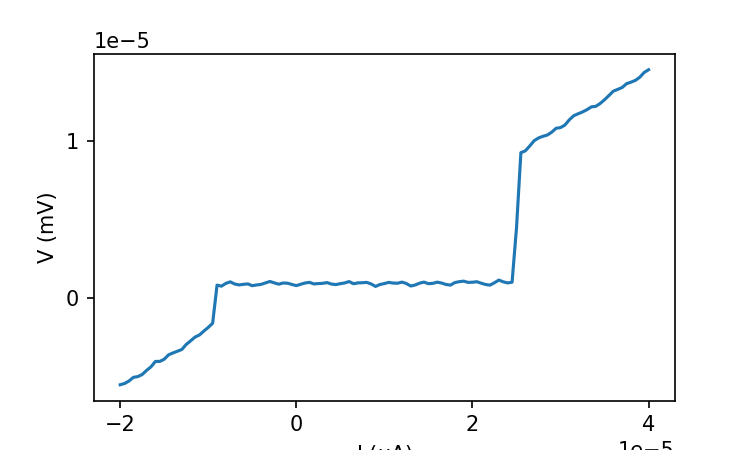

Text(0, 0.5, 'V (mV)')

In [10]:
plt.figure(figsize=(5, 3))
'''
R_222f=savgol_filter(R_222, 10, 5)
V_222f=savgol_filter(V, 10, 5)
R_DC1f = V_222f/(I[2]-I[1])
R_DC1f = R_DC1f.reshape(NB,NI)
R_DC1f = np.diff(R_DC1f, axis = 1)
'''
DCoff=np.mean(V_222[300,35:45])
plt.plot(I_222[200,:],V_222[200,:])
# plt.plot(I_258[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

<IPython.core.display.Javascript object>


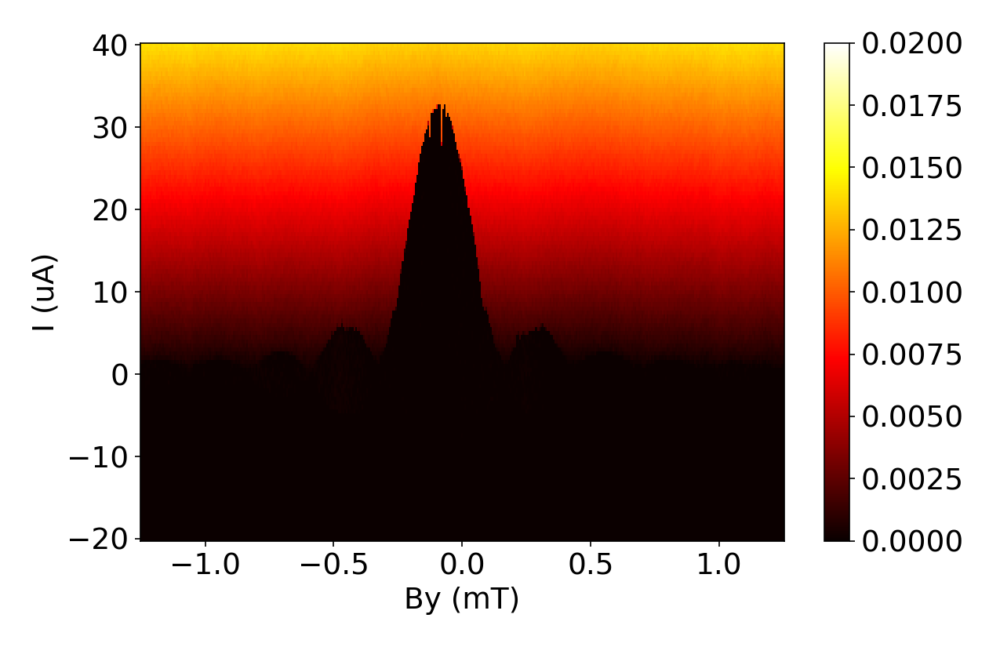

In [11]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')


Arange=0
Brange=120
R_222f=savgol_filter(R_222, 7, 3)

# R_222f2=lfilter(a,b,R_222)
# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(By_222[:,Arange:Brange]/1e-3, I_222[:,Arange:Brange]/1e-6, R_222f[:,Arange:Brange]/1e-3, cmap = 'hot', vmin=0, vmax=4000)
im = ax0.pcolormesh(By_222/1e-3, I_222/1e-6, (V_222-9.56e-7)/1e-3, cmap = 'hot', vmin=0, vmax=0.02)
fig.colorbar(im, ax=ax0)
plt.rcParams.update({'font.size': 18})
# ax0.set_title('id=run222')
ax0.set(xlabel='By (mT)', ylabel='I (uA)')



fig.tight_layout()
#plt.grid()
plt.show()

In [27]:
saiz=np.shape(V_222)
# print(saiz)
Is_222=np.zeros(saiz[0])
Ir_222=np.zeros(saiz[0])
fV_222=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_222)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_222[i,35:45])
        if V_222[i,j]-DCoff > 3e-7:
            Is_222[i]=I_222[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_222[i,35:45])
        if -V_222[i,j]-DCoff < 5e-7:
            Ir_222[i]=I_222[i,j]
            break

<IPython.core.display.Javascript object>


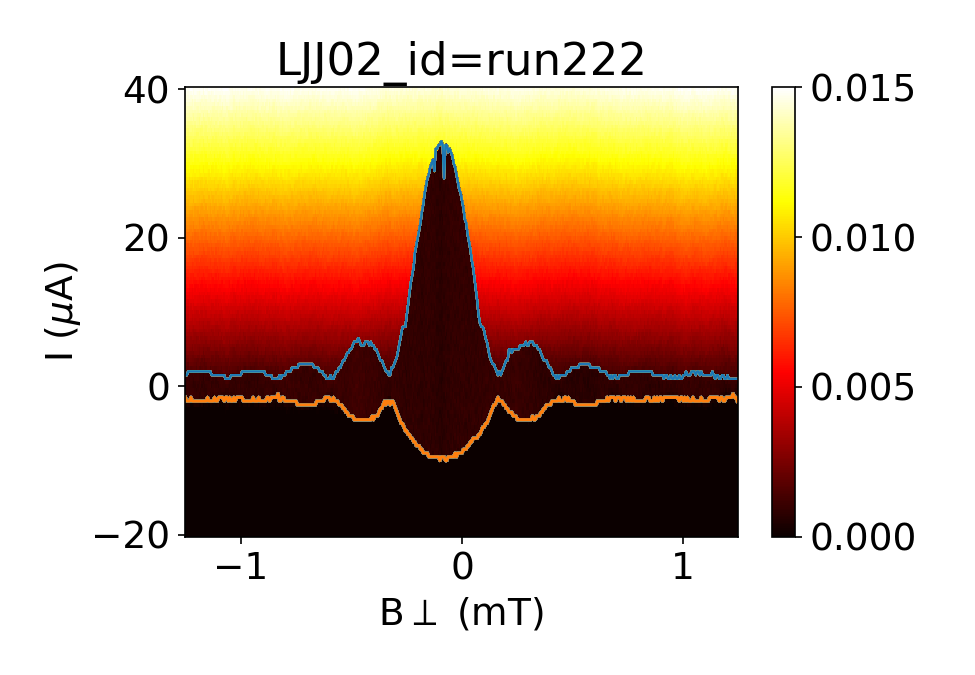

In [32]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_222[Arange:Brange,:]/1e-3, I_222[Arange:Brange,:]/1e-6, V_222[Arange:Brange,:]/1e-3, cmap = 'hot', vmax=0.015,vmin=0)
# im = ax0.pcolormesh(V_231/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run222')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_222[Arange:Brange,:]/1e-3,Is_222[Arange:Brange]/1e-6, linewidth=1)
plt.plot(By_222[Arange:Brange,:]/1e-3,Ir_222[Arange:Brange]/1e-6)

np.savetxt('Is_222.csv', (Is_222), fmt='%s', delimiter=',')
np.savetxt('Ir_222.csv', (Ir_222), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 231 to Run 244 rotation 

## Run 231 IV_By_ 0 degree Bx= 20 mT

In [23]:
runid=231
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [24]:
By_231=By_field
I_231=I
V_231=V
R_231=R_DC1

np.savetxt('L01_231_By.csv', (By_231), fmt='%s', delimiter=',')
np.savetxt('L01_231_I.csv', (I_231), fmt='%s', delimiter=',')
np.savetxt('L01_231_V.csv', (V_231), fmt='%s', delimiter=',')
np.savetxt('L01_231_R.csv', (R_231), fmt='%s', delimiter=',')

In [103]:
By_231=np.loadtxt('L01_231_By.csv', delimiter=",")
I_231=np.loadtxt('L01_231_I.csv', delimiter=",")
V_231=np.loadtxt('L01_231_V.csv', delimiter=",")
R_231=np.loadtxt('L01_231_R.csv', delimiter=",")
Is_231=np.loadtxt('Is_231.csv', delimiter=",")
Ir_231=np.loadtxt('Ir_231.csv', delimiter=",")

<IPython.core.display.Javascript object>


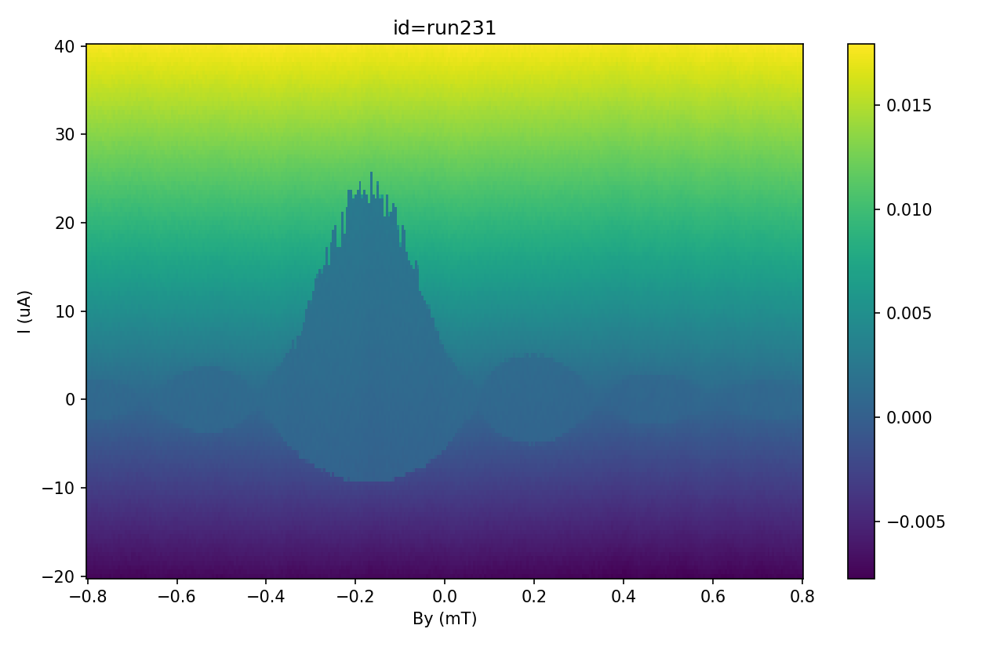

In [25]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_231/1e-3, I_231/1e-6, V_231/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run231')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


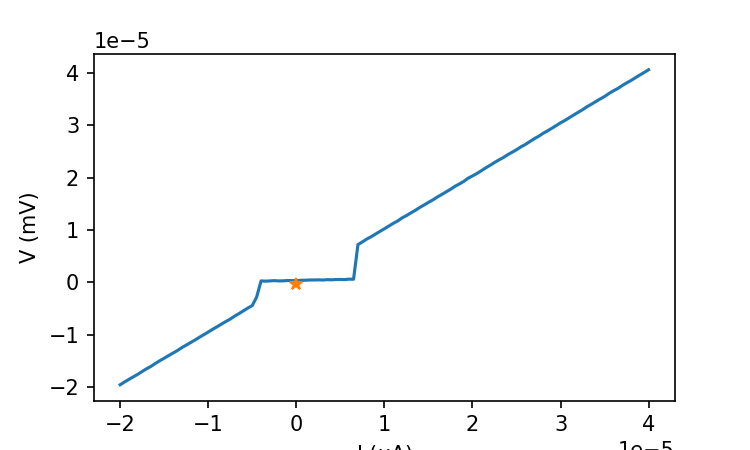

-2.46990844145e-07


In [8]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_271[150,30:50])
plt.plot(I_271[150,:],V_271[150,:]-DCoff)
plt.plot(I_271[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [9]:
saiz=np.shape(V_231)
# print(saiz)
Is_231=np.zeros(saiz[0])
Ir_231=np.zeros(saiz[0])
fV_231=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_231)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_231[i,30:50])
        if V_231[i,j]-DCoff > 5e-7:
            Is_231[i]=I_231[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_231[i,30:50])
        if -V_231[i,j]-DCoff < 5e-7:
            Ir_231[i]=I_231[i,j]
            break

In [11]:
saiz=np.shape(V_231)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_231)
for i in range(90,170):
    for j in range(40,121):
        if R_231[i,j]-DCoff > 0.6:
            Is_231[i]=I_231[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_231[i,j]-DCoff > 0.6:
            Ir_231[i]=I_231[i,j]
            break

NameError: name 'V_231' is not defined

<IPython.core.display.Javascript object>


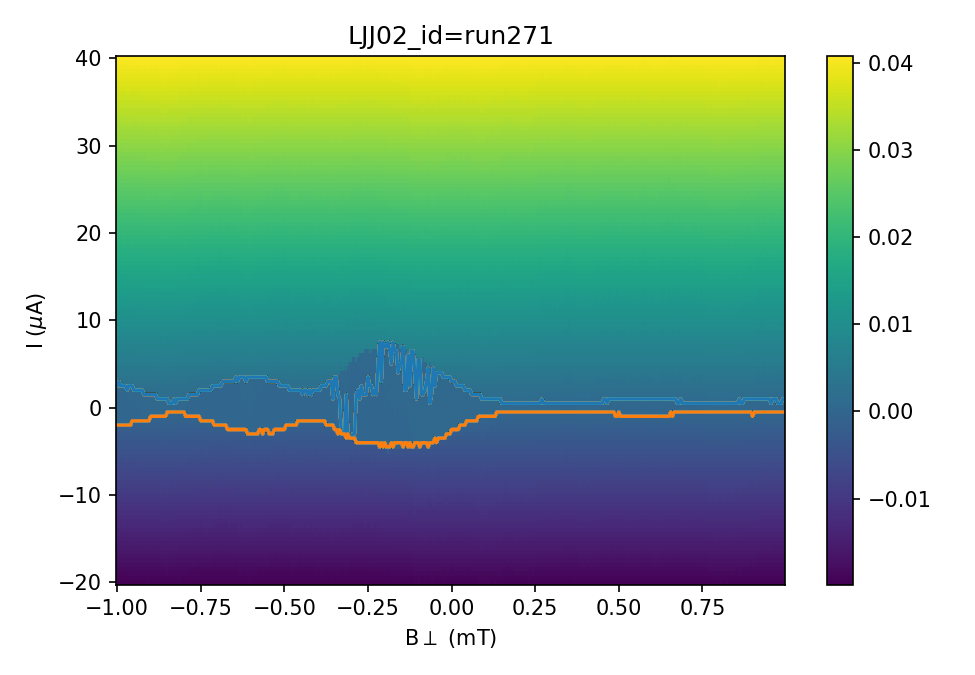

In [12]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_231[Arange:Brange,:]/1e-3, I_231[Arange:Brange,:]/1e-6, V_231[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_231/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run271')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_231[Arange:Brange,:]/1e-3,Is_231[Arange:Brange]/1e-6)
plt.plot(By_231[Arange:Brange,:]/1e-3,Ir_231[Arange:Brange]/1e-6)

np.savetxt('Is_231.csv', (Is_231), fmt='%s', delimiter=',')
np.savetxt('Ir_231.csv', (Ir_231), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 233 IV_By_30 degree 

In [60]:
runid=233
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [61]:
By_233=By_field
I_233=I
V_233=V
R_233=R_DC1

np.savetxt('L01_233_By.csv', (By_233), fmt='%s', delimiter=',')
np.savetxt('L01_233_I.csv', (I_233), fmt='%s', delimiter=',')
np.savetxt('L01_233_V.csv', (V_233), fmt='%s', delimiter=',')
np.savetxt('L01_233_R.csv', (R_233), fmt='%s', delimiter=',')

In [16]:
By_233=np.loadtxt('L01_233_By.csv', delimiter=",")
I_233=np.loadtxt('L01_233_I.csv', delimiter=",")
V_233=np.loadtxt('L01_233_V.csv', delimiter=",")
R_233=np.loadtxt('L01_233_R.csv', delimiter=",")
Is_233=np.loadtxt('Is_233.csv', delimiter=",")
Ir_233=np.loadtxt('Ir_233.csv', delimiter=",")

<IPython.core.display.Javascript object>


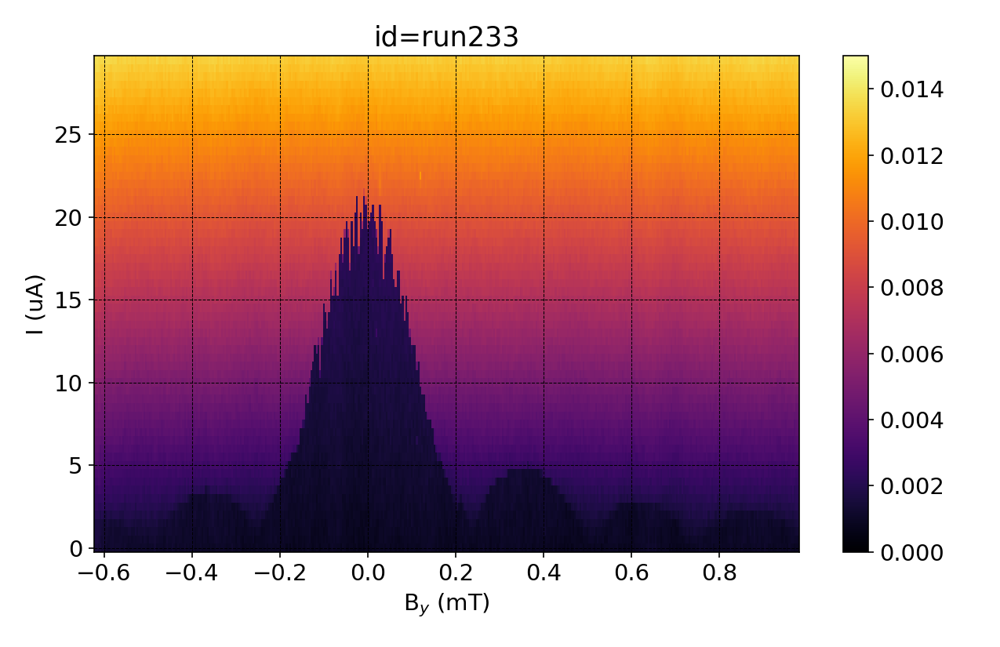

In [45]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=40
Brange=100

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_233[:,Arange:Brange]/1e-3+0.18, I_233[:,Arange:Brange]/1e-6, V_233[:,Arange:Brange]/1e-3, cmap = 'inferno', vmax=0.015, vmin=0)
# im = ax0.pcolormesh(By_233/1e-3, I_233/1e-6, V_233/1e-3, cmap = 'inferno')#, vmax=0.01, vmin=0)
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run233')
ax0.set(xlabel='B$_y$ (mT)', ylabel='I (uA)') 

plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
fig.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


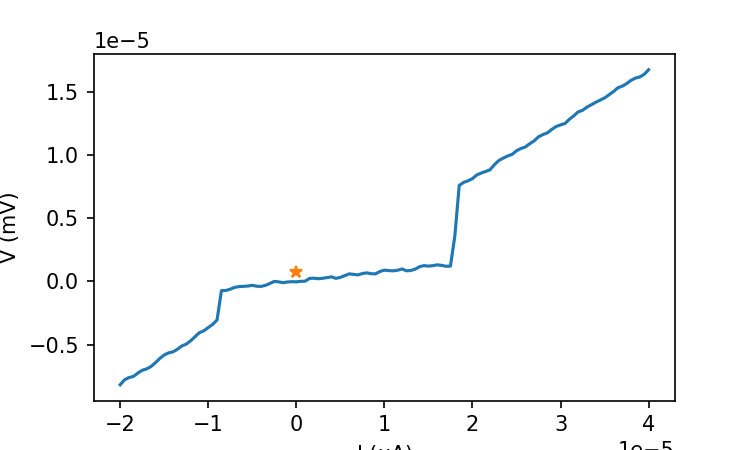

7.2973154e-07


In [63]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_233[150,30:50])
plt.plot(I_233[150,:],V_233[150,:]-DCoff)
plt.plot(I_233[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [75]:
saiz=np.shape(V_233)
# print(saiz)
Is_233=np.zeros(saiz[0])
Ir_233=np.zeros(saiz[0])
fV_233=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_233)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_233[i,30:50])
        if V_233[i,j]-DCoff > 6e-7:
            Is_233[i]=I_233[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_233[i,30:50])
        if -V_233[i,j]-DCoff < 6e-7:
            Ir_233[i]=I_233[i,j]
            break

In [88]:
saiz=np.shape(V_233)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_233)
for i in range(100,210):
    for j in range(40,120):
        if R_233[i,j] > 1:
            Is_233[i]=I_233[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_233[i,j] > 0.5:
            Ir_233[i]=I_233[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


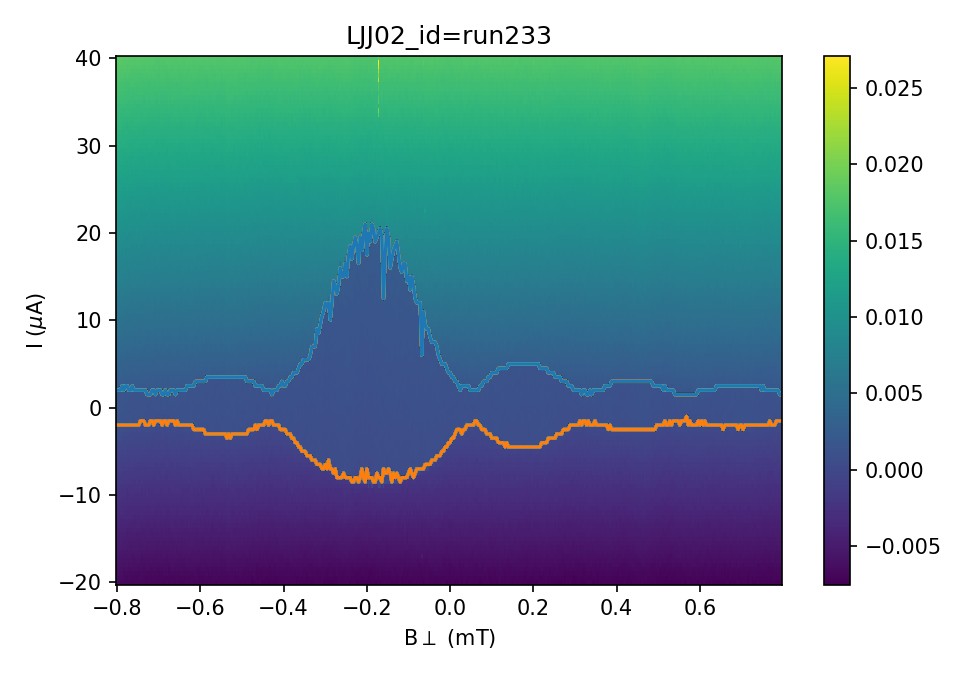

In [89]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_233[Arange:Brange,:]/1e-3, I_233[Arange:Brange,:]/1e-6, V_233[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run233')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_233[Arange:Brange,:]/1e-3,Is_233[Arange:Brange]/1e-6)
plt.plot(By_233[Arange:Brange,:]/1e-3,Ir_233[Arange:Brange]/1e-6)

np.savetxt('Is_233.csv', (Is_233), fmt='%s', delimiter=',')
np.savetxt('Ir_233.csv', (Ir_233), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 234 IV_By_60 degree 

In [5]:
runid=234
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [6]:
By_234=By_field
I_234=I
V_234=V
R_234=R_DC1

np.savetxt('L01_234_By.csv', (By_234), fmt='%s', delimiter=',')
np.savetxt('L01_234_I.csv', (I_234), fmt='%s', delimiter=',')
np.savetxt('L01_234_V.csv', (V_234), fmt='%s', delimiter=',')
np.savetxt('L01_234_R.csv', (R_234), fmt='%s', delimiter=',')

In [18]:
By_234=np.loadtxt('L01_234_By.csv', delimiter=",")
I_234=np.loadtxt('L01_234_I.csv', delimiter=",")
V_234=np.loadtxt('L01_234_V.csv', delimiter=",")
R_234=np.loadtxt('L01_234_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


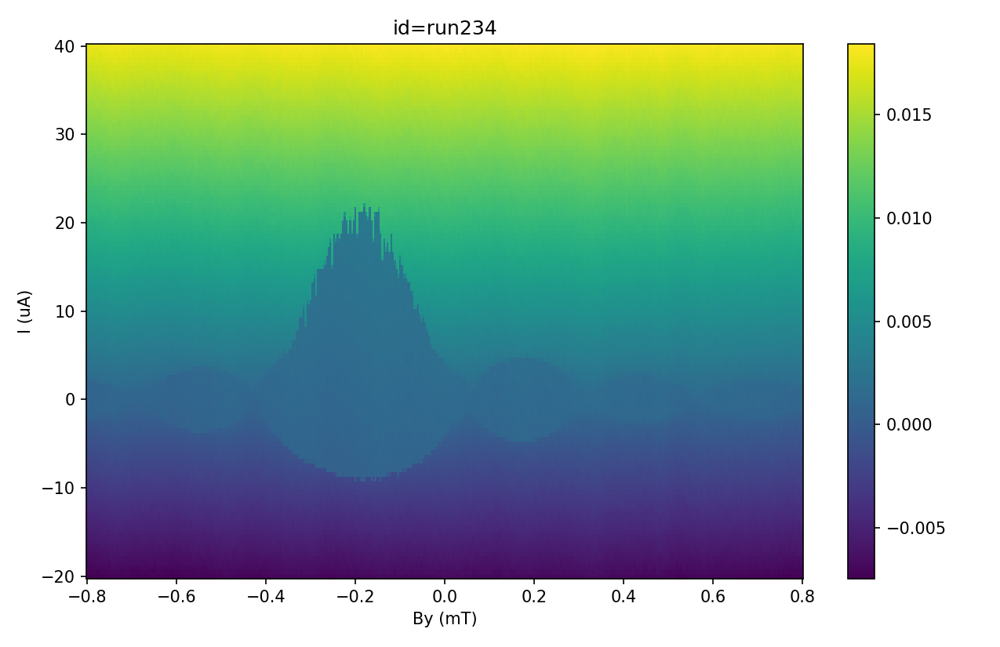

In [7]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_234/1e-3, I_234/1e-6, V_234/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run234')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


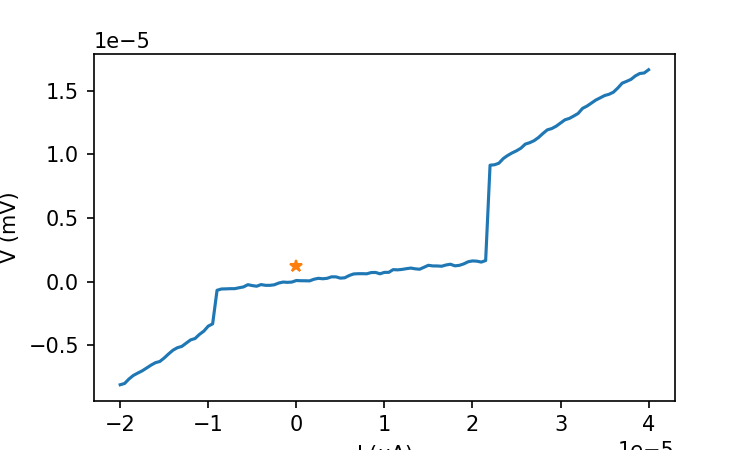

1.2158212899999998e-06


In [8]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_234[150,30:50])
plt.plot(I_234[150,:],V_234[150,:]-DCoff)
plt.plot(I_234[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [9]:
saiz=np.shape(V_234)
# print(saiz)
Is_234=np.zeros(saiz[0])
Ir_234=np.zeros(saiz[0])
fV_234=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_234)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_234[i,30:50])
        if V_234[i,j]-DCoff > 6e-7:
            Is_234[i]=I_234[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_234[i,30:50])
        if -V_234[i,j]-DCoff < 6e-7:
            Ir_234[i]=I_234[i,j]
            break

In [11]:
saiz=np.shape(V_234)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_234)
for i in range(100,210):
    for j in range(40,120):
        if R_234[i,j] > 1:
            Is_234[i]=I_234[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_234[i,j] > 0.5:
            Ir_234[i]=I_234[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


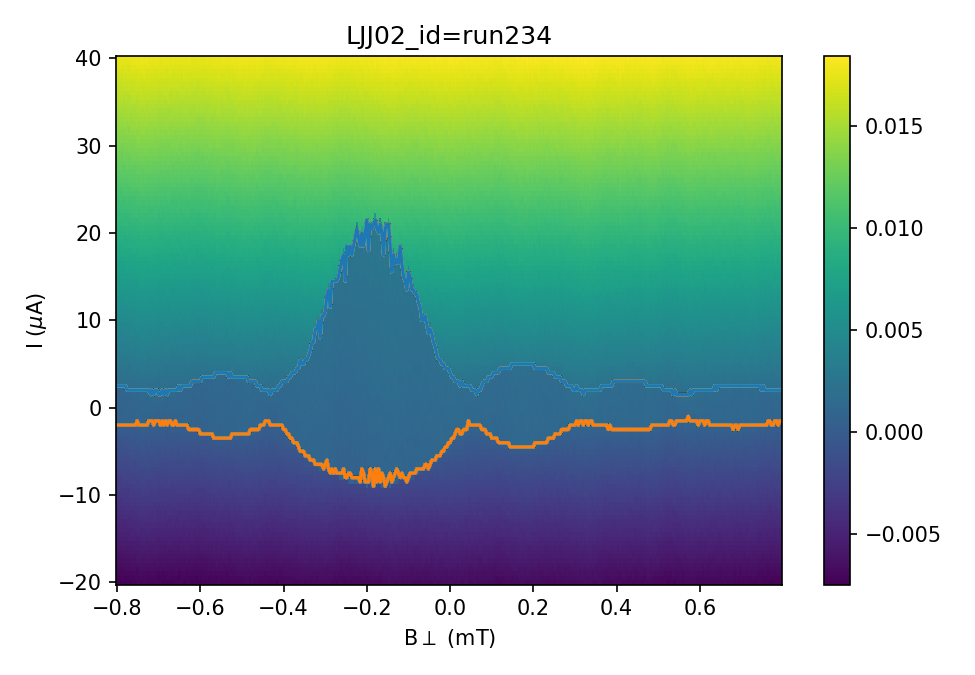

In [12]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_234[Arange:Brange,:]/1e-3, I_234[Arange:Brange,:]/1e-6, V_234[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run234')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_234[Arange:Brange,:]/1e-3,Is_234[Arange:Brange]/1e-6)
plt.plot(By_234[Arange:Brange,:]/1e-3,Ir_234[Arange:Brange]/1e-6)

np.savetxt('Is_234.csv', (Is_234), fmt='%s', delimiter=',')
np.savetxt('Ir_234.csv', (Ir_234), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 235 IV_By_90 degree 

In [13]:
runid=235
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [14]:
By_235=By_field
I_235=I
V_235=V
R_235=R_DC1

np.savetxt('L01_235_By.csv', (By_235), fmt='%s', delimiter=',')
np.savetxt('L01_235_I.csv', (I_235), fmt='%s', delimiter=',')
np.savetxt('L01_235_V.csv', (V_235), fmt='%s', delimiter=',')
np.savetxt('L01_235_R.csv', (R_235), fmt='%s', delimiter=',')

In [18]:
By_235=np.loadtxt('L01_235_By.csv', delimiter=",")
I_235=np.loadtxt('L01_235_I.csv', delimiter=",")
V_235=np.loadtxt('L01_235_V.csv', delimiter=",")
R_235=np.loadtxt('L01_235_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


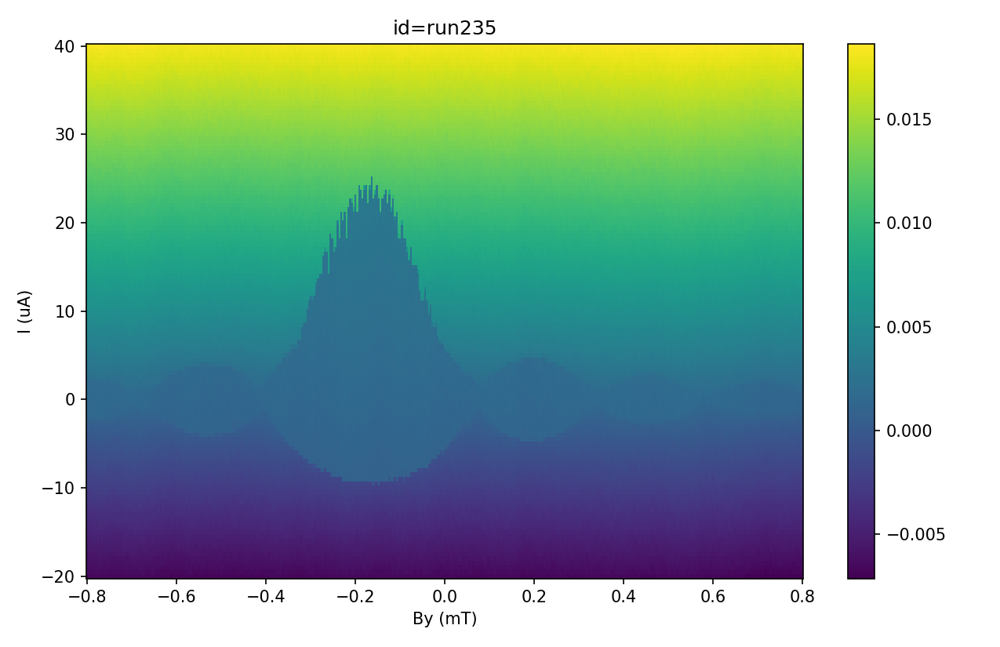

In [15]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_235/1e-3, I_235/1e-6, V_235/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run235')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


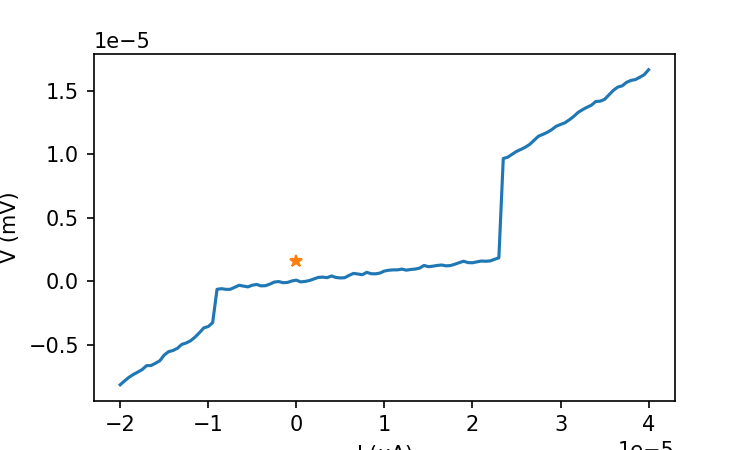

1.5746105e-06


In [16]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_235[150,30:50])
plt.plot(I_235[150,:],V_235[150,:]-DCoff)
plt.plot(I_235[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [17]:
saiz=np.shape(V_235)
# print(saiz)
Is_235=np.zeros(saiz[0])
Ir_235=np.zeros(saiz[0])
fV_235=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_235)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_235[i,30:50])
        if V_235[i,j]-DCoff > 6e-7:
            Is_235[i]=I_235[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_235[i,30:50])
        if -V_235[i,j]-DCoff < 6e-7:
            Ir_235[i]=I_235[i,j]
            break

In [18]:
saiz=np.shape(V_235)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_235)
for i in range(100,210):
    for j in range(40,120):
        if R_235[i,j] > 1:
            Is_235[i]=I_235[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_235[i,j] > 0.5:
            Ir_235[i]=I_235[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


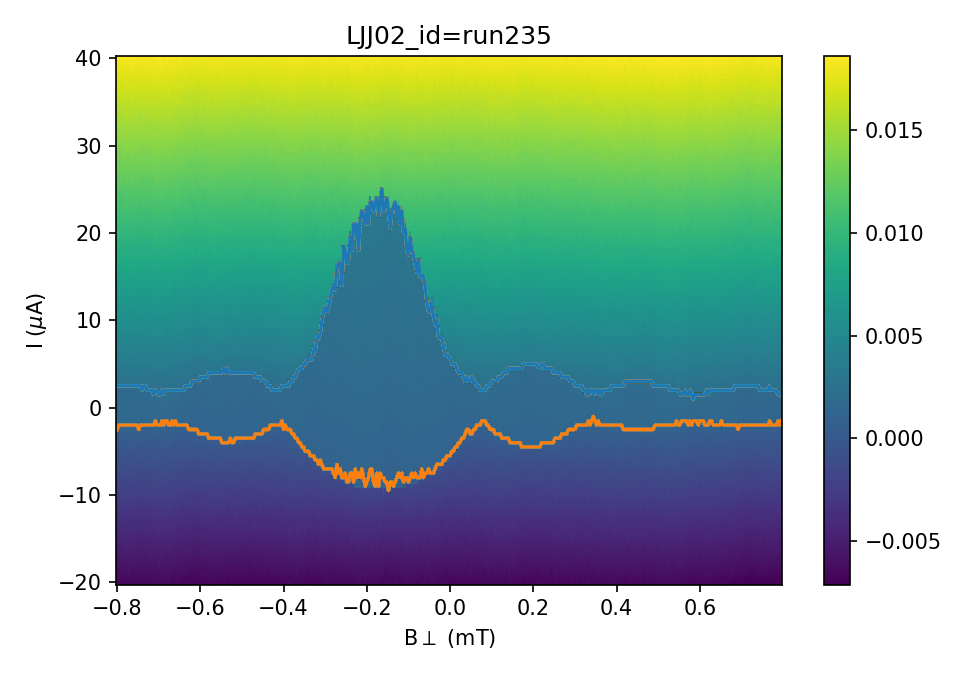

In [19]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_235[Arange:Brange,:]/1e-3, I_235[Arange:Brange,:]/1e-6, V_235[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run235')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_235[Arange:Brange,:]/1e-3,Is_235[Arange:Brange]/1e-6)
plt.plot(By_235[Arange:Brange,:]/1e-3,Ir_235[Arange:Brange]/1e-6)

np.savetxt('Is_235.csv', (Is_235), fmt='%s', delimiter=',')
np.savetxt('Ir_235.csv', (Ir_235), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 236 IV_By_120 degree 

In [20]:
runid=236
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [21]:
By_236=By_field
I_236=I
V_236=V
R_236=R_DC1

np.savetxt('L01_236_By.csv', (By_236), fmt='%s', delimiter=',')
np.savetxt('L01_236_I.csv', (I_236), fmt='%s', delimiter=',')
np.savetxt('L01_236_V.csv', (V_236), fmt='%s', delimiter=',')
np.savetxt('L01_236_R.csv', (R_236), fmt='%s', delimiter=',')

In [36]:
By_236=np.loadtxt('L01_236_By.csv', delimiter=",")
I_236=np.loadtxt('L01_236_I.csv', delimiter=",")
V_236=np.loadtxt('L01_236_V.csv', delimiter=",")
R_236=np.loadtxt('L01_236_R.csv', delimiter=",")
Is_236=np.loadtxt('Is_236.csv', delimiter=",")
Ir_236=np.loadtxt('Ir_236.csv', delimiter=",")

<IPython.core.display.Javascript object>


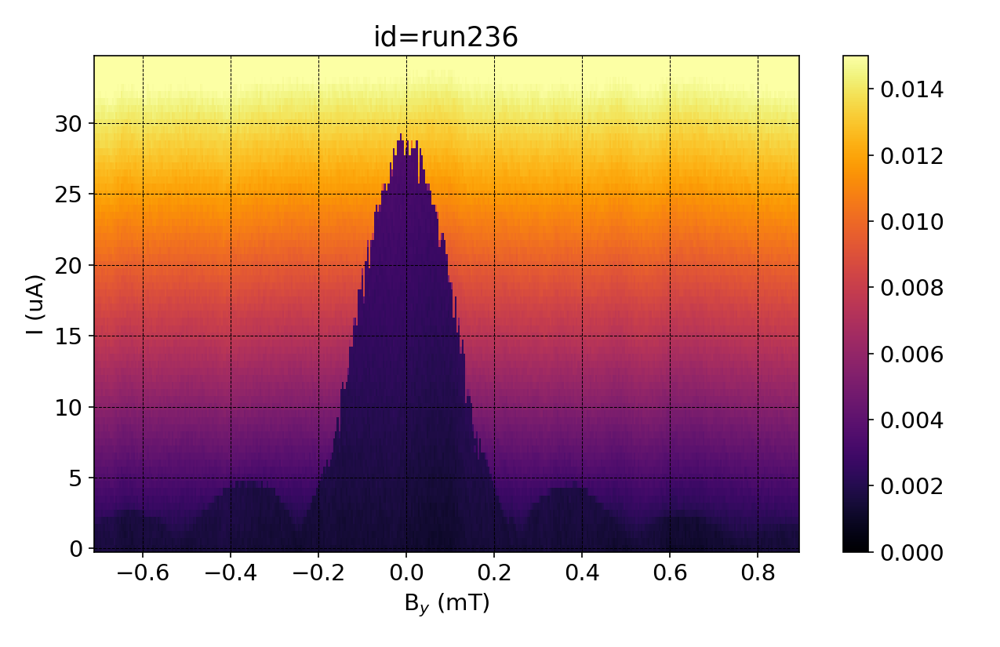

In [43]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=40
Brange=110

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_236[:,Arange:Brange]/1e-3+0.092, I_236[:,Arange:Brange]/1e-6, V_236[:,Arange:Brange]/1e-3, cmap = 'inferno', vmax=0.015, vmin=0)

# im = ax0.pcolormesh(By_236/1e-3, I_236/1e-6, V_236/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run236')
ax0.set(xlabel='B$_y$ (mT)', ylabel='I (uA)') 


fig.tight_layout()
plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
plt.show()

<IPython.core.display.Javascript object>


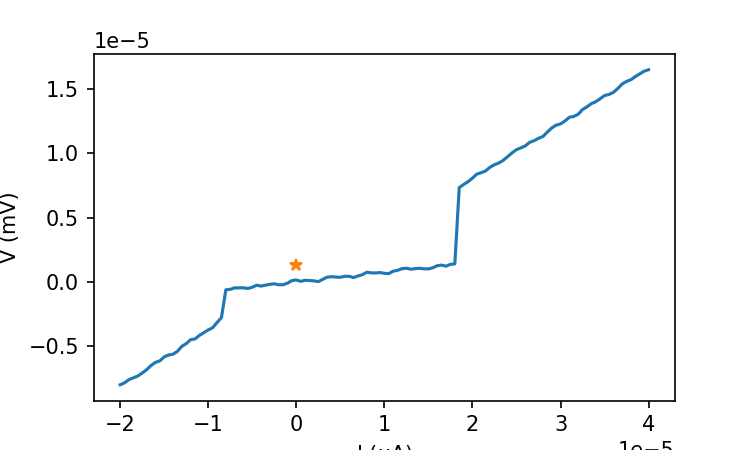

1.352436935e-06


In [23]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_236[150,30:50])
plt.plot(I_236[150,:],V_236[150,:]-DCoff)
plt.plot(I_236[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [24]:
saiz=np.shape(V_236)
# print(saiz)
Is_236=np.zeros(saiz[0])
Ir_236=np.zeros(saiz[0])
fV_236=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_236)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_236[i,30:50])
        if V_236[i,j]-DCoff > 6e-7:
            Is_236[i]=I_236[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_236[i,30:50])
        if -V_236[i,j]-DCoff < 6e-7:
            Ir_236[i]=I_236[i,j]
            break

In [29]:
saiz=np.shape(V_236)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_236)
for i in range(100,230):
    for j in range(40,120):
        if R_236[i,j] > 1:
            Is_236[i]=I_236[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_236[i,j] > 0.5:
            Ir_236[i]=I_236[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


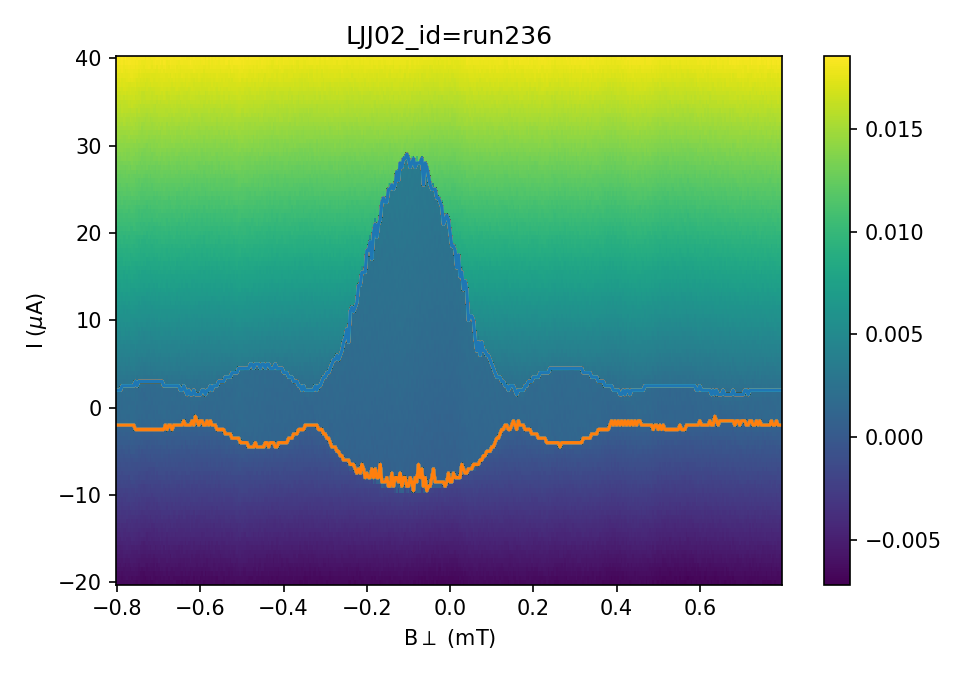

In [30]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_236[Arange:Brange,:]/1e-3, I_236[Arange:Brange,:]/1e-6, V_236[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run236')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_236[Arange:Brange,:]/1e-3,Is_236[Arange:Brange]/1e-6)
plt.plot(By_236[Arange:Brange,:]/1e-3,Ir_236[Arange:Brange]/1e-6)

np.savetxt('Is_236.csv', (Is_236), fmt='%s', delimiter=',')
np.savetxt('Ir_236.csv', (Ir_236), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 237 IV_By_150 degree 

In [31]:
runid=237
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [32]:
By_237=By_field
I_237=I
V_237=V
R_237=R_DC1

np.savetxt('L01_237_By.csv', (By_237), fmt='%s', delimiter=',')
np.savetxt('L01_237_I.csv', (I_237), fmt='%s', delimiter=',')
np.savetxt('L01_237_V.csv', (V_237), fmt='%s', delimiter=',')
np.savetxt('L01_237_R.csv', (R_237), fmt='%s', delimiter=',')

In [18]:
By_237=np.loadtxt('L01_237_By.csv', delimiter=",")
I_237=np.loadtxt('L01_237_I.csv', delimiter=",")
V_237=np.loadtxt('L01_237_V.csv', delimiter=",")
R_237=np.loadtxt('L01_237_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


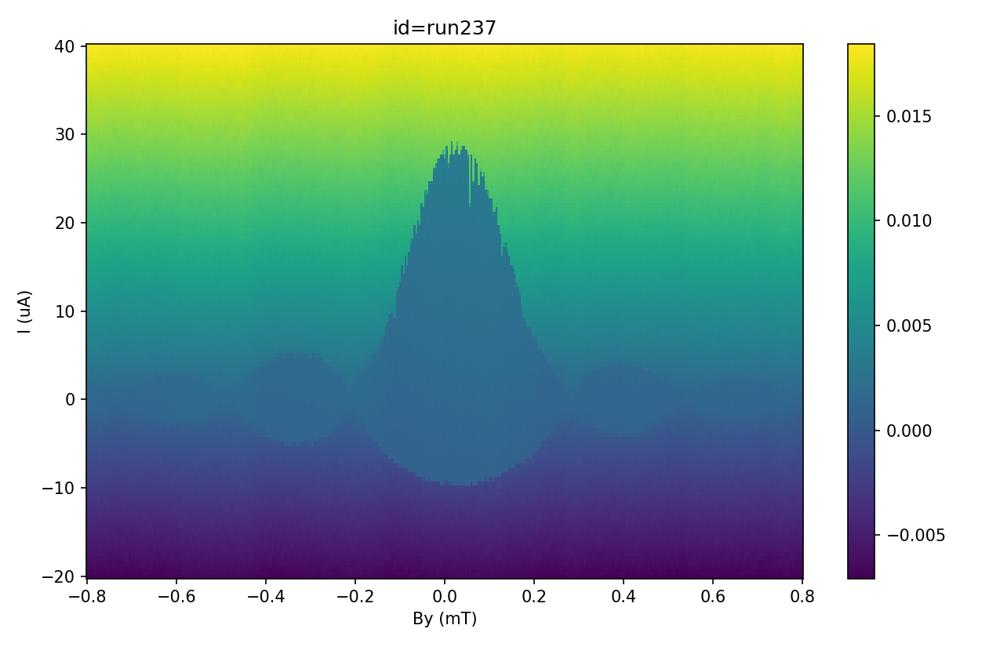

In [33]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_237/1e-3, I_237/1e-6, V_237/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run237')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


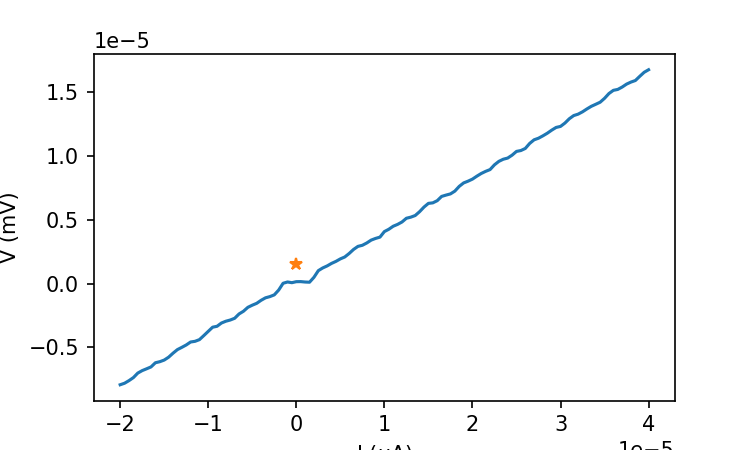

1.5201339205e-06


In [34]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_237[150,30:50])
plt.plot(I_237[150,:],V_237[150,:]-DCoff)
plt.plot(I_237[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [35]:
saiz=np.shape(V_237)
# print(saiz)
Is_237=np.zeros(saiz[0])
Ir_237=np.zeros(saiz[0])
fV_237=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_237)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_237[i,30:50])
        if V_237[i,j]-DCoff > 6e-7:
            Is_237[i]=I_237[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_237[i,30:50])
        if -V_237[i,j]-DCoff < 6e-7:
            Ir_237[i]=I_237[i,j]
            break

In [43]:
saiz=np.shape(V_237)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_237)
for i in range(100,250):
    for j in range(40,120):
        if R_237[i,j] > 1:
            Is_237[i]=I_237[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_237[i,j] > 0.5:
            Ir_237[i]=I_237[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


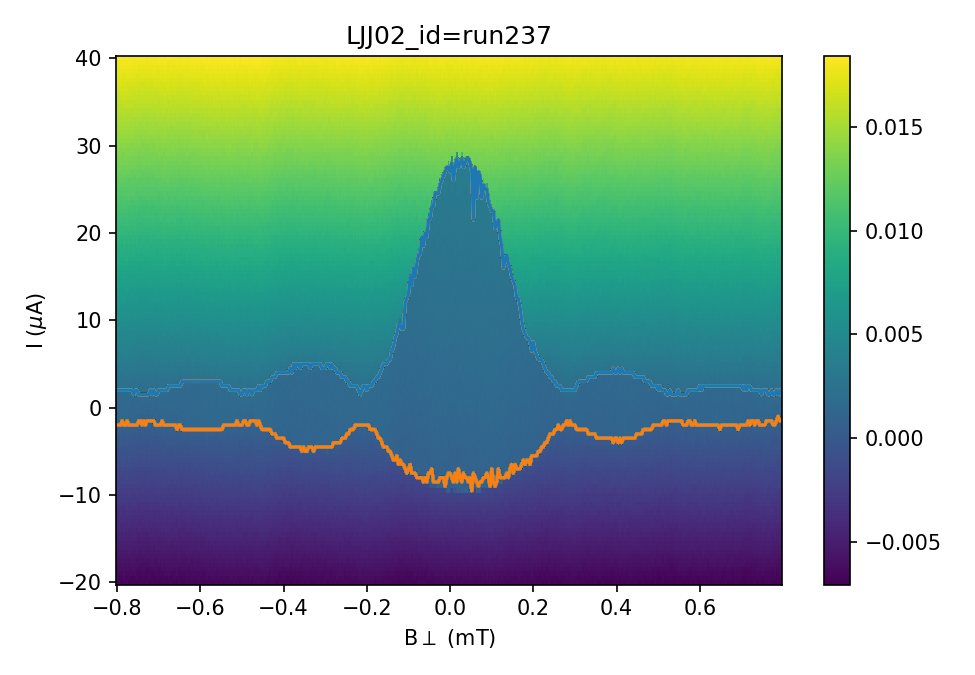

In [44]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_237[Arange:Brange,:]/1e-3, I_237[Arange:Brange,:]/1e-6, V_237[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run237')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_237[Arange:Brange,:]/1e-3,Is_237[Arange:Brange]/1e-6)
plt.plot(By_237[Arange:Brange,:]/1e-3,Ir_237[Arange:Brange]/1e-6)

np.savetxt('Is_237.csv', (Is_237), fmt='%s', delimiter=',')
np.savetxt('Ir_237.csv', (Ir_237), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 238 IV_By_180 degree 

In [45]:
runid=238
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [46]:
By_238=By_field
I_238=I
V_238=V
R_238=R_DC1

np.savetxt('L01_238_By.csv', (By_238), fmt='%s', delimiter=',')
np.savetxt('L01_238_I.csv', (I_238), fmt='%s', delimiter=',')
np.savetxt('L01_238_V.csv', (V_238), fmt='%s', delimiter=',')
np.savetxt('L01_238_R.csv', (R_238), fmt='%s', delimiter=',')

In [18]:
By_238=np.loadtxt('L01_238_By.csv', delimiter=",")
I_238=np.loadtxt('L01_238_I.csv', delimiter=",")
V_238=np.loadtxt('L01_238_V.csv', delimiter=",")
R_238=np.loadtxt('L01_238_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


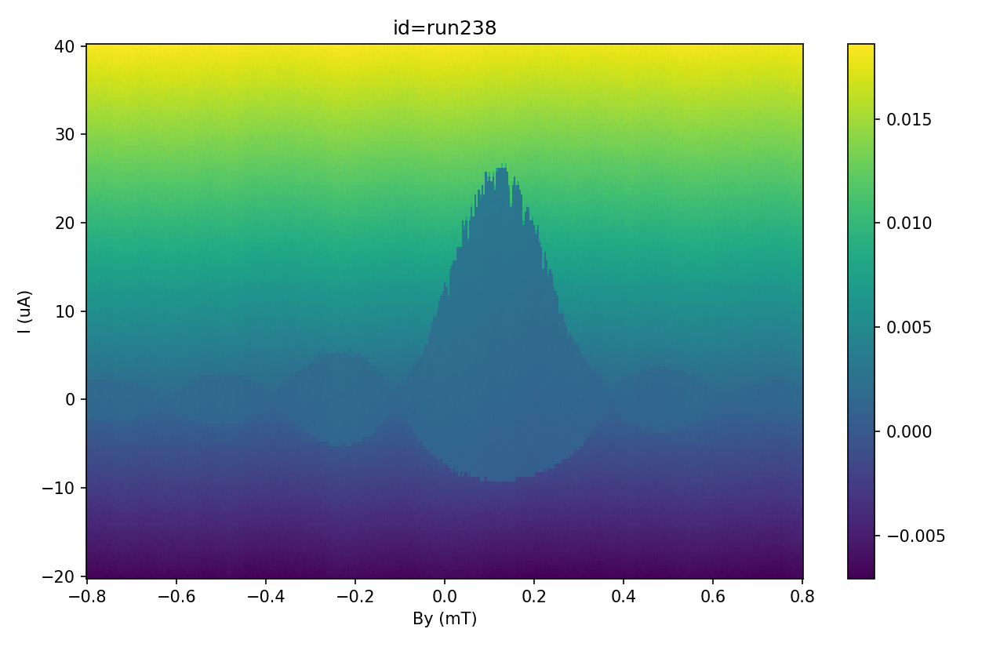

In [47]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_238/1e-3, I_238/1e-6, V_238/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run238')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


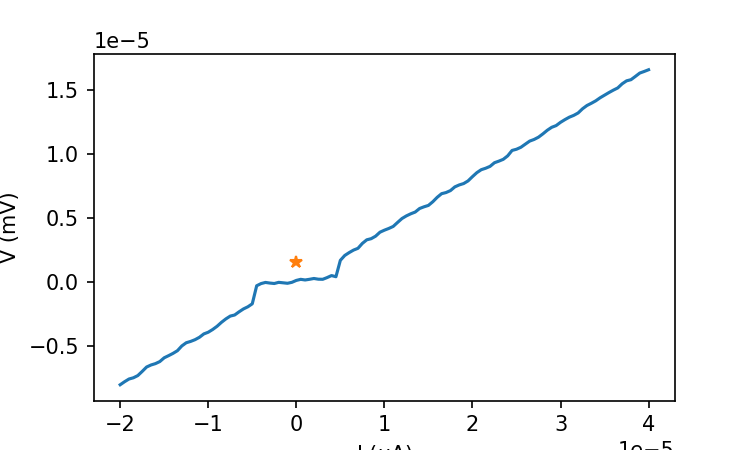

1.576159525e-06


In [48]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_238[150,30:50])
plt.plot(I_238[150,:],V_238[150,:]-DCoff)
plt.plot(I_238[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [49]:
saiz=np.shape(V_238)
# print(saiz)
Is_238=np.zeros(saiz[0])
Ir_238=np.zeros(saiz[0])
fV_238=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_238)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_238[i,30:50])
        if V_238[i,j]-DCoff > 6e-7:
            Is_238[i]=I_238[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_238[i,30:50])
        if -V_238[i,j]-DCoff < 6e-7:
            Ir_238[i]=I_238[i,j]
            break

In [52]:
saiz=np.shape(V_238)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_238)
for i in range(120,280):
    for j in range(40,120):
        if R_238[i,j] > 1:
            Is_238[i]=I_238[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_238[i,j] > 0.5:
            Ir_238[i]=I_238[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


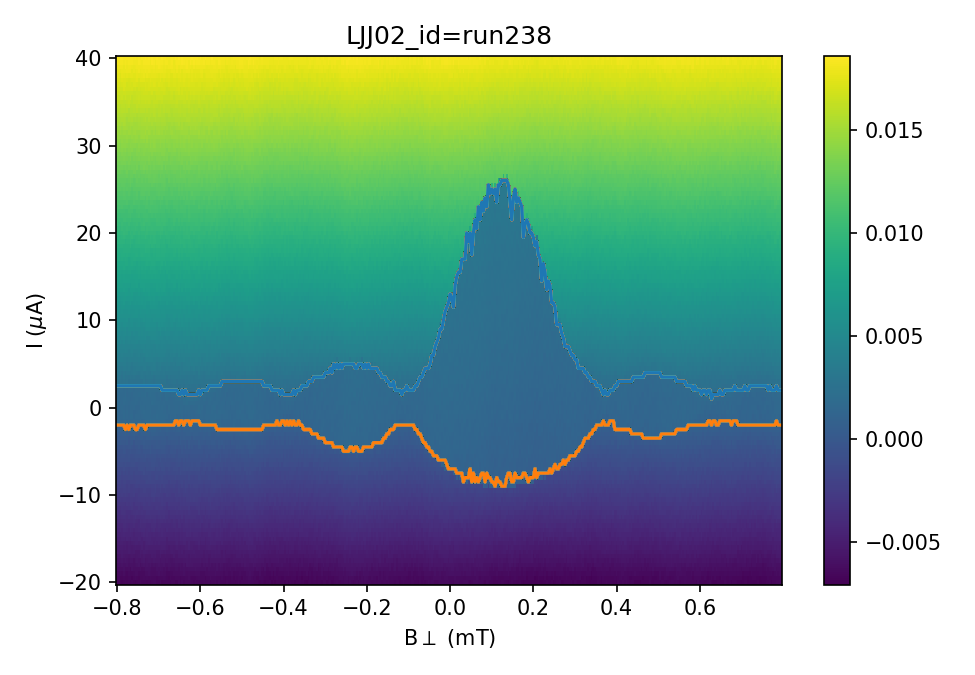

In [53]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_238[Arange:Brange,:]/1e-3, I_238[Arange:Brange,:]/1e-6, V_238[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run238')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_238[Arange:Brange,:]/1e-3,Is_238[Arange:Brange]/1e-6)
plt.plot(By_238[Arange:Brange,:]/1e-3,Ir_238[Arange:Brange]/1e-6)

np.savetxt('Is_238.csv', (Is_238), fmt='%s', delimiter=',')
np.savetxt('Ir_238.csv', (Ir_238), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 239 IV_By_210 degree 

In [54]:
runid=239
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [55]:
By_239=By_field
I_239=I
V_239=V
R_239=R_DC1

np.savetxt('L01_239_By.csv', (By_239), fmt='%s', delimiter=',')
np.savetxt('L01_239_I.csv', (I_239), fmt='%s', delimiter=',')
np.savetxt('L01_239_V.csv', (V_239), fmt='%s', delimiter=',')
np.savetxt('L01_239_R.csv', (R_239), fmt='%s', delimiter=',')

In [46]:
By_239=np.loadtxt('L01_239_By.csv', delimiter=",")
I_239=np.loadtxt('L01_239_I.csv', delimiter=",")
V_239=np.loadtxt('L01_239_V.csv', delimiter=",")
R_239=np.loadtxt('L01_239_R.csv', delimiter=",")
Is_239=np.loadtxt('Is_239.csv', delimiter=",")
Ir_239=np.loadtxt('Ir_239.csv', delimiter=",")

<IPython.core.display.Javascript object>


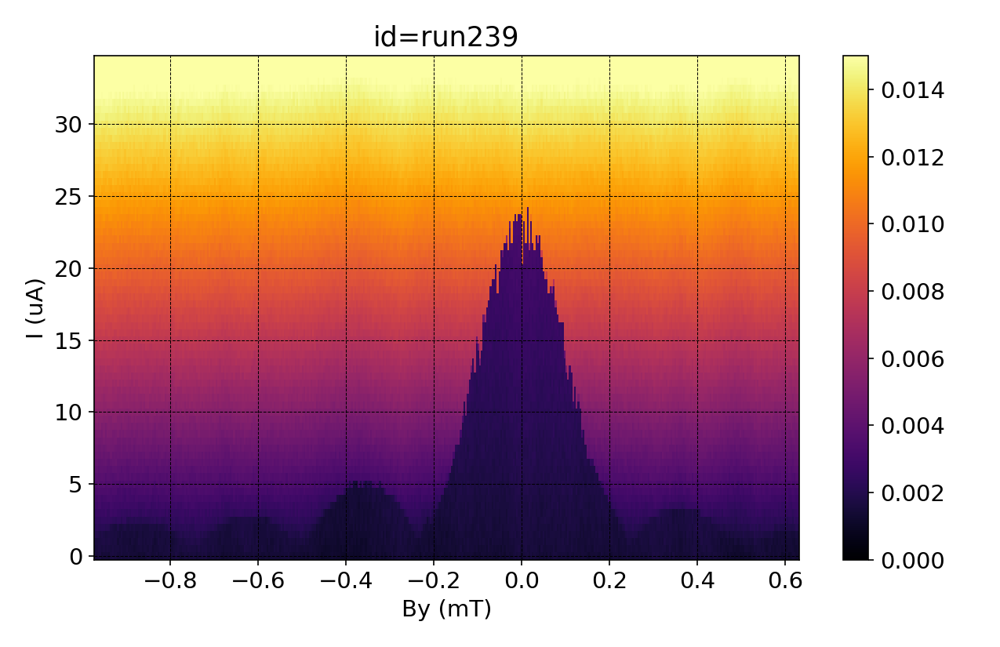

In [50]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=40
Brange=110

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(By_239/1e-3, I_239/1e-6, V_239/1e-3, cmap = 'viridis')#, vmax=1
im = ax0.pcolormesh(By_239[:,Arange:Brange]/1e-3-0.171, I_239[:,Arange:Brange]/1e-6, V_239[:,Arange:Brange]/1e-3, cmap = 'inferno', vmax=0.015, vmin=0)
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run239')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
plt.show()

<IPython.core.display.Javascript object>


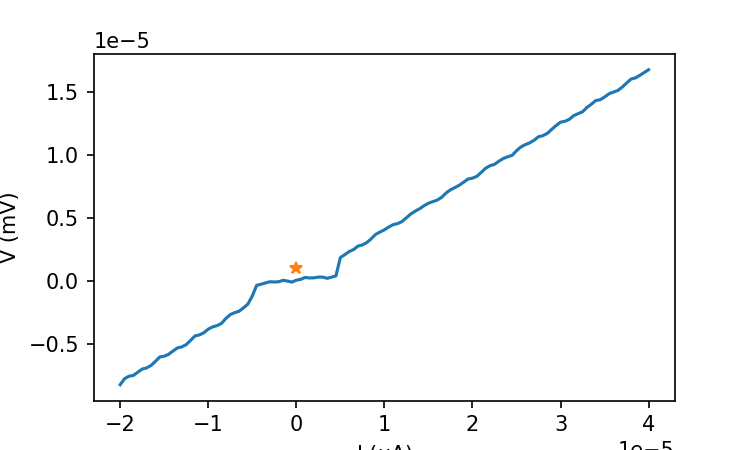

1.0203749e-06


In [57]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_239[150,30:50])
plt.plot(I_239[150,:],V_239[150,:]-DCoff)
plt.plot(I_239[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [58]:
saiz=np.shape(V_239)
# print(saiz)
Is_239=np.zeros(saiz[0])
Ir_239=np.zeros(saiz[0])
fV_239=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_239)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_239[i,30:50])
        if V_239[i,j]-DCoff > 6e-7:
            Is_239[i]=I_239[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_239[i,30:50])
        if -V_239[i,j]-DCoff < 6e-7:
            Ir_239[i]=I_239[i,j]
            break

In [59]:
saiz=np.shape(V_239)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_239)
for i in range(100,280):
    for j in range(40,120):
        if R_239[i,j] > 1:
            Is_239[i]=I_239[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_239[i,j] > 0.5:
            Ir_239[i]=I_239[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


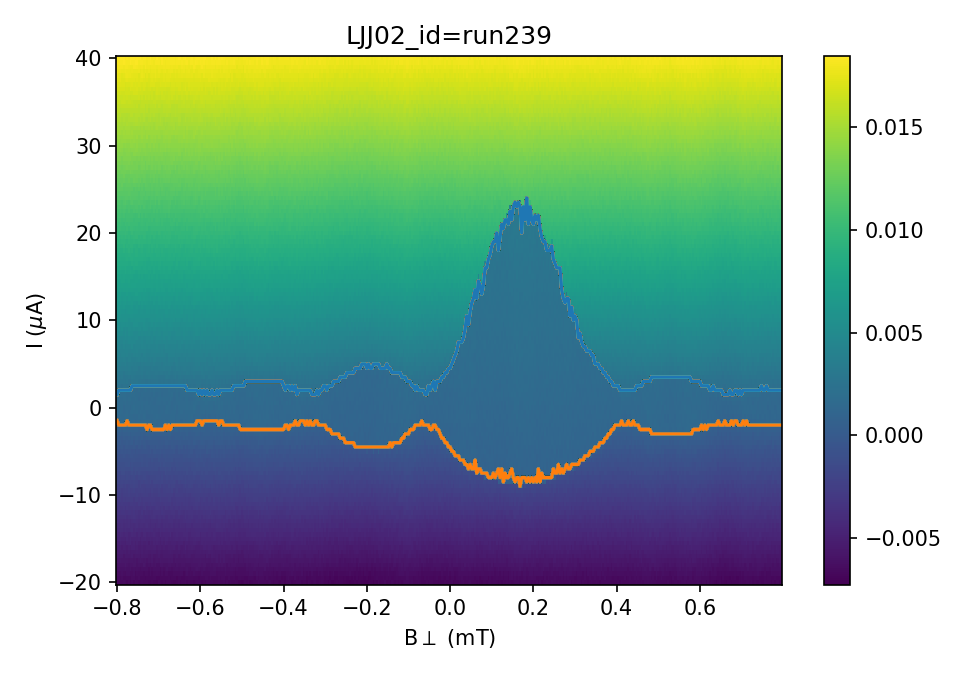

In [60]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_239[Arange:Brange,:]/1e-3, I_239[Arange:Brange,:]/1e-6, V_239[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run239')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_239[Arange:Brange,:]/1e-3,Is_239[Arange:Brange]/1e-6)
plt.plot(By_239[Arange:Brange,:]/1e-3,Ir_239[Arange:Brange]/1e-6)

np.savetxt('Is_239.csv', (Is_239), fmt='%s', delimiter=',')
np.savetxt('Ir_239.csv', (Ir_239), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 240 IV_By_240 degree 

In [61]:
runid=240
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [62]:
By_240=By_field
I_240=I
V_240=V
R_240=R_DC1

np.savetxt('L01_240_By.csv', (By_240), fmt='%s', delimiter=',')
np.savetxt('L01_240_I.csv', (I_240), fmt='%s', delimiter=',')
np.savetxt('L01_240_V.csv', (V_240), fmt='%s', delimiter=',')
np.savetxt('L01_240_R.csv', (R_240), fmt='%s', delimiter=',')

In [18]:
By_240=np.loadtxt('L01_240_By.csv', delimiter=",")
I_240=np.loadtxt('L01_240_I.csv', delimiter=",")
V_240=np.loadtxt('L01_240_V.csv', delimiter=",")
R_240=np.loadtxt('L01_240_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


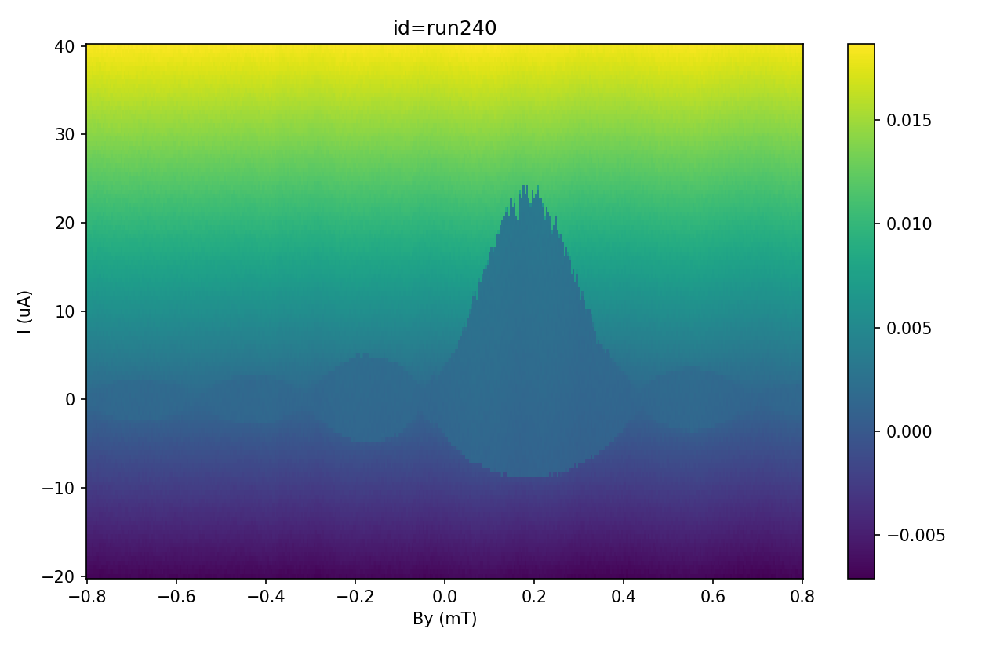

In [63]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_240/1e-3, I_240/1e-6, V_240/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run240')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


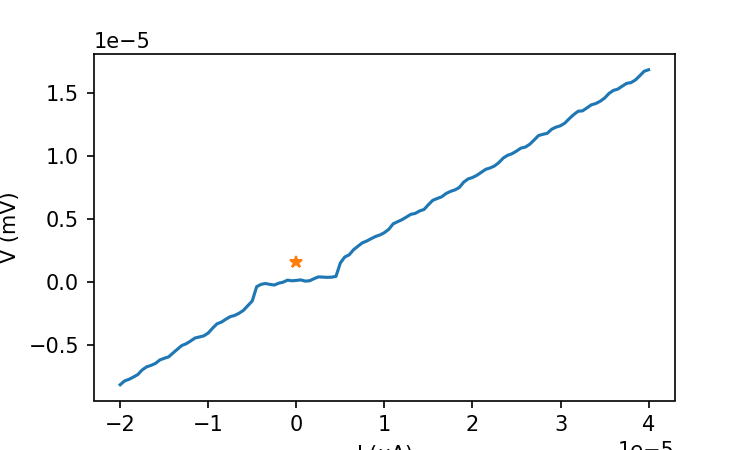

1.569849853e-06


In [64]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_240[150,30:50])
plt.plot(I_240[150,:],V_240[150,:]-DCoff)
plt.plot(I_240[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [65]:
saiz=np.shape(V_240)
# print(saiz)
Is_240=np.zeros(saiz[0])
Ir_240=np.zeros(saiz[0])
fV_240=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_240)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_240[i,30:50])
        if V_240[i,j]-DCoff > 6e-7:
            Is_240[i]=I_240[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_240[i,30:50])
        if -V_240[i,j]-DCoff < 6e-7:
            Ir_240[i]=I_240[i,j]
            break

In [69]:
saiz=np.shape(V_240)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_240)
for i in range(100,300):
    for j in range(40,120):
        if R_240[i,j] > 1:
            Is_240[i]=I_240[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_240[i,j] > 0.5:
            Ir_240[i]=I_240[i,j]
            break

(401, 121)


C:\Users\chung\AppData\Local\Temp/ipykernel_20800/1066001464.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))


<IPython.core.display.Javascript object>


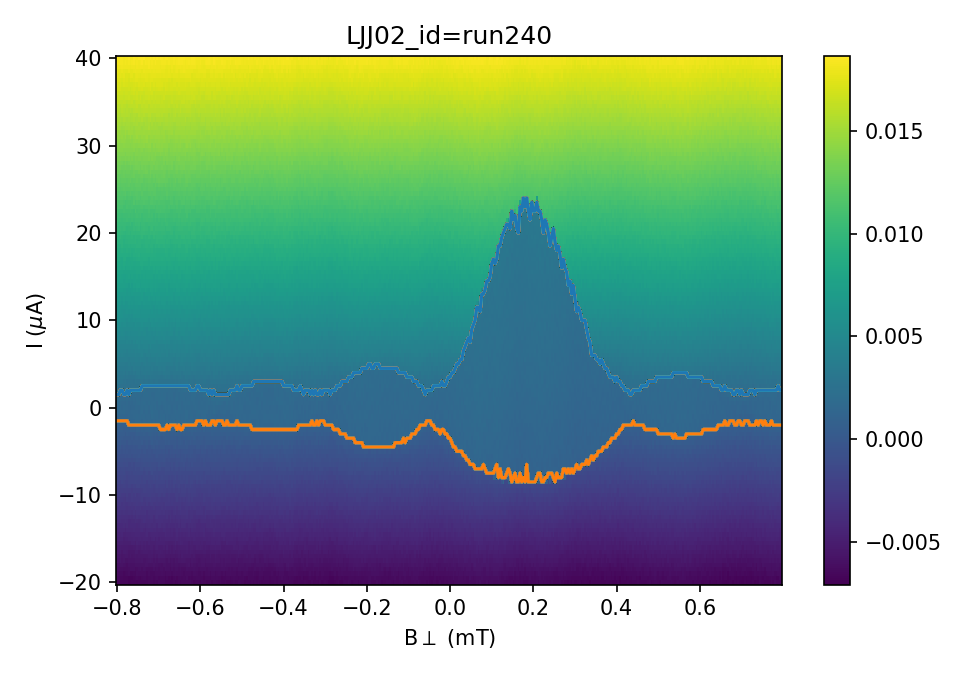

In [70]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_240[Arange:Brange,:]/1e-3, I_240[Arange:Brange,:]/1e-6, V_240[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run240')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_240[Arange:Brange,:]/1e-3,Is_240[Arange:Brange]/1e-6)
plt.plot(By_240[Arange:Brange,:]/1e-3,Ir_240[Arange:Brange]/1e-6)

np.savetxt('Is_240.csv', (Is_240), fmt='%s', delimiter=',')
np.savetxt('Ir_240.csv', (Ir_240), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 241 IV_By_270 degree 

In [71]:
runid=241
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [72]:
By_241=By_field
I_241=I
V_241=V
R_241=R_DC1

np.savetxt('L01_241_By.csv', (By_241), fmt='%s', delimiter=',')
np.savetxt('L01_241_I.csv', (I_241), fmt='%s', delimiter=',')
np.savetxt('L01_241_V.csv', (V_241), fmt='%s', delimiter=',')
np.savetxt('L01_241_R.csv', (R_241), fmt='%s', delimiter=',')

In [18]:
By_241=np.loadtxt('L01_241_By.csv', delimiter=",")
I_241=np.loadtxt('L01_241_I.csv', delimiter=",")
V_241=np.loadtxt('L01_241_V.csv', delimiter=",")
R_241=np.loadtxt('L01_241_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


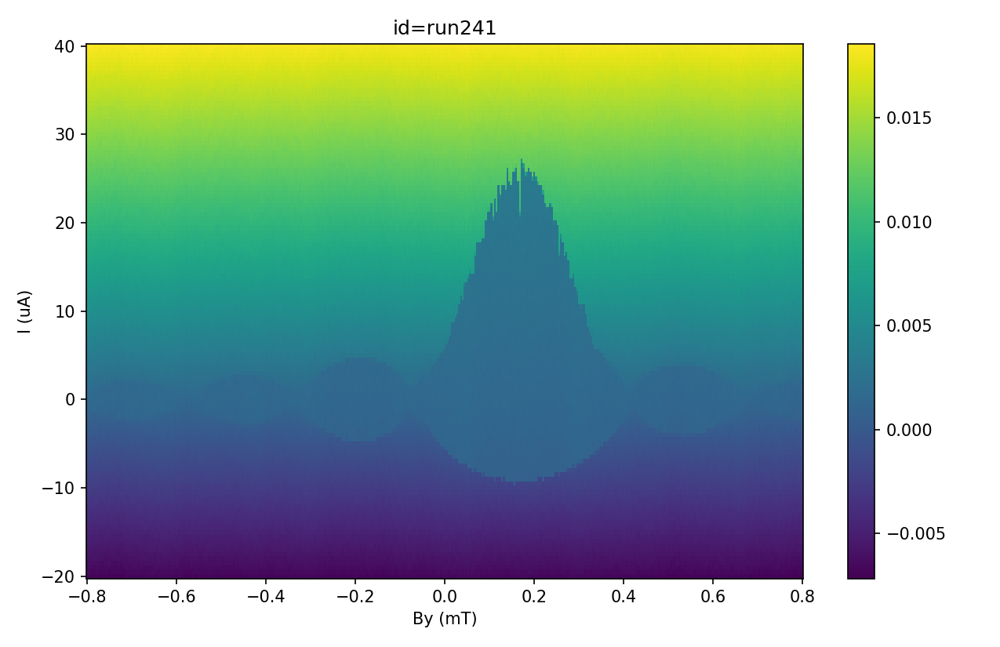

In [73]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_241/1e-3, I_241/1e-6, V_241/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run241')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


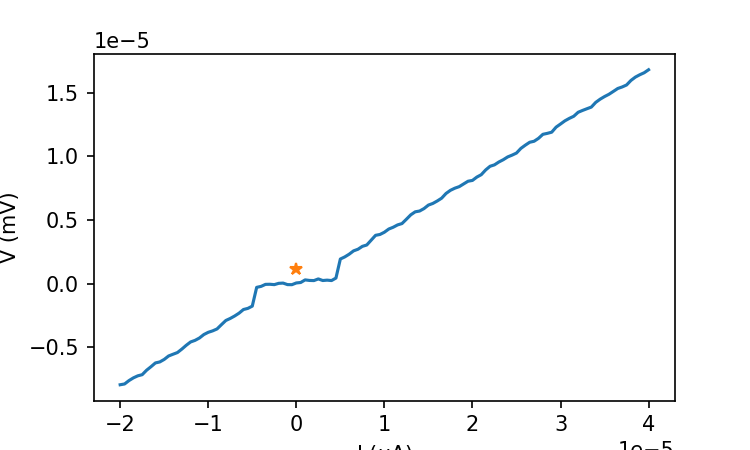

1.19096465e-06


In [74]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_241[150,30:50])
plt.plot(I_241[150,:],V_241[150,:]-DCoff)
plt.plot(I_241[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [75]:
saiz=np.shape(V_241)
# print(saiz)
Is_241=np.zeros(saiz[0])
Ir_241=np.zeros(saiz[0])
fV_241=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_241)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_241[i,30:50])
        if V_241[i,j]-DCoff > 6e-7:
            Is_241[i]=I_241[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_241[i,30:50])
        if -V_241[i,j]-DCoff < 6e-7:
            Ir_241[i]=I_241[i,j]
            break

In [76]:
saiz=np.shape(V_241)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_241)
for i in range(100,300):
    for j in range(40,120):
        if R_241[i,j] > 1:
            Is_241[i]=I_241[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_241[i,j] > 0.5:
            Ir_241[i]=I_241[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


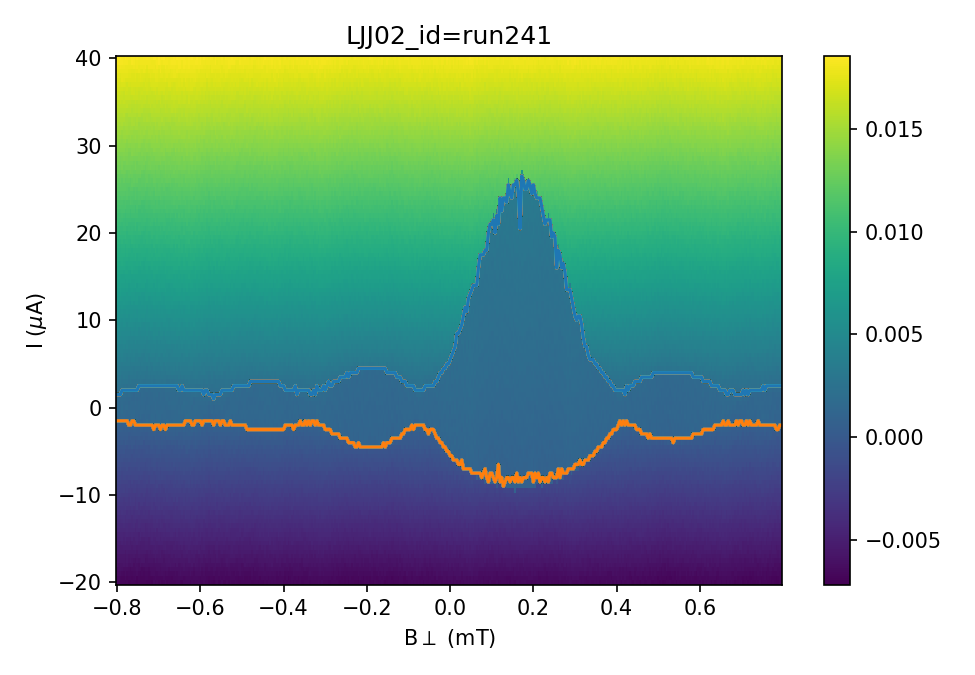

In [77]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_241[Arange:Brange,:]/1e-3, I_241[Arange:Brange,:]/1e-6, V_241[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run241')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_241[Arange:Brange,:]/1e-3,Is_241[Arange:Brange]/1e-6)
plt.plot(By_241[Arange:Brange,:]/1e-3,Ir_241[Arange:Brange]/1e-6)

np.savetxt('Is_241.csv', (Is_241), fmt='%s', delimiter=',')
np.savetxt('Ir_241.csv', (Ir_241), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 242 IV_By_300 degree 

In [78]:
runid=242
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [80]:
By_242=By_field
I_242=I
V_242=V
R_242=R_DC1

np.savetxt('L01_242_By.csv', (By_242), fmt='%s', delimiter=',')
np.savetxt('L01_242_I.csv', (I_242), fmt='%s', delimiter=',')
np.savetxt('L01_242_V.csv', (V_242), fmt='%s', delimiter=',')
np.savetxt('L01_242_R.csv', (R_242), fmt='%s', delimiter=',')

In [51]:
By_242=np.loadtxt('L01_242_By.csv', delimiter=",")
I_242=np.loadtxt('L01_242_I.csv', delimiter=",")
V_242=np.loadtxt('L01_242_V.csv', delimiter=",")
R_242=np.loadtxt('L01_242_R.csv', delimiter=",")
Is_242=np.loadtxt('Is_242.csv', delimiter=",")
Ir_242=np.loadtxt('Ir_242.csv', delimiter=",")

<IPython.core.display.Javascript object>


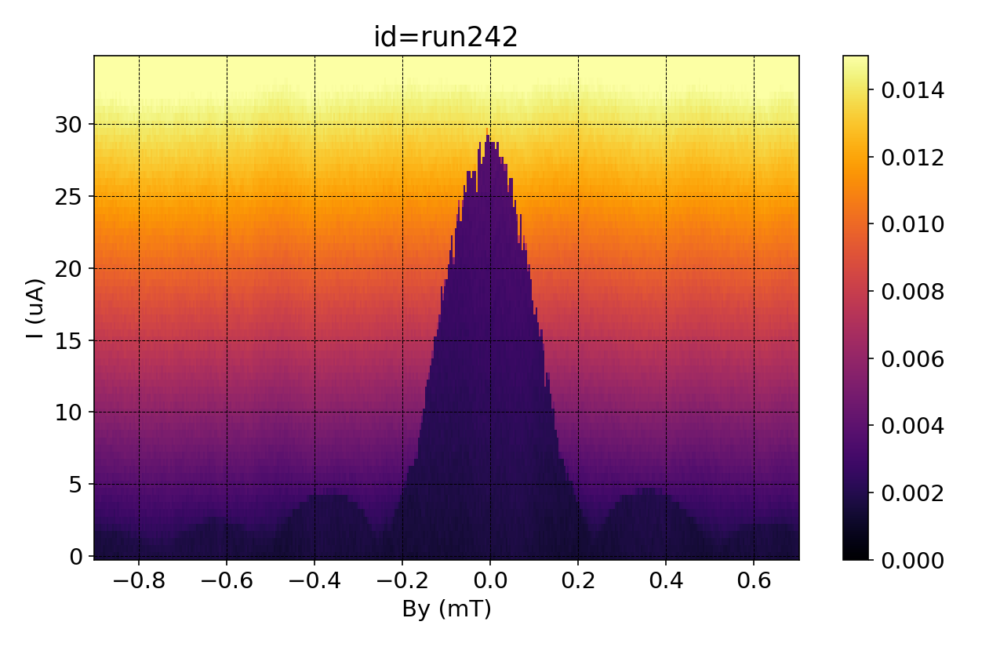

In [54]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=40
Brange=110

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(By_242/1e-3, I_242/1e-6, V_242/1e-3, cmap = 'viridis')#, vmax=1
im = ax0.pcolormesh(By_242[:,Arange:Brange]/1e-3-0.099, I_242[:,Arange:Brange]/1e-6, V_242[:,Arange:Brange]/1e-3, cmap = 'inferno', vmax=0.015, vmin=0)

fig.colorbar(im, ax=ax0)
ax0.set_title('id=run242')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
plt.show()

<IPython.core.display.Javascript object>


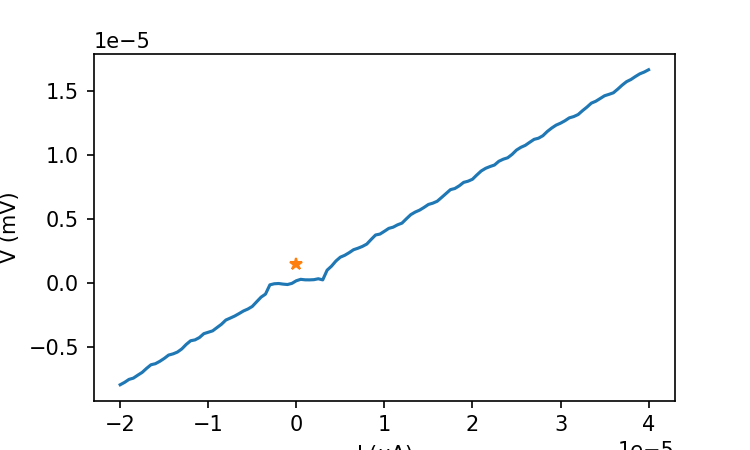

1.4653501949999998e-06


In [82]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_242[150,30:50])
plt.plot(I_242[150,:],V_242[150,:]-DCoff)
plt.plot(I_242[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [83]:
saiz=np.shape(V_242)
# print(saiz)
Is_242=np.zeros(saiz[0])
Ir_242=np.zeros(saiz[0])
fV_242=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_242)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_242[i,30:50])
        if V_242[i,j]-DCoff > 6e-7:
            Is_242[i]=I_242[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_242[i,30:50])
        if -V_242[i,j]-DCoff < 6e-7:
            Ir_242[i]=I_242[i,j]
            break

In [84]:
saiz=np.shape(V_242)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_242)
for i in range(100,300):
    for j in range(40,120):
        if R_242[i,j] > 1:
            Is_242[i]=I_242[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_242[i,j] > 0.5:
            Ir_242[i]=I_242[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


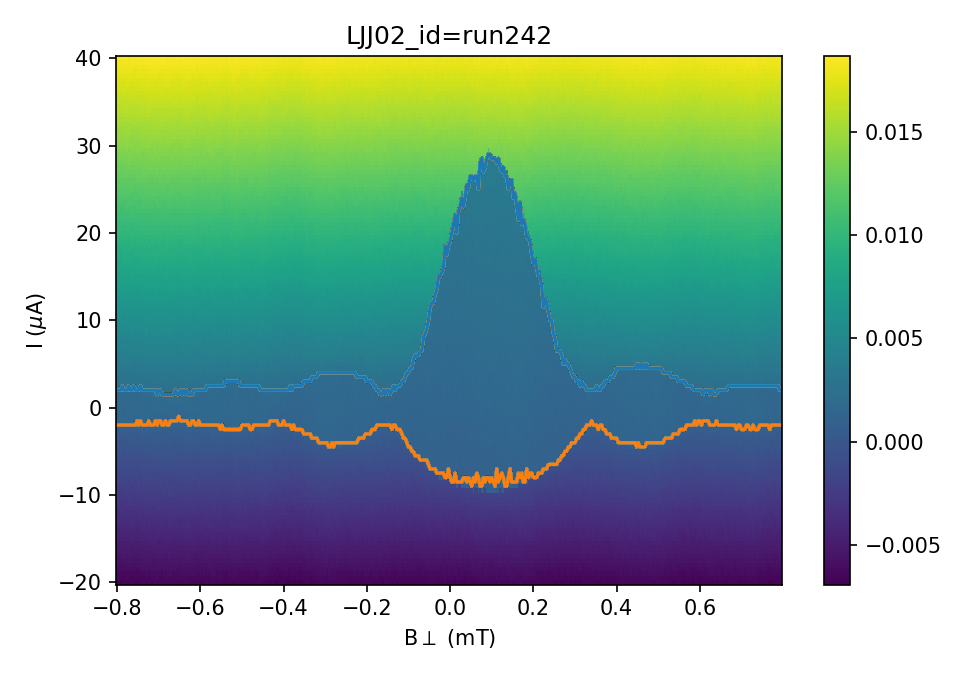

In [85]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_242[Arange:Brange,:]/1e-3, I_242[Arange:Brange,:]/1e-6, V_242[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run242')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_242[Arange:Brange,:]/1e-3,Is_242[Arange:Brange]/1e-6)
plt.plot(By_242[Arange:Brange,:]/1e-3,Ir_242[Arange:Brange]/1e-6)

np.savetxt('Is_242.csv', (Is_242), fmt='%s', delimiter=',')
np.savetxt('Ir_242.csv', (Ir_242), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 243 IV_By_330 degree 

In [86]:
runid=243
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [87]:
By_243=By_field
I_243=I
V_243=V
R_243=R_DC1

np.savetxt('L01_243_By.csv', (By_243), fmt='%s', delimiter=',')
np.savetxt('L01_243_I.csv', (I_243), fmt='%s', delimiter=',')
np.savetxt('L01_243_V.csv', (V_243), fmt='%s', delimiter=',')
np.savetxt('L01_243_R.csv', (R_243), fmt='%s', delimiter=',')

In [18]:
By_243=np.loadtxt('L01_243_By.csv', delimiter=",")
I_243=np.loadtxt('L01_243_I.csv', delimiter=",")
V_243=np.loadtxt('L01_243_V.csv', delimiter=",")
R_243=np.loadtxt('L01_243_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


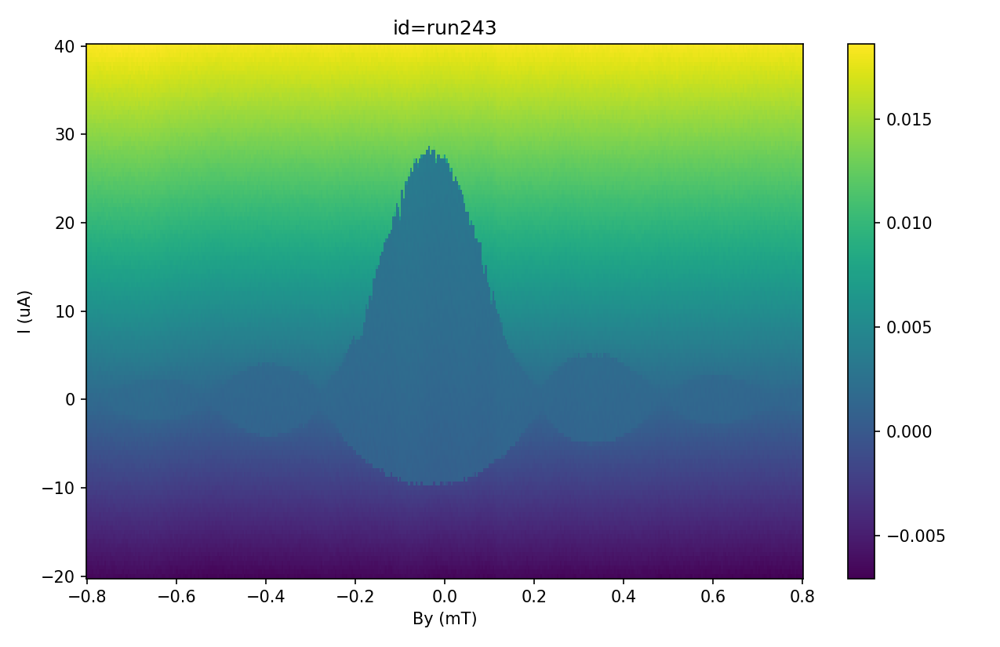

In [88]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_243/1e-3, I_243/1e-6, V_243/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run243')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


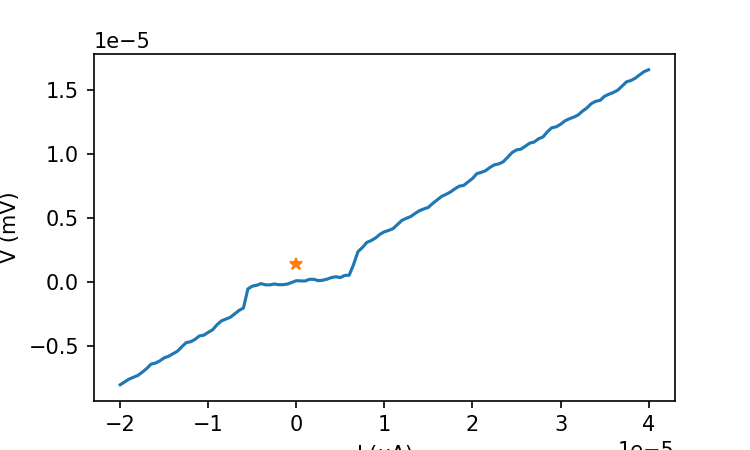

1.4109470000000001e-06


In [89]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_243[150,30:50])
plt.plot(I_243[150,:],V_243[150,:]-DCoff)
plt.plot(I_243[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [90]:
saiz=np.shape(V_243)
# print(saiz)
Is_243=np.zeros(saiz[0])
Ir_243=np.zeros(saiz[0])
fV_243=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_243)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_243[i,30:50])
        if V_243[i,j]-DCoff > 6e-7:
            Is_243[i]=I_243[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_243[i,30:50])
        if -V_243[i,j]-DCoff < 6e-7:
            Ir_243[i]=I_243[i,j]
            break

In [91]:
saiz=np.shape(V_243)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_243)
for i in range(100,300):
    for j in range(40,120):
        if R_243[i,j] > 1:
            Is_243[i]=I_243[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_243[i,j] > 0.5:
            Ir_243[i]=I_243[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


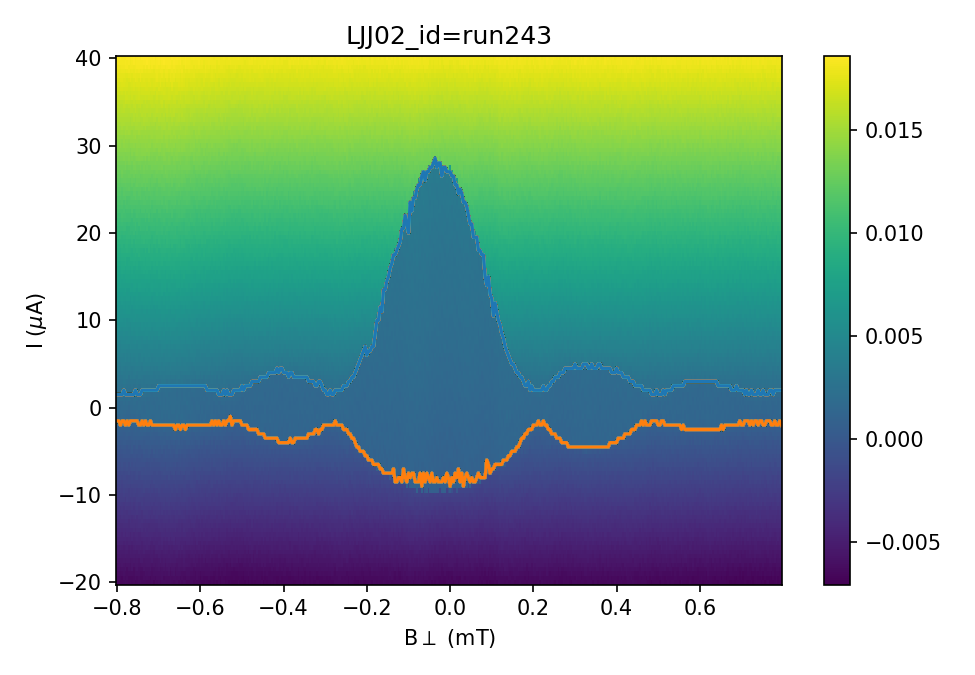

In [92]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_243[Arange:Brange,:]/1e-3, I_243[Arange:Brange,:]/1e-6, V_243[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run243')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_243[Arange:Brange,:]/1e-3,Is_243[Arange:Brange]/1e-6)
plt.plot(By_243[Arange:Brange,:]/1e-3,Ir_243[Arange:Brange]/1e-6)

np.savetxt('Is_243.csv', (Is_243), fmt='%s', delimiter=',')
np.savetxt('Ir_243.csv', (Ir_243), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 244 IV_By_360 degree 

In [93]:
runid=244
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [94]:
By_244=By_field
I_244=I
V_244=V
R_244=R_DC1

np.savetxt('L01_244_By.csv', (By_244), fmt='%s', delimiter=',')
np.savetxt('L01_244_I.csv', (I_244), fmt='%s', delimiter=',')
np.savetxt('L01_244_V.csv', (V_244), fmt='%s', delimiter=',')
np.savetxt('L01_244_R.csv', (R_244), fmt='%s', delimiter=',')

In [18]:
By_244=np.loadtxt('L01_244_By.csv', delimiter=",")
I_244=np.loadtxt('L01_244_I.csv', delimiter=",")
V_244=np.loadtxt('L01_244_V.csv', delimiter=",")
R_244=np.loadtxt('L01_244_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


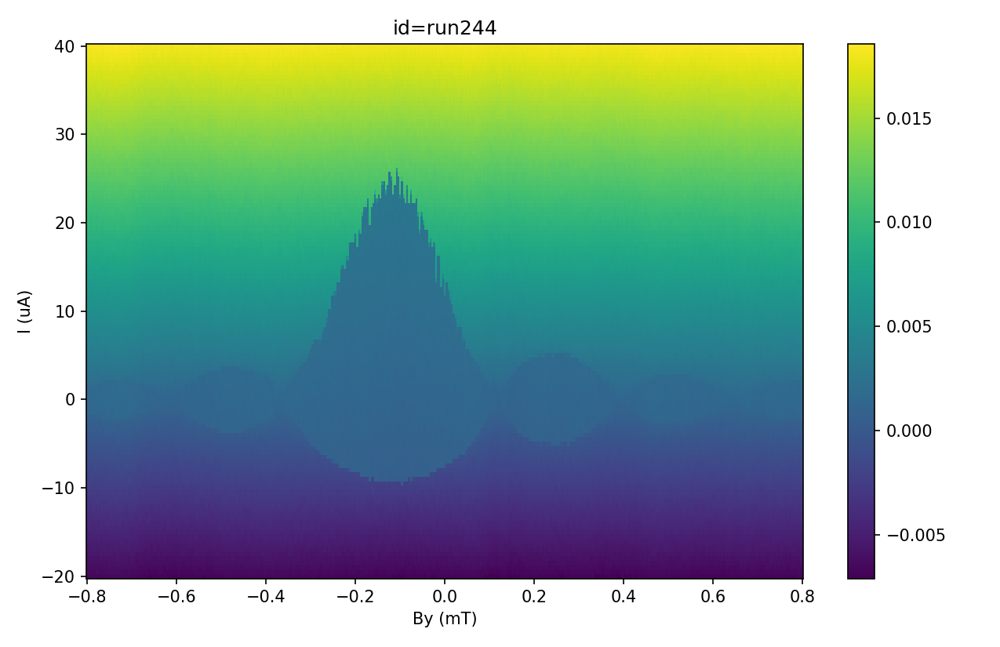

In [95]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_244/1e-3, I_244/1e-6, V_244/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run244')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


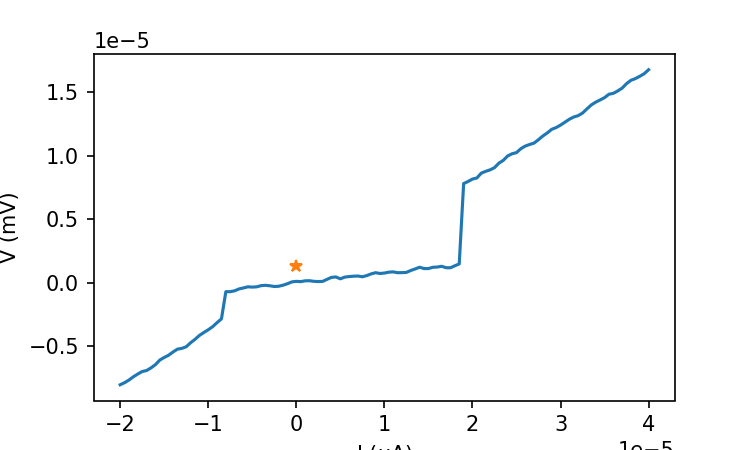

1.34319315e-06


In [96]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_244[150,30:50])
plt.plot(I_244[150,:],V_244[150,:]-DCoff)
plt.plot(I_244[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [97]:
saiz=np.shape(V_244)
# print(saiz)
Is_244=np.zeros(saiz[0])
Ir_244=np.zeros(saiz[0])
fV_244=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_244)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_244[i,30:50])
        if V_244[i,j]-DCoff > 6e-7:
            Is_244[i]=I_244[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_244[i,30:50])
        if -V_244[i,j]-DCoff < 6e-7:
            Ir_244[i]=I_244[i,j]
            break

In [98]:
saiz=np.shape(V_244)
print(saiz)
# Is_220=np.zeros(saiz[0])
# Ir_220=np.zeros(saiz[0])
# max_idx=np.zeros(saiz[0])
# max_val=np.zeros(saiz[0])
# fV_220=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_244)
for i in range(100,300):
    for j in range(40,120):
        if R_244[i,j] > 1:
            Is_244[i]=I_244[i,j]
            break

for i in range(90,170):
    for j in range(40,0):
        if R_244[i,j] > 0.5:
            Ir_244[i]=I_244[i,j]
            break

(401, 121)


<IPython.core.display.Javascript object>


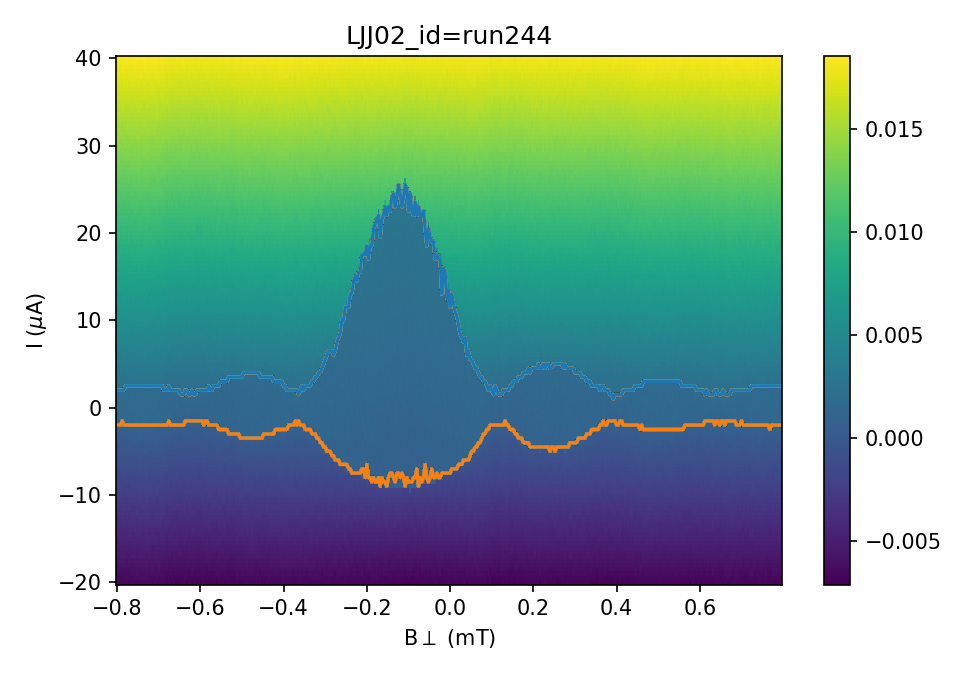

In [99]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_244[Arange:Brange,:]/1e-3, I_244[Arange:Brange,:]/1e-6, V_244[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_233/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run244')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_244[Arange:Brange,:]/1e-3,Is_244[Arange:Brange]/1e-6)
plt.plot(By_244[Arange:Brange,:]/1e-3,Ir_244[Arange:Brange]/1e-6)

np.savetxt('Is_244.csv', (Is_244), fmt='%s', delimiter=',')
np.savetxt('Ir_244.csv', (Ir_244), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 231 to 244

In [6]:
By_231=np.loadtxt('L01_231_By.csv', delimiter=",")
I_231=np.loadtxt('L01_231_I.csv', delimiter=",")
V_231=np.loadtxt('L01_231_V.csv', delimiter=",")
R_231=np.loadtxt('L01_231_R.csv', delimiter=",")
Is_231=np.loadtxt('Is_231.csv', delimiter=",")
Ir_231=np.loadtxt('Ir_231.csv', delimiter=",")

By_233=np.loadtxt('L01_233_By.csv', delimiter=",")
I_233=np.loadtxt('L01_233_I.csv', delimiter=",")
V_233=np.loadtxt('L01_233_V.csv', delimiter=",")
R_233=np.loadtxt('L01_233_R.csv', delimiter=",")
Is_233=np.loadtxt('Is_233.csv', delimiter=",")
Ir_233=np.loadtxt('Ir_233.csv', delimiter=",")

By_234=np.loadtxt('L01_234_By.csv', delimiter=",")
I_234=np.loadtxt('L01_234_I.csv', delimiter=",")
V_234=np.loadtxt('L01_234_V.csv', delimiter=",")
R_234=np.loadtxt('L01_234_R.csv', delimiter=",")
Is_234=np.loadtxt('Is_234.csv', delimiter=",")
Ir_234=np.loadtxt('Ir_234.csv', delimiter=",")

By_235=np.loadtxt('L01_235_By.csv', delimiter=",")
I_235=np.loadtxt('L01_235_I.csv', delimiter=",")
V_235=np.loadtxt('L01_235_V.csv', delimiter=",")
R_235=np.loadtxt('L01_235_R.csv', delimiter=",")
Is_235=np.loadtxt('Is_235.csv', delimiter=",")
Ir_235=np.loadtxt('Ir_235.csv', delimiter=",")

By_236=np.loadtxt('L01_236_By.csv', delimiter=",")
I_236=np.loadtxt('L01_236_I.csv', delimiter=",")
V_236=np.loadtxt('L01_236_V.csv', delimiter=",")
R_236=np.loadtxt('L01_236_R.csv', delimiter=",")
Is_236=np.loadtxt('Is_236.csv', delimiter=",")
Ir_236=np.loadtxt('Ir_236.csv', delimiter=",")

By_237=np.loadtxt('L01_237_By.csv', delimiter=",")
I_237=np.loadtxt('L01_237_I.csv', delimiter=",")
V_237=np.loadtxt('L01_237_V.csv', delimiter=",")
R_237=np.loadtxt('L01_237_R.csv', delimiter=",")
Is_237=np.loadtxt('Is_237.csv', delimiter=",")
Ir_237=np.loadtxt('Ir_237.csv', delimiter=",")

By_238=np.loadtxt('L01_238_By.csv', delimiter=",")
I_238=np.loadtxt('L01_238_I.csv', delimiter=",")
V_238=np.loadtxt('L01_238_V.csv', delimiter=",")
R_238=np.loadtxt('L01_238_R.csv', delimiter=",")
Is_238=np.loadtxt('Is_238.csv', delimiter=",")
Ir_238=np.loadtxt('Ir_238.csv', delimiter=",")

By_239=np.loadtxt('L01_239_By.csv', delimiter=",")
I_239=np.loadtxt('L01_239_I.csv', delimiter=",")
V_239=np.loadtxt('L01_239_V.csv', delimiter=",")
R_239=np.loadtxt('L01_239_R.csv', delimiter=",")
Is_239=np.loadtxt('Is_239.csv', delimiter=",")
Ir_239=np.loadtxt('Ir_239.csv', delimiter=",")

By_240=np.loadtxt('L01_240_By.csv', delimiter=",")
I_240=np.loadtxt('L01_240_I.csv', delimiter=",")
V_240=np.loadtxt('L01_240_V.csv', delimiter=",")
R_240=np.loadtxt('L01_240_R.csv', delimiter=",")
Is_240=np.loadtxt('Is_240.csv', delimiter=",")
Ir_240=np.loadtxt('Ir_240.csv', delimiter=",")

By_241=np.loadtxt('L01_241_By.csv', delimiter=",")
I_241=np.loadtxt('L01_241_I.csv', delimiter=",")
V_241=np.loadtxt('L01_241_V.csv', delimiter=",")
R_241=np.loadtxt('L01_241_R.csv', delimiter=",")
Is_241=np.loadtxt('Is_241.csv', delimiter=",")
Ir_241=np.loadtxt('Ir_241.csv', delimiter=",")

By_242=np.loadtxt('L01_242_By.csv', delimiter=",")
I_242=np.loadtxt('L01_242_I.csv', delimiter=",")
V_242=np.loadtxt('L01_242_V.csv', delimiter=",")
R_242=np.loadtxt('L01_242_R.csv', delimiter=",")
Is_242=np.loadtxt('Is_242.csv', delimiter=",")
Ir_242=np.loadtxt('Ir_242.csv', delimiter=",")

By_243=np.loadtxt('L01_243_By.csv', delimiter=",")
I_243=np.loadtxt('L01_243_I.csv', delimiter=",")
V_243=np.loadtxt('L01_243_V.csv', delimiter=",")
R_243=np.loadtxt('L01_243_R.csv', delimiter=",")
Is_243=np.loadtxt('Is_243.csv', delimiter=",")
Ir_243=np.loadtxt('Ir_243.csv', delimiter=",")

By_244=np.loadtxt('L01_244_By.csv', delimiter=",")
I_244=np.loadtxt('L01_244_I.csv', delimiter=",")
V_244=np.loadtxt('L01_244_V.csv', delimiter=",")
R_244=np.loadtxt('L01_244_R.csv', delimiter=",")
Is_244=np.loadtxt('Is_244.csv', delimiter=",")
Ir_244=np.loadtxt('Ir_244.csv', delimiter=",")

<IPython.core.display.Javascript object>


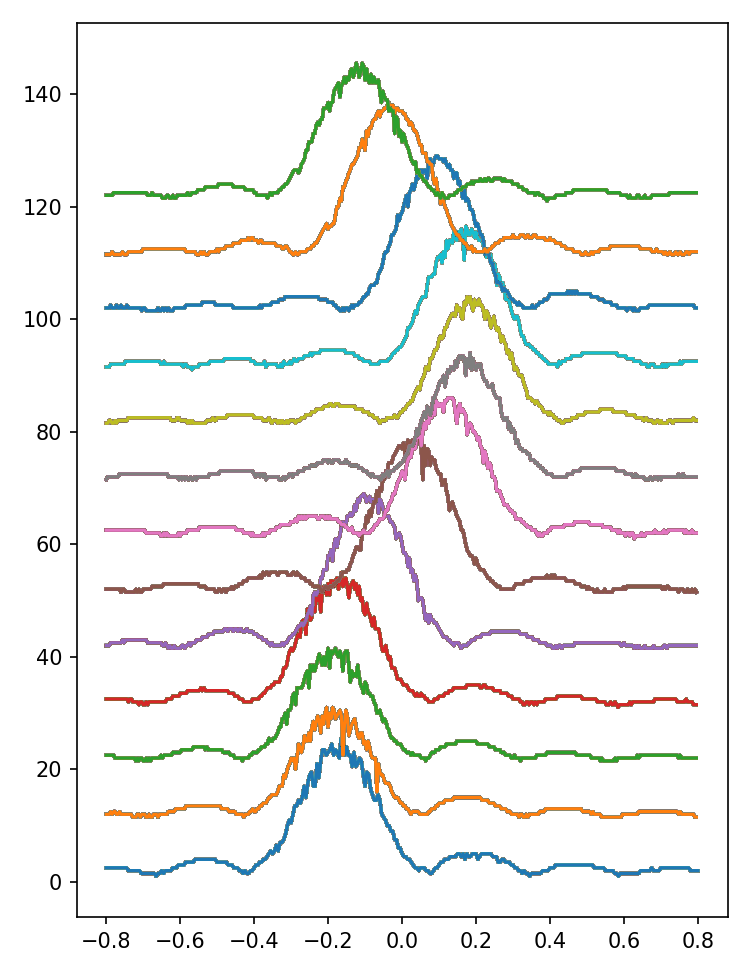

In [7]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(5,6.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')
Arange=0
Brange=400

plt.plot(By_231[Arange:Brange,:]/1e-3,Is_231[Arange:Brange]/1e-6+0)
plt.plot(By_233[Arange:Brange,:]/1e-3,Is_233[Arange:Brange]/1e-6+10)
plt.plot(By_234[Arange:Brange,:]/1e-3,Is_234[Arange:Brange]/1e-6+20)
plt.plot(By_235[Arange:Brange,:]/1e-3,Is_235[Arange:Brange]/1e-6+30)
plt.plot(By_236[Arange:Brange,:]/1e-3,Is_236[Arange:Brange]/1e-6+40)
plt.plot(By_237[Arange:Brange,:]/1e-3,Is_237[Arange:Brange]/1e-6+50)
plt.plot(By_238[Arange:Brange,:]/1e-3,Is_238[Arange:Brange]/1e-6+60)
plt.plot(By_239[Arange:Brange,:]/1e-3,Is_239[Arange:Brange]/1e-6+70)
plt.plot(By_240[Arange:Brange,:]/1e-3,Is_240[Arange:Brange]/1e-6+80)
plt.plot(By_241[Arange:Brange,:]/1e-3,Is_241[Arange:Brange]/1e-6+90)
plt.plot(By_242[Arange:Brange,:]/1e-3,Is_242[Arange:Brange]/1e-6+100)
plt.plot(By_243[Arange:Brange,:]/1e-3,Is_243[Arange:Brange]/1e-6+110)
# plt.plot(By_266[Arange:Brange,:]/1e-3,Ir_266[Arange:Brange]/1e-6)
plt.plot(By_244[Arange:Brange,:]/1e-3,Is_244[Arange:Brange]/1e-6+120)


fig.tight_layout()
#plt.grid()
plt.show()

In [64]:
## use local max 
import operator
max_idx_231, max_val_231 = max(enumerate(Is_231), key=operator.itemgetter(1))
max_idx_233, max_val_233 = max(enumerate(Is_233), key=operator.itemgetter(1))
max_idx_234, max_val_234 = max(enumerate(Is_234), key=operator.itemgetter(1))
max_idx_235, max_val_235 = max(enumerate(Is_235), key=operator.itemgetter(1))
max_idx_236, max_val_236 = max(enumerate(Is_236), key=operator.itemgetter(1))
max_idx_237, max_val_237 = max(enumerate(Is_237), key=operator.itemgetter(1))
max_idx_238, max_val_238 = max(enumerate(Is_238), key=operator.itemgetter(1))
max_idx_239, max_val_239 = max(enumerate(Is_239), key=operator.itemgetter(1))
max_idx_240, max_val_240 = max(enumerate(Is_240), key=operator.itemgetter(1))
max_idx_241, max_val_241 = max(enumerate(Is_241), key=operator.itemgetter(1))
max_idx_242, max_val_242 = max(enumerate(Is_242), key=operator.itemgetter(1))
max_idx_243, max_val_243 = max(enumerate(Is_243), key=operator.itemgetter(1))
max_idx_244, max_val_244 = max(enumerate(Is_244), key=operator.itemgetter(1))

# print (max_idx, max_val)

In [65]:
def Gauss(x,a,x0,sigma):
    return a*np.exp(-(x-x0)**2/(2*sigma**2)) 

<IPython.core.display.Javascript object>


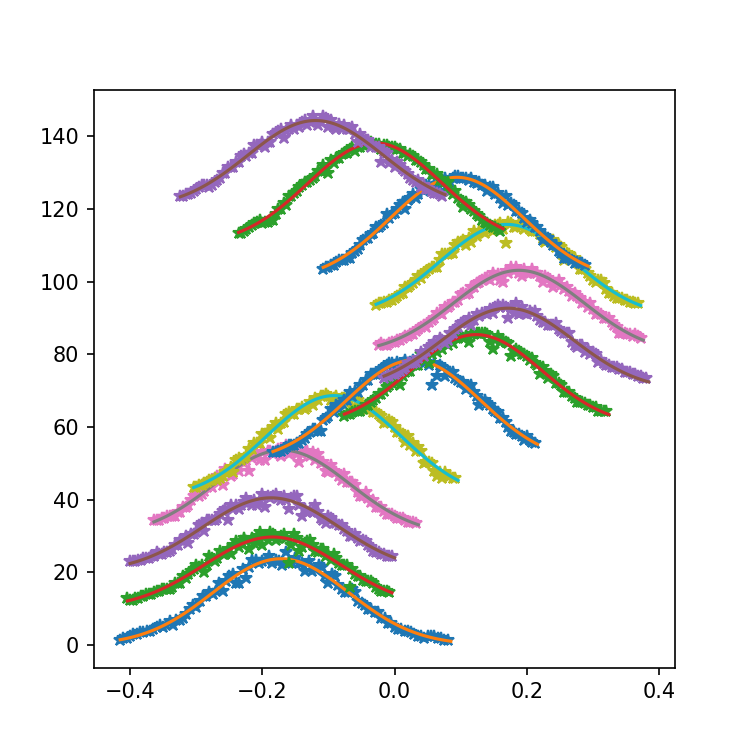

48 54 53


In [66]:
## test fit 
fig, (ax0) = plt.subplots(ncols=1, figsize=(5,5))
popt_231, pcov_231 = curve_fit(Gauss, By_231[max_idx_231-50:max_idx_231+50,1]/1e-3,Is_231[max_idx_231-50:max_idx_231+50]/1e-6)
popt_233, pcov_233 = curve_fit(Gauss, By_233[max_idx_233-50:max_idx_233+50,1]/1e-3,Is_233[max_idx_233-50:max_idx_233+50]/1e-6)
popt_234, pcov_234 = curve_fit(Gauss, By_234[max_idx_234-50:max_idx_234+50,1]/1e-3,Is_234[max_idx_234-50:max_idx_234+50]/1e-6)
popt_235, pcov_235 = curve_fit(Gauss, By_235[max_idx_235-50:max_idx_235+50,1]/1e-3,Is_235[max_idx_235-50:max_idx_235+50]/1e-6)
popt_236, pcov_236 = curve_fit(Gauss, By_236[max_idx_236-50:max_idx_236+50,1]/1e-3,Is_236[max_idx_236-50:max_idx_236+50]/1e-6)
popt_237, pcov_237 = curve_fit(Gauss, By_237[max_idx_237-50:max_idx_237+50,1]/1e-3,Is_237[max_idx_237-50:max_idx_237+50]/1e-6)
popt_238, pcov_238 = curve_fit(Gauss, By_238[max_idx_238-50:max_idx_238+50,1]/1e-3,Is_238[max_idx_238-50:max_idx_238+50]/1e-6)
popt_239, pcov_239 = curve_fit(Gauss, By_239[max_idx_239-50:max_idx_239+50,1]/1e-3,Is_239[max_idx_239-50:max_idx_239+50]/1e-6)
popt_240, pcov_240 = curve_fit(Gauss, By_240[max_idx_240-50:max_idx_240+50,1]/1e-3,Is_240[max_idx_240-50:max_idx_240+50]/1e-6)
popt_241, pcov_241 = curve_fit(Gauss, By_241[max_idx_241-50:max_idx_241+50,1]/1e-3,Is_241[max_idx_241-50:max_idx_241+50]/1e-6)
popt_242, pcov_242 = curve_fit(Gauss, By_242[max_idx_242-50:max_idx_242+50,1]/1e-3,Is_242[max_idx_242-50:max_idx_242+50]/1e-6)
popt_243, pcov_243 = curve_fit(Gauss, By_243[max_idx_243-50:max_idx_243+50,1]/1e-3,Is_243[max_idx_243-50:max_idx_243+50]/1e-6)
popt_244, pcov_244 = curve_fit(Gauss, By_244[max_idx_244-50:max_idx_244+50,1]/1e-3,Is_244[max_idx_244-50:max_idx_244+50]/1e-6)


plt.plot(By_231[max_idx_231-50:max_idx_231+50,1]/1e-3,Is_231[max_idx_231-50:max_idx_231+50]/1e-6,"*")
x_curve_231 = np.linspace(By_231[max_idx_231-50,1]/1e-3,By_231[max_idx_231+50,1]/1e-3, 100)
plt.plot(x_curve_231, Gauss(x_curve_231, *popt_231))

plt.plot(By_233[max_idx_233-50:max_idx_233+50,1]/1e-3,Is_233[max_idx_233-50:max_idx_233+50]/1e-6+10,"*")
x_curve_233 = np.linspace(By_233[max_idx_233-50,1]/1e-3,By_233[max_idx_233+50,1]/1e-3, 100)
plt.plot(x_curve_233, Gauss(x_curve_233, *popt_233)+10)

plt.plot(By_234[max_idx_234-50:max_idx_234+50,1]/1e-3,Is_234[max_idx_234-50:max_idx_234+50]/1e-6+20,"*")
x_curve_234 = np.linspace(By_234[max_idx_234-50,1]/1e-3,By_234[max_idx_234+50,1]/1e-3, 100)
plt.plot(x_curve_234, Gauss(x_curve_234, *popt_234)+20)

plt.plot(By_235[max_idx_235-50:max_idx_235+50,1]/1e-3,Is_235[max_idx_235-50:max_idx_235+50]/1e-6+30,"*")
x_curve_235 = np.linspace(By_235[max_idx_235-50,1]/1e-3,By_235[max_idx_235+50,1]/1e-3, 100)
plt.plot(x_curve_235, Gauss(x_curve_235, *popt_235)+30)

plt.plot(By_236[max_idx_236-50:max_idx_236+50,1]/1e-3,Is_236[max_idx_236-50:max_idx_236+50]/1e-6+40,"*")
x_curve_236 = np.linspace(By_236[max_idx_236-50,1]/1e-3,By_236[max_idx_236+50,1]/1e-3, 100)
plt.plot(x_curve_236, Gauss(x_curve_236, *popt_236)+40)

plt.plot(By_237[max_idx_237-50:max_idx_237+50,1]/1e-3,Is_237[max_idx_237-50:max_idx_237+50]/1e-6+50,"*")
x_curve_237 = np.linspace(By_237[max_idx_237-50,1]/1e-3,By_237[max_idx_237+50,1]/1e-3, 100)
plt.plot(x_curve_237, Gauss(x_curve_237, *popt_237)+50)

plt.plot(By_238[max_idx_238-50:max_idx_238+50,1]/1e-3,Is_238[max_idx_238-50:max_idx_238+50]/1e-6+60,"*")
x_curve_238 = np.linspace(By_238[max_idx_238-50,1]/1e-3,By_238[max_idx_238+50,1]/1e-3, 100)
plt.plot(x_curve_238, Gauss(x_curve_238, *popt_238)+60)

plt.plot(By_239[max_idx_239-50:max_idx_239+50,1]/1e-3,Is_239[max_idx_239-50:max_idx_239+50]/1e-6+70,"*")
x_curve_239 = np.linspace(By_239[max_idx_239-50,1]/1e-3,By_239[max_idx_239+50,1]/1e-3, 100)
plt.plot(x_curve_239, Gauss(x_curve_239, *popt_239)+70)

plt.plot(By_240[max_idx_240-50:max_idx_240+50,1]/1e-3,Is_240[max_idx_240-50:max_idx_240+50]/1e-6+80,"*")
x_curve_240 = np.linspace(By_240[max_idx_240-50,1]/1e-3,By_240[max_idx_240+50,1]/1e-3, 100)
plt.plot(x_curve_240, Gauss(x_curve_240, *popt_240)+80)

plt.plot(By_241[max_idx_241-50:max_idx_241+50,1]/1e-3,Is_241[max_idx_241-50:max_idx_241+50]/1e-6+90,"*")
x_curve_241 = np.linspace(By_241[max_idx_241-50,1]/1e-3,By_241[max_idx_241+50,1]/1e-3, 100)
plt.plot(x_curve_241, Gauss(x_curve_241, *popt_241)+90)

plt.plot(By_242[max_idx_242-50:max_idx_242+50,1]/1e-3,Is_242[max_idx_242-50:max_idx_242+50]/1e-6+100,"*")
x_curve_242 = np.linspace(By_242[max_idx_242-50,1]/1e-3,By_242[max_idx_242+50,1]/1e-3, 100)
plt.plot(x_curve_242, Gauss(x_curve_242, *popt_242)+100)

plt.plot(By_243[max_idx_243-50:max_idx_243+50,1]/1e-3,Is_243[max_idx_243-50:max_idx_243+50]/1e-6+110,"*")
x_curve_243 = np.linspace(By_243[max_idx_243-50,1]/1e-3,By_243[max_idx_243+50,1]/1e-3, 100)
plt.plot(x_curve_243, Gauss(x_curve_243, *popt_243)+110)

plt.plot(By_244[max_idx_244-50:max_idx_244+50,1]/1e-3,Is_244[max_idx_244-50:max_idx_244+50]/1e-6+120,"*")
x_curve_244 = np.linspace(By_244[max_idx_244-50,1]/1e-3,By_244[max_idx_244+50,1]/1e-3, 100)
plt.plot(x_curve_244, Gauss(x_curve_244, *popt_244)+120)

# max_idx_258g, max_val_258g = max(enumerate(Gauss(x_curve_258, *popt_258)), key=operator.itemgetter(1))
max_idx_231g, max_val_231g = max(enumerate(Gauss(x_curve_231, *popt_231)), key=operator.itemgetter(1))
max_idx_233g, max_val_233g = max(enumerate(Gauss(x_curve_233, *popt_233)), key=operator.itemgetter(1))
max_idx_234g, max_val_234g = max(enumerate(Gauss(x_curve_234, *popt_234)), key=operator.itemgetter(1))
max_idx_235g, max_val_235g = max(enumerate(Gauss(x_curve_235, *popt_235)), key=operator.itemgetter(1))
max_idx_236g, max_val_236g = max(enumerate(Gauss(x_curve_236, *popt_236)), key=operator.itemgetter(1))
max_idx_237g, max_val_237g = max(enumerate(Gauss(x_curve_237, *popt_237)), key=operator.itemgetter(1))
max_idx_238g, max_val_238g = max(enumerate(Gauss(x_curve_238, *popt_238)), key=operator.itemgetter(1))
max_idx_239g, max_val_239g = max(enumerate(Gauss(x_curve_239, *popt_239)), key=operator.itemgetter(1))
max_idx_240g, max_val_240g = max(enumerate(Gauss(x_curve_240, *popt_240)), key=operator.itemgetter(1))
max_idx_241g, max_val_241g = max(enumerate(Gauss(x_curve_241, *popt_241)), key=operator.itemgetter(1))
max_idx_242g, max_val_242g = max(enumerate(Gauss(x_curve_242, *popt_242)), key=operator.itemgetter(1))
max_idx_243g, max_val_243g = max(enumerate(Gauss(x_curve_243, *popt_243)), key=operator.itemgetter(1))
max_idx_244g, max_val_244g = max(enumerate(Gauss(x_curve_244, *popt_244)), key=operator.itemgetter(1))
# print(max_idx_258g, max_val_258g)
print(max_idx_231g, max_idx_233g, max_idx_234g)
plt.show()

In [67]:
max_idx_231g2=max_idx_231g-50+max_idx_231
max_idx_233g2=max_idx_233g-50+max_idx_233
max_idx_234g2=max_idx_234g-50+max_idx_234
max_idx_235g2=max_idx_235g-50+max_idx_235
max_idx_236g2=max_idx_236g-50+max_idx_236
max_idx_237g2=max_idx_237g-50+max_idx_237
max_idx_238g2=max_idx_238g-50+max_idx_238
max_idx_239g2=max_idx_239g-50+max_idx_239
max_idx_240g2=max_idx_240g-50+max_idx_240
max_idx_241g2=max_idx_241g-50+max_idx_241
max_idx_242g2=max_idx_242g-50+max_idx_242
max_idx_243g2=max_idx_243g-50+max_idx_243
max_idx_244g2=max_idx_244g-50+max_idx_244
print(max_idx_231g2)

125


<IPython.core.display.Javascript object>


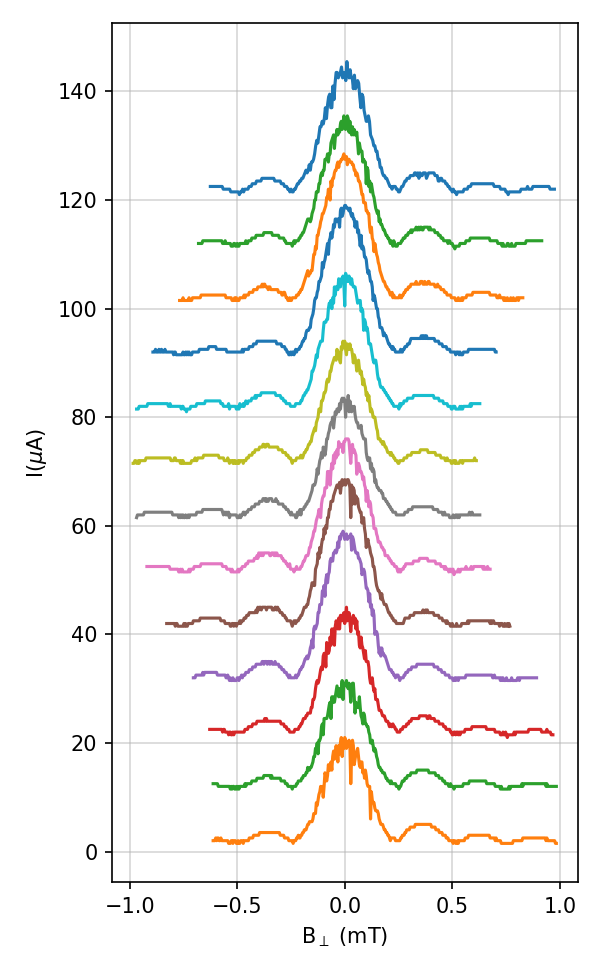

In [68]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(4,6.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')
Arange=0
Brange=400

plt.plot((By_231[Arange:Brange,1]-By_231[max_idx_231g2,1])/1e-3,Is_231[Arange:Brange]/1e-6+120)
plt.plot((By_233[Arange:Brange,1]-By_233[max_idx_233g2,1])/1e-3,Is_233[Arange:Brange]/1e-6+0)
plt.plot((By_234[Arange:Brange,1]-By_234[max_idx_234g2,1])/1e-3,Is_234[Arange:Brange]/1e-6+10)
plt.plot((By_235[Arange:Brange,1]-By_235[max_idx_235g2,1])/1e-3,Is_235[Arange:Brange]/1e-6+20)
plt.plot((By_236[Arange:Brange,1]-By_236[max_idx_236g2,1])/1e-3,Is_236[Arange:Brange]/1e-6+30)
plt.plot((By_237[Arange:Brange,1]-By_237[max_idx_237g2,1])/1e-3,Is_237[Arange:Brange]/1e-6+40)
plt.plot((By_238[Arange:Brange,1]-By_238[max_idx_238g2,1])/1e-3,Is_238[Arange:Brange]/1e-6+50)
plt.plot((By_239[Arange:Brange,1]-By_239[max_idx_239g2,1])/1e-3,Is_239[Arange:Brange]/1e-6+60)
plt.plot((By_240[Arange:Brange,1]-By_240[max_idx_240g2,1])/1e-3,Is_240[Arange:Brange]/1e-6+70)
plt.plot((By_241[Arange:Brange,1]-By_241[max_idx_241g2,1])/1e-3,Is_241[Arange:Brange]/1e-6+80)
plt.plot((By_242[Arange:Brange,1]-By_242[max_idx_242g2,1])/1e-3,Is_242[Arange:Brange]/1e-6+90)
plt.plot((By_243[Arange:Brange,1]-By_243[max_idx_243g2,1])/1e-3,Is_243[Arange:Brange]/1e-6+100)
plt.plot((By_244[Arange:Brange,1]-By_244[max_idx_244g2,1])/1e-3,Is_244[Arange:Brange]/1e-6+110)
# plt.plot(By_266[Arange:Brange,:]/1e-3,Ir_266[Arange:Brange]/1e-6)
plt.ylabel('I($\mu$A)')
plt.xlabel('B$_\perp$ (mT)') 
fig.tight_layout()
# plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
ax0.grid(which='minor', alpha=0.2)
ax0.grid(which='major', alpha=0.5)
plt.show()

## Run 231 to 244 flip

<IPython.core.display.Javascript object>


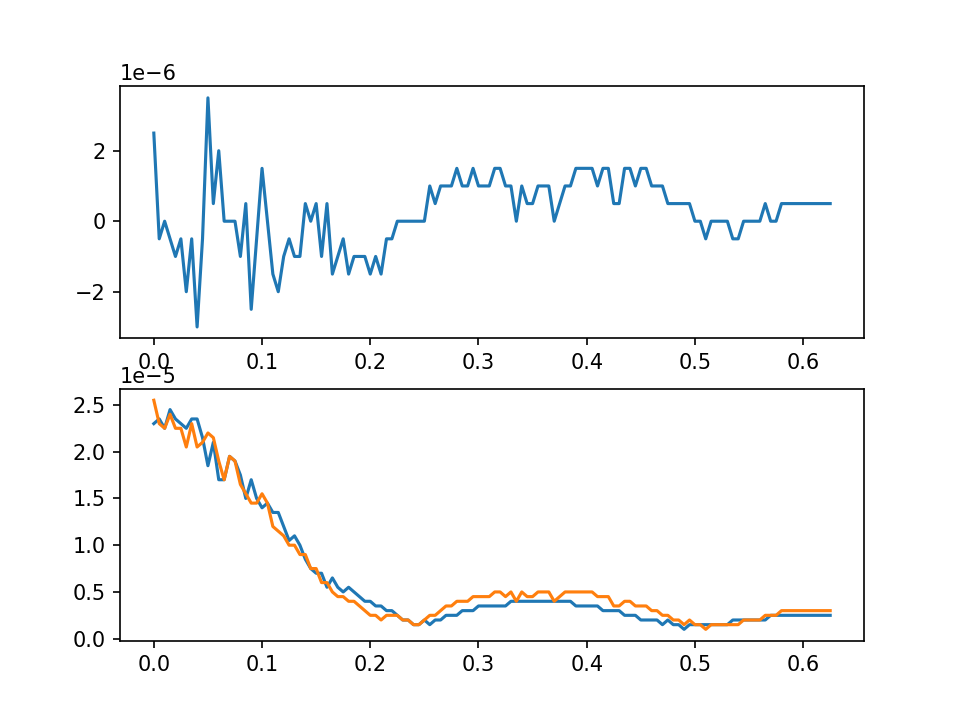

(126,) (126,) (126,)


In [69]:
## Run 231 flip
max_idx_231g2=max_idx_231g-50+max_idx_231
n=1
max_idx_231g2=max_idx_231g2+n

saiz=np.size(Is_231)

if max_idx_231g2< (saiz-1)/2:
    Arange=max_idx_231g2
    Is_231_N=np.zeros(Arange)
    Is_231_P=np.zeros(Arange)
    Is_diff_231=np.zeros(Arange)
    By_231_shift=np.zeros(Arange)
    Is_231_N=np.flipud(Is_231[0:max_idx_231g2])
    Is_231_P=Is_231[max_idx_231g2+1:2*max_idx_231g2+1]
    By_231_shift=(By_231[max_idx_231g2:2*max_idx_231g2,1]-By_231[max_idx_231g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_231g2
    Is_231_N=np.zeros(Arange)
    Is_231_P=np.zeros(Arange)
    Is_diff_231=np.zeros(Arange)
    By_231_shift=np.zeros(Arange)
    Is_231_N=np.flipud(Is_231[max_idx_231g2-Arange:max_idx_231g2])
    Is_231_P=Is_231[max_idx_231g2+1:max_idx_231g2+1+Arange]
    By_231_shift=(By_231[max_idx_231g2:max_idx_231g2+Arange,1]-By_231[max_idx_231g2,1])/1e-3



for i in range(Arange):
    Is_diff_231[i]=Is_231_P[i]-Is_231_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_231_shift,Is_diff_231)
plt.subplot(212)
plt.plot(By_231_shift,Is_231_N)
plt.plot(By_231_shift,Is_231_P)

print(np.shape(Is_231_N), np.shape(Is_231_P), np.shape(By_231_shift))

<IPython.core.display.Javascript object>


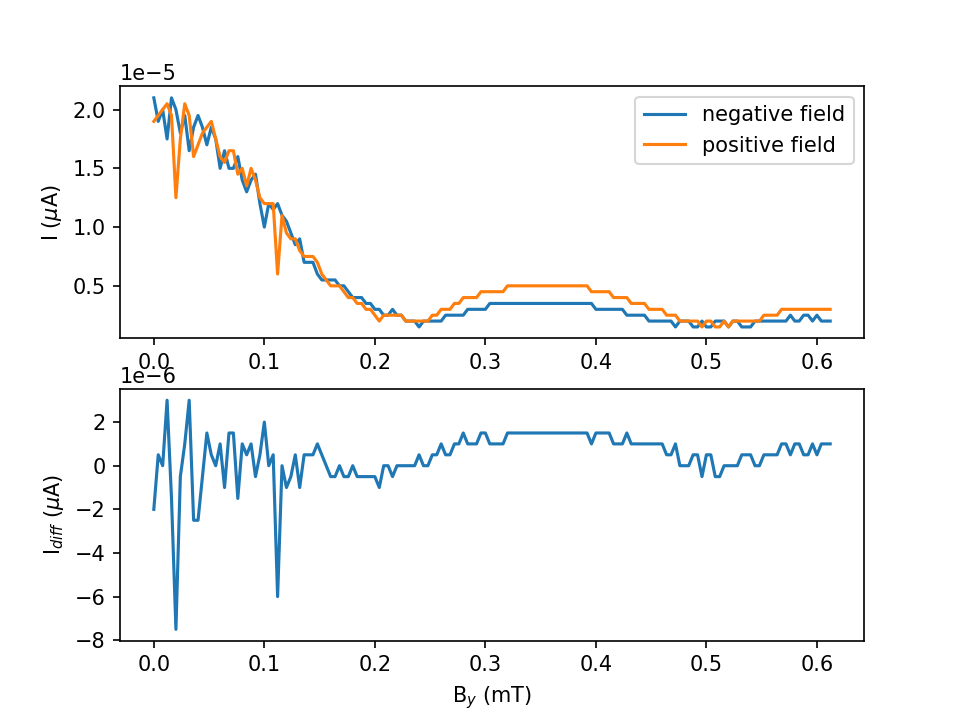

(154,) (154,) (154,)


In [70]:
## Run 233
max_idx_233g2=max_idx_233g-50+max_idx_233
n=1
max_idx_233g2=max_idx_233g2+n

saiz=np.size(Is_233)

if max_idx_233g2< (saiz-1)/2:
    Arange=max_idx_233g2
    Is_233_N=np.zeros(Arange)
    Is_233_P=np.zeros(Arange)
    Is_diff_233=np.zeros(Arange)
    By_233_shift=np.zeros(Arange)
    Is_233_N=np.flipud(Is_233[0:max_idx_233g2])
    Is_233_P=Is_233[max_idx_233g2+1:2*max_idx_233g2+1]
    By_233_shift=(By_233[max_idx_233g2:2*max_idx_233g2,1]-By_233[max_idx_233g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_233g2
    Is_233_N=np.zeros(Arange)
    Is_233_P=np.zeros(Arange)
    Is_diff_233=np.zeros(Arange)
    By_233_shift=np.zeros(Arange)
    Is_233_N=np.flipud(Is_233[max_idx_233g2-Arange:max_idx_233g2])
    Is_233_P=Is_233[max_idx_233g2+1:max_idx_233g2+1+Arange]
    By_233_shift=(By_233[max_idx_233g2:max_idx_233g2+Arange,1]-By_233[max_idx_233g2,1])/1e-3



for i in range(Arange):
    Is_diff_233[i]=Is_233_P[i]-Is_233_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(212)
plt.plot(By_233_shift,Is_diff_233)
plt.xlabel('B$_y$ (mT)')
plt.ylabel('I$_{diff}$ ($\mu$A)')
plt.subplot(211)
plt.plot(By_233_shift,Is_233_N, label='negative field')
plt.plot(By_233_shift,Is_233_P, label='positive field')
plt.ylabel('I ($\mu$A)')
plt.legend(loc="upper right")

print(np.shape(Is_233_N), np.shape(Is_233_P), np.shape(By_233_shift))


<IPython.core.display.Javascript object>


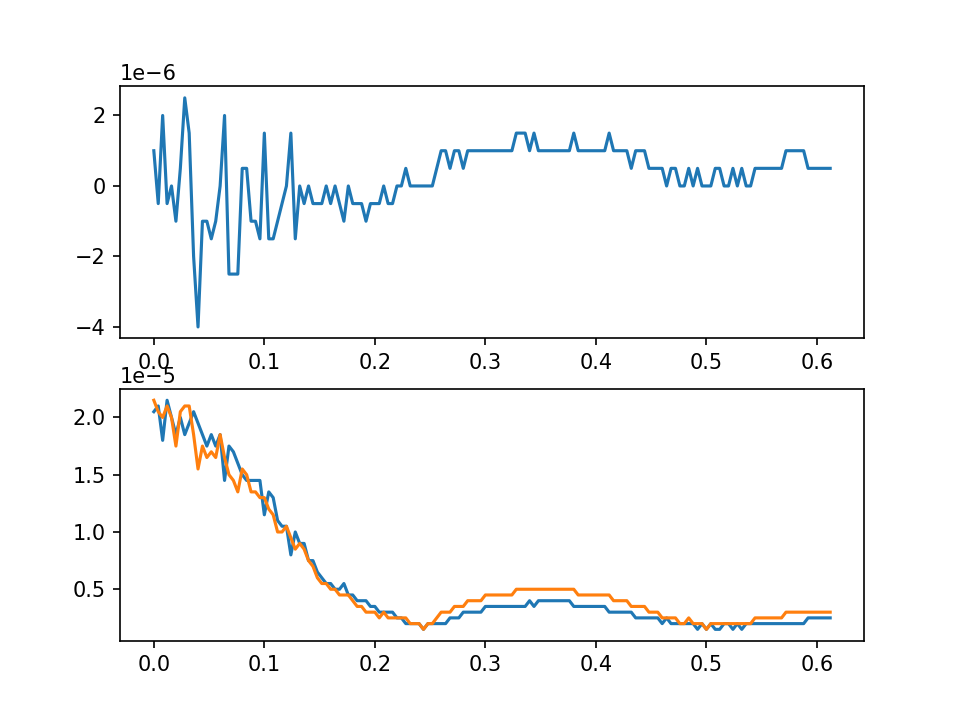

(154,) (154,) (154,)


In [71]:
max_idx_234g2=max_idx_234g-50+max_idx_234
n=1
max_idx_234g2=max_idx_234g2+n

saiz=np.size(Is_234)

if max_idx_234g2< (saiz-1)/2:
    Arange=max_idx_234g2
    Is_234_N=np.zeros(Arange)
    Is_234_P=np.zeros(Arange)
    Is_diff_234=np.zeros(Arange)
    By_234_shift=np.zeros(Arange)
    Is_234_N=np.flipud(Is_234[0:max_idx_234g2])
    Is_234_P=Is_234[max_idx_234g2+1:2*max_idx_234g2+1]
    By_234_shift=(By_234[max_idx_234g2:2*max_idx_234g2,1]-By_234[max_idx_234g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_234g2
    Is_234_N=np.zeros(Arange)
    Is_234_P=np.zeros(Arange)
    Is_diff_234=np.zeros(Arange)
    By_234_shift=np.zeros(Arange)
    Is_234_N=np.flipud(Is_234[max_idx_234g2-Arange:max_idx_234g2])
    Is_234_P=Is_234[max_idx_234g2+1:max_idx_234g2+1+Arange]
    By_234_shift=(By_234[max_idx_234g2:max_idx_234g2+Arange,1]-By_234[max_idx_234g2,1])/1e-3



for i in range(Arange):
    Is_diff_234[i]=Is_234_P[i]-Is_234_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_234_shift,Is_diff_234)
plt.subplot(212)
plt.plot(By_234_shift,Is_234_N)
plt.plot(By_234_shift,Is_234_P)

print(np.shape(Is_234_N), np.shape(Is_234_P), np.shape(By_234_shift))

<IPython.core.display.Javascript object>


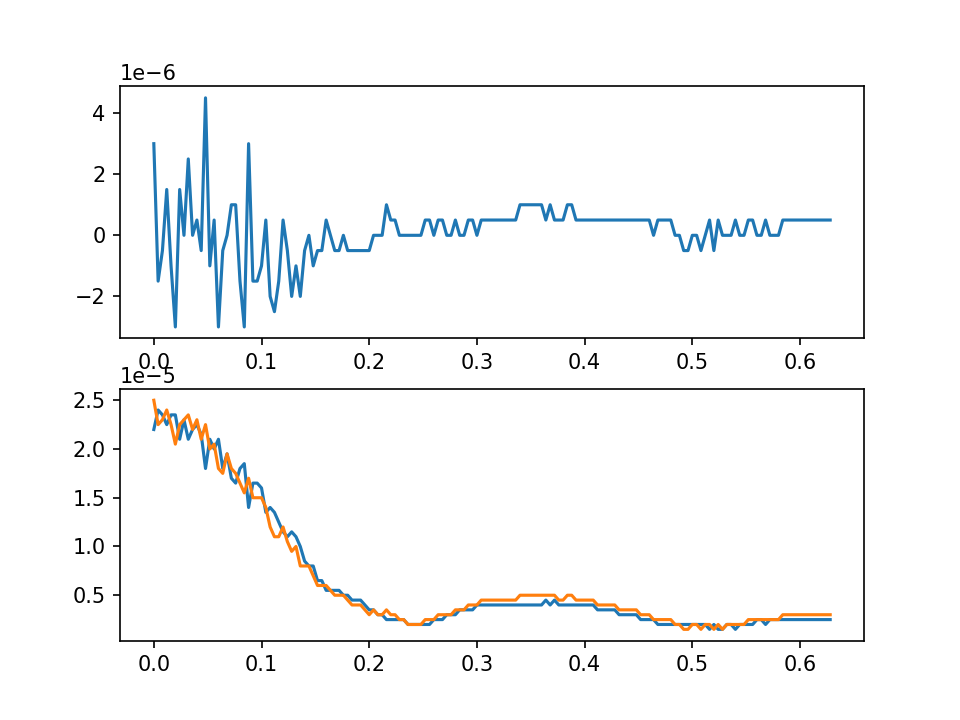

(158,) (158,) (158,)


In [72]:
## Run235
max_idx_235g2=max_idx_235g-50+max_idx_235
n=1
max_idx_235g2=max_idx_235g2+n

saiz=np.size(Is_235)

if max_idx_235g2< (saiz-1)/2:
    Arange=max_idx_235g2
    Is_235_N=np.zeros(Arange)
    Is_235_P=np.zeros(Arange)
    Is_diff_235=np.zeros(Arange)
    By_235_shift=np.zeros(Arange)
    Is_235_N=np.flipud(Is_235[0:max_idx_235g2])
    Is_235_P=Is_235[max_idx_235g2+1:2*max_idx_235g2+1]
    By_235_shift=(By_235[max_idx_235g2:2*max_idx_235g2,1]-By_235[max_idx_235g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_235g2
    Is_235_N=np.zeros(Arange)
    Is_235_P=np.zeros(Arange)
    Is_diff_235=np.zeros(Arange)
    By_235_shift=np.zeros(Arange)
    Is_235_N=np.flipud(Is_235[max_idx_235g2-Arange:max_idx_235g2])
    Is_235_P=Is_235[max_idx_235g2+1:max_idx_235g2+1+Arange]
    By_235_shift=(By_235[max_idx_235g2:max_idx_235g2+Arange,1]-By_235[max_idx_235g2,1])/1e-3



for i in range(Arange):
    Is_diff_235[i]=Is_235_P[i]-Is_235_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_235_shift,Is_diff_235)
plt.subplot(212)
plt.plot(By_235_shift,Is_235_N)
plt.plot(By_235_shift,Is_235_P)

print(np.shape(Is_235_N), np.shape(Is_235_P), np.shape(By_235_shift))

<IPython.core.display.Javascript object>


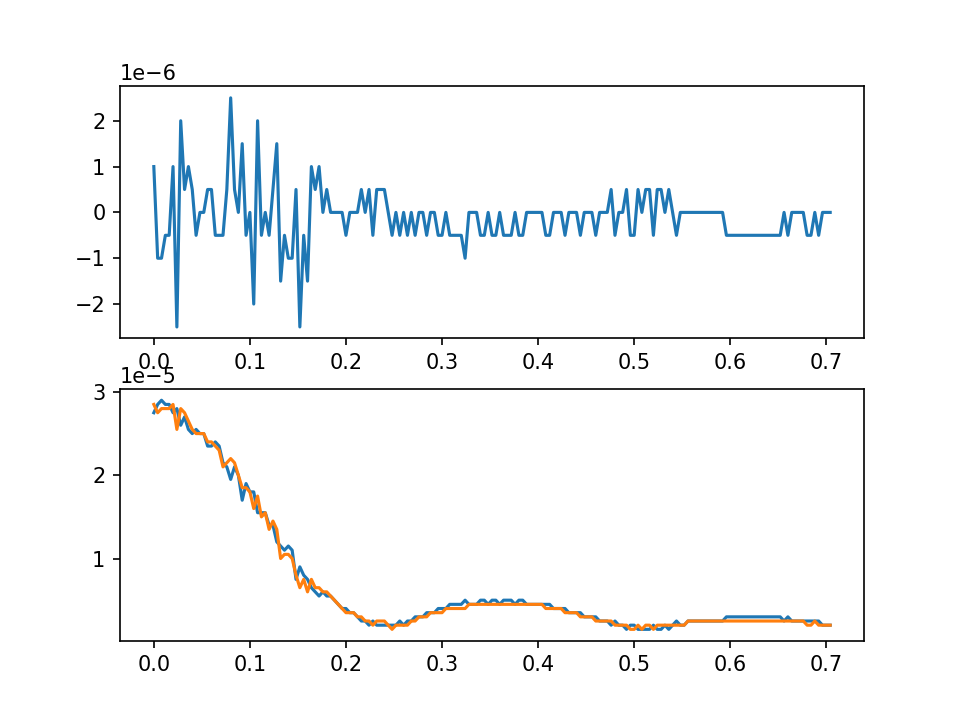

(177,) (177,) (177,)


In [73]:
## Run 236
max_idx_236g2=max_idx_236g-50+max_idx_236
n=1
max_idx_236g2=max_idx_236g2+n

saiz=np.size(Is_236)

if max_idx_236g2< (saiz-1)/2:
    Arange=max_idx_236g2
    Is_236_N=np.zeros(Arange)
    Is_236_P=np.zeros(Arange)
    Is_diff_236=np.zeros(Arange)
    By_236_shift=np.zeros(Arange)
    Is_236_N=np.flipud(Is_236[0:max_idx_236g2])
    Is_236_P=Is_236[max_idx_236g2+1:2*max_idx_236g2+1]
    By_236_shift=(By_236[max_idx_236g2:2*max_idx_236g2,1]-By_236[max_idx_236g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_236g2
    Is_236_N=np.zeros(Arange)
    Is_236_P=np.zeros(Arange)
    Is_diff_236=np.zeros(Arange)
    By_236_shift=np.zeros(Arange)
    Is_236_N=np.flipud(Is_236[max_idx_236g2-Arange:max_idx_236g2])
    Is_236_P=Is_236[max_idx_236g2+1:max_idx_236g2+1+Arange]
    By_236_shift=(By_236[max_idx_236g2:max_idx_236g2+Arange,1]-By_236[max_idx_236g2,1])/1e-3



for i in range(Arange):
    Is_diff_236[i]=Is_236_P[i]-Is_236_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_236_shift,Is_diff_236)
plt.subplot(212)
plt.plot(By_236_shift,Is_236_N)
plt.plot(By_236_shift,Is_236_P)

print(np.shape(Is_236_N), np.shape(Is_236_P), np.shape(By_236_shift))

<IPython.core.display.Javascript object>


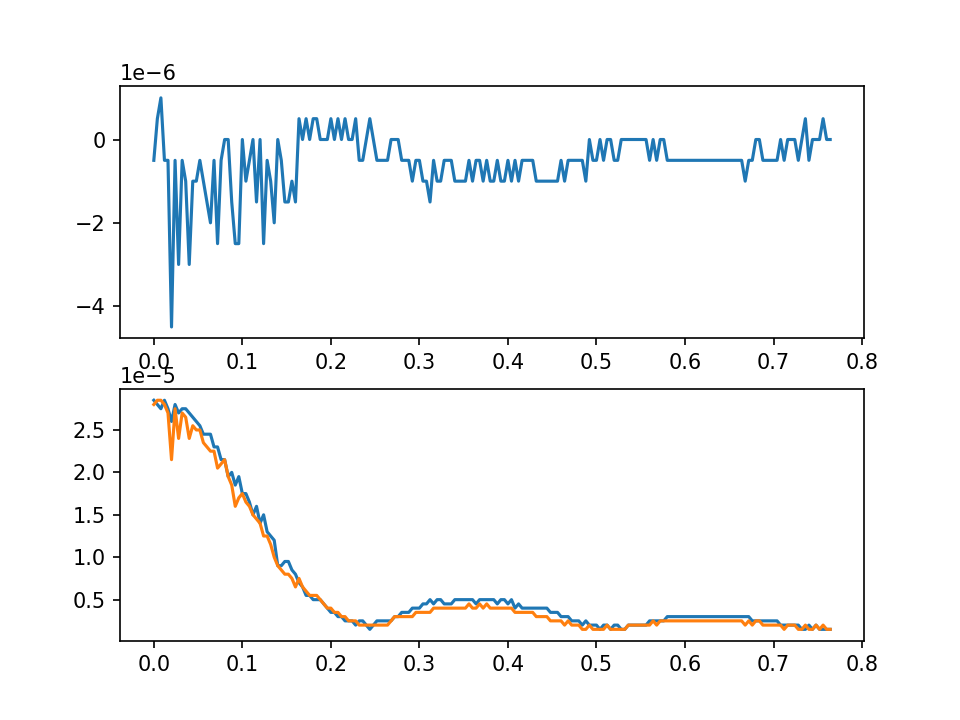

(192,) (192,) (192,)


In [74]:
## run 237
max_idx_237g2=max_idx_237g-50+max_idx_237
n=1
max_idx_237g2=max_idx_237g2+n

saiz=np.size(Is_237)

if max_idx_237g2< (saiz-1)/2:
    Arange=max_idx_237g2
    Is_237_N=np.zeros(Arange)
    Is_237_P=np.zeros(Arange)
    Is_diff_237=np.zeros(Arange)
    By_237_shift=np.zeros(Arange)
    Is_237_N=np.flipud(Is_237[0:max_idx_237g2])
    Is_237_P=Is_237[max_idx_237g2+1:2*max_idx_237g2+1]
    By_237_shift=(By_237[max_idx_237g2:2*max_idx_237g2,1]-By_237[max_idx_237g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_237g2
    Is_237_N=np.zeros(Arange)
    Is_237_P=np.zeros(Arange)
    Is_diff_237=np.zeros(Arange)
    By_237_shift=np.zeros(Arange)
    Is_237_N=np.flipud(Is_237[max_idx_237g2-Arange:max_idx_237g2])
    Is_237_P=Is_237[max_idx_237g2+1:max_idx_237g2+1+Arange]
    By_237_shift=(By_237[max_idx_237g2:max_idx_237g2+Arange,1]-By_237[max_idx_237g2,1])/1e-3



for i in range(Arange):
    Is_diff_237[i]=Is_237_P[i]-Is_237_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_237_shift,Is_diff_237)
plt.subplot(212)
plt.plot(By_237_shift,Is_237_N)
plt.plot(By_237_shift,Is_237_P)

print(np.shape(Is_237_N), np.shape(Is_237_P), np.shape(By_237_shift))

<IPython.core.display.Javascript object>


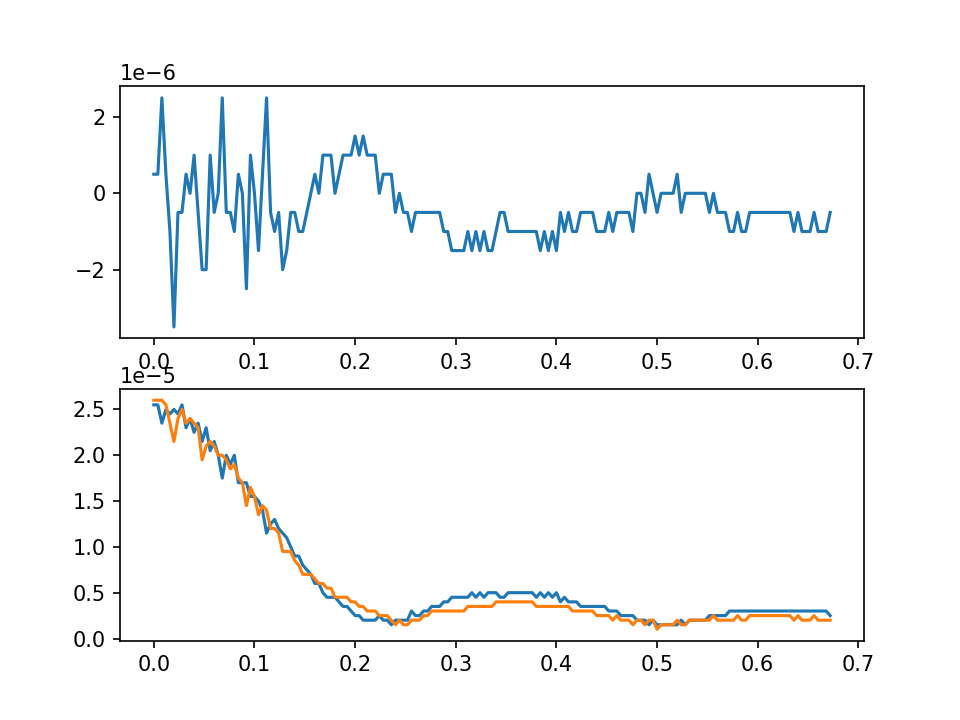

(169,) (169,) (169,)


In [75]:
## Run 238
max_idx_238g2=max_idx_238g-50+max_idx_238
n=1
max_idx_238g2=max_idx_238g2+n

saiz=np.size(Is_238)

if max_idx_238g2< (saiz-1)/2:
    Arange=max_idx_238g2
    Is_238_N=np.zeros(Arange)
    Is_238_P=np.zeros(Arange)
    Is_diff_238=np.zeros(Arange)
    By_238_shift=np.zeros(Arange)
    Is_238_N=np.flipud(Is_238[0:max_idx_238g2])
    Is_238_P=Is_238[max_idx_238g2+1:2*max_idx_238g2+1]
    By_238_shift=(By_238[max_idx_238g2:2*max_idx_238g2,1]-By_238[max_idx_238g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_238g2
    Is_238_N=np.zeros(Arange)
    Is_238_P=np.zeros(Arange)
    Is_diff_238=np.zeros(Arange)
    By_238_shift=np.zeros(Arange)
    Is_238_N=np.flipud(Is_238[max_idx_238g2-Arange:max_idx_238g2])
    Is_238_P=Is_238[max_idx_238g2+1:max_idx_238g2+1+Arange]
    By_238_shift=(By_238[max_idx_238g2:max_idx_238g2+Arange,1]-By_238[max_idx_238g2,1])/1e-3



for i in range(Arange):
    Is_diff_238[i]=Is_238_P[i]-Is_238_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_238_shift,Is_diff_238)
plt.subplot(212)
plt.plot(By_238_shift,Is_238_N)
plt.plot(By_238_shift,Is_238_P)

print(np.shape(Is_238_N), np.shape(Is_238_P), np.shape(By_238_shift))

<IPython.core.display.Javascript object>


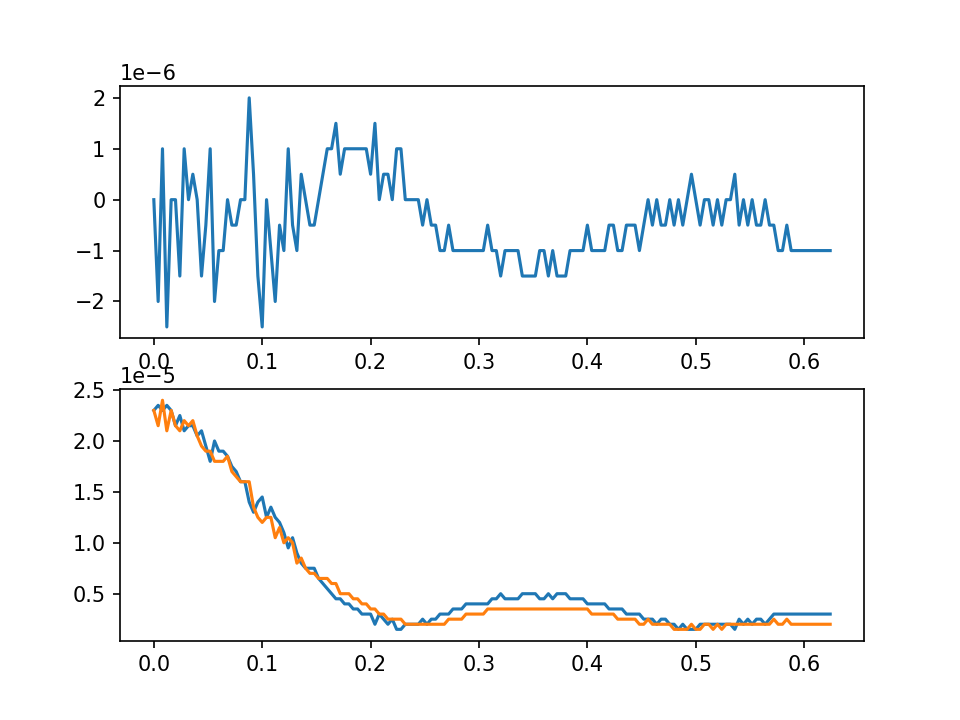

(157,) (157,) (157,)


In [76]:
## Run 239
max_idx_239g2=max_idx_239g-50+max_idx_239
n=1
max_idx_239g2=max_idx_239g2+n

saiz=np.size(Is_239)

if max_idx_239g2< (saiz-1)/2:
    Arange=max_idx_239g2
    Is_239_N=np.zeros(Arange)
    Is_239_P=np.zeros(Arange)
    Is_diff_239=np.zeros(Arange)
    By_239_shift=np.zeros(Arange)
    Is_239_N=np.flipud(Is_239[0:max_idx_239g2])
    Is_239_P=Is_239[max_idx_239g2+1:2*max_idx_239g2+1]
    By_239_shift=(By_239[max_idx_239g2:2*max_idx_239g2,1]-By_239[max_idx_239g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_239g2
    Is_239_N=np.zeros(Arange)
    Is_239_P=np.zeros(Arange)
    Is_diff_239=np.zeros(Arange)
    By_239_shift=np.zeros(Arange)
    Is_239_N=np.flipud(Is_239[max_idx_239g2-Arange:max_idx_239g2])
    Is_239_P=Is_239[max_idx_239g2+1:max_idx_239g2+1+Arange]
    By_239_shift=(By_239[max_idx_239g2:max_idx_239g2+Arange,1]-By_239[max_idx_239g2,1])/1e-3



for i in range(Arange):
    Is_diff_239[i]=Is_239_P[i]-Is_239_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_239_shift,Is_diff_239)
plt.subplot(212)
plt.plot(By_239_shift,Is_239_N)
plt.plot(By_239_shift,Is_239_P)

print(np.shape(Is_239_N), np.shape(Is_239_P), np.shape(By_239_shift))

<IPython.core.display.Javascript object>


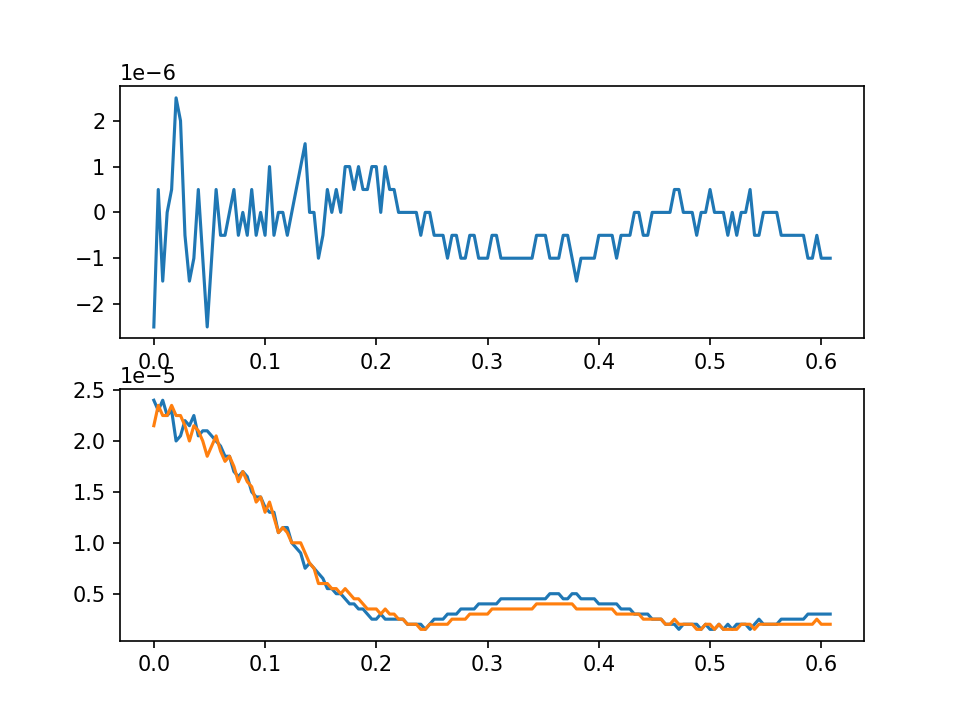

(153,) (153,) (153,)


In [77]:
## 240
max_idx_240g2=max_idx_240g-50+max_idx_240
n=1
max_idx_240g2=max_idx_240g2+n

saiz=np.size(Is_240)

if max_idx_240g2< (saiz-1)/2:
    Arange=max_idx_240g2
    Is_240_N=np.zeros(Arange)
    Is_240_P=np.zeros(Arange)
    Is_diff_240=np.zeros(Arange)
    By_240_shift=np.zeros(Arange)
    Is_240_N=np.flipud(Is_240[0:max_idx_240g2])
    Is_240_P=Is_240[max_idx_240g2+1:2*max_idx_240g2+1]
    By_240_shift=(By_240[max_idx_240g2:2*max_idx_240g2,1]-By_240[max_idx_240g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_240g2
    Is_240_N=np.zeros(Arange)
    Is_240_P=np.zeros(Arange)
    Is_diff_240=np.zeros(Arange)
    By_240_shift=np.zeros(Arange)
    Is_240_N=np.flipud(Is_240[max_idx_240g2-Arange:max_idx_240g2])
    Is_240_P=Is_240[max_idx_240g2+1:max_idx_240g2+1+Arange]
    By_240_shift=(By_240[max_idx_240g2:max_idx_240g2+Arange,1]-By_240[max_idx_240g2,1])/1e-3



for i in range(Arange):
    Is_diff_240[i]=Is_240_P[i]-Is_240_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_240_shift,Is_diff_240)
plt.subplot(212)
plt.plot(By_240_shift,Is_240_N)
plt.plot(By_240_shift,Is_240_P)

print(np.shape(Is_240_N), np.shape(Is_240_P), np.shape(By_240_shift))

<IPython.core.display.Javascript object>


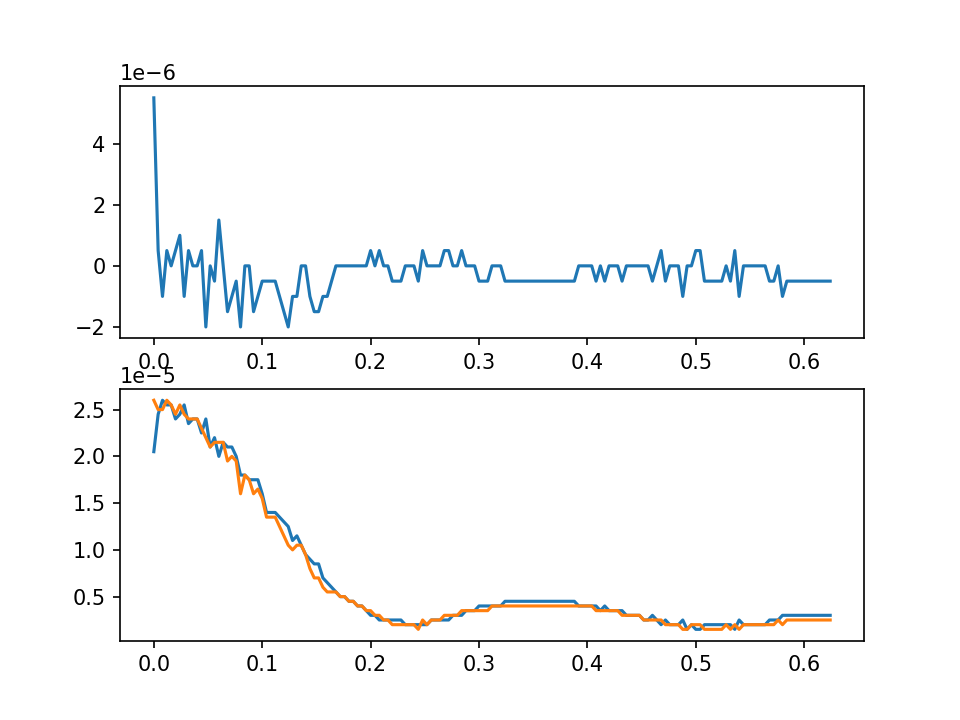

(157,) (157,) (157,)


In [78]:
## 241
max_idx_241g2=max_idx_241g-50+max_idx_241
n=1
max_idx_241g2=max_idx_241g2+n

saiz=np.size(Is_241)

if max_idx_241g2< (saiz-1)/2:
    Arange=max_idx_241g2
    Is_241_N=np.zeros(Arange)
    Is_241_P=np.zeros(Arange)
    Is_diff_241=np.zeros(Arange)
    By_241_shift=np.zeros(Arange)
    Is_241_N=np.flipud(Is_241[0:max_idx_241g2])
    Is_241_P=Is_241[max_idx_241g2+1:2*max_idx_241g2+1]
    By_241_shift=(By_241[max_idx_241g2:2*max_idx_241g2,1]-By_241[max_idx_241g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_241g2
    Is_241_N=np.zeros(Arange)
    Is_241_P=np.zeros(Arange)
    Is_diff_241=np.zeros(Arange)
    By_241_shift=np.zeros(Arange)
    Is_241_N=np.flipud(Is_241[max_idx_241g2-Arange:max_idx_241g2])
    Is_241_P=Is_241[max_idx_241g2+1:max_idx_241g2+1+Arange]
    By_241_shift=(By_241[max_idx_241g2:max_idx_241g2+Arange,1]-By_241[max_idx_241g2,1])/1e-3



for i in range(Arange):
    Is_diff_241[i]=Is_241_P[i]-Is_241_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_241_shift,Is_diff_241)
plt.subplot(212)
plt.plot(By_241_shift,Is_241_N)
plt.plot(By_241_shift,Is_241_P)

print(np.shape(Is_241_N), np.shape(Is_241_P), np.shape(By_241_shift))


<IPython.core.display.Javascript object>


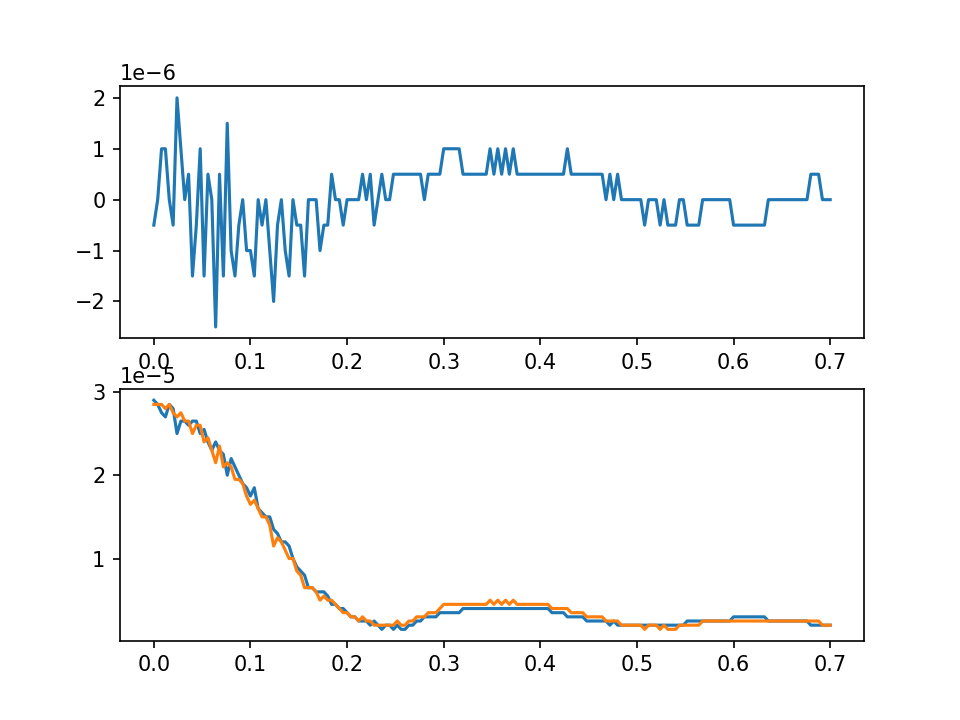

(176,) (176,) (176,)


In [79]:
## 242
max_idx_242g2=max_idx_242g-50+max_idx_242
n=1
max_idx_242g2=max_idx_242g2+n

saiz=np.size(Is_242)

if max_idx_242g2< (saiz-1)/2:
    Arange=max_idx_242g2
    Is_242_N=np.zeros(Arange)
    Is_242_P=np.zeros(Arange)
    Is_diff_242=np.zeros(Arange)
    By_242_shift=np.zeros(Arange)
    Is_242_N=np.flipud(Is_242[0:max_idx_242g2])
    Is_242_P=Is_242[max_idx_242g2+1:2*max_idx_242g2+1]
    By_242_shift=(By_242[max_idx_242g2:2*max_idx_242g2,1]-By_242[max_idx_242g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_242g2
    Is_242_N=np.zeros(Arange)
    Is_242_P=np.zeros(Arange)
    Is_diff_242=np.zeros(Arange)
    By_242_shift=np.zeros(Arange)
    Is_242_N=np.flipud(Is_242[max_idx_242g2-Arange:max_idx_242g2])
    Is_242_P=Is_242[max_idx_242g2+1:max_idx_242g2+1+Arange]
    By_242_shift=(By_242[max_idx_242g2:max_idx_242g2+Arange,1]-By_242[max_idx_242g2,1])/1e-3



for i in range(Arange):
    Is_diff_242[i]=Is_242_P[i]-Is_242_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_242_shift,Is_diff_242)
plt.subplot(212)
plt.plot(By_242_shift,Is_242_N)
plt.plot(By_242_shift,Is_242_P)

print(np.shape(Is_242_N), np.shape(Is_242_P), np.shape(By_242_shift))

<IPython.core.display.Javascript object>


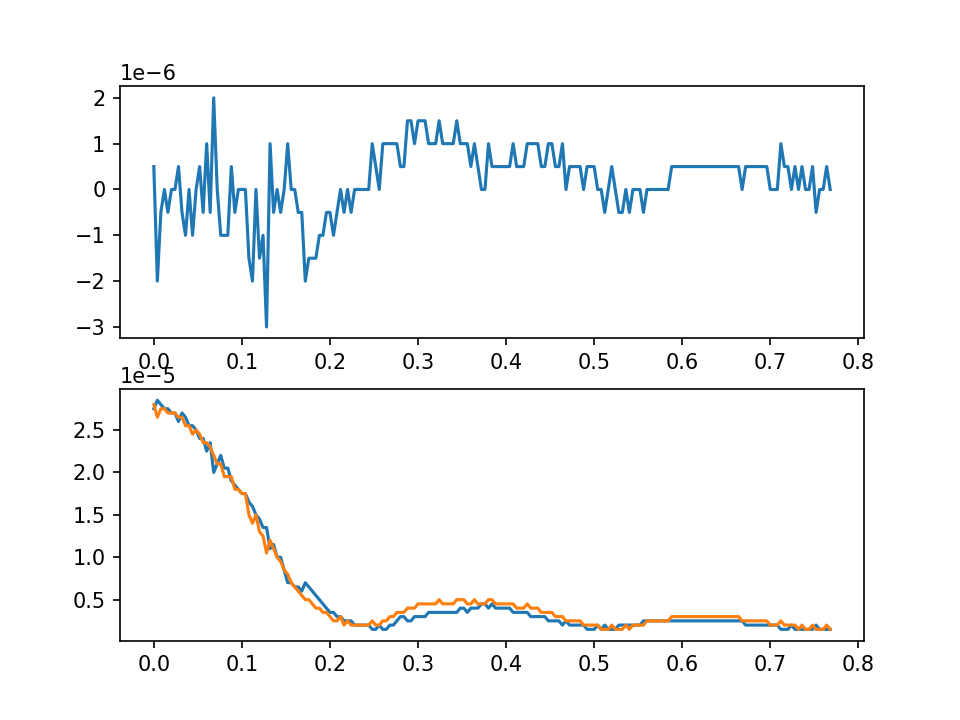

(193,) (193,) (193,)


In [80]:
## 243
max_idx_243g2=max_idx_243g-50+max_idx_243
n=1
max_idx_243g2=max_idx_243g2+n

saiz=np.size(Is_243)

if max_idx_243g2< (saiz-1)/2:
    Arange=max_idx_243g2
    Is_243_N=np.zeros(Arange)
    Is_243_P=np.zeros(Arange)
    Is_diff_243=np.zeros(Arange)
    By_243_shift=np.zeros(Arange)
    Is_243_N=np.flipud(Is_243[0:max_idx_243g2])
    Is_243_P=Is_243[max_idx_243g2+1:2*max_idx_243g2+1]
    By_243_shift=(By_243[max_idx_243g2:2*max_idx_243g2,1]-By_243[max_idx_243g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_243g2
    Is_243_N=np.zeros(Arange)
    Is_243_P=np.zeros(Arange)
    Is_diff_243=np.zeros(Arange)
    By_243_shift=np.zeros(Arange)
    Is_243_N=np.flipud(Is_243[max_idx_243g2-Arange:max_idx_243g2])
    Is_243_P=Is_243[max_idx_243g2+1:max_idx_243g2+1+Arange]
    By_243_shift=(By_243[max_idx_243g2:max_idx_243g2+Arange,1]-By_243[max_idx_243g2,1])/1e-3



for i in range(Arange):
    Is_diff_243[i]=Is_243_P[i]-Is_243_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_243_shift,Is_diff_243)
plt.subplot(212)
plt.plot(By_243_shift,Is_243_N)
plt.plot(By_243_shift,Is_243_P)

print(np.shape(Is_243_N), np.shape(Is_243_P), np.shape(By_243_shift))

<IPython.core.display.Javascript object>


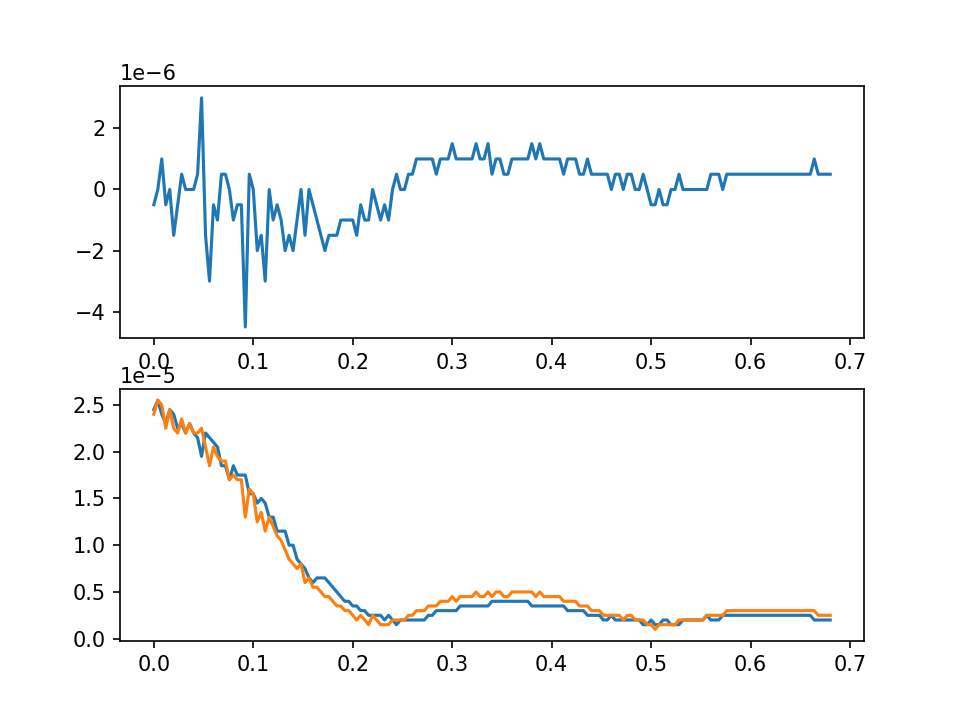

(171,) (171,) (171,)


In [81]:
## 244
max_idx_244g2=max_idx_244g-50+max_idx_244
n=1
max_idx_244g2=max_idx_244g2+n

saiz=np.size(Is_244)

if max_idx_244g2< (saiz-1)/2:
    Arange=max_idx_244g2
    Is_244_N=np.zeros(Arange)
    Is_244_P=np.zeros(Arange)
    Is_diff_244=np.zeros(Arange)
    By_244_shift=np.zeros(Arange)
    Is_244_N=np.flipud(Is_244[0:max_idx_244g2])
    Is_244_P=Is_244[max_idx_244g2+1:2*max_idx_244g2+1]
    By_244_shift=(By_244[max_idx_244g2:2*max_idx_244g2,1]-By_244[max_idx_244g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_244g2
    Is_244_N=np.zeros(Arange)
    Is_244_P=np.zeros(Arange)
    Is_diff_244=np.zeros(Arange)
    By_244_shift=np.zeros(Arange)
    Is_244_N=np.flipud(Is_244[max_idx_244g2-Arange:max_idx_244g2])
    Is_244_P=Is_244[max_idx_244g2+1:max_idx_244g2+1+Arange]
    By_244_shift=(By_244[max_idx_244g2:max_idx_244g2+Arange,1]-By_244[max_idx_244g2,1])/1e-3



for i in range(Arange):
    Is_diff_244[i]=Is_244_P[i]-Is_244_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_244_shift,Is_diff_244)
plt.subplot(212)
plt.plot(By_244_shift,Is_244_N)
plt.plot(By_244_shift,Is_244_P)

print(np.shape(Is_244_N), np.shape(Is_244_P), np.shape(By_244_shift))

In [34]:
np.size(Is_diff_233)

154

## Run 231 to 244 Angle dependence

<IPython.core.display.Javascript object>


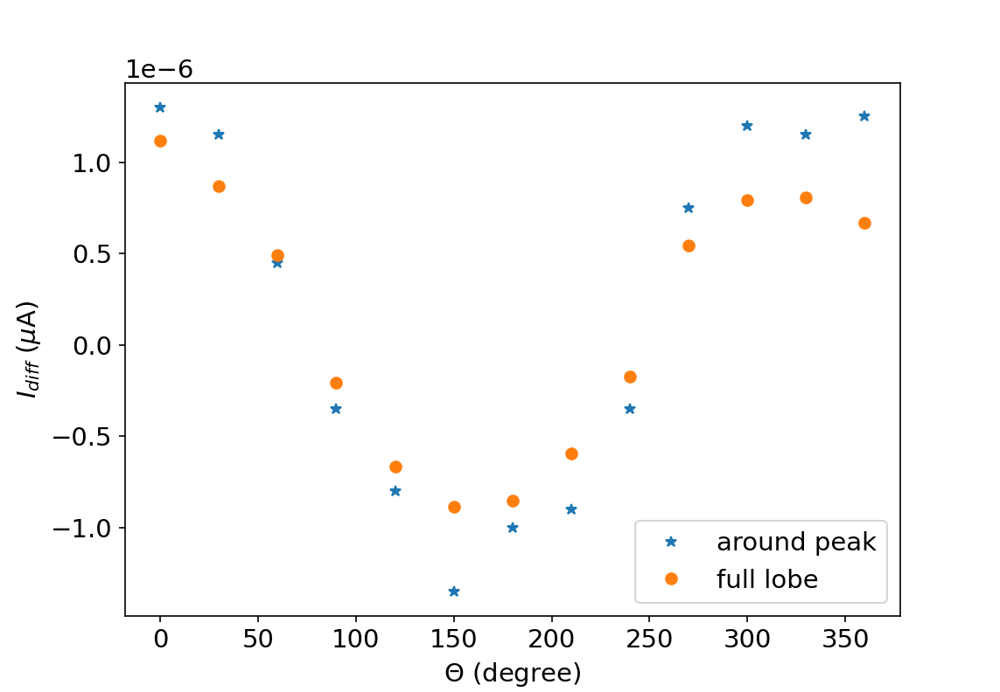

In [84]:
plt.figure(figsize=(5.5, 4))
'''
# plt.plot(By_244_shift,Is_diff_244)
plt.plot(Is_diff_231)
plt.plot(Is_diff_233)
plt.plot(Is_diff_234)
plt.plot(Is_diff_235)
plt.plot(Is_diff_236)
plt.plot(Is_diff_237)
plt.plot(Is_diff_238)
plt.plot(Is_diff_239)
plt.plot(Is_diff_240)
plt.plot(Is_diff_241)
plt.plot(Is_diff_242)
plt.plot(Is_diff_243)
plt.plot(Is_diff_244)
# plt.xlabel('I ($\mu$A)')
# plt.ylabel('V (mV)')
'''
Is_diff_L02all=np.zeros((13,125))
Is_diff_L02all[12,:]=Is_diff_231[0:125]
Is_diff_L02all[0,:]=Is_diff_233[0:125]
Is_diff_L02all[1,:]=Is_diff_234[0:125]
Is_diff_L02all[2,:]=Is_diff_235[0:125]
Is_diff_L02all[3,:]=Is_diff_236[0:125]
Is_diff_L02all[4,:]=Is_diff_237[0:125]
Is_diff_L02all[5,:]=Is_diff_238[0:125]
Is_diff_L02all[6,:]=Is_diff_239[0:125]
Is_diff_L02all[7,:]=Is_diff_240[0:125]
Is_diff_L02all[8,:]=Is_diff_241[0:125]
Is_diff_L02all[9,:]=Is_diff_242[0:125]
Is_diff_L02all[10,:]=Is_diff_243[0:125]
Is_diff_L02all[11,:]=Is_diff_244[0:125]

theta=np.linspace(0,360,13)
# plt.plot(Is_diff_L02all[1,0:125])
test1=np.zeros(13)
for i in range(13):
    test1[i]=np.mean(Is_diff_L02all[i,75:85])

test2=np.zeros(13)
for i in range(13):
    test2[i]=np.mean(Is_diff_L02all[i,60:120])

plt.rcParams.update({'font.size': 14})
plt.plot(theta,test1, '*',  label='around peak')
plt.plot(theta,test2, 'o', label='full lobe')
plt.xlabel('$\Theta$ (degree)')
plt.ylabel('$I_{diff}$ ($\mu$A)')
plt.legend(loc="lower right")
# print(theta)

<IPython.core.display.Javascript object>


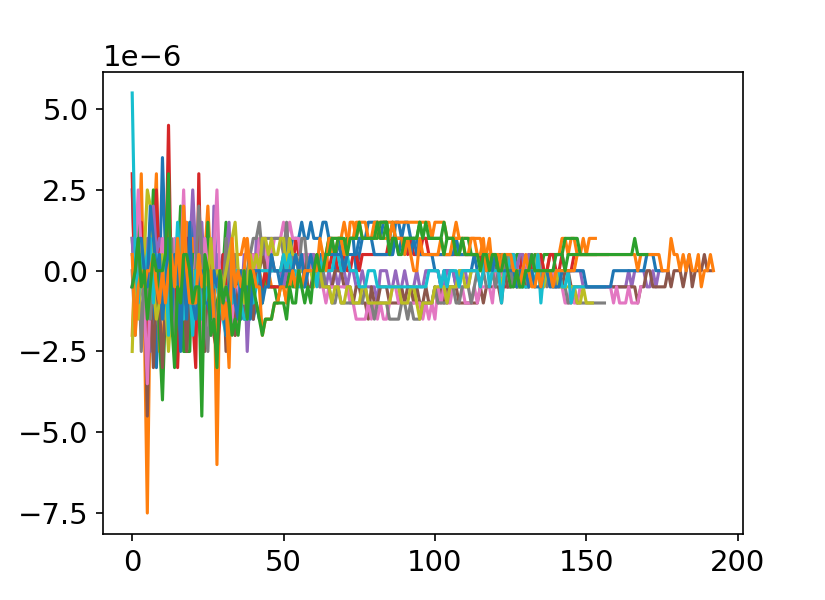

In [77]:
plt.figure(figsize=(5.5, 4))
# plt.plot(By_244_shift,Is_diff_244)
plt.plot(Is_diff_231)
plt.plot(Is_diff_233)
plt.plot(Is_diff_234)
plt.plot(Is_diff_235)
plt.plot(Is_diff_236)
plt.plot(Is_diff_237)
plt.plot(Is_diff_238)
plt.plot(Is_diff_239)
plt.plot(Is_diff_240)
plt.plot(Is_diff_241)
plt.plot(Is_diff_242)
plt.plot(Is_diff_243)
plt.plot(Is_diff_244)
# plt.xlabel('I ($\mu$A)')
# plt.ylabel('V (mV)')

# L 01 JJ1

## Run 258 IV_By_0degree_Bx= 10 mT

In [16]:
runid=258
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [17]:
By_258=By_field
I_258=I
V_258=V
R_258=R_DC1

np.savetxt('L01_258_By.csv', (By_258), fmt='%s', delimiter=',')
np.savetxt('L01_258_I.csv', (I_258), fmt='%s', delimiter=',')
np.savetxt('L01_258_V.csv', (V_258), fmt='%s', delimiter=',')
np.savetxt('L01_258_R.csv', (R_258), fmt='%s', delimiter=',')

In [18]:
By_258=np.loadtxt('L01_258_By.csv', delimiter=",")
I_258=np.loadtxt('L01_258_I.csv', delimiter=",")
V_258=np.loadtxt('L01_258_V.csv', delimiter=",")
R_258=np.loadtxt('L01_258_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


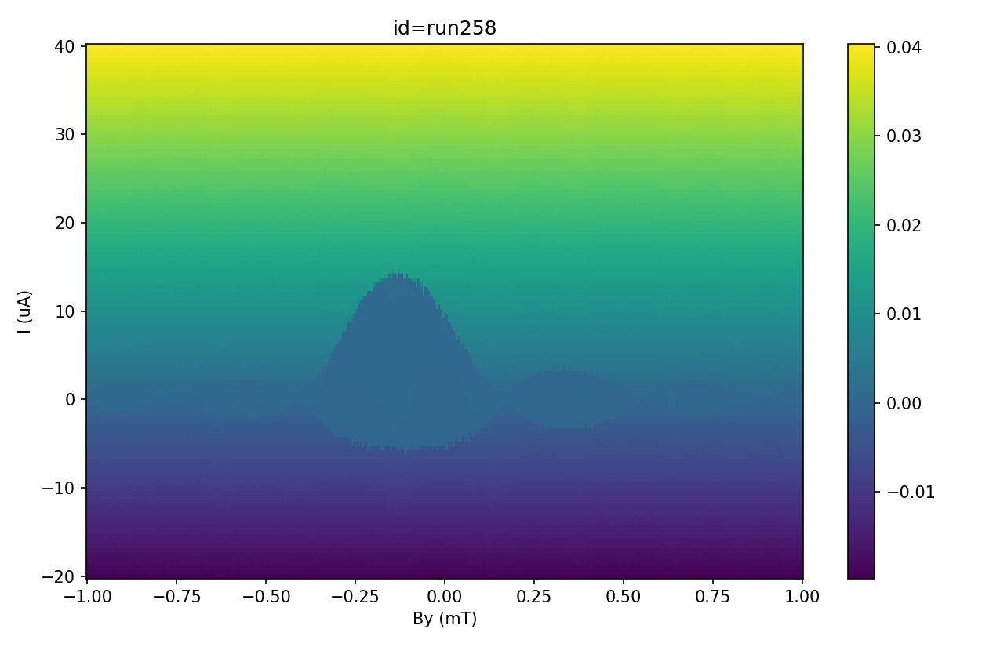

In [15]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_258/1e-3, I_258/1e-6, V_258/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run258')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


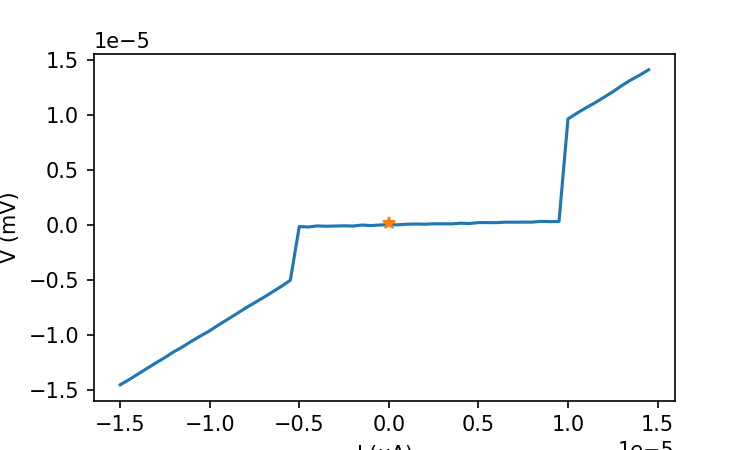

1.4293059294999997e-07


In [16]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_258[150,30:50])
plt.plot(I_258[150,10:70],V_258[150,10:70]-DCoff)
plt.plot(I_258[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [19]:
saiz=np.shape(V_258)
# print(saiz)
Is_258=np.zeros(saiz[0])
Ir_258=np.zeros(saiz[0])
fV_258=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_258)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_258[i,30:50])
        if V_258[i,j]-DCoff > 9e-7:
            Is_258[i]=I_258[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_258[i,30:50])
        if -V_258[i,j]-DCoff < 5e-7:
            Ir_258[i]=I_258[i,j]
            break

<IPython.core.display.Javascript object>


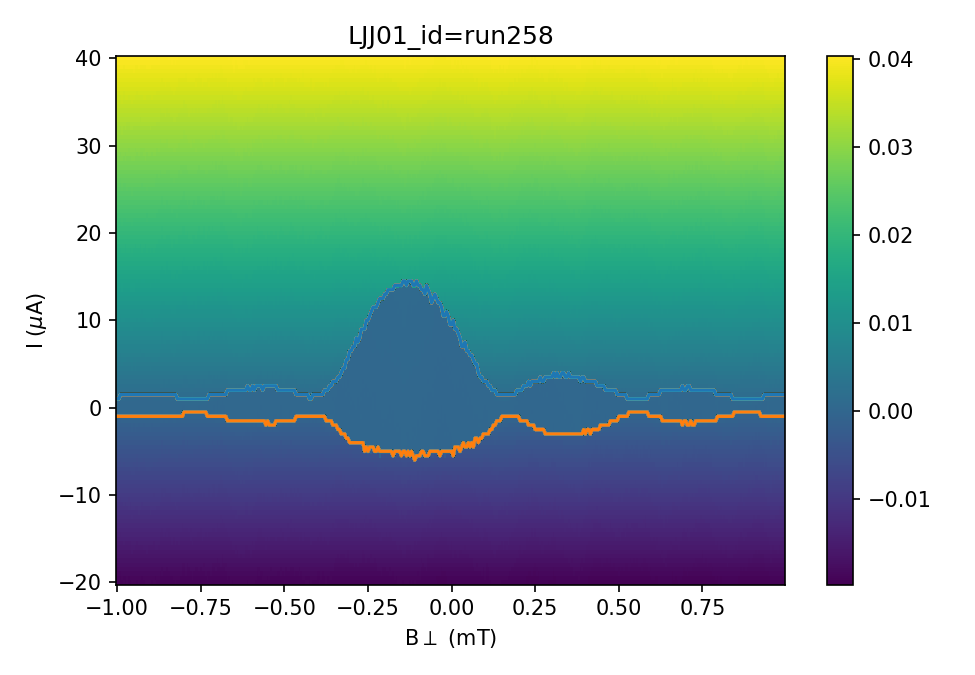

In [20]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

im = ax0.pcolormesh(By_258[Arange:Brange,:]/1e-3, I_258[Arange:Brange,:]/1e-6, V_258[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run258')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_258[Arange:Brange,:]/1e-3,Is_258[Arange:Brange]/1e-6)
plt.plot(By_258[Arange:Brange,:]/1e-3,Ir_258[Arange:Brange]/1e-6)

np.savetxt('Is_258.csv', (Is_258), fmt='%s', delimiter=',')
np.savetxt('Ir_258.csv', (Ir_258), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 259 IV_By_30 degree_Bx=,Bz=

In [23]:
runid=259
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [24]:
By_259=By_field
I_259=I
V_259=V
R_259=R_DC1

np.savetxt('L01_259_By.csv', (By_259), fmt='%s', delimiter=',')
np.savetxt('L01_259_I.csv', (I_259), fmt='%s', delimiter=',')
np.savetxt('L01_259_V.csv', (V_259), fmt='%s', delimiter=',')
np.savetxt('L01_259_R.csv', (R_259), fmt='%s', delimiter=',')

In [64]:
By_259=np.loadtxt('L01_259_By.csv', delimiter=",")
I_259=np.loadtxt('L01_259_I.csv', delimiter=",")
V_259=np.loadtxt('L01_259_V.csv', delimiter=",")
R_259=np.loadtxt('L01_259_R.csv', delimiter=",")
Is_259=np.loadtxt('Is_259.csv', delimiter=",")
Ir_259=np.loadtxt('Ir_259.csv', delimiter=",")

<IPython.core.display.Javascript object>


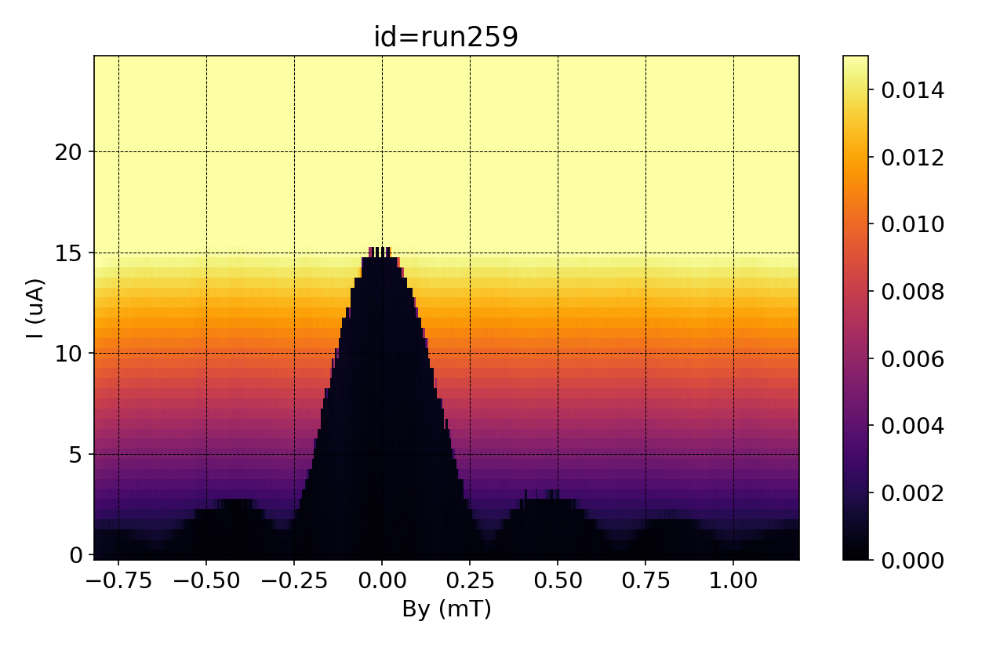

In [79]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=40
Brange=90

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(By_259/1e-3, I_259/1e-6, V_259/1e-3, cmap = 'viridis')#, vmax=1
im = ax0.pcolormesh(By_259[:,Arange:Brange]/1e-3+0.184, I_259[:,Arange:Brange]/1e-6, V_259[:,Arange:Brange]/1e-3, cmap = 'inferno', vmax=0.015, vmin=0)


fig.colorbar(im, ax=ax0)
ax0.set_title('id=run259')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
plt.show()

<IPython.core.display.Javascript object>


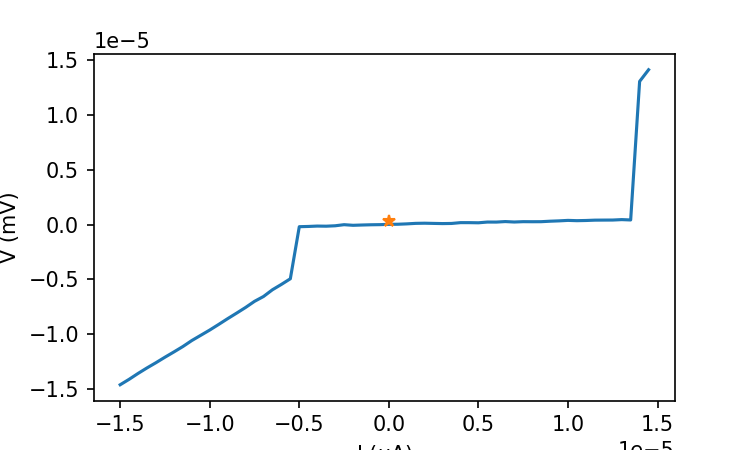

2.89196054e-07


In [27]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_259[150,30:50])
plt.plot(I_259[150,10:70],V_259[150,10:70]-DCoff)
plt.plot(I_259[150,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [22]:
saiz=np.shape(V_258)
# print(saiz)
Is_259=np.zeros(saiz[0])
Ir_259=np.zeros(saiz[0])
fV_259=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_259)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_259[i,30:50])
        if V_259[i,j]-DCoff > 9.5e-7:
            Is_259[i]=I_259[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_259[i,30:50])
        if -V_259[i,j]-DCoff < 5e-7:
            Ir_259[i]=I_259[i,j]
            break

<IPython.core.display.Javascript object>


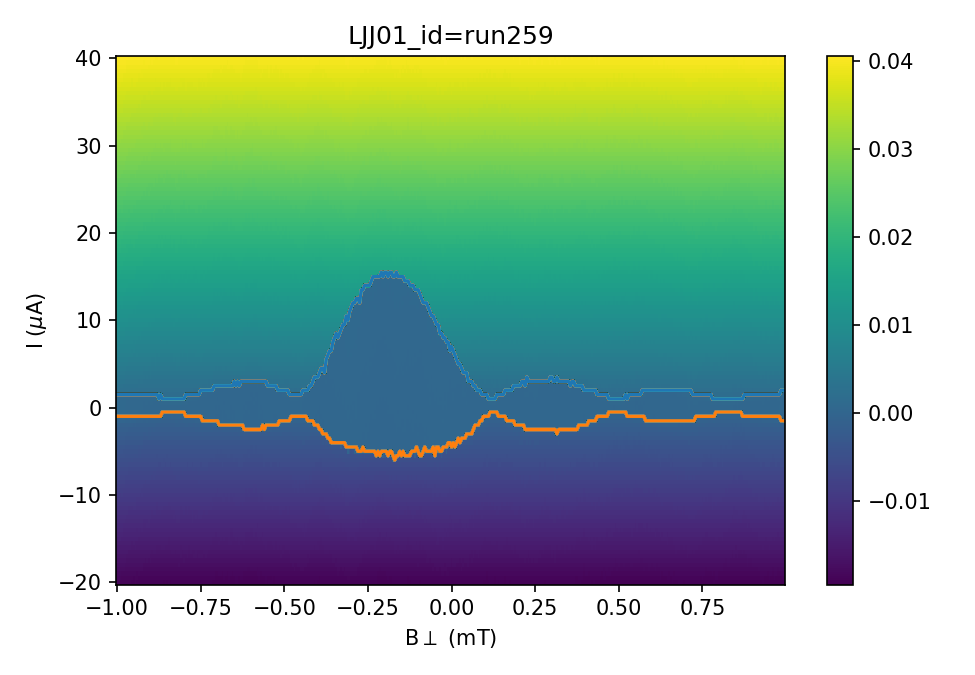

In [23]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_259[Arange:Brange,:]/1e-3, I_259[Arange:Brange,:]/1e-6, V_259[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run259')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_259[Arange:Brange,:]/1e-3,Is_259[Arange:Brange]/1e-6)
plt.plot(By_259[Arange:Brange,:]/1e-3,Ir_259[Arange:Brange]/1e-6)

np.savetxt('Is_259.csv', (Is_259), fmt='%s', delimiter=',')
np.savetxt('Ir_259.csv', (Ir_259), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 260 IV_By_60 degree_Bx=,Bz=

In [30]:
runid=260
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [31]:
By_260=By_field
I_260=I
V_260=V
R_260=R_DC1

np.savetxt('L01_260_By.csv', (By_260), fmt='%s', delimiter=',')
np.savetxt('L01_260_I.csv', (I_260), fmt='%s', delimiter=',')
np.savetxt('L01_260_V.csv', (V_260), fmt='%s', delimiter=',')
np.savetxt('L01_260_R.csv', (R_260), fmt='%s', delimiter=',')

In [32]:
By_260=np.loadtxt('L01_260_By.csv', delimiter=",")
I_260=np.loadtxt('L01_260_I.csv', delimiter=",")
V_260=np.loadtxt('L01_260_V.csv', delimiter=",")
R_260=np.loadtxt('L01_260_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


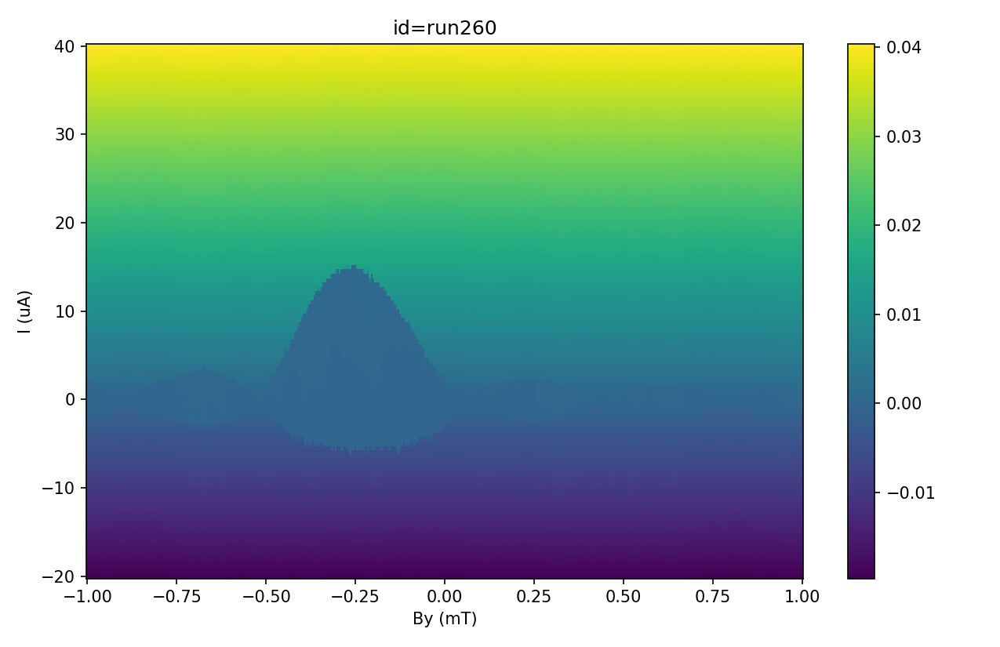

In [33]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_260/1e-3, I_260/1e-6, V_260/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run260')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


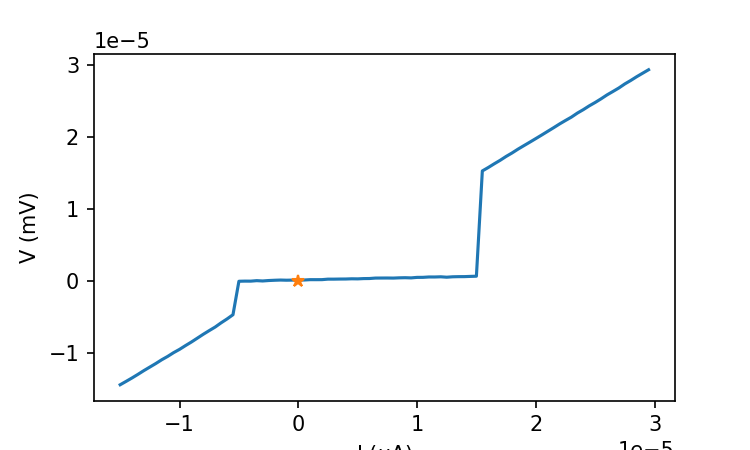

-2.4499585000000018e-08


In [34]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_260[100,30:50])
plt.plot(I_260[100,10:100],V_260[150,10:100]-DCoff)
plt.plot(I_260[100,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [115]:
saiz=np.shape(V_260)
# print(saiz)
Is_260=np.zeros(saiz[0])
Ir_260=np.zeros(saiz[0])
fV_260=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_260)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_260[i,30:50])
        if V_260[i,j]-DCoff > 9e-7:
            Is_260[i]=I_260[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_260[i,30:50])
        if -V_260[i,j]-DCoff < 5e-7:
            Ir_260[i]=I_260[i,j]
            break

<IPython.core.display.Javascript object>


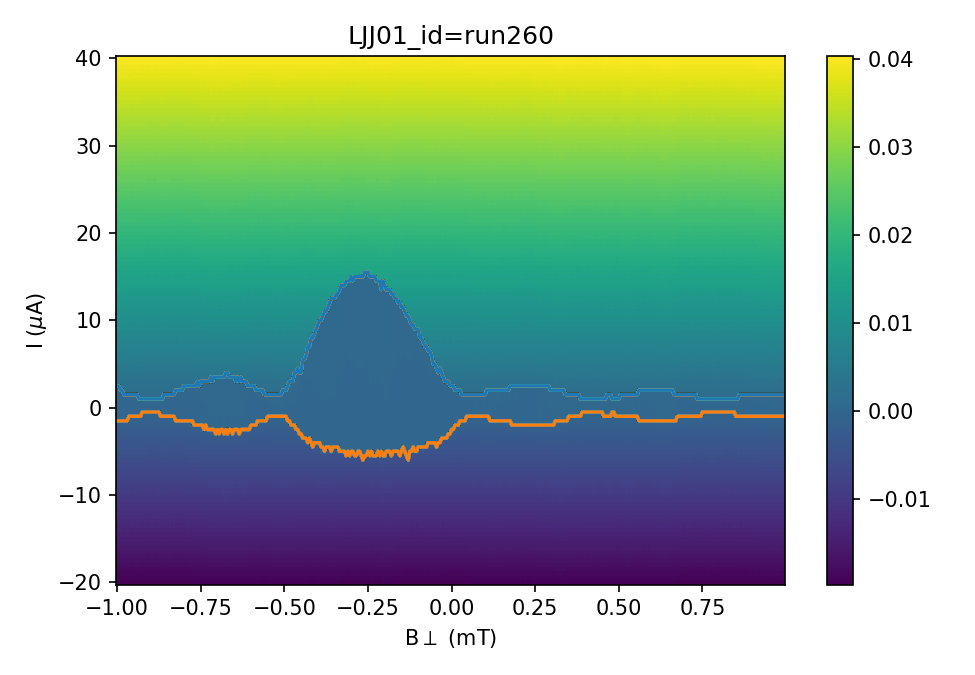

In [116]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_260[Arange:Brange,:]/1e-3, I_260[Arange:Brange,:]/1e-6, V_260[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run260')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_260[Arange:Brange,:]/1e-3,Is_260[Arange:Brange]/1e-6)
plt.plot(By_260[Arange:Brange,:]/1e-3,Ir_260[Arange:Brange]/1e-6)

np.savetxt('Is_260.csv', (Is_260), fmt='%s', delimiter=',')
np.savetxt('Ir_260.csv', (Ir_260), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 261 IV_By_90 degree_Bx=,Bz=

In [37]:
runid=261
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [38]:
By_261=By_field
I_261=I
V_261=V
R_261=R_DC1

np.savetxt('L01_261_By.csv', (By_261), fmt='%s', delimiter=',')
np.savetxt('L01_261_I.csv', (I_261), fmt='%s', delimiter=',')
np.savetxt('L01_261_V.csv', (V_261), fmt='%s', delimiter=',')
np.savetxt('L01_261_R.csv', (R_261), fmt='%s', delimiter=',')

In [39]:
By_261=np.loadtxt('L01_261_By.csv', delimiter=",")
I_261=np.loadtxt('L01_261_I.csv', delimiter=",")
V_261=np.loadtxt('L01_261_V.csv', delimiter=",")
R_261=np.loadtxt('L01_261_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


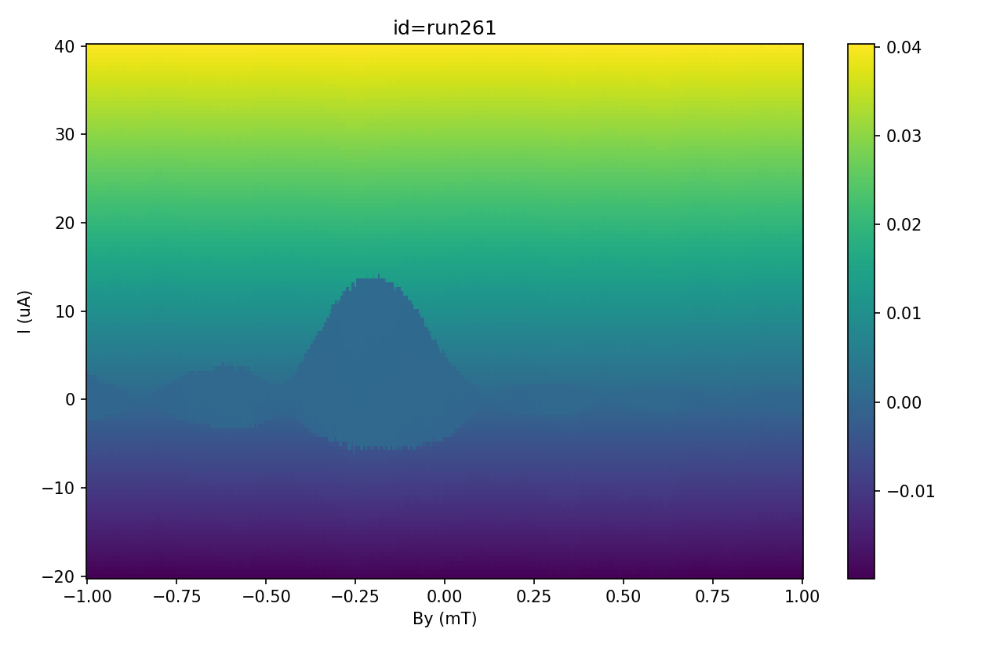

In [40]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_261/1e-3, I_261/1e-6, V_261/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run261')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


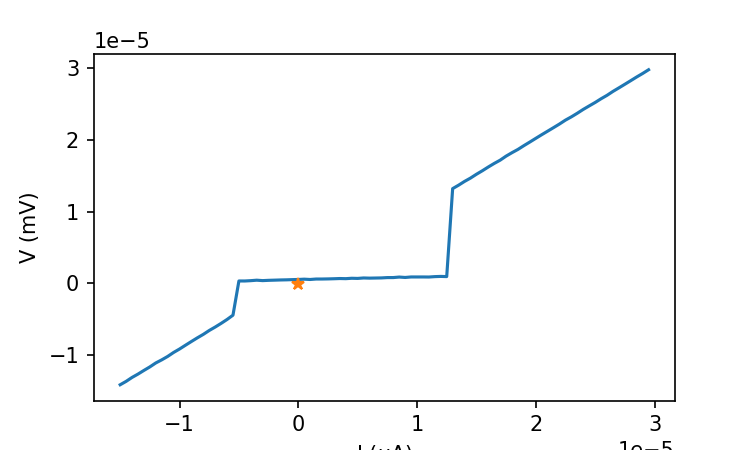

-1.0213757849999994e-07


In [41]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_261[100,30:50])
plt.plot(I_261[100,10:100],V_261[150,10:100]-DCoff)
plt.plot(I_261[100,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

In [117]:
saiz=np.shape(V_261)
# print(saiz)
Is_261=np.zeros(saiz[0])
Ir_261=np.zeros(saiz[0])
fV_261=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_261)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_261[i,30:50])
        if V_261[i,j]-DCoff > 9.8e-7:
            Is_261[i]=I_261[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_261[i,30:50])
        if -V_261[i,j]-DCoff < 5e-7:
            Ir_261[i]=I_261[i,j]
            break

<IPython.core.display.Javascript object>


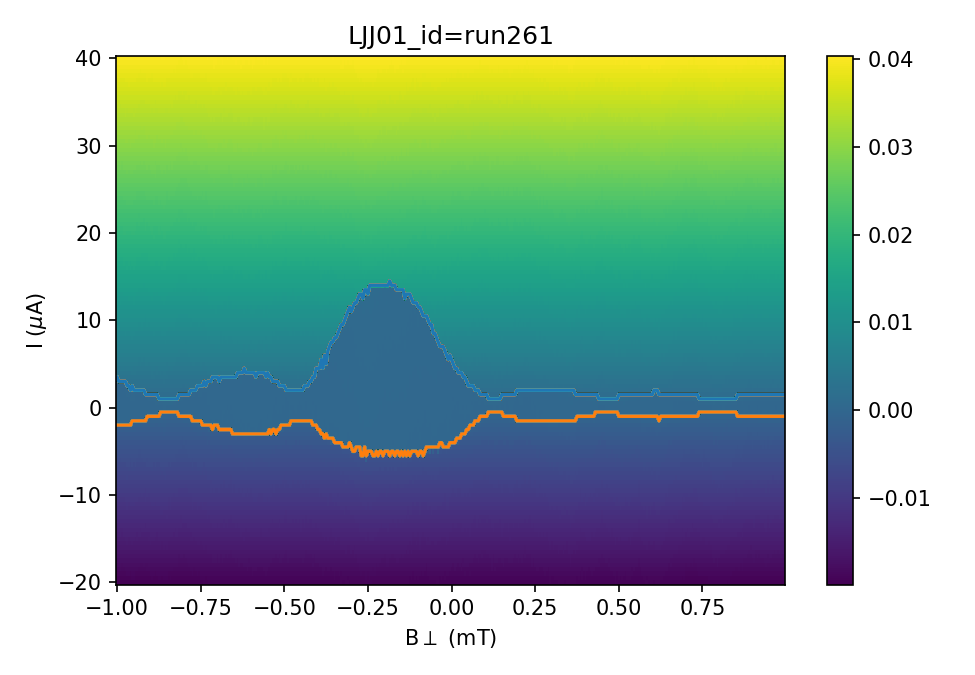

In [118]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_261[Arange:Brange,:]/1e-3, I_261[Arange:Brange,:]/1e-6, V_261[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run261')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_261[Arange:Brange,:]/1e-3,Is_261[Arange:Brange]/1e-6)
plt.plot(By_261[Arange:Brange,:]/1e-3,Ir_261[Arange:Brange]/1e-6)

np.savetxt('Is_261.csv', (Is_261), fmt='%s', delimiter=',')
np.savetxt('Ir_261.csv', (Ir_261), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 262 IV_By_120 degree_Bx=,Bz=

In [46]:
runid=262
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [47]:
By_262=By_field
I_262=I
V_262=V
R_262=R_DC1

np.savetxt('L01_262_By.csv', (By_262), fmt='%s', delimiter=',')
np.savetxt('L01_262_I.csv', (I_262), fmt='%s', delimiter=',')
np.savetxt('L01_262_V.csv', (V_262), fmt='%s', delimiter=',')
np.savetxt('L01_262_R.csv', (R_262), fmt='%s', delimiter=',')

In [69]:
By_262=np.loadtxt('L01_262_By.csv', delimiter=",")
I_262=np.loadtxt('L01_262_I.csv', delimiter=",")
V_262=np.loadtxt('L01_262_V.csv', delimiter=",")
R_262=np.loadtxt('L01_262_R.csv', delimiter=",")
Is_262=np.loadtxt('Is_262.csv', delimiter=",")
Ir_262=np.loadtxt('Ir_262.csv', delimiter=",")

<IPython.core.display.Javascript object>


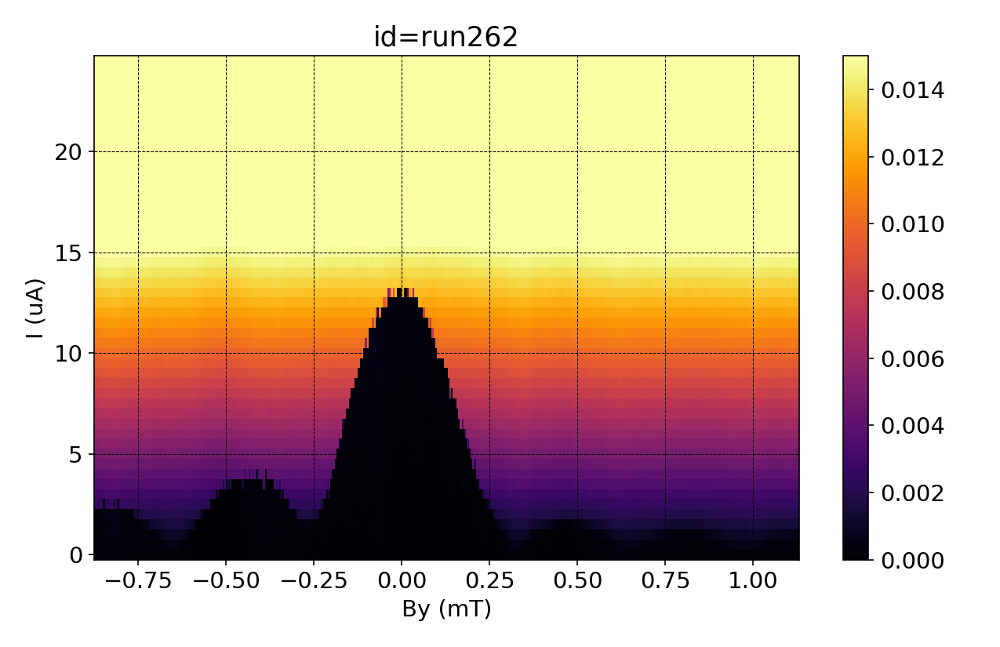

In [73]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=40
Brange=90

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(By_262/1e-3, I_262/1e-6, V_262/1e-3, cmap = 'viridis')#, vmax=1
im = ax0.pcolormesh(By_262[:,Arange:Brange]/1e-3+0.128, I_262[:,Arange:Brange]/1e-6, V_262[:,Arange:Brange]/1e-3, cmap = 'inferno', vmax=0.015, vmin=0)

fig.colorbar(im, ax=ax0)
ax0.set_title('id=run262')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
plt.show()

In [30]:
saiz=np.shape(V_262)
# print(saiz)
Is_262=np.zeros(saiz[0])
Ir_262=np.zeros(saiz[0])
fV_262=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_262)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_262[i,30:50])
        if V_262[i,j]-DCoff > 10.5e-7:
            Is_262[i]=I_262[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_262[i,30:50])
        if -V_262[i,j]-DCoff < 5e-7:
            Ir_262[i]=I_262[i,j]
            break

<IPython.core.display.Javascript object>


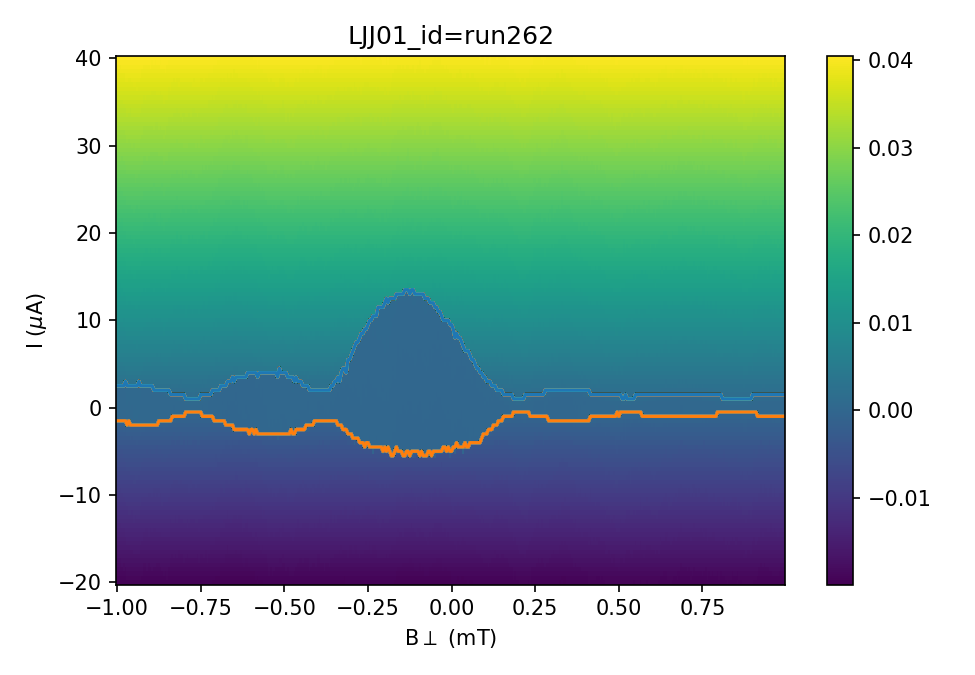

In [31]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_262[Arange:Brange,:]/1e-3, I_262[Arange:Brange,:]/1e-6, V_262[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run262')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_262[Arange:Brange,:]/1e-3,Is_262[Arange:Brange]/1e-6)
plt.plot(By_262[Arange:Brange,:]/1e-3,Ir_262[Arange:Brange]/1e-6)

np.savetxt('Is_262.csv', (Is_262), fmt='%s', delimiter=',')
np.savetxt('Ir_262.csv', (Ir_262), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 263 IV_By_150 degree_Bx=,Bz=

In [56]:
runid=263
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [57]:
By_263=By_field
I_263=I
V_263=V
R_263=R_DC1

np.savetxt('L01_263_By.csv', (By_263), fmt='%s', delimiter=',')
np.savetxt('L01_263_I.csv', (I_263), fmt='%s', delimiter=',')
np.savetxt('L01_263_V.csv', (V_263), fmt='%s', delimiter=',')
np.savetxt('L01_263_R.csv', (R_263), fmt='%s', delimiter=',')

In [58]:
By_263=np.loadtxt('L01_263_By.csv', delimiter=",")
I_263=np.loadtxt('L01_263_I.csv', delimiter=",")
V_263=np.loadtxt('L01_263_V.csv', delimiter=",")
R_263=np.loadtxt('L01_263_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


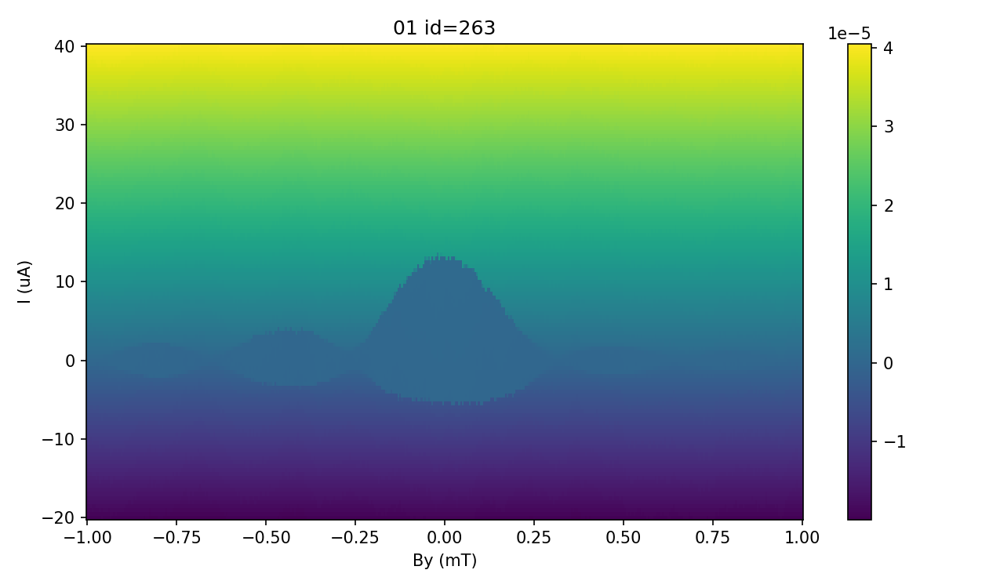

In [59]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)


im = ax0.pcolormesh(By_263/1e-3, I_263/1e-6, V_263, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax0)
ax0.set_title('01 id='+str(runid))
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [61]:
saiz=np.shape(V_263)
# print(saiz)
Is_263=np.zeros(saiz[0])
Ir_263=np.zeros(saiz[0])
fV_263=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_263)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_263[i,30:50])
        if V_263[i,j]-DCoff > 9.8e-7:
            Is_263[i]=I_263[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_263[i,30:50])
        if -V_263[i,j]-DCoff < 5e-7:
            Ir_263[i]=I_263[i,j]
            break

<IPython.core.display.Javascript object>


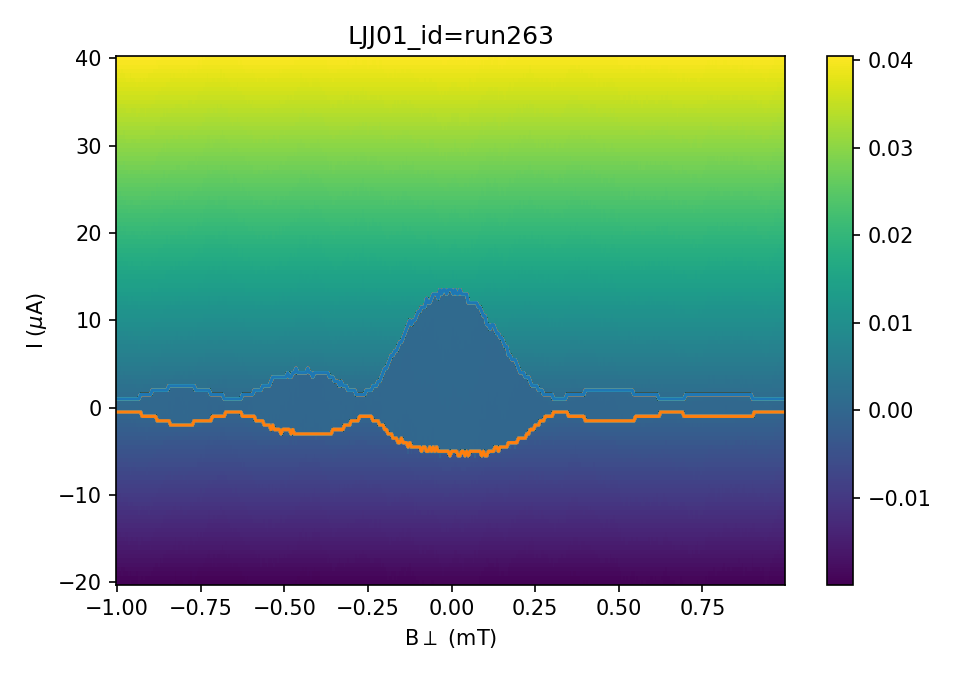

In [62]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_263[Arange:Brange,:]/1e-3, I_263[Arange:Brange,:]/1e-6, V_263[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run263')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_263[Arange:Brange,:]/1e-3,Is_263[Arange:Brange]/1e-6)
plt.plot(By_263[Arange:Brange,:]/1e-3,Ir_263[Arange:Brange]/1e-6)

np.savetxt('Is_263.csv', (Is_263), fmt='%s', delimiter=',')
np.savetxt('Ir_263.csv', (Ir_263), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 264 IV_By_180 degree_Bx=,Bz=

In [63]:
runid=264
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [64]:
By_264=By_field
I_264=I
V_264=V
R_264=R_DC1

np.savetxt('L01_264_By.csv', (By_264), fmt='%s', delimiter=',')
np.savetxt('L01_264_I.csv', (I_264), fmt='%s', delimiter=',')
np.savetxt('L01_264_V.csv', (V_264), fmt='%s', delimiter=',')
np.savetxt('L01_264_R.csv', (R_264), fmt='%s', delimiter=',')

In [65]:
By_264=np.loadtxt('L01_264_By.csv', delimiter=",")
I_264=np.loadtxt('L01_264_I.csv', delimiter=",")
V_264=np.loadtxt('L01_264_V.csv', delimiter=",")
R_264=np.loadtxt('L01_264_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


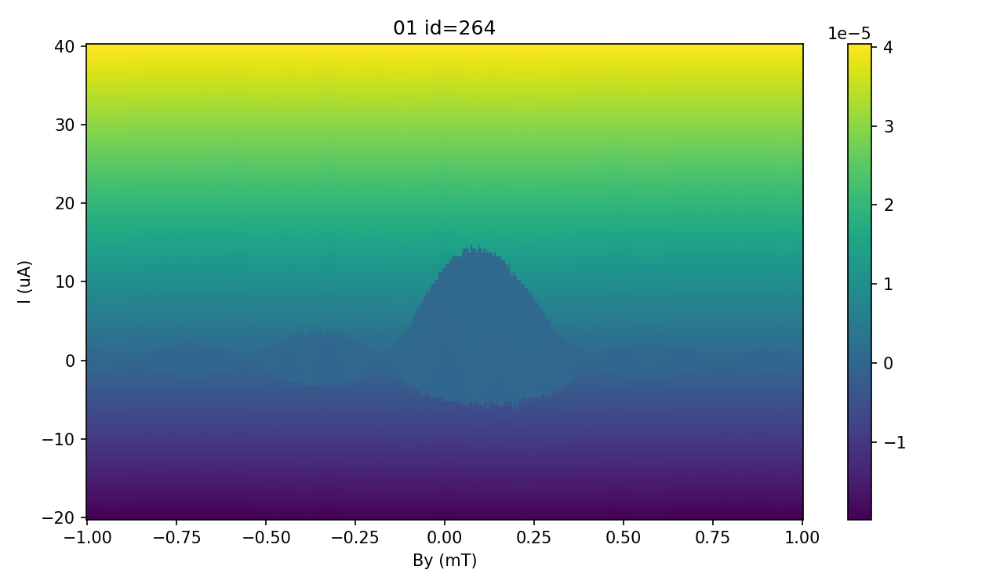

In [66]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)


im = ax0.pcolormesh(By_264/1e-3, I_264/1e-6, V_264, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax0)
ax0.set_title('01 id='+str(runid))
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [67]:
saiz=np.shape(V_264)
# print(saiz)
Is_264=np.zeros(saiz[0])
Ir_264=np.zeros(saiz[0])
fV_264=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_264)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_264[i,30:50])
        if V_264[i,j]-DCoff > 9.8e-7:
            Is_264[i]=I_264[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_264[i,30:50])
        if -V_264[i,j]-DCoff < 5e-7:
            Ir_264[i]=I_264[i,j]
            break

<IPython.core.display.Javascript object>


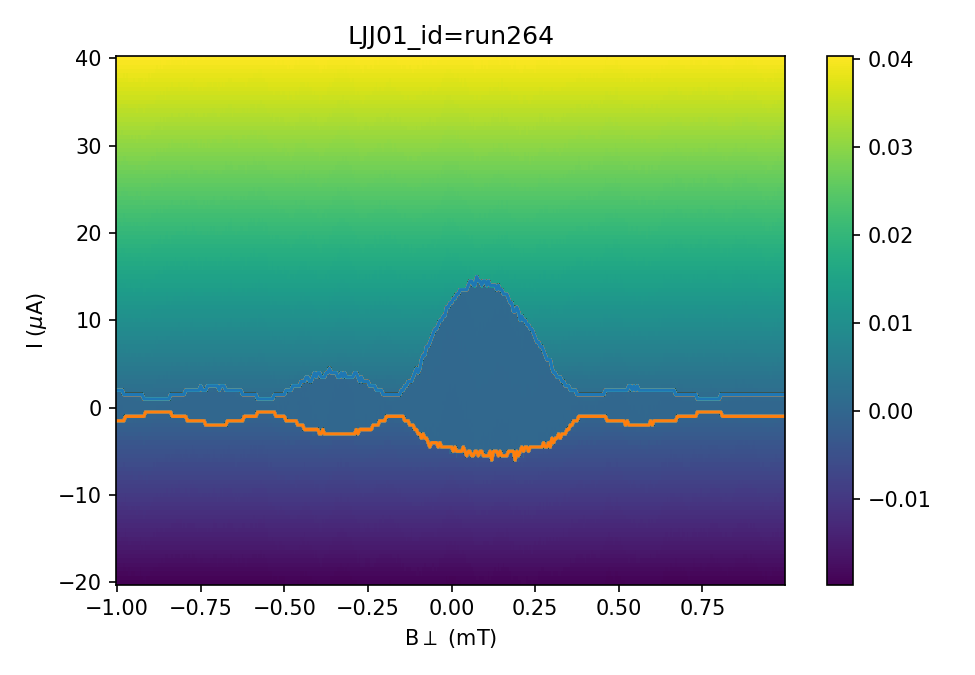

In [68]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_264[Arange:Brange,:]/1e-3, I_264[Arange:Brange,:]/1e-6, V_264[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run264')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_264[Arange:Brange,:]/1e-3,Is_264[Arange:Brange]/1e-6)
plt.plot(By_264[Arange:Brange,:]/1e-3,Ir_264[Arange:Brange]/1e-6)

np.savetxt('Is_264.csv', (Is_264), fmt='%s', delimiter=',')
np.savetxt('Ir_264.csv', (Ir_264), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 265 IV_By_210 degree_Bx=,Bz=

In [69]:
runid=265
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [70]:
By_265=By_field
I_265=I
V_265=V
R_265=R_DC1

np.savetxt('L01_265_By.csv', (By_265), fmt='%s', delimiter=',')
np.savetxt('L01_265_I.csv', (I_265), fmt='%s', delimiter=',')
np.savetxt('L01_265_V.csv', (V_265), fmt='%s', delimiter=',')
np.savetxt('L01_265_R.csv', (R_265), fmt='%s', delimiter=',')

In [74]:
By_265=np.loadtxt('L01_265_By.csv', delimiter=",")
I_265=np.loadtxt('L01_265_I.csv', delimiter=",")
V_265=np.loadtxt('L01_265_V.csv', delimiter=",")
R_265=np.loadtxt('L01_265_R.csv', delimiter=",")
Is_265=np.loadtxt('Is_265.csv', delimiter=",")
Ir_265=np.loadtxt('Ir_265.csv', delimiter=",")

<IPython.core.display.Javascript object>


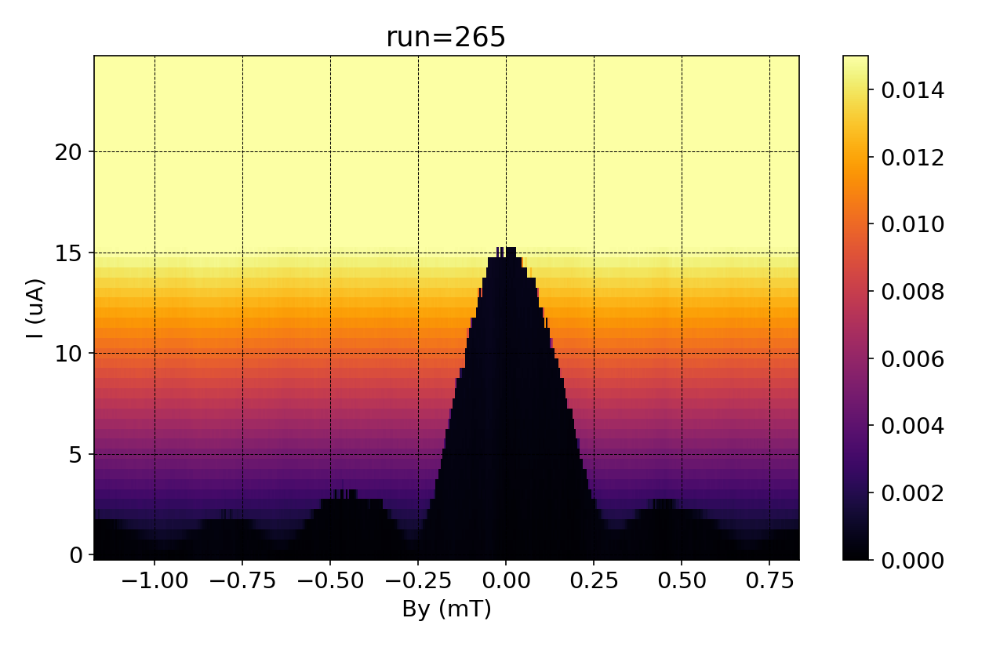

In [80]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)

Arange=40
Brange=90
# im = ax0.pcolormesh(By_265/1e-3, I_265/1e-6, V_265, cmap = 'viridis')#, vmin=0, vmax=200)
im = ax0.pcolormesh(By_265[:,Arange:Brange]/1e-3-0.169, I_265[:,Arange:Brange]/1e-6, V_265[:,Arange:Brange]/1e-3, cmap = 'inferno', vmax=0.015, vmin=0)

fig.colorbar(im, ax=ax0)
ax0.set_title('run=265')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
plt.show()

In [73]:
saiz=np.shape(V_265)
# print(saiz)
Is_265=np.zeros(saiz[0])
Ir_265=np.zeros(saiz[0])
fV_265=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_265)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_265[i,30:50])
        if V_265[i,j]-DCoff > 9.8e-7:
            Is_265[i]=I_265[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_265[i,30:50])
        if -V_265[i,j]-DCoff < 5e-7:
            Ir_265[i]=I_265[i,j]
            break

<IPython.core.display.Javascript object>


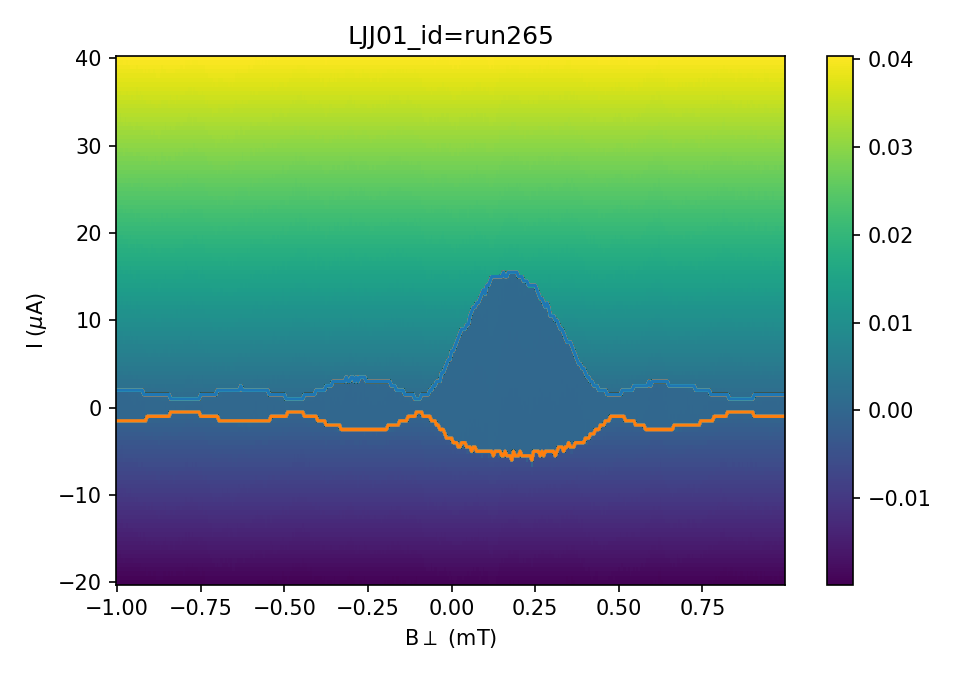

In [75]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_265[Arange:Brange,:]/1e-3, I_265[Arange:Brange,:]/1e-6, V_265[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run265')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_265[Arange:Brange,:]/1e-3,Is_265[Arange:Brange]/1e-6)
plt.plot(By_265[Arange:Brange,:]/1e-3,Ir_265[Arange:Brange]/1e-6)

np.savetxt('Is_265.csv', (Is_265), fmt='%s', delimiter=',')
np.savetxt('Ir_265.csv', (Ir_265), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 266 IV_By_240 degree_Bx=,Bz=

In [76]:
runid=266
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [77]:
By_266=By_field
I_266=I
V_266=V
R_266=R_DC1

np.savetxt('L01_266_By.csv', (By_266), fmt='%s', delimiter=',')
np.savetxt('L01_266_I.csv', (I_266), fmt='%s', delimiter=',')
np.savetxt('L01_266_V.csv', (V_266), fmt='%s', delimiter=',')
np.savetxt('L01_266_R.csv', (R_266), fmt='%s', delimiter=',')

In [78]:
By_266=np.loadtxt('L01_266_By.csv', delimiter=",")
I_266=np.loadtxt('L01_266_I.csv', delimiter=",")
V_266=np.loadtxt('L01_266_V.csv', delimiter=",")
R_266=np.loadtxt('L01_266_R.csv', delimiter=",")

C:\Users\chung\AppData\Local\Temp/ipykernel_10936/3782906948.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5))


<IPython.core.display.Javascript object>


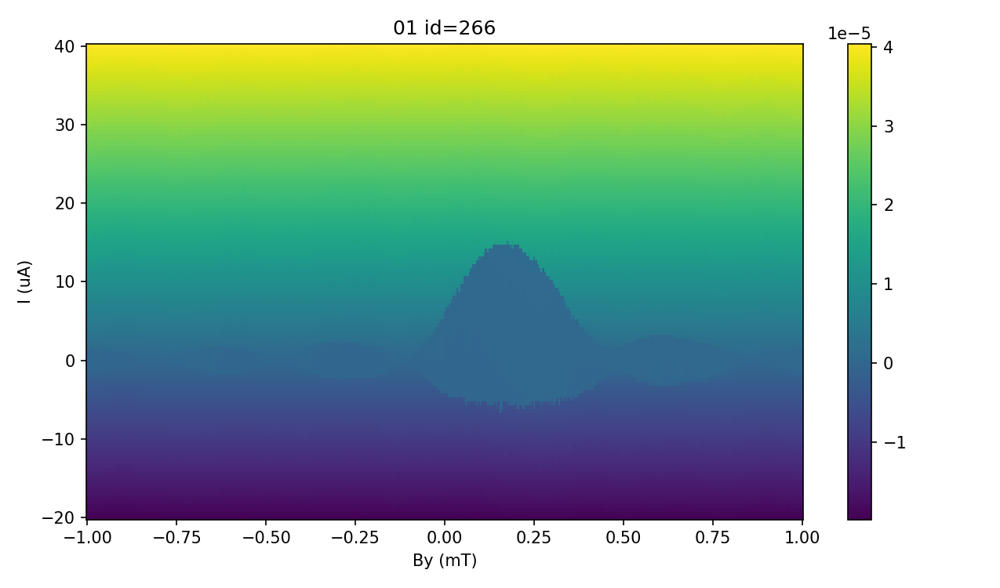

In [79]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)


im = ax0.pcolormesh(By_266/1e-3, I_266/1e-6, V_266, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax0)
ax0.set_title('01 id='+str(runid))
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [81]:
saiz=np.shape(V_266)
# print(saiz)
Is_266=np.zeros(saiz[0])
Ir_266=np.zeros(saiz[0])
fV_266=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_266)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_266[i,30:50])
        if V_266[i,j]-DCoff > 9.8e-7:
            Is_266[i]=I_266[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_266[i,30:50])
        if -V_266[i,j]-DCoff < 5e-7:
            Ir_266[i]=I_266[i,j]
            break

<IPython.core.display.Javascript object>


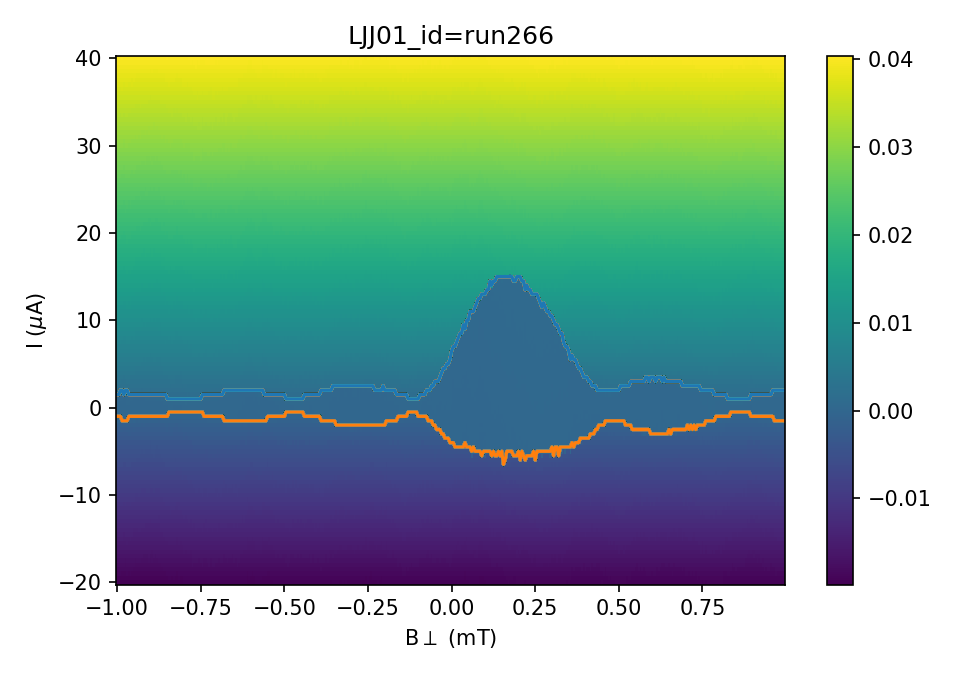

In [82]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_266[Arange:Brange,:]/1e-3, I_266[Arange:Brange,:]/1e-6, V_266[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run266')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_266[Arange:Brange,:]/1e-3,Is_266[Arange:Brange]/1e-6)
plt.plot(By_266[Arange:Brange,:]/1e-3,Ir_266[Arange:Brange]/1e-6)

np.savetxt('Is_266.csv', (Is_266), fmt='%s', delimiter=',')
np.savetxt('Ir_266.csv', (Ir_266), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 267 IV_By_270 degree_Bx=,Bz=

In [83]:
runid=267
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [84]:
By_267=By_field
I_267=I
V_267=V
R_267=R_DC1

np.savetxt('L01_267_By.csv', (By_267), fmt='%s', delimiter=',')
np.savetxt('L01_267_I.csv', (I_267), fmt='%s', delimiter=',')
np.savetxt('L01_267_V.csv', (V_267), fmt='%s', delimiter=',')
np.savetxt('L01_267_R.csv', (R_267), fmt='%s', delimiter=',')

In [85]:
By_267=np.loadtxt('L01_267_By.csv', delimiter=",")
I_267=np.loadtxt('L01_267_I.csv', delimiter=",")
V_267=np.loadtxt('L01_267_V.csv', delimiter=",")
R_267=np.loadtxt('L01_267_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


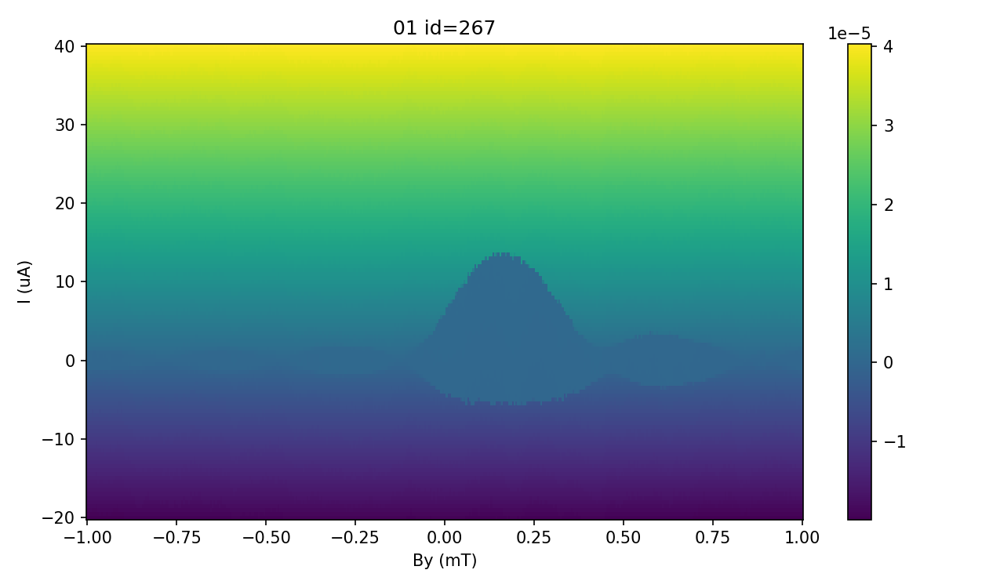

In [86]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)


im = ax0.pcolormesh(By_267/1e-3, I_267/1e-6, V_267, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax0)
ax0.set_title('01 id='+str(runid))
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [87]:
saiz=np.shape(V_267)
# print(saiz)
Is_267=np.zeros(saiz[0])
Ir_267=np.zeros(saiz[0])
fV_267=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_267)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_267[i,30:50])
        if V_267[i,j]-DCoff > 9.8e-7:
            Is_267[i]=I_267[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_267[i,30:50])
        if -V_267[i,j]-DCoff < 5e-7:
            Ir_267[i]=I_267[i,j]
            break

<IPython.core.display.Javascript object>


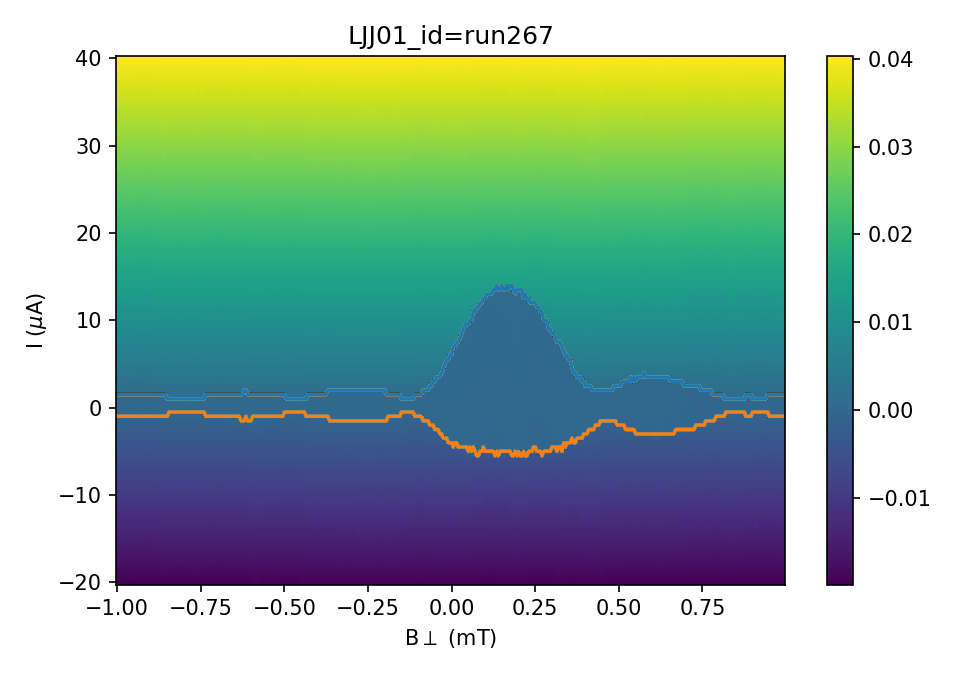

In [88]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_267[Arange:Brange,:]/1e-3, I_267[Arange:Brange,:]/1e-6, V_267[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run267')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_267[Arange:Brange,:]/1e-3,Is_267[Arange:Brange]/1e-6)
plt.plot(By_267[Arange:Brange,:]/1e-3,Ir_267[Arange:Brange]/1e-6)

np.savetxt('Is_267.csv', (Is_267), fmt='%s', delimiter=',')
np.savetxt('Ir_267.csv', (Ir_267), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 268 IV_By_300 degree_Bx=,Bz=

In [89]:
runid=268
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [90]:
By_268=By_field
I_268=I
V_268=V
R_268=R_DC1

np.savetxt('L01_268_By.csv', (By_268), fmt='%s', delimiter=',')
np.savetxt('L01_268_I.csv', (I_268), fmt='%s', delimiter=',')
np.savetxt('L01_268_V.csv', (V_268), fmt='%s', delimiter=',')
np.savetxt('L01_268_R.csv', (R_268), fmt='%s', delimiter=',')

In [81]:
By_268=np.loadtxt('L01_268_By.csv', delimiter=",")
I_268=np.loadtxt('L01_268_I.csv', delimiter=",")
V_268=np.loadtxt('L01_268_V.csv', delimiter=",")
R_268=np.loadtxt('L01_268_R.csv', delimiter=",")
Is_268=np.loadtxt('Is_268.csv', delimiter=",")
Ir_268=np.loadtxt('Ir_268.csv', delimiter=",")

<IPython.core.display.Javascript object>


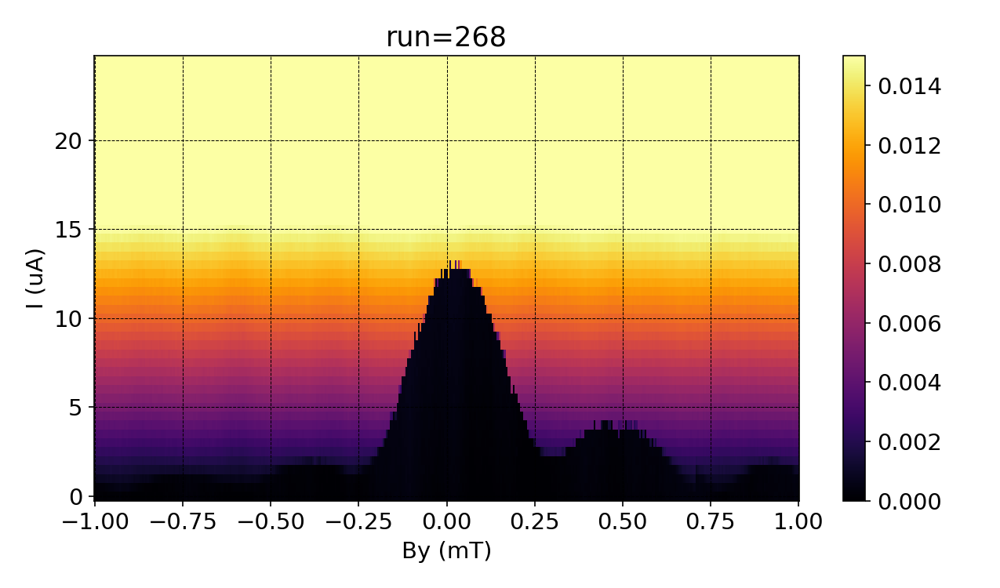

In [83]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)

Arange=40
Brange=90

# im = ax0.pcolormesh(By_268/1e-3, I_268/1e-6, V_268, cmap = 'viridis')#, vmin=0, vmax=200)
im = ax0.pcolormesh(By_268[:,Arange:Brange]/1e-3, I_268[:,Arange:Brange]/1e-6, V_268[:,Arange:Brange]/1e-3, cmap = 'inferno', vmax=0.015, vmin=0)

fig.colorbar(im, ax=ax0)
ax0.set_title('run=268')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
plt.grid(color = 'black', linestyle = '--', linewidth = 0.5)
plt.show()

In [93]:
saiz=np.shape(V_268)
# print(saiz)
Is_268=np.zeros(saiz[0])
Ir_268=np.zeros(saiz[0])
fV_268=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_268)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_268[i,30:50])
        if V_268[i,j]-DCoff > 9.8e-7:
            Is_268[i]=I_268[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_268[i,30:50])
        if -V_268[i,j]-DCoff < 5e-7:
            Ir_268[i]=I_268[i,j]
            break

<IPython.core.display.Javascript object>


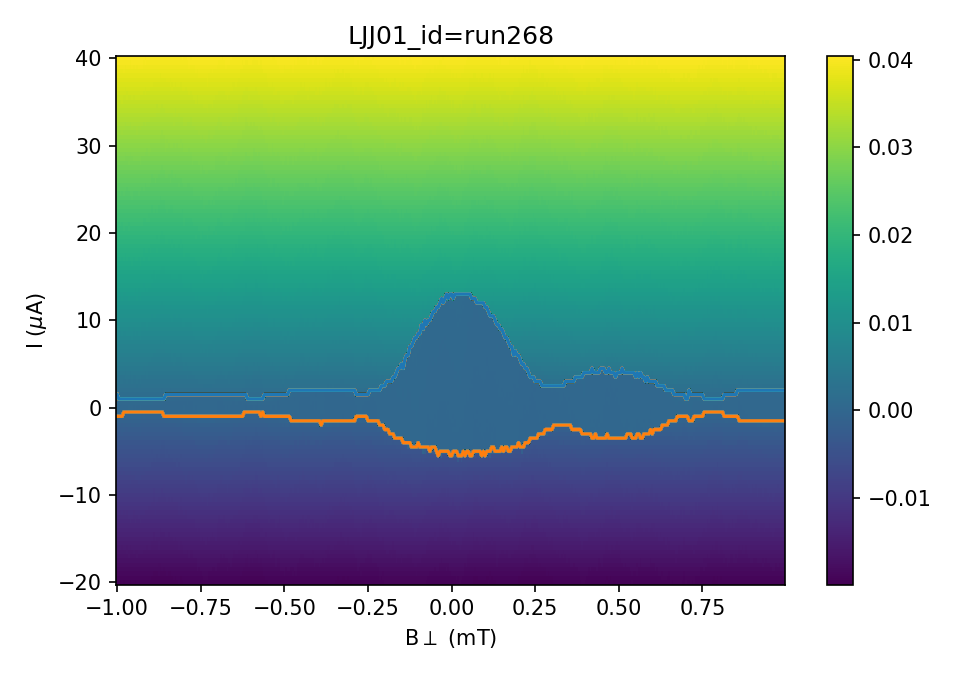

In [94]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_268[Arange:Brange,:]/1e-3, I_268[Arange:Brange,:]/1e-6, V_268[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run268')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_268[Arange:Brange,:]/1e-3,Is_268[Arange:Brange]/1e-6)
plt.plot(By_268[Arange:Brange,:]/1e-3,Ir_268[Arange:Brange]/1e-6)

np.savetxt('Is_268.csv', (Is_268), fmt='%s', delimiter=',')
np.savetxt('Ir_268.csv', (Ir_268), fmt='%s', delimiter=',')


fig.tight_layout()
#plt.grid()
plt.show()

## Run 269 IV_By_330 degree_Bx=,Bz=

In [95]:
runid=269
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [96]:
By_269=By_field
I_269=I
V_269=V
R_269=R_DC1

np.savetxt('L01_269_By.csv', (By_269), fmt='%s', delimiter=',')
np.savetxt('L01_269_I.csv', (I_269), fmt='%s', delimiter=',')
np.savetxt('L01_269_V.csv', (V_269), fmt='%s', delimiter=',')
np.savetxt('L01_269_R.csv', (R_269), fmt='%s', delimiter=',')

In [97]:
By_269=np.loadtxt('L01_269_By.csv', delimiter=",")
I_269=np.loadtxt('L01_269_I.csv', delimiter=",")
V_269=np.loadtxt('L01_269_V.csv', delimiter=",")
R_269=np.loadtxt('L01_269_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


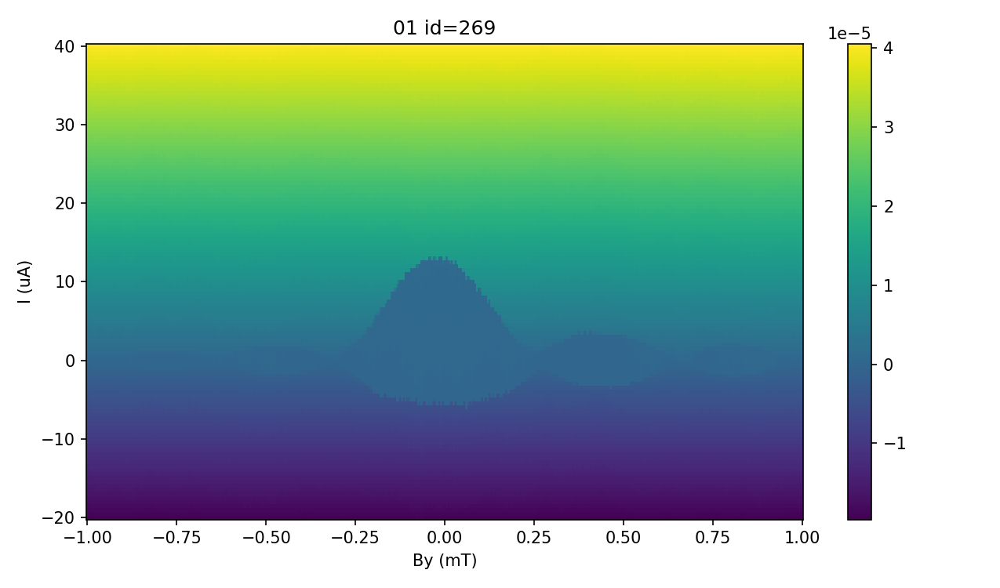

In [98]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)


im = ax0.pcolormesh(By_269/1e-3, I_269/1e-6, V_269, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax0)
ax0.set_title('01 id='+str(runid))
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [99]:
saiz=np.shape(V_269)
# print(saiz)
Is_269=np.zeros(saiz[0])
Ir_269=np.zeros(saiz[0])
fV_269=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_269)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_269[i,30:50])
        if V_269[i,j]-DCoff > 9.8e-7:
            Is_269[i]=I_269[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_269[i,30:50])
        if -V_269[i,j]-DCoff < 5e-7:
            Ir_269[i]=I_269[i,j]
            break

<IPython.core.display.Javascript object>


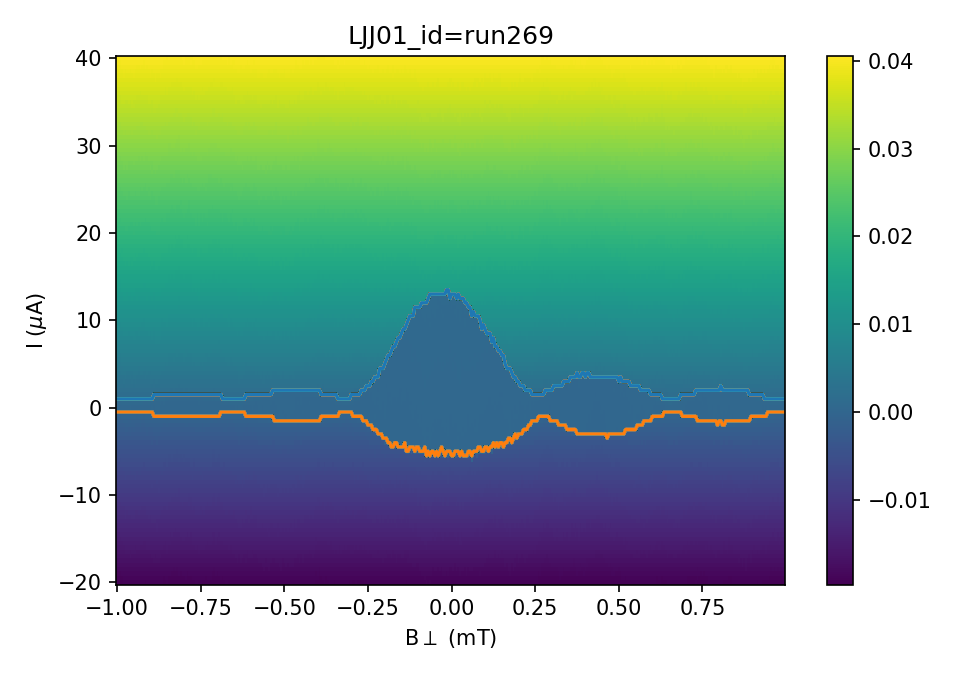

In [100]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_269[Arange:Brange,:]/1e-3, I_269[Arange:Brange,:]/1e-6, V_269[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run269')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_269[Arange:Brange,:]/1e-3,Is_269[Arange:Brange]/1e-6)
plt.plot(By_269[Arange:Brange,:]/1e-3,Ir_269[Arange:Brange]/1e-6)

np.savetxt('Is_269.csv', (Is_269), fmt='%s', delimiter=',')
np.savetxt('Ir_269.csv', (Ir_269), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 270 IV_By_360 degree_Bx=,Bz=

In [101]:
runid=270
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [102]:
By_270=By_field
I_270=I
V_270=V
R_270=R_DC1

np.savetxt('L01_270_By.csv', (By_270), fmt='%s', delimiter=',')
np.savetxt('L01_270_I.csv', (I_270), fmt='%s', delimiter=',')
np.savetxt('L01_270_V.csv', (V_270), fmt='%s', delimiter=',')
np.savetxt('L01_270_R.csv', (R_270), fmt='%s', delimiter=',')

In [103]:
By_270=np.loadtxt('L01_270_By.csv', delimiter=",")
I_270=np.loadtxt('L01_270_I.csv', delimiter=",")
V_270=np.loadtxt('L01_270_V.csv', delimiter=",")
R_270=np.loadtxt('L01_270_R.csv', delimiter=",")

<IPython.core.display.Javascript object>


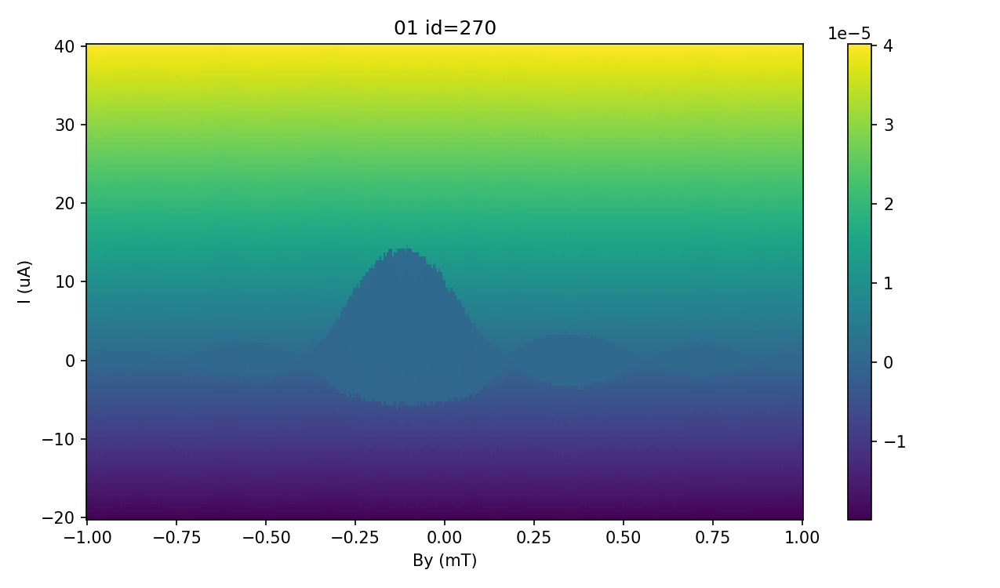

In [104]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)


im = ax0.pcolormesh(By_270/1e-3, I_270/1e-6, V_270, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax0)
ax0.set_title('01 id='+str(runid))
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [105]:
saiz=np.shape(V_270)
# print(saiz)
Is_270=np.zeros(saiz[0])
Ir_270=np.zeros(saiz[0])
fV_270=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_270)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_270[i,30:50])
        if V_270[i,j]-DCoff > 9.8e-7:
            Is_270[i]=I_270[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_270[i,30:50])
        if -V_270[i,j]-DCoff < 5e-7:
            Ir_270[i]=I_270[i,j]
            break

<IPython.core.display.Javascript object>


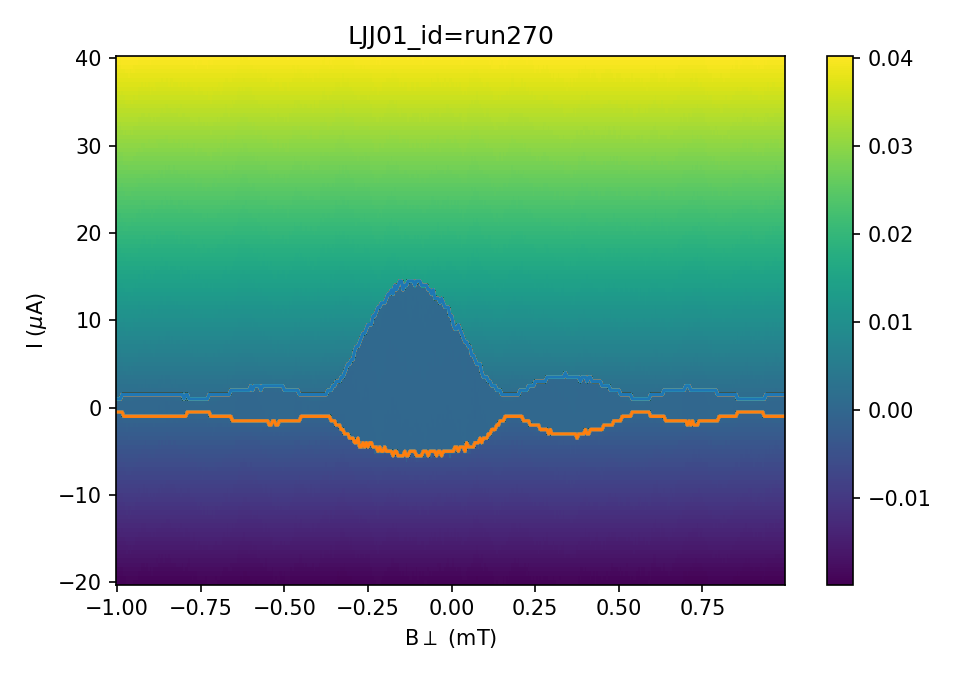

In [106]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400
im = ax0.pcolormesh(By_270[Arange:Brange,:]/1e-3, I_270[Arange:Brange,:]/1e-6, V_270[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ01_id=run270')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_270[Arange:Brange,:]/1e-3,Is_270[Arange:Brange]/1e-6)
plt.plot(By_270[Arange:Brange,:]/1e-3,Ir_270[Arange:Brange]/1e-6)

np.savetxt('Is_270.csv', (Is_270), fmt='%s', delimiter=',')
np.savetxt('Ir_270.csv', (Ir_270), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

## Run 258-270

In [5]:
By_258=np.loadtxt('L01_258_By.csv', delimiter=",")
I_258=np.loadtxt('L01_258_I.csv', delimiter=",")
V_258=np.loadtxt('L01_258_V.csv', delimiter=",")
R_258=np.loadtxt('L01_258_R.csv', delimiter=",")
Is_258=np.loadtxt('Is_258.csv', delimiter=",")
Ir_258=np.loadtxt('Ir_258.csv', delimiter=",")

By_259=np.loadtxt('L01_259_By.csv', delimiter=",")
I_259=np.loadtxt('L01_259_I.csv', delimiter=",")
V_259=np.loadtxt('L01_259_V.csv', delimiter=",")
R_259=np.loadtxt('L01_259_R.csv', delimiter=",")
Is_259=np.loadtxt('Is_259.csv', delimiter=",")
Ir_259=np.loadtxt('Ir_259.csv', delimiter=",")

By_260=np.loadtxt('L01_260_By.csv', delimiter=",")
I_260=np.loadtxt('L01_260_I.csv', delimiter=",")
V_260=np.loadtxt('L01_260_V.csv', delimiter=",")
R_260=np.loadtxt('L01_260_R.csv', delimiter=",")
Is_260=np.loadtxt('Is_260.csv', delimiter=",")
Ir_260=np.loadtxt('Ir_260.csv', delimiter=",")

By_261=np.loadtxt('L01_261_By.csv', delimiter=",")
I_261=np.loadtxt('L01_261_I.csv', delimiter=",")
V_261=np.loadtxt('L01_261_V.csv', delimiter=",")
R_261=np.loadtxt('L01_261_R.csv', delimiter=",")
Is_261=np.loadtxt('Is_261.csv', delimiter=",")
Ir_261=np.loadtxt('Ir_261.csv', delimiter=",")

By_262=np.loadtxt('L01_262_By.csv', delimiter=",")
I_262=np.loadtxt('L01_262_I.csv', delimiter=",")
V_262=np.loadtxt('L01_262_V.csv', delimiter=",")
R_262=np.loadtxt('L01_262_R.csv', delimiter=",")
Is_262=np.loadtxt('Is_262.csv', delimiter=",")
Ir_262=np.loadtxt('Ir_262.csv', delimiter=",")

By_263=np.loadtxt('L01_263_By.csv', delimiter=",")
I_263=np.loadtxt('L01_263_I.csv', delimiter=",")
V_263=np.loadtxt('L01_263_V.csv', delimiter=",")
R_263=np.loadtxt('L01_263_R.csv', delimiter=",")
Is_263=np.loadtxt('Is_263.csv', delimiter=",")
Ir_263=np.loadtxt('Ir_263.csv', delimiter=",")

By_264=np.loadtxt('L01_264_By.csv', delimiter=",")
I_264=np.loadtxt('L01_264_I.csv', delimiter=",")
v_264=np.loadtxt('L01_264_V.csv', delimiter=",")
R_264=np.loadtxt('L01_264_R.csv', delimiter=",")
Is_264=np.loadtxt('Is_264.csv', delimiter=",")
Ir_264=np.loadtxt('Ir_264.csv', delimiter=",")

By_265=np.loadtxt('L01_265_By.csv', delimiter=",")
I_265=np.loadtxt('L01_265_I.csv', delimiter=",")
V_265=np.loadtxt('L01_265_V.csv', delimiter=",")
R_265=np.loadtxt('L01_265_R.csv', delimiter=",")
Is_265=np.loadtxt('Is_265.csv', delimiter=",")
Ir_265=np.loadtxt('Ir_265.csv', delimiter=",")

By_266=np.loadtxt('L01_266_By.csv', delimiter=",")
I_266=np.loadtxt('L01_266_I.csv', delimiter=",")
V_266=np.loadtxt('L01_266_V.csv', delimiter=",")
R_266=np.loadtxt('L01_266_R.csv', delimiter=",")
Is_266=np.loadtxt('Is_266.csv', delimiter=",")
Ir_266=np.loadtxt('Ir_266.csv', delimiter=",")

By_267=np.loadtxt('L01_267_By.csv', delimiter=",")
I_267=np.loadtxt('L01_267_I.csv', delimiter=",")
V_267=np.loadtxt('L01_267_V.csv', delimiter=",")
R_267=np.loadtxt('L01_267_R.csv', delimiter=",")
Is_267=np.loadtxt('Is_267.csv', delimiter=",")
Ir_267=np.loadtxt('Ir_267.csv', delimiter=",")

By_268=np.loadtxt('L01_268_By.csv', delimiter=",")
I_268=np.loadtxt('L01_268_I.csv', delimiter=",")
V_268=np.loadtxt('L01_268_V.csv', delimiter=",")
R_268=np.loadtxt('L01_268_R.csv', delimiter=",")
Is_268=np.loadtxt('Is_268.csv', delimiter=",")
Ir_268=np.loadtxt('Ir_268.csv', delimiter=",")

By_269=np.loadtxt('L01_269_By.csv', delimiter=",")
I_269=np.loadtxt('L01_269_I.csv', delimiter=",")
V_269=np.loadtxt('L01_269_V.csv', delimiter=",")
R_269=np.loadtxt('L01_269_R.csv', delimiter=",")
Is_269=np.loadtxt('Is_269.csv', delimiter=",")
Ir_269=np.loadtxt('Ir_269.csv', delimiter=",")

By_270=np.loadtxt('L01_270_By.csv', delimiter=",")
I_270=np.loadtxt('L01_270_I.csv', delimiter=",")
V_270=np.loadtxt('L01_270_V.csv', delimiter=",")
R_270=np.loadtxt('L01_270_R.csv', delimiter=",")
Is_270=np.loadtxt('Is_270.csv', delimiter=",")
Ir_270=np.loadtxt('Ir_270.csv', delimiter=",")

<IPython.core.display.Javascript object>


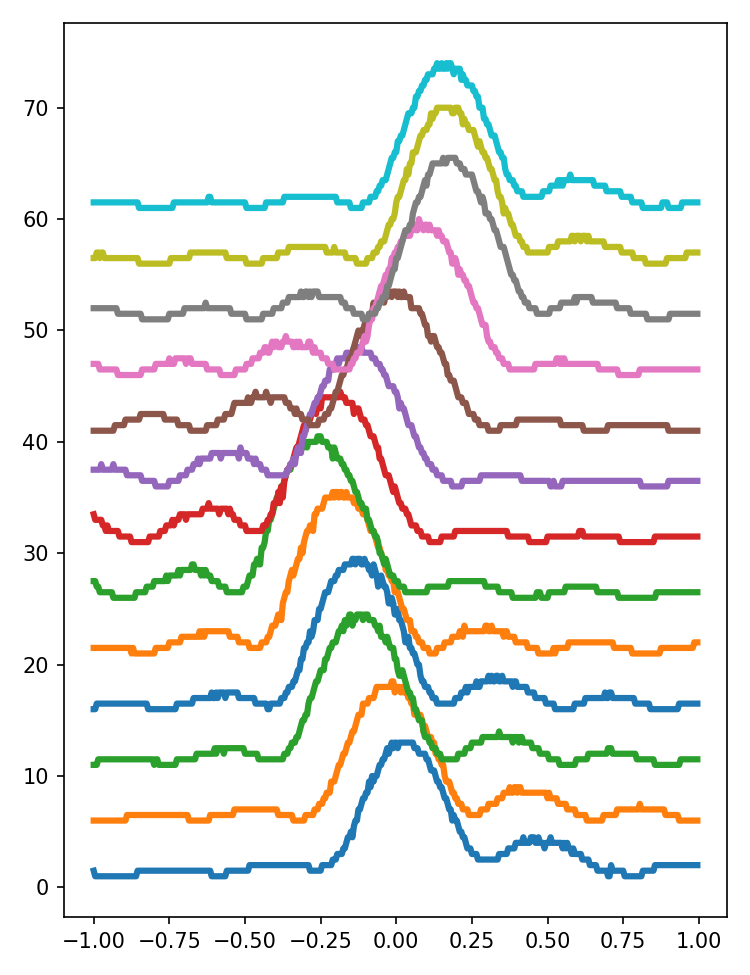

In [30]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(5,6.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')
Arange=0
Brange=400

plt.plot(By_258[Arange:Brange,1]/1e-3,Is_258[Arange:Brange]/1e-6+15, linewidth='3')
plt.plot(By_259[Arange:Brange,1]/1e-3,Is_259[Arange:Brange]/1e-6+20, linewidth='3')
plt.plot(By_260[Arange:Brange,1]/1e-3,Is_260[Arange:Brange]/1e-6+25, linewidth='3')
plt.plot(By_261[Arange:Brange,1]/1e-3,Is_261[Arange:Brange]/1e-6+30, linewidth='3')
plt.plot(By_262[Arange:Brange,1]/1e-3,Is_262[Arange:Brange]/1e-6+35, linewidth='3')
plt.plot(By_263[Arange:Brange,1]/1e-3,Is_263[Arange:Brange]/1e-6+40, linewidth='3')
plt.plot(By_264[Arange:Brange,1]/1e-3,Is_264[Arange:Brange]/1e-6+45, linewidth='3')
plt.plot(By_265[Arange:Brange,1]/1e-3,Is_265[Arange:Brange]/1e-6+50, linewidth='3')
plt.plot(By_266[Arange:Brange,1]/1e-3,Is_266[Arange:Brange]/1e-6+55, linewidth='3')
plt.plot(By_267[Arange:Brange,1]/1e-3,Is_267[Arange:Brange]/1e-6+60, linewidth='3')
plt.plot(By_268[Arange:Brange,1]/1e-3,Is_268[Arange:Brange]/1e-6+0, linewidth='3')
plt.plot(By_269[Arange:Brange,1]/1e-3,Is_269[Arange:Brange]/1e-6+5, linewidth='3')
plt.plot(By_270[Arange:Brange,1]/1e-3,Is_270[Arange:Brange]/1e-6+10, linewidth='3')


fig.tight_layout()
#plt.grid()
plt.show()

In [7]:
## use local max 
import operator
max_idx_258, max_val_258 = max(enumerate(Is_258), key=operator.itemgetter(1))
max_idx_259, max_val_259 = max(enumerate(Is_259), key=operator.itemgetter(1))
max_idx_260, max_val_260 = max(enumerate(Is_260), key=operator.itemgetter(1))
max_idx_261, max_val_261 = max(enumerate(Is_261), key=operator.itemgetter(1))
max_idx_262, max_val_262 = max(enumerate(Is_262), key=operator.itemgetter(1))
max_idx_263, max_val_263 = max(enumerate(Is_263), key=operator.itemgetter(1))
max_idx_264, max_val_264 = max(enumerate(Is_264), key=operator.itemgetter(1))
max_idx_265, max_val_265 = max(enumerate(Is_265), key=operator.itemgetter(1))
max_idx_266, max_val_266 = max(enumerate(Is_266), key=operator.itemgetter(1))
max_idx_267, max_val_267 = max(enumerate(Is_267), key=operator.itemgetter(1))
max_idx_268, max_val_268 = max(enumerate(Is_268), key=operator.itemgetter(1))
max_idx_269, max_val_269 = max(enumerate(Is_269), key=operator.itemgetter(1))
max_idx_270, max_val_270 = max(enumerate(Is_270), key=operator.itemgetter(1))

# print (max_idx, max_val)

### fit peak around the max

In [8]:
def Gauss(x,a,x0,sigma):
    return a*np.exp(-(x-x0)**2/(2*sigma**2)) 

<IPython.core.display.Javascript object>


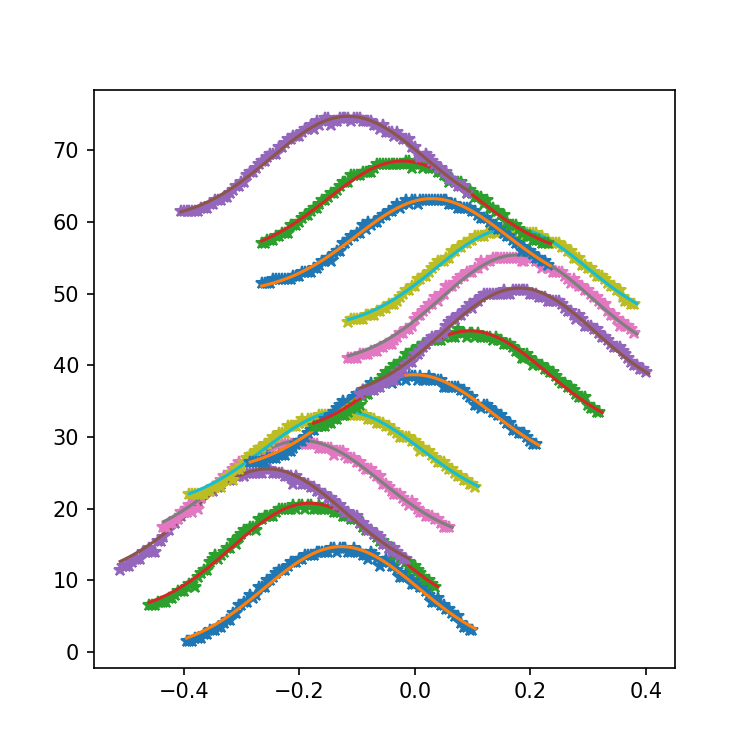

53 55 51


In [9]:
## test fit 
fig, (ax0) = plt.subplots(ncols=1, figsize=(5,5))
popt_258, pcov_258 = curve_fit(Gauss, By_258[max_idx_258-50:max_idx_258+50,1]/1e-3,Is_258[max_idx_258-50:max_idx_258+50]/1e-6)
popt_259, pcov_259 = curve_fit(Gauss, By_259[max_idx_259-50:max_idx_259+50,1]/1e-3,Is_259[max_idx_259-50:max_idx_259+50]/1e-6)
popt_260, pcov_260 = curve_fit(Gauss, By_260[max_idx_260-50:max_idx_260+50,1]/1e-3,Is_260[max_idx_260-50:max_idx_260+50]/1e-6)
popt_261, pcov_261 = curve_fit(Gauss, By_261[max_idx_261-50:max_idx_261+50,1]/1e-3,Is_261[max_idx_261-50:max_idx_261+50]/1e-6)
popt_262, pcov_262 = curve_fit(Gauss, By_262[max_idx_262-50:max_idx_262+50,1]/1e-3,Is_262[max_idx_262-50:max_idx_262+50]/1e-6)
popt_263, pcov_263 = curve_fit(Gauss, By_263[max_idx_263-50:max_idx_263+50,1]/1e-3,Is_263[max_idx_263-50:max_idx_263+50]/1e-6)
popt_264, pcov_264 = curve_fit(Gauss, By_264[max_idx_264-50:max_idx_264+50,1]/1e-3,Is_264[max_idx_264-50:max_idx_264+50]/1e-6)
popt_265, pcov_265 = curve_fit(Gauss, By_265[max_idx_265-50:max_idx_265+50,1]/1e-3,Is_265[max_idx_265-50:max_idx_265+50]/1e-6)
popt_266, pcov_266 = curve_fit(Gauss, By_266[max_idx_266-50:max_idx_266+50,1]/1e-3,Is_266[max_idx_266-50:max_idx_266+50]/1e-6)
popt_267, pcov_267 = curve_fit(Gauss, By_267[max_idx_267-50:max_idx_267+50,1]/1e-3,Is_267[max_idx_267-50:max_idx_267+50]/1e-6)
popt_268, pcov_268 = curve_fit(Gauss, By_268[max_idx_268-50:max_idx_268+50,1]/1e-3,Is_268[max_idx_268-50:max_idx_268+50]/1e-6)
popt_269, pcov_269 = curve_fit(Gauss, By_269[max_idx_269-50:max_idx_269+50,1]/1e-3,Is_269[max_idx_269-50:max_idx_269+50]/1e-6)
popt_270, pcov_270 = curve_fit(Gauss, By_270[max_idx_270-50:max_idx_270+50,1]/1e-3,Is_270[max_idx_270-50:max_idx_270+50]/1e-6)


plt.plot(By_258[max_idx_258-50:max_idx_258+50,1]/1e-3,Is_258[max_idx_258-50:max_idx_258+50]/1e-6,"*")
x_curve_258 = np.linspace(By_258[max_idx_258-50,1]/1e-3,By_258[max_idx_258+50,1]/1e-3, 100)
plt.plot(x_curve_258, Gauss(x_curve_258, *popt_258))

plt.plot(By_259[max_idx_259-50:max_idx_259+50,1]/1e-3,Is_259[max_idx_259-50:max_idx_259+50]/1e-6+5,"*")
x_curve_259 = np.linspace(By_259[max_idx_259-50,1]/1e-3,By_259[max_idx_259+50,1]/1e-3, 100)
plt.plot(x_curve_259, Gauss(x_curve_259, *popt_259)+5)

plt.plot(By_260[max_idx_260-50:max_idx_260+50,1]/1e-3,Is_260[max_idx_260-50:max_idx_260+50]/1e-6+10,"*")
x_curve_260 = np.linspace(By_260[max_idx_260-50,1]/1e-3,By_260[max_idx_260+50,1]/1e-3, 100)
plt.plot(x_curve_260, Gauss(x_curve_260, *popt_260)+10)

plt.plot(By_261[max_idx_261-50:max_idx_261+50,1]/1e-3,Is_261[max_idx_261-50:max_idx_261+50]/1e-6+15,"*")
x_curve_261 = np.linspace(By_261[max_idx_261-50,1]/1e-3,By_261[max_idx_261+50,1]/1e-3, 100)
plt.plot(x_curve_261, Gauss(x_curve_261, *popt_261)+15)

plt.plot(By_262[max_idx_262-50:max_idx_262+50,1]/1e-3,Is_262[max_idx_262-50:max_idx_262+50]/1e-6+20,"*")
x_curve_262 = np.linspace(By_262[max_idx_262-50,1]/1e-3,By_262[max_idx_262+50,1]/1e-3, 100)
plt.plot(x_curve_262, Gauss(x_curve_262, *popt_262)+20)

plt.plot(By_263[max_idx_263-50:max_idx_263+50,1]/1e-3,Is_263[max_idx_263-50:max_idx_263+50]/1e-6+25,"*")
x_curve_263 = np.linspace(By_263[max_idx_263-50,1]/1e-3,By_263[max_idx_263+50,1]/1e-3, 100)
plt.plot(x_curve_263, Gauss(x_curve_263, *popt_263)+25)

plt.plot(By_264[max_idx_264-50:max_idx_264+50,1]/1e-3,Is_264[max_idx_264-50:max_idx_264+50]/1e-6+30,"*")
x_curve_264 = np.linspace(By_264[max_idx_264-50,1]/1e-3,By_264[max_idx_264+50,1]/1e-3, 100)
plt.plot(x_curve_264, Gauss(x_curve_264, *popt_264)+30)

plt.plot(By_265[max_idx_265-50:max_idx_265+50,1]/1e-3,Is_265[max_idx_265-50:max_idx_265+50]/1e-6+35,"*")
x_curve_265 = np.linspace(By_265[max_idx_265-50,1]/1e-3,By_265[max_idx_265+50,1]/1e-3, 100)
plt.plot(x_curve_265, Gauss(x_curve_265, *popt_265)+35)

plt.plot(By_266[max_idx_266-50:max_idx_266+50,1]/1e-3,Is_266[max_idx_266-50:max_idx_266+50]/1e-6+40,"*")
x_curve_266 = np.linspace(By_266[max_idx_266-50,1]/1e-3,By_266[max_idx_266+50,1]/1e-3, 100)
plt.plot(x_curve_266, Gauss(x_curve_266, *popt_266)+40)

plt.plot(By_267[max_idx_267-50:max_idx_267+50,1]/1e-3,Is_267[max_idx_267-50:max_idx_267+50]/1e-6+45,"*")
x_curve_267 = np.linspace(By_267[max_idx_267-50,1]/1e-3,By_267[max_idx_267+50,1]/1e-3, 100)
plt.plot(x_curve_267, Gauss(x_curve_267, *popt_267)+45)

plt.plot(By_268[max_idx_268-50:max_idx_268+50,1]/1e-3,Is_268[max_idx_268-50:max_idx_268+50]/1e-6+50,"*")
x_curve_268 = np.linspace(By_268[max_idx_268-50,1]/1e-3,By_268[max_idx_268+50,1]/1e-3, 100)
plt.plot(x_curve_268, Gauss(x_curve_268, *popt_268)+50)

plt.plot(By_269[max_idx_269-50:max_idx_269+50,1]/1e-3,Is_269[max_idx_269-50:max_idx_269+50]/1e-6+55,"*")
x_curve_269 = np.linspace(By_269[max_idx_269-50,1]/1e-3,By_269[max_idx_269+50,1]/1e-3, 100)
plt.plot(x_curve_269, Gauss(x_curve_269, *popt_269)+55)

plt.plot(By_270[max_idx_270-50:max_idx_270+50,1]/1e-3,Is_270[max_idx_270-50:max_idx_270+50]/1e-6+60,"*")
x_curve_270 = np.linspace(By_270[max_idx_270-50,1]/1e-3,By_270[max_idx_270+50,1]/1e-3, 100)
plt.plot(x_curve_270, Gauss(x_curve_270, *popt_270)+60)

# max_idx_258g, max_val_258g = max(enumerate(Gauss(x_curve_258, *popt_258)), key=operator.itemgetter(1))
max_idx_258g, max_val_258g = max(enumerate(Gauss(x_curve_258, *popt_258)), key=operator.itemgetter(1))
max_idx_259g, max_val_259g = max(enumerate(Gauss(x_curve_259, *popt_259)), key=operator.itemgetter(1))
max_idx_260g, max_val_260g = max(enumerate(Gauss(x_curve_260, *popt_260)), key=operator.itemgetter(1))
max_idx_261g, max_val_261g = max(enumerate(Gauss(x_curve_261, *popt_261)), key=operator.itemgetter(1))
max_idx_262g, max_val_262g = max(enumerate(Gauss(x_curve_262, *popt_262)), key=operator.itemgetter(1))
max_idx_263g, max_val_263g = max(enumerate(Gauss(x_curve_263, *popt_263)), key=operator.itemgetter(1))
max_idx_264g, max_val_264g = max(enumerate(Gauss(x_curve_264, *popt_264)), key=operator.itemgetter(1))
max_idx_265g, max_val_265g = max(enumerate(Gauss(x_curve_265, *popt_265)), key=operator.itemgetter(1))
max_idx_266g, max_val_266g = max(enumerate(Gauss(x_curve_266, *popt_266)), key=operator.itemgetter(1))
max_idx_267g, max_val_267g = max(enumerate(Gauss(x_curve_267, *popt_267)), key=operator.itemgetter(1))
max_idx_268g, max_val_268g = max(enumerate(Gauss(x_curve_268, *popt_268)), key=operator.itemgetter(1))
max_idx_269g, max_val_269g = max(enumerate(Gauss(x_curve_269, *popt_269)), key=operator.itemgetter(1))
max_idx_270g, max_val_270g = max(enumerate(Gauss(x_curve_270, *popt_270)), key=operator.itemgetter(1))
# print(max_idx_258g, max_val_258g)
print(max_idx_258g, max_idx_259g, max_idx_260g)
plt.show()

In [14]:
print(max_idx_258, max_idx_258g)

171 53


In [10]:
max_idx_258g2=max_idx_258g-50+max_idx_258
max_idx_259g2=max_idx_259g-50+max_idx_259
max_idx_260g2=max_idx_260g-50+max_idx_260
max_idx_261g2=max_idx_261g-50+max_idx_261
max_idx_262g2=max_idx_262g-50+max_idx_262
max_idx_263g2=max_idx_263g-50+max_idx_263
max_idx_264g2=max_idx_264g-50+max_idx_264
max_idx_265g2=max_idx_265g-50+max_idx_265
max_idx_266g2=max_idx_266g-50+max_idx_266
max_idx_267g2=max_idx_267g-50+max_idx_267
max_idx_268g2=max_idx_268g-50+max_idx_268
max_idx_269g2=max_idx_269g-50+max_idx_269
max_idx_270g2=max_idx_270g-50+max_idx_270
print(max_idx_258g2)

174


#### coordinate correction 

<IPython.core.display.Javascript object>


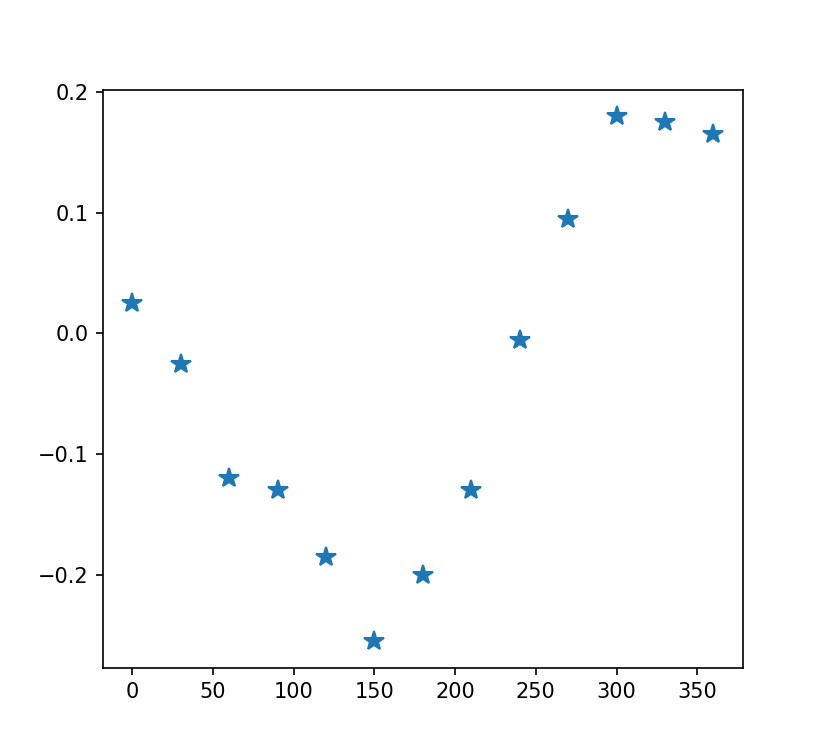

In [27]:
ro_ang=np.linspace(0,360,13)
JJ1_Boff=np.zeros(13)
JJ1_Boff[3]=By_258[max_idx_258g2,1]
JJ1_Boff[4]=By_259[max_idx_259g2,1]
JJ1_Boff[5]=By_260[max_idx_260g2,1]
JJ1_Boff[6]=By_261[max_idx_261g2,1]
JJ1_Boff[7]=By_262[max_idx_262g2,1]
JJ1_Boff[8]=By_263[max_idx_263g2,1]
JJ1_Boff[9]=By_264[max_idx_264g2,1]
JJ1_Boff[10]=By_265[max_idx_265g2,1]
JJ1_Boff[11]=By_266[max_idx_266g2,1]
JJ1_Boff[12]=By_267[max_idx_267g2,1]
JJ1_Boff[0]=By_268[max_idx_268g2,1]
JJ1_Boff[1]=By_269[max_idx_269g2,1]
JJ1_Boff[2]=By_270[max_idx_270g2,1]

fig, (ax0) = plt.subplots(ncols=1, figsize=(5.5,5))
plt.plot(ro_ang, JJ1_Boff/1e-3, '*', markersize=10)

#### After correction

<IPython.core.display.Javascript object>


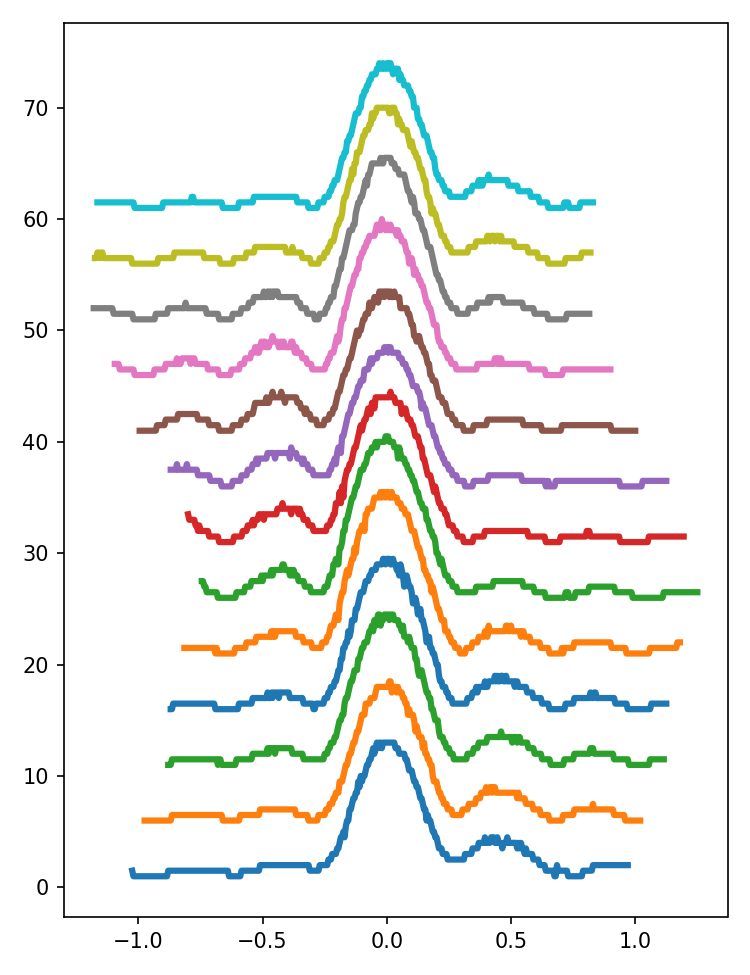

In [31]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(5,6.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')
Arange=0
Brange=400

plt.plot((By_258[Arange:Brange,1]-By_258[max_idx_258g2,1])/1e-3,Is_258[Arange:Brange]/1e-6+15, linewidth='3')
plt.plot((By_259[Arange:Brange,1]-By_259[max_idx_259g2,1])/1e-3,Is_259[Arange:Brange]/1e-6+20, linewidth='3')
plt.plot((By_260[Arange:Brange,1]-By_260[max_idx_260g2,1])/1e-3,Is_260[Arange:Brange]/1e-6+25, linewidth='3')
plt.plot((By_261[Arange:Brange,1]-By_261[max_idx_261g2,1])/1e-3,Is_261[Arange:Brange]/1e-6+30, linewidth='3')
plt.plot((By_262[Arange:Brange,1]-By_262[max_idx_262g2,1])/1e-3,Is_262[Arange:Brange]/1e-6+35, linewidth='3')
plt.plot((By_263[Arange:Brange,1]-By_263[max_idx_263g2,1])/1e-3,Is_263[Arange:Brange]/1e-6+40, linewidth='3')
plt.plot((By_264[Arange:Brange,1]-By_264[max_idx_264g2,1])/1e-3,Is_264[Arange:Brange]/1e-6+45, linewidth='3')
plt.plot((By_265[Arange:Brange,1]-By_265[max_idx_265g2,1])/1e-3,Is_265[Arange:Brange]/1e-6+50, linewidth='3')
plt.plot((By_266[Arange:Brange,1]-By_266[max_idx_266g2,1])/1e-3,Is_266[Arange:Brange]/1e-6+55, linewidth='3')
plt.plot((By_267[Arange:Brange,1]-By_267[max_idx_267g2,1])/1e-3,Is_267[Arange:Brange]/1e-6+60, linewidth='3')
plt.plot((By_268[Arange:Brange,1]-By_268[max_idx_268g2,1])/1e-3,Is_268[Arange:Brange]/1e-6+0, linewidth='3')
plt.plot((By_269[Arange:Brange,1]-By_269[max_idx_269g2,1])/1e-3,Is_269[Arange:Brange]/1e-6+5, linewidth='3')
plt.plot((By_270[Arange:Brange,1]-By_270[max_idx_270g2,1])/1e-3,Is_270[Arange:Brange]/1e-6+10, linewidth='3')

# plt.plot(By_266[Arange:Brange,:]/1e-3,Ir_266[Arange:Brange]/1e-6)


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


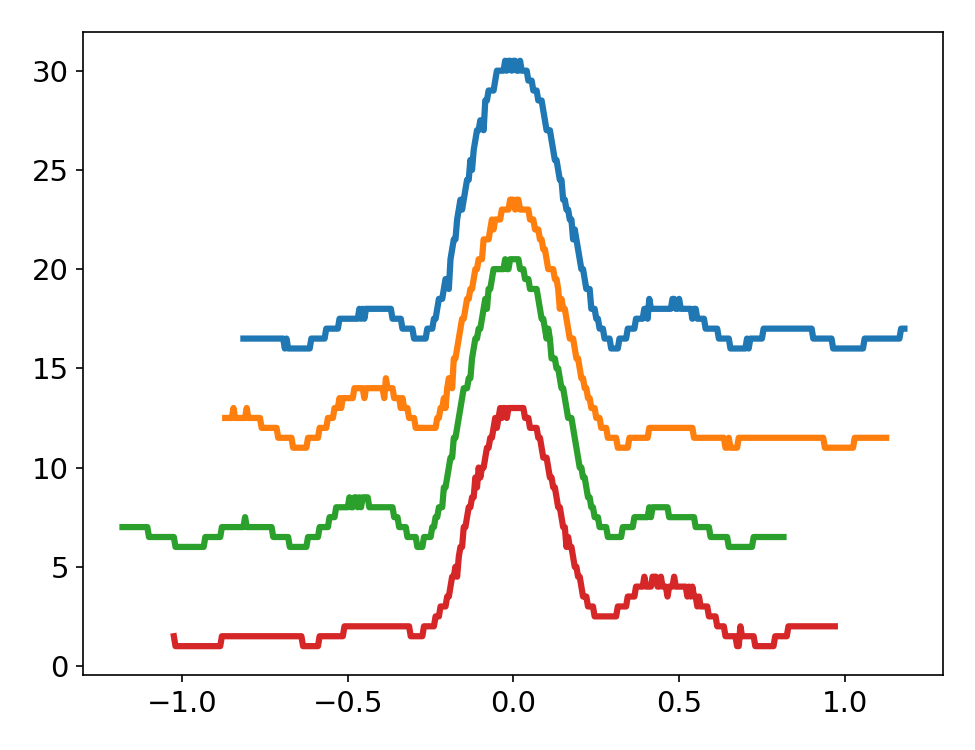

In [24]:
## For TPS plot
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')
Arange=0
Brange=400

# plt.plot((By_258[Arange:Brange,1]-By_258[max_idx_258g2,1])/1e-3,Is_258[Arange:Brange]/1e-6+5, linewidth=3)
plt.plot((By_259[Arange:Brange,1]-By_259[max_idx_259g2,1])/1e-3,Is_259[Arange:Brange]/1e-6+15, linewidth=3)
# plt.plot((By_260[Arange:Brange,1]-By_260[max_idx_260g2,1])/1e-3,Is_260[Arange:Brange]/1e-6+25)
# plt.plot((By_261[Arange:Brange,1]-By_261[max_idx_261g2,1])/1e-3,Is_261[Arange:Brange]/1e-6+10, linewidth=3)
plt.plot((By_262[Arange:Brange,1]-By_262[max_idx_262g2,1])/1e-3,Is_262[Arange:Brange]/1e-6+10, linewidth=3)
# plt.plot((By_263[Arange:Brange,1]-By_263[max_idx_263g2,1])/1e-3,Is_263[Arange:Brange]/1e-6+40)
# plt.plot((By_264[Arange:Brange,1]-By_264[max_idx_264g2,1])/1e-3,Is_264[Arange:Brange]/1e-6+15, linewidth=3)
plt.plot((By_265[Arange:Brange,1]-By_265[max_idx_265g2,1])/1e-3,Is_265[Arange:Brange]/1e-6+5, linewidth=3)
# plt.plot((By_266[Arange:Brange,1]-By_266[max_idx_266g2,1])/1e-3,Is_266[Arange:Brange]/1e-6+55)
# plt.plot((By_267[Arange:Brange,1]-By_267[max_idx_267g2,1])/1e-3,Is_267[Arange:Brange]/1e-6+20, linewidth=3)
plt.plot((By_268[Arange:Brange,1]-By_268[max_idx_268g2,1])/1e-3,Is_268[Arange:Brange]/1e-6+0, linewidth=3)
# plt.plot((By_269[Arange:Brange,1]-By_269[max_idx_269g2,1])/1e-3,Is_269[Arange:Brange]/1e-6+5)
# plt.plot((By_270[Arange:Brange,1]-By_270[max_idx_270g2,1])/1e-3,Is_270[Arange:Brange]/1e-6+10)

# plt.plot(By_266[Arange:Brange,:]/1e-3,Ir_266[Arange:Brange]/1e-6)


fig.tight_layout()
#plt.grid()
plt.show()

### Run 258 flip 

In [19]:
np.shape(Is_diff_258)

(174,)

<IPython.core.display.Javascript object>


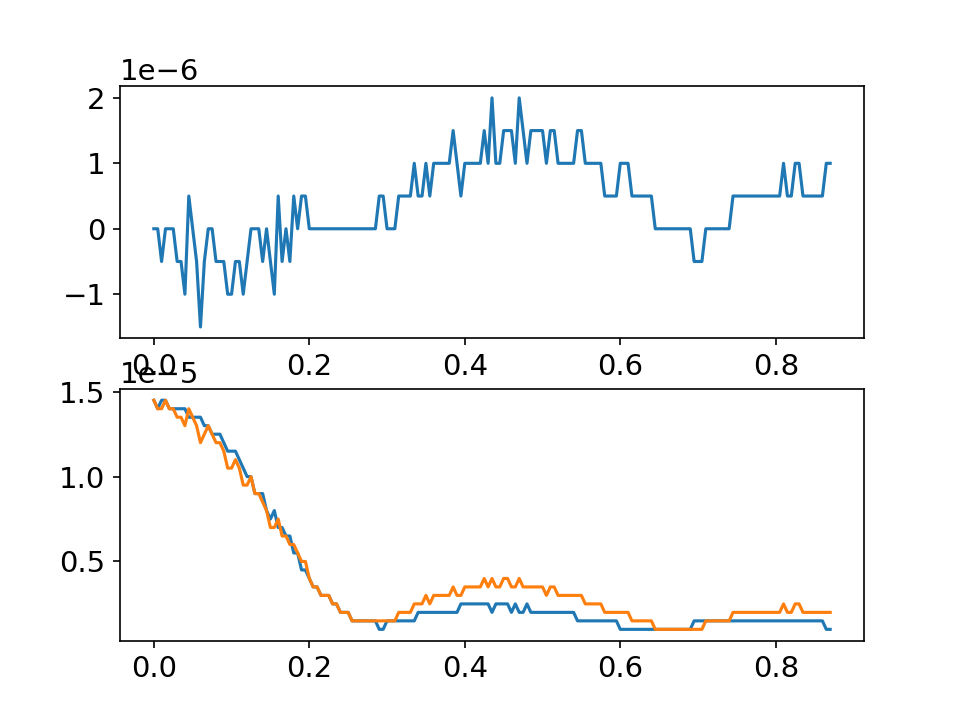

(175,) (175,) (175,)


In [92]:
max_idx_258g2=max_idx_258g-50+max_idx_258
n=1
max_idx_258g2=max_idx_258g2+n
Is_258_N=np.zeros(max_idx_258g2)
Is_258_P=np.zeros(max_idx_258g2)
Is_diff_258=np.zeros(max_idx_258g2)
By_258_shift=np.zeros(max_idx_258g2)


Is_258_N=np.flipud(Is_258[0:max_idx_258g2])
Is_258_P=Is_258[max_idx_258g2+1:2*max_idx_258g2+1]
By_258_shift=(By_258[max_idx_258g2:2*max_idx_258g2,1]-By_258[max_idx_258g2,1])/1e-3

for i in range(max_idx_258g2):
    Is_diff_258[i]=Is_258_P[i]-Is_258_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_258_shift,Is_diff_258)
plt.subplot(212)
plt.plot(By_258_shift,Is_258_N)
plt.plot(By_258_shift,Is_258_P)

print(np.shape(Is_258_N), np.shape(Is_258_P), np.shape(By_258_shift))

<IPython.core.display.Javascript object>


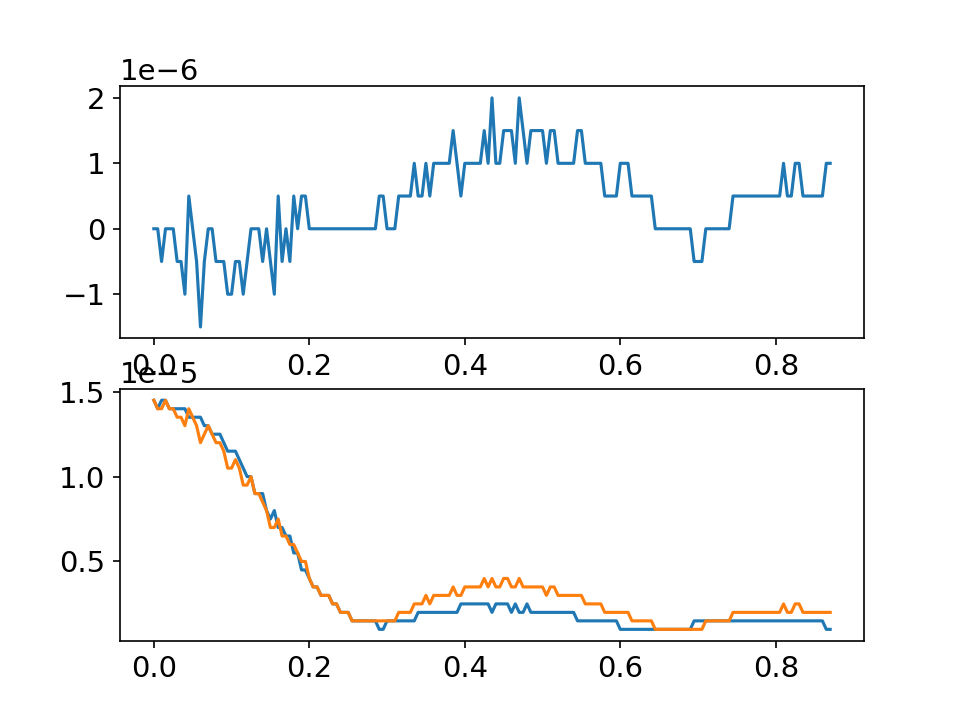

(175,) (175,) (175,)


In [93]:
max_idx_258g2=max_idx_258g-50+max_idx_258
n=1
max_idx_258g2=max_idx_258g2+n

saiz=np.size(Is_258)

if max_idx_258g2< (saiz-1)/2:
    Arange=max_idx_258g2
    Is_258_N=np.zeros(Arange)
    Is_258_P=np.zeros(Arange)
    Is_diff_258=np.zeros(Arange)
    By_258_shift=np.zeros(Arange)
    Is_258_N=np.flipud(Is_258[0:max_idx_258g2])
    Is_258_P=Is_258[max_idx_258g2+1:2*max_idx_258g2+1]
    By_258_shift=(By_258[max_idx_258g2:2*max_idx_258g2,1]-By_258[max_idx_258g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_258g2
    Is_258_N=np.zeros(Arange)
    Is_258_P=np.zeros(Arange)
    Is_diff_258=np.zeros(Arange)
    By_258_shift=np.zeros(Arange)
    Is_258_N=np.flipud(Is_258[max_idx_258g2-Arange:max_idx_258g2])
    Is_258_P=Is_258[max_idx_258g2+1:max_idx_258g2+1+Arange]
    By_258_shift=(By_258[max_idx_258g2:max_idx_258g2+Arange,1]-By_258[max_idx_258g2,1])/1e-3



for i in range(Arange):
    Is_diff_258[i]=Is_258_P[i]-Is_258_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_258_shift,Is_diff_258)
plt.subplot(212)
plt.plot(By_258_shift,Is_258_N)
plt.plot(By_258_shift,Is_258_P)

print(np.shape(Is_258_N), np.shape(Is_258_P), np.shape(By_258_shift))

### Run 259 flip

<IPython.core.display.Javascript object>


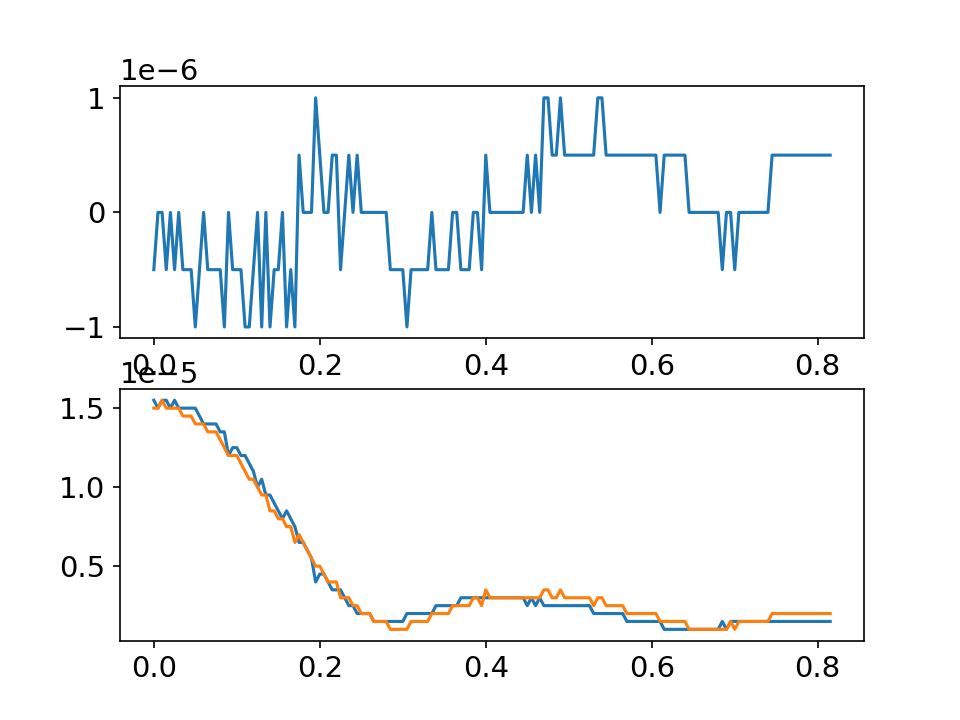

(164,) (164,) (164,)


In [94]:
max_idx_259g2=max_idx_259g-50+max_idx_259
n=1
max_idx_259g2=max_idx_259g2+n

saiz=np.size(Is_259)

if max_idx_259g2< (saiz-1)/2:
    Arange=max_idx_259g2
    Is_259_N=np.zeros(Arange)
    Is_259_P=np.zeros(Arange)
    Is_diff_259=np.zeros(Arange)
    By_259_shift=np.zeros(Arange)
    Is_259_N=np.flipud(Is_259[0:max_idx_259g2])
    Is_259_P=Is_259[max_idx_259g2+1:2*max_idx_259g2+1]
    By_259_shift=(By_259[max_idx_259g2:2*max_idx_259g2,1]-By_259[max_idx_259g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_259g2
    Is_259_N=np.zeros(Arange)
    Is_259_P=np.zeros(Arange)
    Is_diff_259=np.zeros(Arange)
    By_259_shift=np.zeros(Arange)
    Is_259_N=np.flipud(Is_259[max_idx_259g2-Arange:max_idx_259g2])
    Is_259_P=Is_259[max_idx_259g2+1:max_idx_259g2+1+Arange]
    By_259_shift=(By_259[max_idx_259g2:max_idx_259g2+Arange,1]-By_259[max_idx_259g2,1])/1e-3



for i in range(Arange):
    Is_diff_259[i]=Is_259_P[i]-Is_259_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_259_shift,Is_diff_259)
plt.subplot(212)
plt.plot(By_259_shift,Is_259_N)
plt.plot(By_259_shift,Is_259_P)

print(np.shape(Is_259_N), np.shape(Is_259_P), np.shape(By_259_shift))

### Run 260 flip

<IPython.core.display.Javascript object>


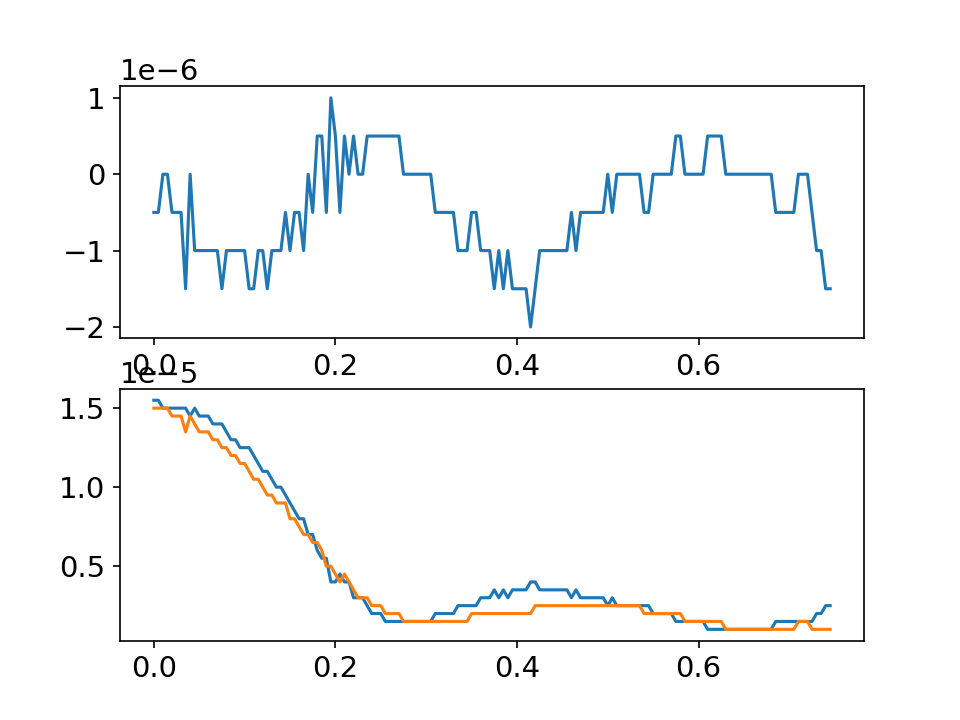

(150,) (150,) (150,)


In [95]:
max_idx_260g2=max_idx_260g-50+max_idx_260
n=1
max_idx_260g2=max_idx_260g2+n

saiz=np.size(Is_260)

if max_idx_260g2< (saiz-1)/2:
    Arange=max_idx_260g2
    Is_260_N=np.zeros(Arange)
    Is_260_P=np.zeros(Arange)
    Is_diff_260=np.zeros(Arange)
    By_260_shift=np.zeros(Arange)
    Is_260_N=np.flipud(Is_260[0:max_idx_260g2])
    Is_260_P=Is_260[max_idx_260g2+1:2*max_idx_260g2+1]
    By_260_shift=(By_260[max_idx_260g2:2*max_idx_260g2,1]-By_260[max_idx_260g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_260g2
    Is_260_N=np.zeros(Arange)
    Is_260_P=np.zeros(Arange)
    Is_diff_260=np.zeros(Arange)
    By_260_shift=np.zeros(Arange)
    Is_260_N=np.flipud(Is_260[max_idx_260g2-Arange:max_idx_260g2])
    Is_260_P=Is_260[max_idx_260g2+1:max_idx_260g2+1+Arange]
    By_260_shift=(By_260[max_idx_260g2:max_idx_260g2+Arange,1]-By_260[max_idx_260g2,1])/1e-3



for i in range(Arange):
    Is_diff_260[i]=Is_260_P[i]-Is_260_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_260_shift,Is_diff_260)
plt.subplot(212)
plt.plot(By_260_shift,Is_260_N)
plt.plot(By_260_shift,Is_260_P)

print(np.shape(Is_260_N), np.shape(Is_260_P), np.shape(By_260_shift))

### Run 261 flip

<IPython.core.display.Javascript object>


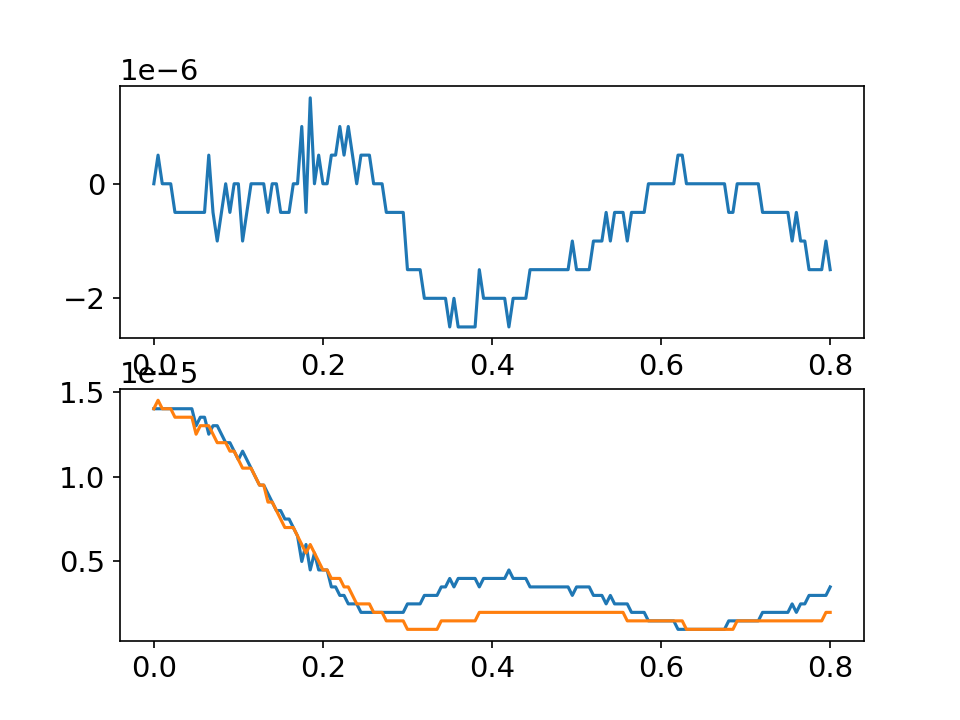

(161,) (161,) (161,)


In [96]:
max_idx_261g2=max_idx_261g-50+max_idx_261
n=1
max_idx_261g2=max_idx_261g2+n

saiz=np.size(Is_261)

if max_idx_261g2< (saiz-1)/2:
    Arange=max_idx_261g2
    Is_261_N=np.zeros(Arange)
    Is_261_P=np.zeros(Arange)
    Is_diff_261=np.zeros(Arange)
    By_261_shift=np.zeros(Arange)
    Is_261_N=np.flipud(Is_261[0:max_idx_261g2])
    Is_261_P=Is_261[max_idx_261g2+1:2*max_idx_261g2+1]
    By_261_shift=(By_261[max_idx_261g2:2*max_idx_261g2,1]-By_261[max_idx_261g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_261g2
    Is_261_N=np.zeros(Arange)
    Is_261_P=np.zeros(Arange)
    Is_diff_261=np.zeros(Arange)
    By_261_shift=np.zeros(Arange)
    Is_261_N=np.flipud(Is_261[max_idx_261g2-Arange:max_idx_261g2])
    Is_261_P=Is_261[max_idx_261g2+1:max_idx_261g2+1+Arange]
    By_261_shift=(By_261[max_idx_261g2:max_idx_261g2+Arange,1]-By_261[max_idx_261g2,1])/1e-3



for i in range(Arange):
    Is_diff_261[i]=Is_261_P[i]-Is_261_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_261_shift,Is_diff_261)
plt.subplot(212)
plt.plot(By_261_shift,Is_261_N)
plt.plot(By_261_shift,Is_261_P)

print(np.shape(Is_261_N), np.shape(Is_261_P), np.shape(By_261_shift))

### Run 262 flip

<IPython.core.display.Javascript object>


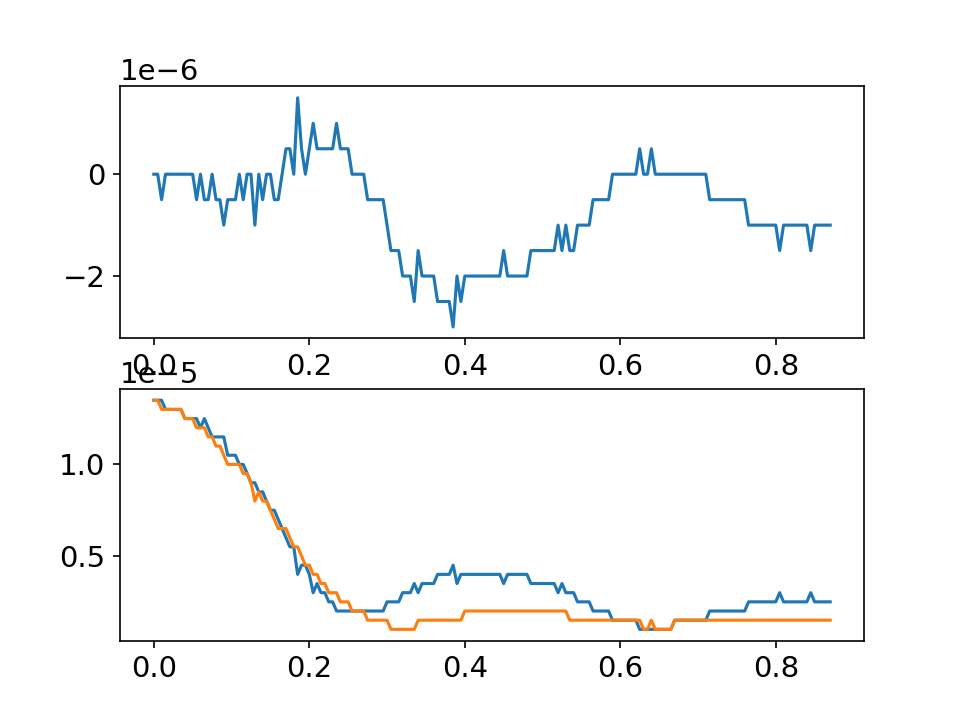

(175,) (175,) (175,)


In [97]:
max_idx_262g2=max_idx_262g-50+max_idx_262
n=1
max_idx_262g2=max_idx_262g2+n

saiz=np.size(Is_262)

if max_idx_262g2< (saiz-1)/2:
    Arange=max_idx_262g2
    Is_262_N=np.zeros(Arange)
    Is_262_P=np.zeros(Arange)
    Is_diff_262=np.zeros(Arange)
    By_262_shift=np.zeros(Arange)
    Is_262_N=np.flipud(Is_262[0:max_idx_262g2])
    Is_262_P=Is_262[max_idx_262g2+1:2*max_idx_262g2+1]
    By_262_shift=(By_262[max_idx_262g2:2*max_idx_262g2,1]-By_262[max_idx_262g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_262g2
    Is_262_N=np.zeros(Arange)
    Is_262_P=np.zeros(Arange)
    Is_diff_262=np.zeros(Arange)
    By_262_shift=np.zeros(Arange)
    Is_262_N=np.flipud(Is_262[max_idx_262g2-Arange:max_idx_262g2])
    Is_262_P=Is_262[max_idx_262g2+1:max_idx_262g2+1+Arange]
    By_262_shift=(By_262[max_idx_262g2:max_idx_262g2+Arange,1]-By_262[max_idx_262g2,1])/1e-3



for i in range(Arange):
    Is_diff_262[i]=Is_262_P[i]-Is_262_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_262_shift,Is_diff_262)
plt.subplot(212)
plt.plot(By_262_shift,Is_262_N)
plt.plot(By_262_shift,Is_262_P)

print(np.shape(Is_262_N), np.shape(Is_262_P), np.shape(By_262_shift))

### Run 263 flip

<IPython.core.display.Javascript object>


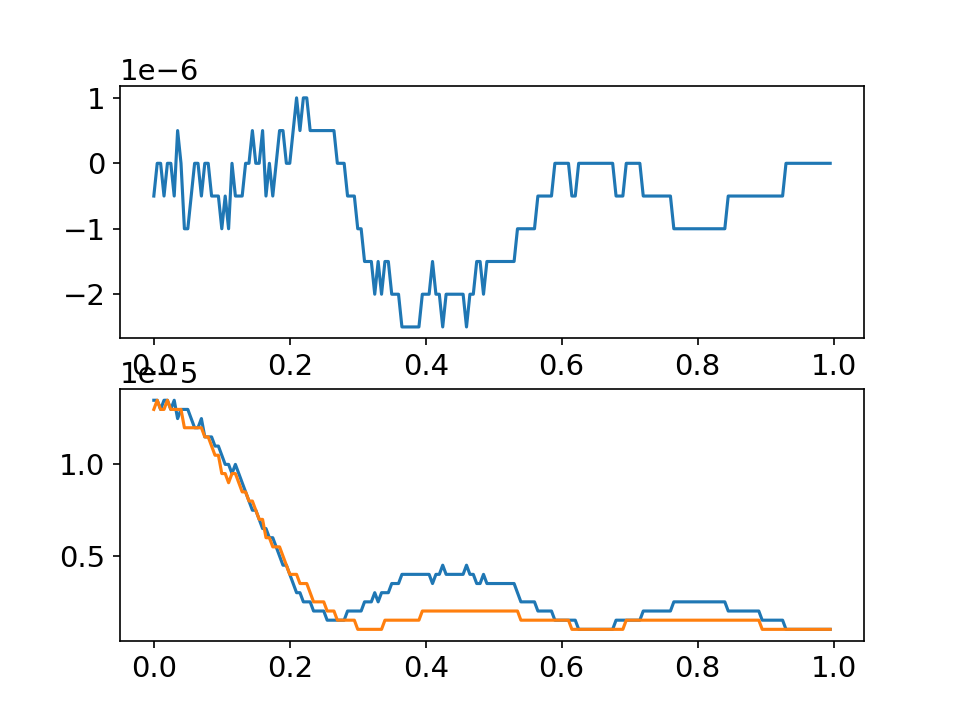

(200,) (200,) (200,)


In [98]:
max_idx_263g2=max_idx_263g-50+max_idx_263
n=1
max_idx_263g2=max_idx_263g2+n

saiz=np.size(Is_263)

if max_idx_263g2< (saiz-1)/2:
    Arange=max_idx_263g2
    Is_263_N=np.zeros(Arange)
    Is_263_P=np.zeros(Arange)
    Is_diff_263=np.zeros(Arange)
    By_263_shift=np.zeros(Arange)
    Is_263_N=np.flipud(Is_263[0:max_idx_263g2])
    Is_263_P=Is_263[max_idx_263g2+1:2*max_idx_263g2+1]
    By_263_shift=(By_263[max_idx_263g2:2*max_idx_263g2,1]-By_263[max_idx_263g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_263g2
    Is_263_N=np.zeros(Arange)
    Is_263_P=np.zeros(Arange)
    Is_diff_263=np.zeros(Arange)
    By_263_shift=np.zeros(Arange)
    Is_263_N=np.flipud(Is_263[max_idx_263g2-Arange:max_idx_263g2])
    Is_263_P=Is_263[max_idx_263g2+1:max_idx_263g2+1+Arange]
    By_263_shift=(By_263[max_idx_263g2:max_idx_263g2+Arange,1]-By_263[max_idx_263g2,1])/1e-3



for i in range(Arange):
    Is_diff_263[i]=Is_263_P[i]-Is_263_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_263_shift,Is_diff_263)
plt.subplot(212)
plt.plot(By_263_shift,Is_263_N)
plt.plot(By_263_shift,Is_263_P)

print(np.shape(Is_263_N), np.shape(Is_263_P), np.shape(By_263_shift))

### Run 264 flip

In [99]:
saiz=np.size(Is_264)

if max_idx_264g2< (saiz-1)/2:
    Arange=max_idx_264g2
else:
    Arange=saiz-1-max_idx_264g2

print(max_idx_264g2-Arange, Arange, max_idx_264g2)

38 181 219


<IPython.core.display.Javascript object>


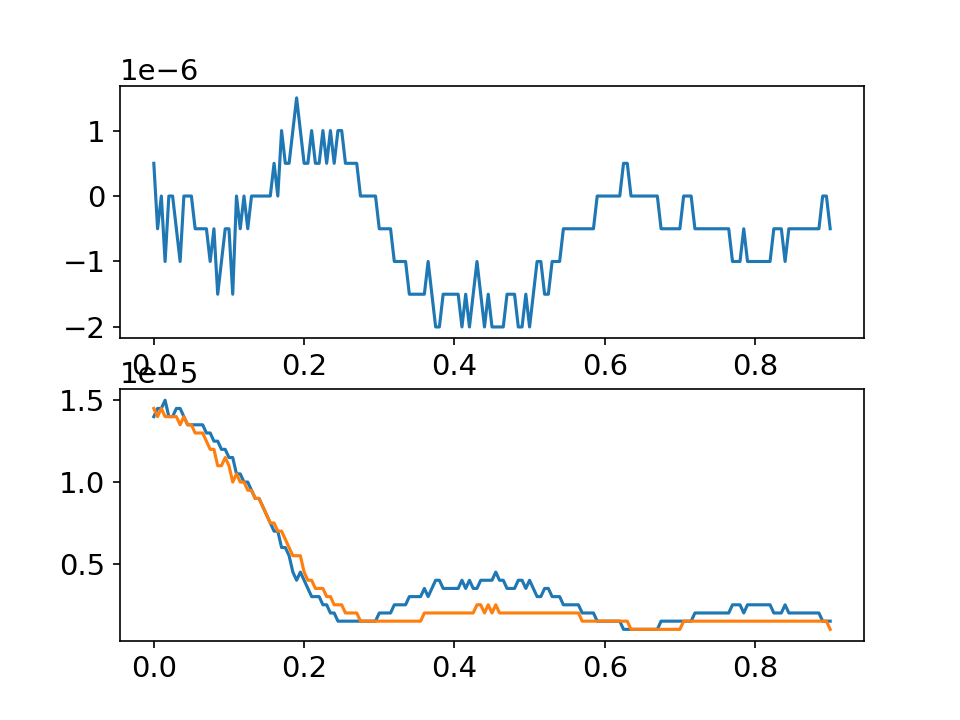

(181,) (181,) (181,)


In [100]:
max_idx_264g2=max_idx_264g-50+max_idx_264
n=0
max_idx_264g2=max_idx_264g2+n

saiz=np.size(Is_264)

if max_idx_264g2< (saiz-1)/2:
    Arange=max_idx_264g2
    Is_264_N=np.zeros(Arange)
    Is_264_P=np.zeros(Arange)
    Is_diff_264=np.zeros(Arange)
    By_264_shift=np.zeros(Arange)
    Is_264_N=np.flipud(Is_264[0:max_idx_264g2])
    Is_264_P=Is_264[max_idx_264g2+1:2*max_idx_264g2+1]
    By_264_shift=(By_264[max_idx_264g2:2*max_idx_264g2,1]-By_264[max_idx_264g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_264g2
    Is_264_N=np.zeros(Arange)
    Is_264_P=np.zeros(Arange)
    Is_diff_264=np.zeros(Arange)
    By_264_shift=np.zeros(Arange)
    Is_264_N=np.flipud(Is_264[max_idx_264g2-Arange:max_idx_264g2])
    Is_264_P=Is_264[max_idx_264g2+1:max_idx_264g2+1+Arange]
    By_264_shift=(By_264[max_idx_264g2:max_idx_264g2+Arange,1]-By_264[max_idx_264g2,1])/1e-3



for i in range(Arange):
    Is_diff_264[i]=Is_264_P[i]-Is_264_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_264_shift,Is_diff_264)
plt.subplot(212)
plt.plot(By_264_shift,Is_264_N)
plt.plot(By_264_shift,Is_264_P)

print(np.shape(Is_264_N), np.shape(Is_264_P), np.shape(By_264_shift))

### Run 265 flip

<IPython.core.display.Javascript object>


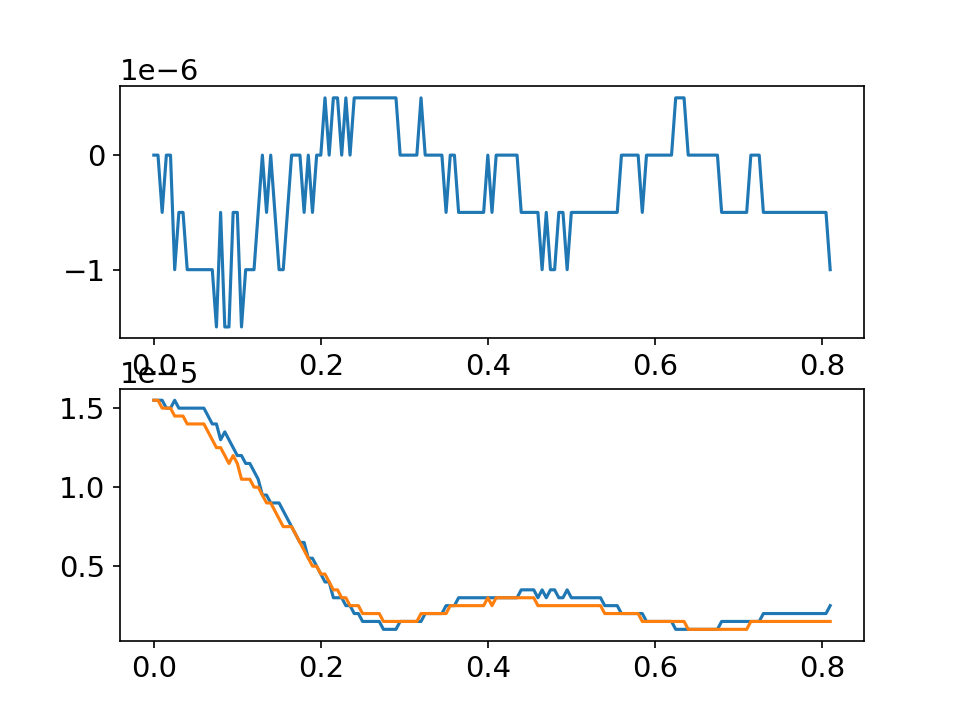

(163,) (163,) (163,)


In [101]:
max_idx_265g2=max_idx_265g-50+max_idx_265
n=1
max_idx_265g2=max_idx_265g2+n

saiz=np.size(Is_265)

if max_idx_265g2< (saiz-1)/2:
    Arange=max_idx_265g2
    Is_265_N=np.zeros(Arange)
    Is_265_P=np.zeros(Arange)
    Is_diff_265=np.zeros(Arange)
    By_265_shift=np.zeros(Arange)
    Is_265_N=np.flipud(Is_265[0:max_idx_265g2])
    Is_265_P=Is_265[max_idx_265g2+1:2*max_idx_265g2+1]
    By_265_shift=(By_265[max_idx_265g2:2*max_idx_265g2,1]-By_265[max_idx_265g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_265g2
    Is_265_N=np.zeros(Arange)
    Is_265_P=np.zeros(Arange)
    Is_diff_265=np.zeros(Arange)
    By_265_shift=np.zeros(Arange)
    Is_265_N=np.flipud(Is_265[max_idx_265g2-Arange:max_idx_265g2])
    Is_265_P=Is_265[max_idx_265g2+1:max_idx_265g2+1+Arange]
    By_265_shift=(By_265[max_idx_265g2:max_idx_265g2+Arange,1]-By_265[max_idx_265g2,1])/1e-3



for i in range(Arange):
    Is_diff_265[i]=Is_265_P[i]-Is_265_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_265_shift,Is_diff_265)
plt.subplot(212)
plt.plot(By_265_shift,Is_265_N)
plt.plot(By_265_shift,Is_265_P)

print(np.shape(Is_265_N), np.shape(Is_265_P), np.shape(By_265_shift))

### Run 266 flip

<IPython.core.display.Javascript object>


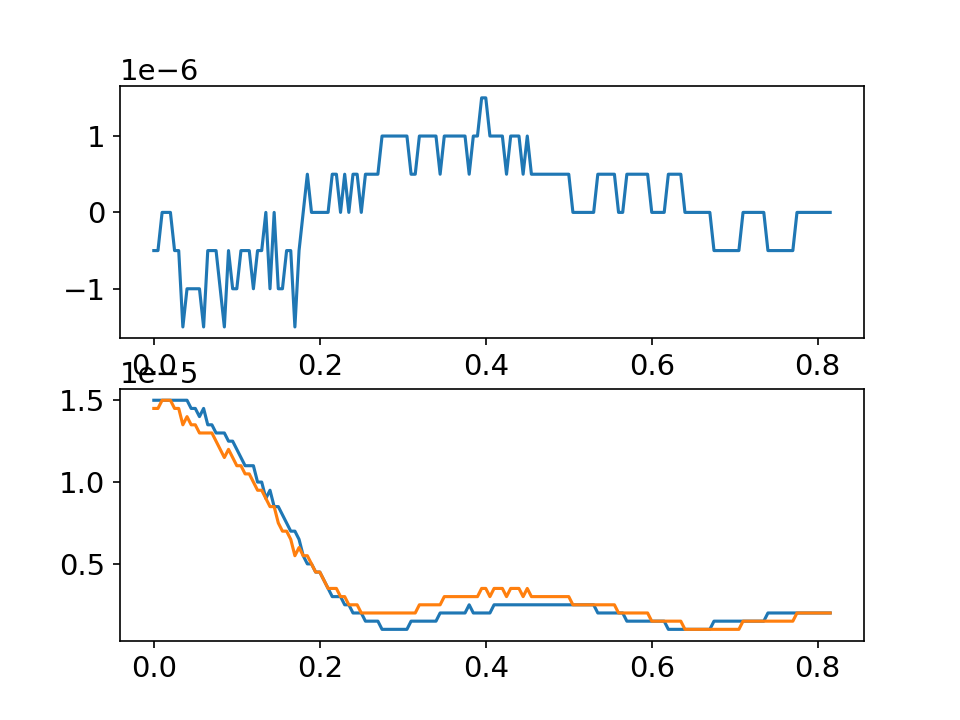

(164,) (164,) (164,)


In [102]:
max_idx_266g2=max_idx_266g-50+max_idx_266
n=1
max_idx_266g2=max_idx_266g2+n

saiz=np.size(Is_266)

if max_idx_266g2< (saiz-1)/2:
    Arange=max_idx_266g2
    Is_266_N=np.zeros(Arange)
    Is_266_P=np.zeros(Arange)
    Is_diff_266=np.zeros(Arange)
    By_266_shift=np.zeros(Arange)
    Is_266_N=np.flipud(Is_266[0:max_idx_266g2])
    Is_266_P=Is_266[max_idx_266g2+1:2*max_idx_266g2+1]
    By_266_shift=(By_266[max_idx_266g2:2*max_idx_266g2,1]-By_266[max_idx_266g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_266g2
    Is_266_N=np.zeros(Arange)
    Is_266_P=np.zeros(Arange)
    Is_diff_266=np.zeros(Arange)
    By_266_shift=np.zeros(Arange)
    Is_266_N=np.flipud(Is_266[max_idx_266g2-Arange:max_idx_266g2])
    Is_266_P=Is_266[max_idx_266g2+1:max_idx_266g2+1+Arange]
    By_266_shift=(By_266[max_idx_266g2:max_idx_266g2+Arange,1]-By_266[max_idx_266g2,1])/1e-3



for i in range(Arange):
    Is_diff_266[i]=Is_266_P[i]-Is_266_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_266_shift,Is_diff_266)
plt.subplot(212)
plt.plot(By_266_shift,Is_266_N)
plt.plot(By_266_shift,Is_266_P)

print(np.shape(Is_266_N), np.shape(Is_266_P), np.shape(By_266_shift))

### Run 267 flip

<IPython.core.display.Javascript object>


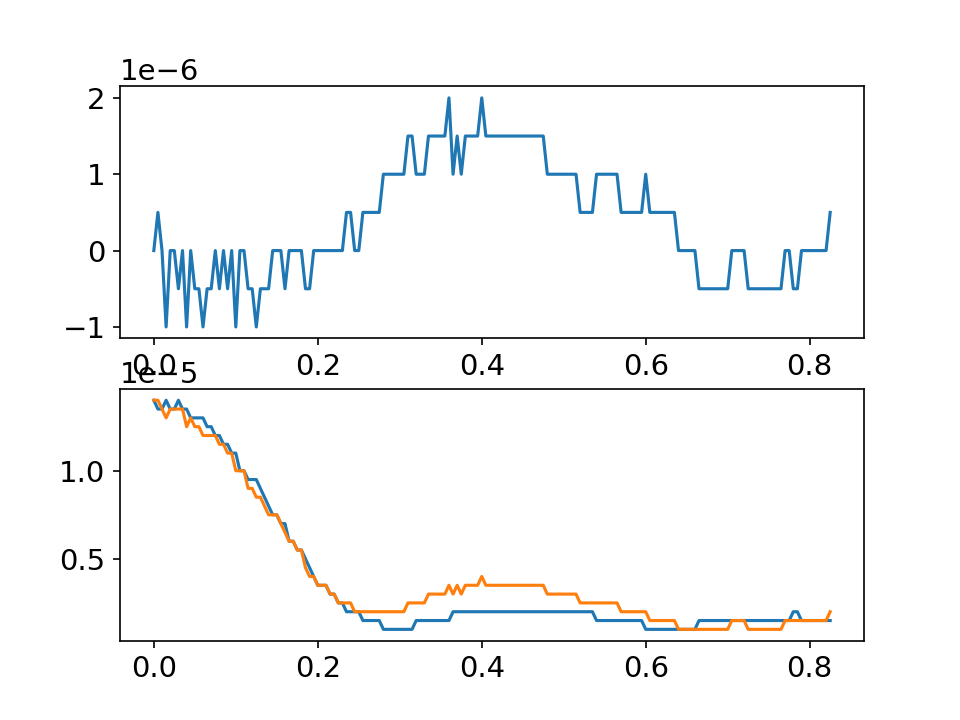

(166,) (166,) (166,)


In [103]:
max_idx_267g2=max_idx_267g-50+max_idx_267
n=1
max_idx_267g2=max_idx_267g2+n

saiz=np.size(Is_267)

if max_idx_267g2< (saiz-1)/2:
    Arange=max_idx_267g2
    Is_267_N=np.zeros(Arange)
    Is_267_P=np.zeros(Arange)
    Is_diff_267=np.zeros(Arange)
    By_267_shift=np.zeros(Arange)
    Is_267_N=np.flipud(Is_267[0:max_idx_267g2])
    Is_267_P=Is_267[max_idx_267g2+1:2*max_idx_267g2+1]
    By_267_shift=(By_267[max_idx_267g2:2*max_idx_267g2,1]-By_267[max_idx_267g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_267g2
    Is_267_N=np.zeros(Arange)
    Is_267_P=np.zeros(Arange)
    Is_diff_267=np.zeros(Arange)
    By_267_shift=np.zeros(Arange)
    Is_267_N=np.flipud(Is_267[max_idx_267g2-Arange:max_idx_267g2])
    Is_267_P=Is_267[max_idx_267g2+1:max_idx_267g2+1+Arange]
    By_267_shift=(By_267[max_idx_267g2:max_idx_267g2+Arange,1]-By_267[max_idx_267g2,1])/1e-3



for i in range(Arange):
    Is_diff_267[i]=Is_267_P[i]-Is_267_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_267_shift,Is_diff_267)
plt.subplot(212)
plt.plot(By_267_shift,Is_267_N)
plt.plot(By_267_shift,Is_267_P)

print(np.shape(Is_267_N), np.shape(Is_267_P), np.shape(By_267_shift))

### Run 268 flip

<IPython.core.display.Javascript object>


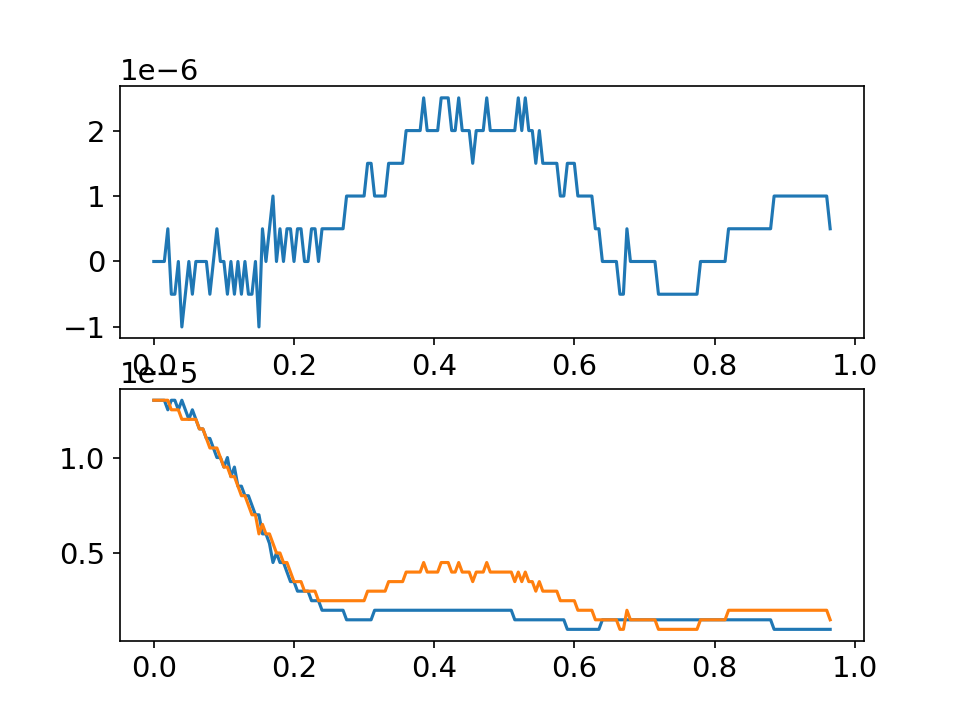

(194,) (194,) (194,)


In [104]:
max_idx_268g2=max_idx_268g-50+max_idx_268
n=1
max_idx_268g2=max_idx_268g2+n

saiz=np.size(Is_268)

if max_idx_268g2< (saiz-1)/2:
    Arange=max_idx_268g2
    Is_268_N=np.zeros(Arange)
    Is_268_P=np.zeros(Arange)
    Is_diff_268=np.zeros(Arange)
    By_268_shift=np.zeros(Arange)
    Is_268_N=np.flipud(Is_268[0:max_idx_268g2])
    Is_268_P=Is_268[max_idx_268g2+1:2*max_idx_268g2+1]
    By_268_shift=(By_268[max_idx_268g2:2*max_idx_268g2,1]-By_268[max_idx_268g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_268g2
    Is_268_N=np.zeros(Arange)
    Is_268_P=np.zeros(Arange)
    Is_diff_268=np.zeros(Arange)
    By_268_shift=np.zeros(Arange)
    Is_268_N=np.flipud(Is_268[max_idx_268g2-Arange:max_idx_268g2])
    Is_268_P=Is_268[max_idx_268g2+1:max_idx_268g2+1+Arange]
    By_268_shift=(By_268[max_idx_268g2:max_idx_268g2+Arange,1]-By_268[max_idx_268g2,1])/1e-3



for i in range(Arange):
    Is_diff_268[i]=Is_268_P[i]-Is_268_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_268_shift,Is_diff_268)
plt.subplot(212)
plt.plot(By_268_shift,Is_268_N)
plt.plot(By_268_shift,Is_268_P)

print(np.shape(Is_268_N), np.shape(Is_268_P), np.shape(By_268_shift))

### Run 269 flip

<IPython.core.display.Javascript object>


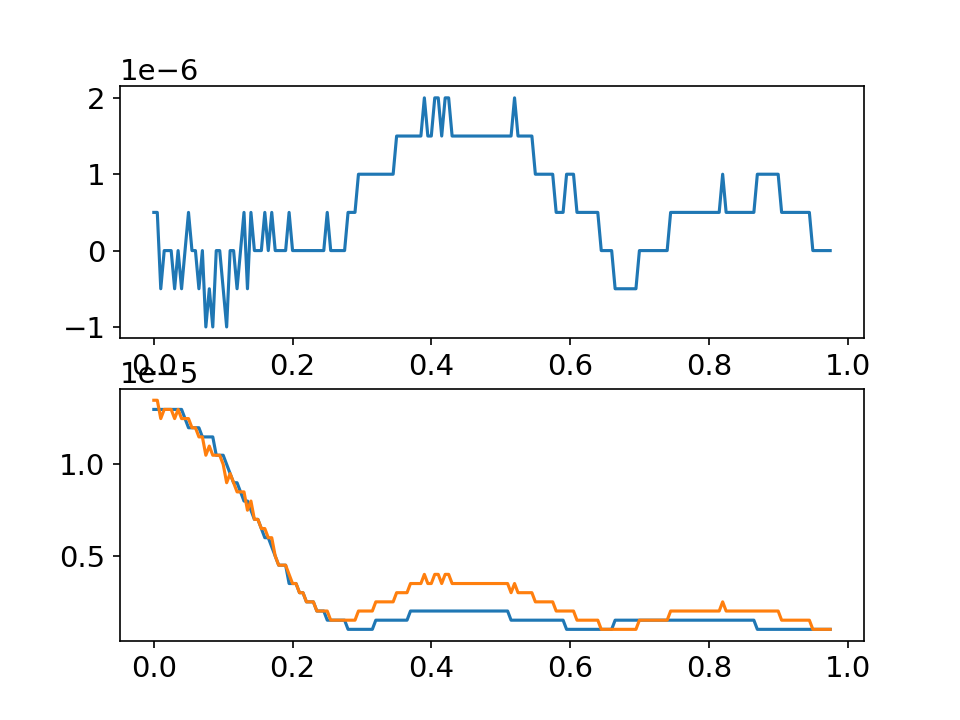

(196,) (196,) (196,)


In [105]:
max_idx_269g2=max_idx_269g-50+max_idx_269
n=1
max_idx_269g2=max_idx_269g2+n

saiz=np.size(Is_269)

if max_idx_269g2< (saiz-1)/2:
    Arange=max_idx_269g2
    Is_269_N=np.zeros(Arange)
    Is_269_P=np.zeros(Arange)
    Is_diff_269=np.zeros(Arange)
    By_269_shift=np.zeros(Arange)
    Is_269_N=np.flipud(Is_269[0:max_idx_269g2])
    Is_269_P=Is_269[max_idx_269g2+1:2*max_idx_269g2+1]
    By_269_shift=(By_269[max_idx_269g2:2*max_idx_269g2,1]-By_269[max_idx_269g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_269g2
    Is_269_N=np.zeros(Arange)
    Is_269_P=np.zeros(Arange)
    Is_diff_269=np.zeros(Arange)
    By_269_shift=np.zeros(Arange)
    Is_269_N=np.flipud(Is_269[max_idx_269g2-Arange:max_idx_269g2])
    Is_269_P=Is_269[max_idx_269g2+1:max_idx_269g2+1+Arange]
    By_269_shift=(By_269[max_idx_269g2:max_idx_269g2+Arange,1]-By_269[max_idx_269g2,1])/1e-3



for i in range(Arange):
    Is_diff_269[i]=Is_269_P[i]-Is_269_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_269_shift,Is_diff_269)
plt.subplot(212)
plt.plot(By_269_shift,Is_269_N)
plt.plot(By_269_shift,Is_269_P)

print(np.shape(Is_269_N), np.shape(Is_269_P), np.shape(By_269_shift))

### Run 270 flip

<IPython.core.display.Javascript object>


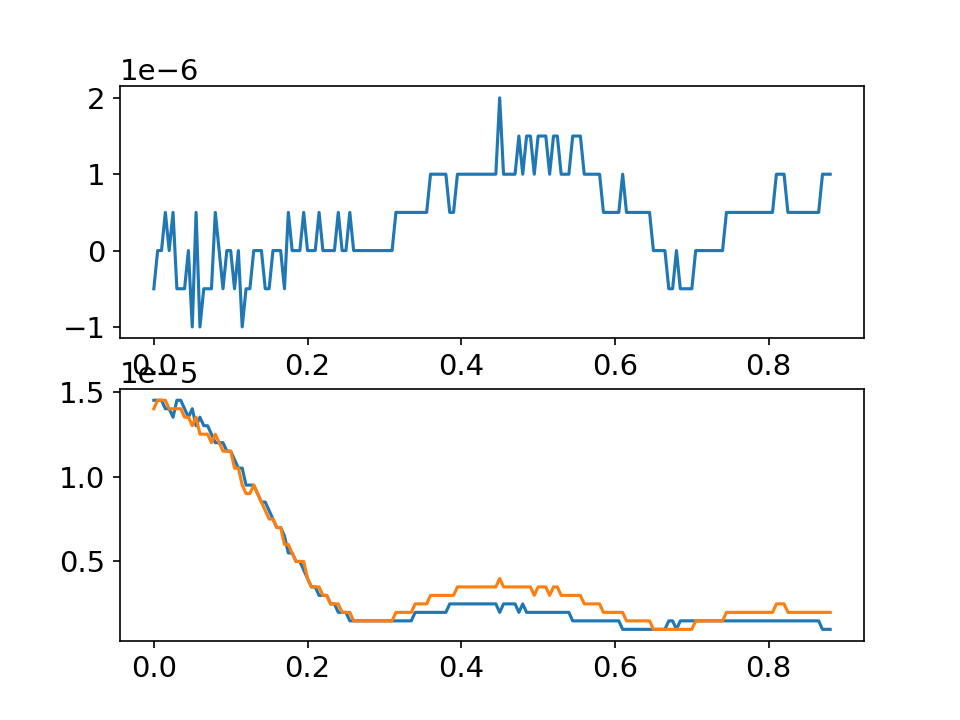

(177,) (177,) (177,)


In [106]:
max_idx_270g2=max_idx_270g-50+max_idx_270
n=1
max_idx_270g2=max_idx_270g2+n

saiz=np.size(Is_270)

if max_idx_270g2< (saiz-1)/2:
    Arange=max_idx_270g2
    Is_270_N=np.zeros(Arange)
    Is_270_P=np.zeros(Arange)
    Is_diff_270=np.zeros(Arange)
    By_270_shift=np.zeros(Arange)
    Is_270_N=np.flipud(Is_270[0:max_idx_270g2])
    Is_270_P=Is_270[max_idx_270g2+1:2*max_idx_270g2+1]
    By_270_shift=(By_270[max_idx_270g2:2*max_idx_270g2,1]-By_270[max_idx_270g2,1])/1e-3
else:
    Arange=saiz-1-max_idx_270g2
    Is_270_N=np.zeros(Arange)
    Is_270_P=np.zeros(Arange)
    Is_diff_270=np.zeros(Arange)
    By_270_shift=np.zeros(Arange)
    Is_270_N=np.flipud(Is_270[max_idx_270g2-Arange:max_idx_270g2])
    Is_270_P=Is_270[max_idx_270g2+1:max_idx_270g2+1+Arange]
    By_270_shift=(By_270[max_idx_270g2:max_idx_270g2+Arange,1]-By_270[max_idx_270g2,1])/1e-3



for i in range(Arange):
    Is_diff_270[i]=Is_270_P[i]-Is_270_N[i]
    
fig, ax = plt.subplots(2,1)

plt.subplot(211)
plt.plot(By_270_shift,Is_diff_270)
plt.subplot(212)
plt.plot(By_270_shift,Is_270_N)
plt.plot(By_270_shift,Is_270_P)

print(np.shape(Is_270_N), np.shape(Is_270_P), np.shape(By_270_shift))

In [32]:
np.savetxt('By_258_shift.csv', (By_258_shift), fmt='%s', delimiter=',')
np.savetxt('Is_258_N.csv', (Is_258_N), fmt='%s', delimiter=',')
np.savetxt('Is_258_P.csv', (Is_258_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_258.csv', (Is_diff_258), fmt='%s', delimiter=',')

np.savetxt('By_259_shift.csv', (By_259_shift), fmt='%s', delimiter=',')
np.savetxt('Is_259_N.csv', (Is_259_N), fmt='%s', delimiter=',')
np.savetxt('Is_259_P.csv', (Is_259_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_259.csv', (Is_diff_259), fmt='%s', delimiter=',')

np.savetxt('By_260_shift.csv', (By_260_shift), fmt='%s', delimiter=',')
np.savetxt('Is_260_N.csv', (Is_260_N), fmt='%s', delimiter=',')
np.savetxt('Is_260_P.csv', (Is_260_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_260.csv', (Is_diff_260), fmt='%s', delimiter=',')

np.savetxt('By_261_shift.csv', (By_261_shift), fmt='%s', delimiter=',')
np.savetxt('Is_261_N.csv', (Is_261_N), fmt='%s', delimiter=',')
np.savetxt('Is_261_P.csv', (Is_261_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_261.csv', (Is_diff_261), fmt='%s', delimiter=',')

np.savetxt('By_262_shift.csv', (By_262_shift), fmt='%s', delimiter=',')
np.savetxt('Is_262_N.csv', (Is_262_N), fmt='%s', delimiter=',')
np.savetxt('Is_262_P.csv', (Is_262_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_262.csv', (Is_diff_262), fmt='%s', delimiter=',')

np.savetxt('By_263_shift.csv', (By_263_shift), fmt='%s', delimiter=',')
np.savetxt('Is_263_N.csv', (Is_263_N), fmt='%s', delimiter=',')
np.savetxt('Is_263_P.csv', (Is_263_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_263.csv', (Is_diff_263), fmt='%s', delimiter=',')

np.savetxt('By_264_shift.csv', (By_264_shift), fmt='%s', delimiter=',')
np.savetxt('Is_264_N.csv', (Is_264_N), fmt='%s', delimiter=',')
np.savetxt('Is_264_P.csv', (Is_264_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_264.csv', (Is_diff_264), fmt='%s', delimiter=',')

np.savetxt('By_265_shift.csv', (By_265_shift), fmt='%s', delimiter=',')
np.savetxt('Is_265_N.csv', (Is_265_N), fmt='%s', delimiter=',')
np.savetxt('Is_265_P.csv', (Is_265_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_265.csv', (Is_diff_265), fmt='%s', delimiter=',')

np.savetxt('By_266_shift.csv', (By_266_shift), fmt='%s', delimiter=',')
np.savetxt('Is_266_N.csv', (Is_266_N), fmt='%s', delimiter=',')
np.savetxt('Is_266_P.csv', (Is_266_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_266.csv', (Is_diff_266), fmt='%s', delimiter=',')

np.savetxt('By_267_shift.csv', (By_267_shift), fmt='%s', delimiter=',')
np.savetxt('Is_267_N.csv', (Is_267_N), fmt='%s', delimiter=',')
np.savetxt('Is_267_P.csv', (Is_267_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_267.csv', (Is_diff_267), fmt='%s', delimiter=',')

np.savetxt('By_268_shift.csv', (By_268_shift), fmt='%s', delimiter=',')
np.savetxt('Is_268_N.csv', (Is_268_N), fmt='%s', delimiter=',')
np.savetxt('Is_268_P.csv', (Is_268_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_268.csv', (Is_diff_268), fmt='%s', delimiter=',')

np.savetxt('By_269_shift.csv', (By_269_shift), fmt='%s', delimiter=',')
np.savetxt('Is_269_N.csv', (Is_269_N), fmt='%s', delimiter=',')
np.savetxt('Is_269_P.csv', (Is_269_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_269.csv', (Is_diff_269), fmt='%s', delimiter=',')

np.savetxt('By_270_shift.csv', (By_270_shift), fmt='%s', delimiter=',')
np.savetxt('Is_270_N.csv', (Is_270_N), fmt='%s', delimiter=',')
np.savetxt('Is_270_P.csv', (Is_270_P), fmt='%s', delimiter=',')
np.savetxt('Is_diff_270.csv', (Is_diff_270), fmt='%s', delimiter=',')

## Load 258-270 flip

In [107]:
By_258_shift=np.loadtxt('By_258_shift.csv', delimiter=",")
Is_258_N=np.loadtxt('Is_258_N.csv', delimiter=",")
Is_258_P=np.loadtxt('Is_258_P.csv', delimiter=",")
Is_diff_258=np.loadtxt('Is_diff_258.csv', delimiter=",")

By_259_shift=np.loadtxt('By_259_shift.csv', delimiter=",")
Is_259_N=np.loadtxt('Is_259_N.csv', delimiter=",")
Is_259_P=np.loadtxt('Is_259_P.csv', delimiter=",")
Is_diff_259=np.loadtxt('Is_diff_259.csv', delimiter=",")

By_260_shift=np.loadtxt('By_260_shift.csv', delimiter=",")
Is_260_N=np.loadtxt('Is_260_N.csv', delimiter=",")
Is_260_P=np.loadtxt('Is_260_P.csv', delimiter=",")
Is_diff_260=np.loadtxt('Is_diff_260.csv', delimiter=",")

By_261_shift=np.loadtxt('By_261_shift.csv', delimiter=",")
Is_261_N=np.loadtxt('Is_261_N.csv', delimiter=",")
Is_261_P=np.loadtxt('Is_261_P.csv', delimiter=",")
Is_diff_261=np.loadtxt('Is_diff_261.csv', delimiter=",")

By_262_shift=np.loadtxt('By_262_shift.csv', delimiter=",")
Is_262_N=np.loadtxt('Is_262_N.csv', delimiter=",")
Is_262_P=np.loadtxt('Is_262_P.csv', delimiter=",")
Is_diff_262=np.loadtxt('Is_diff_262.csv', delimiter=",")

By_263_shift=np.loadtxt('By_263_shift.csv', delimiter=",")
Is_263_N=np.loadtxt('Is_263_N.csv', delimiter=",")
Is_263_P=np.loadtxt('Is_263_P.csv', delimiter=",")
Is_diff_263=np.loadtxt('Is_diff_263.csv', delimiter=",")

By_264_shift=np.loadtxt('By_264_shift.csv', delimiter=",")
Is_264_N=np.loadtxt('Is_264_N.csv', delimiter=",")
Is_264_P=np.loadtxt('Is_264_P.csv', delimiter=",")
Is_diff_264=np.loadtxt('Is_diff_264.csv', delimiter=",")

By_265_shift=np.loadtxt('By_265_shift.csv', delimiter=",")
Is_265_N=np.loadtxt('Is_265_N.csv', delimiter=",")
Is_265_P=np.loadtxt('Is_265_P.csv', delimiter=",")
Is_diff_265=np.loadtxt('Is_diff_265.csv', delimiter=",")

By_266_shift=np.loadtxt('By_266_shift.csv', delimiter=",")
Is_266_N=np.loadtxt('Is_266_N.csv', delimiter=",")
Is_266_P=np.loadtxt('Is_266_P.csv', delimiter=",")
Is_diff_266=np.loadtxt('Is_diff_266.csv', delimiter=",")

By_267_shift=np.loadtxt('By_267_shift.csv', delimiter=",")
Is_267_N=np.loadtxt('Is_267_N.csv', delimiter=",")
Is_267_P=np.loadtxt('Is_267_P.csv', delimiter=",")
Is_diff_267=np.loadtxt('Is_diff_267.csv', delimiter=",")

By_268_shift=np.loadtxt('By_268_shift.csv', delimiter=",")
Is_268_N=np.loadtxt('Is_268_N.csv', delimiter=",")
Is_268_P=np.loadtxt('Is_268_P.csv', delimiter=",")
Is_diff_268=np.loadtxt('Is_diff_268.csv', delimiter=",")

By_269_shift=np.loadtxt('By_269_shift.csv', delimiter=",")
Is_269_N=np.loadtxt('Is_269_N.csv', delimiter=",")
Is_269_P=np.loadtxt('Is_269_P.csv', delimiter=",")
Is_diff_269=np.loadtxt('Is_diff_269.csv', delimiter=",")

By_270_shift=np.loadtxt('By_270_shift.csv', delimiter=",")
Is_270_N=np.loadtxt('Is_270_N.csv', delimiter=",")
Is_270_P=np.loadtxt('Is_270_P.csv', delimiter=",")
Is_diff_270=np.loadtxt('Is_diff_270.csv', delimiter=",")

<IPython.core.display.Javascript object>


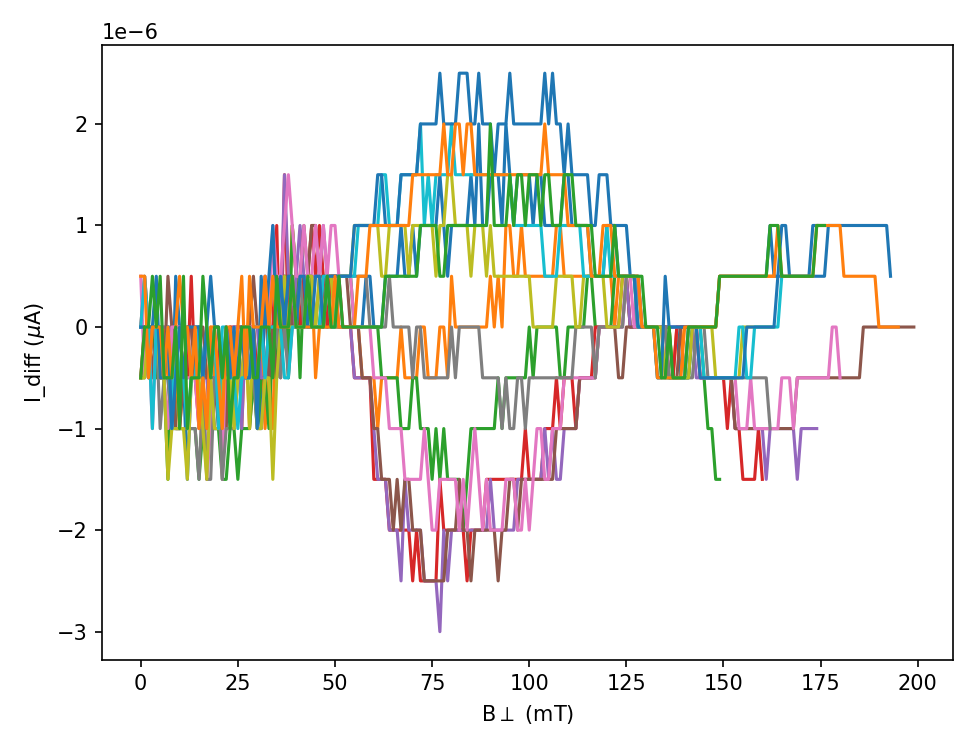

In [7]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,5))
fig.subplots_adjust(hspace=55)

# plt.plot(Is_diff_258)
plt.plot(Is_diff_258)
plt.plot(Is_diff_259)
plt.plot(Is_diff_260)
plt.plot(Is_diff_261)
plt.plot(Is_diff_262)
plt.plot(Is_diff_263)
plt.plot(Is_diff_264)
plt.plot(Is_diff_265)
plt.plot(Is_diff_266)
plt.plot(Is_diff_267)
plt.plot(Is_diff_268)
plt.plot(Is_diff_269)
plt.plot(Is_diff_270)
'''
plt.plot(By_258_shift,Is_diff_258)
plt.plot(By_259_shift,Is_diff_259)
plt.plot(By_260_shift,Is_diff_260)
plt.plot(By_261_shift,Is_diff_261)
plt.plot(By_262_shift,Is_diff_262)
plt.plot(By_263_shift,Is_diff_263)
plt.plot(By_264_shift,Is_diff_264)
plt.plot(By_265_shift,Is_diff_265)
plt.plot(By_266_shift,Is_diff_266)
plt.plot(By_267_shift,Is_diff_267)
plt.plot(By_268_shift,Is_diff_268)
plt.plot(By_269_shift,Is_diff_269)
plt.plot(By_270_shift,Is_diff_270)
'''
plt.xlabel("B$\perp$ (mT)" )
plt.ylabel("I_diff ($\mu$A)" )


fig.tight_layout()
#plt.grid()
plt.show()

## Run 258 to 270 Angle dependence

<IPython.core.display.Javascript object>


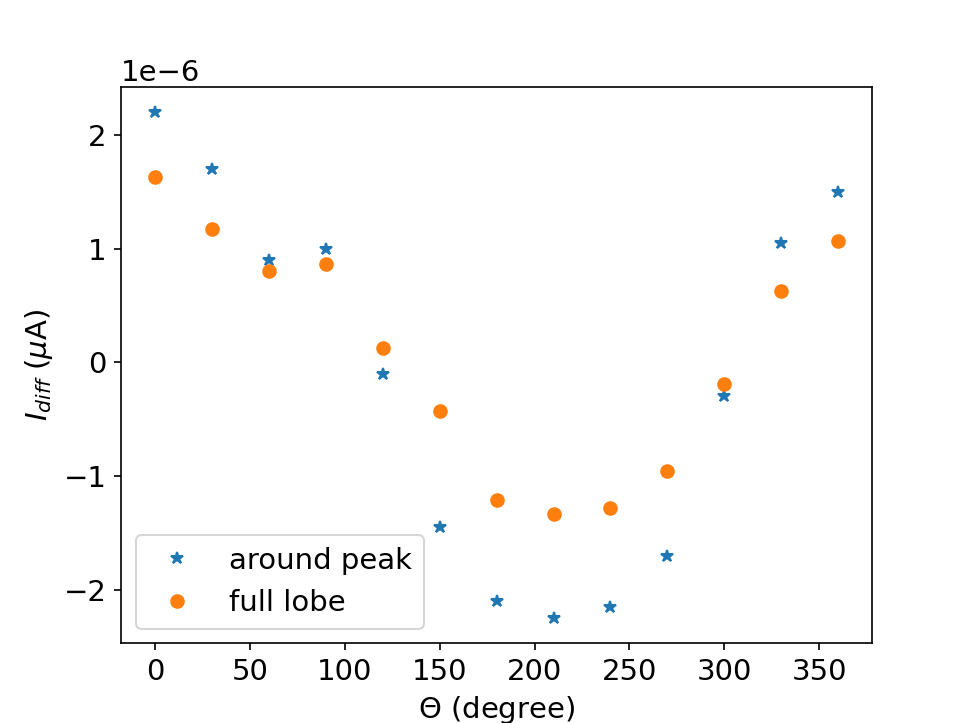

In [111]:
plt.figure(figsize=(5.5, 4))

Is_diff_L01all=np.zeros((13,140))
Is_diff_L01all[3,:]=Is_diff_258[0:140]
Is_diff_L01all[4,:]=Is_diff_259[0:140]
Is_diff_L01all[5,:]=Is_diff_260[0:140]
Is_diff_L01all[6,:]=Is_diff_261[0:140]
Is_diff_L01all[7,:]=Is_diff_262[0:140]
Is_diff_L01all[8,:]=Is_diff_263[0:140]
Is_diff_L01all[9,:]=Is_diff_264[0:140]
Is_diff_L01all[10,:]=Is_diff_265[0:140]
Is_diff_L01all[11,:]=Is_diff_266[0:140]
Is_diff_L01all[12,:]=Is_diff_267[0:140]
Is_diff_L01all[0,:]=Is_diff_268[0:140]
Is_diff_L01all[1,:]=Is_diff_269[0:140]
Is_diff_L01all[2,:]=Is_diff_270[0:140]

theta=np.linspace(0,360,13)
# plt.plot(Is_diff_L02all[1,0:125])
test1=np.zeros(13)
for i in range(13):
    test1[i]=np.mean(Is_diff_L01all[i,75:85])

test2=np.zeros(13)
for i in range(13):
    test2[i]=np.mean(Is_diff_L01all[i,50:125])

plt.rcParams.update({'font.size': 14})
plt.plot(theta,test1, '*',  label='around peak')
plt.plot(theta,test2, 'o', label='full lobe')
plt.xlabel('$\Theta$ (degree)')
plt.ylabel('$I_{diff}$ ($\mu$A)')
plt.legend(loc="lower left")
# print(theta)

<IPython.core.display.Javascript object>


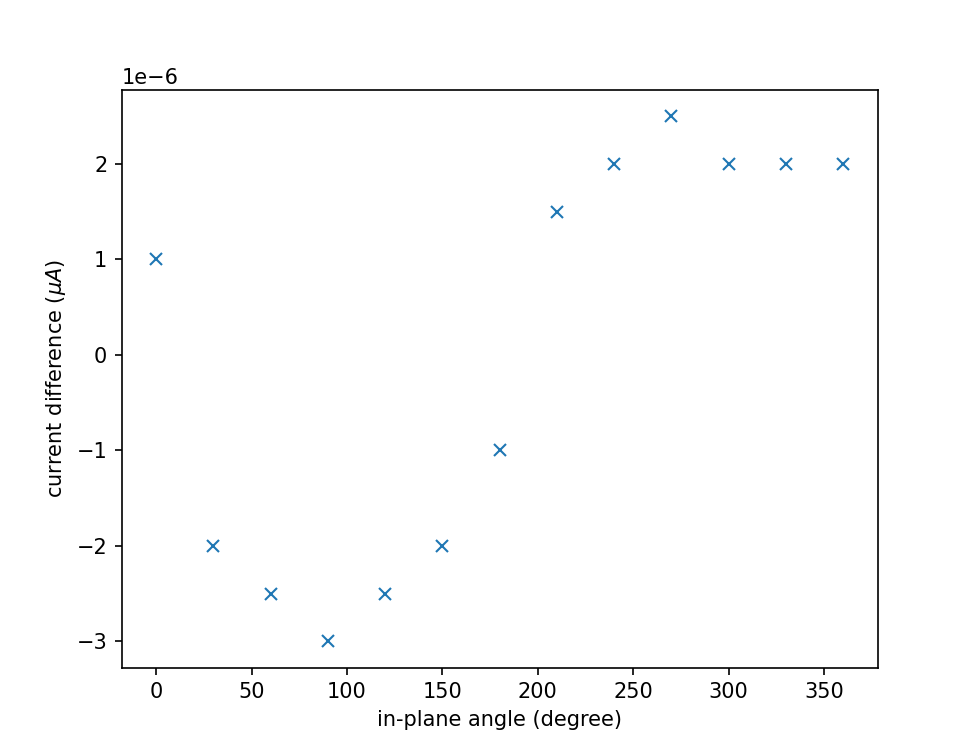

Text(0, 0.5, 'current difference ($\\mu A$)')

In [38]:
I_diff=np.zeros(13)
I_diff[0]=max(Is_diff_259[50:140], key=abs)
I_diff[1]=max(Is_diff_260[50:140], key=abs)
I_diff[2]=max(Is_diff_261[50:140], key=abs)
I_diff[3]=max(Is_diff_262[50:140], key=abs)
I_diff[4]=max(Is_diff_263[50:140], key=abs)
I_diff[5]=max(Is_diff_264[50:140], key=abs)
I_diff[6]=max(Is_diff_265[50:140], key=abs)
I_diff[7]=max(Is_diff_266[50:140], key=abs)
I_diff[8]=max(Is_diff_267[50:140], key=abs)
I_diff[9]=max(Is_diff_268[50:140], key=abs)
I_diff[10]=max(Is_diff_269[50:140], key=abs)
I_diff[11]=max(Is_diff_270[50:140], key=abs)
I_diff[12]=max(Is_diff_258[50:140], key=abs)

B_angle=np.linspace(0, 360, 13)
# print(B_angle)

fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,5))
fig.subplots_adjust(hspace=55)

plt.plot(B_angle, I_diff, 'x')

plt.xlabel('in-plane angle (degree)')
plt.ylabel('current difference ($\mu A$)')

## Run 271(R=40), 30, 20, 10, to 275 (R=0) @120 degree

### Run271 R=40

In [5]:
runid=271
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [6]:
By_271=By_field
I_271=I
V_271=V
R_271=R_DC1

np.savetxt('L01_271_By.csv', (By_271), fmt='%s', delimiter=',')
np.savetxt('L01_271_I.csv', (I_271), fmt='%s', delimiter=',')
np.savetxt('L01_271_V.csv', (V_271), fmt='%s', delimiter=',')
np.savetxt('L01_271_R.csv', (R_271), fmt='%s', delimiter=',')

In [35]:
By_271=np.loadtxt('L01_271_By.csv', delimiter=",")
I_271=np.loadtxt('L01_271_I.csv', delimiter=",")
V_271=np.loadtxt('L01_271_V.csv', delimiter=",")
R_271=np.loadtxt('L01_271_R.csv', delimiter=",")
# Is_271=np.loadtxt('Is_271.csv', delimiter=",")
# Ir_271=np.loadtxt('Ir_271.csv', delimiter=",")

<IPython.core.display.Javascript object>


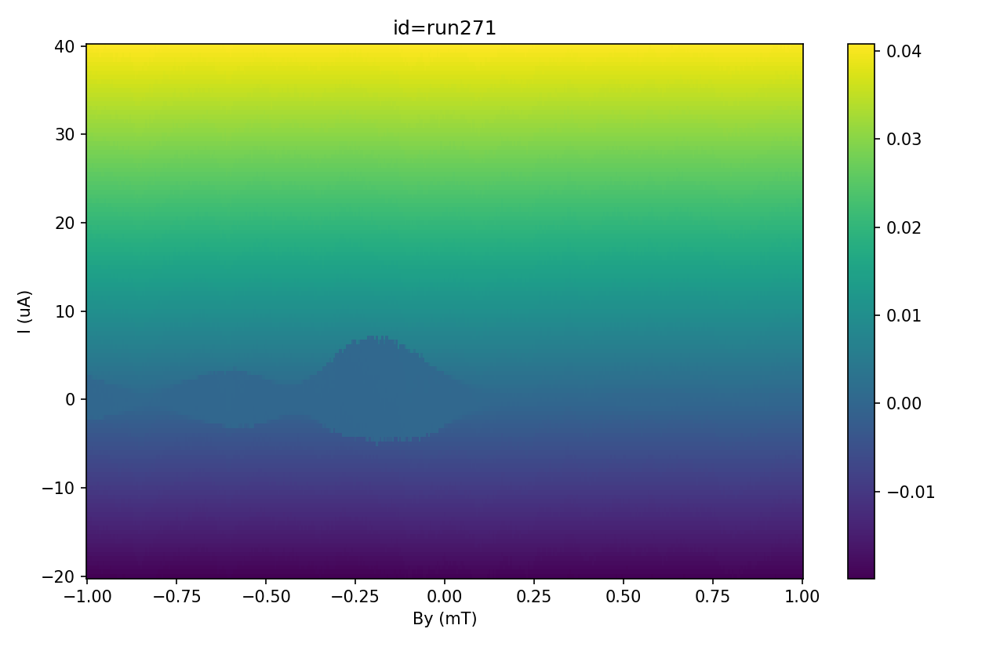

In [36]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_271/1e-3, I_271/1e-6, V_271/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run271')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [37]:
saiz=np.shape(V_271)
# print(saiz)
Is_271=np.zeros(saiz[0])
Ir_271=np.zeros(saiz[0])
fV_271=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_271)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_271[i,37:42])
        if V_271[i,j]-DCoff > 5e-7:
            Is_271[i]=I_271[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_271[i,37:42])
        if -V_271[i,j]-DCoff < 0.5e-6:
            Ir_271[i]=I_271[i,j]
            break


<IPython.core.display.Javascript object>


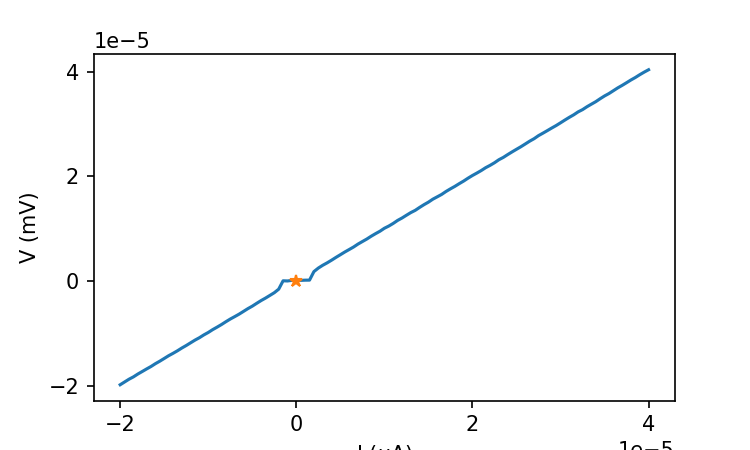

1.0920124399999998e-07


In [38]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_271[150,37:42])
plt.plot(I_271[10,:],V_271[10,:]-DCoff)
# plt.plot(V_271[10,:])
plt.plot(I_271[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


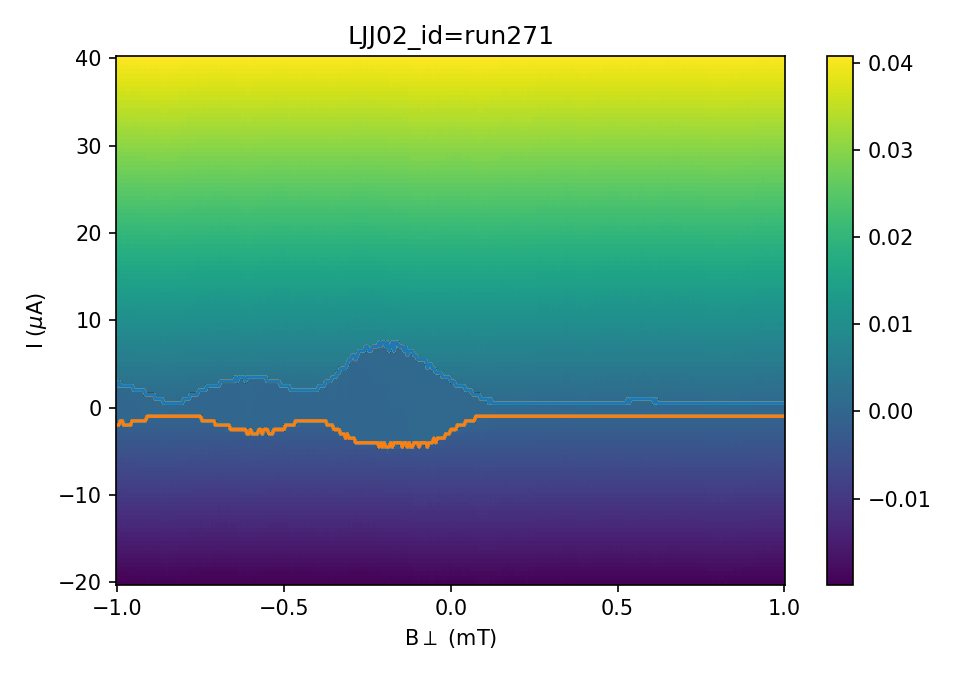

In [39]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_271[Arange:Brange,:]/1e-3, I_271[Arange:Brange,:]/1e-6, V_271[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_271/1e-3, I_271/1e-6, V_271/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_231/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run271')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_271[Arange:Brange,:]/1e-3,Is_271[Arange:Brange]/1e-6)
plt.plot(By_271[Arange:Brange,:]/1e-3,Ir_271[Arange:Brange]/1e-6)

np.savetxt('Is_271.csv', (Is_271), fmt='%s', delimiter=',')
np.savetxt('Ir_271.csv', (Ir_271), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>


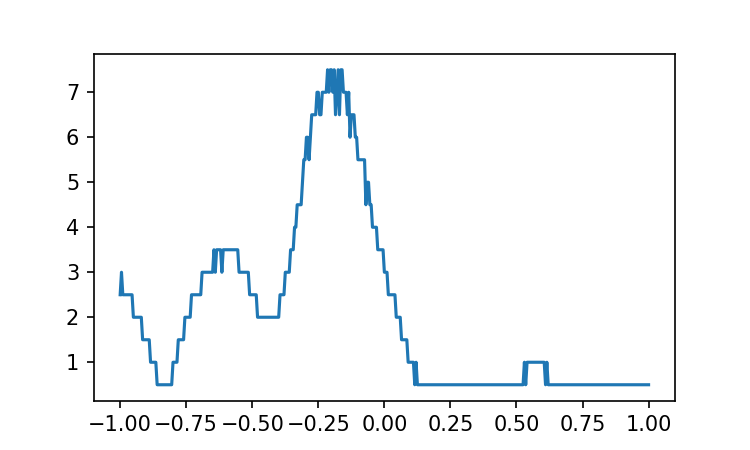

In [16]:
# By_211=np.loadtxt('L01_211_By.csv', delimiter=",")
# By_210=np.loadtxt('L01_210_By.csv', delimiter=",")
# Is_210=np.loadtxt('Is_210.csv', delimiter=",")
# Ir_211=np.loadtxt('Ir_211.csv', delimiter=",")
plt.figure(figsize=(5, 3))
plt.plot((By_271[:,1])/1e-3,Is_271[:]/1e-6)
# plt.plot(By_211[:,1]/1e-3,np.abs(Ir_211[:]/1e-6),'r')
# plt.plot(By_211[:,1]/1e-3,Ir_211[:]/1e-6,'r')

### Run272 R=30 mT

In [21]:
runid=272
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [22]:
By_272=By_field
I_272=I
V_272=V
R_272=R_DC1

np.savetxt('L01_272_By.csv', (By_272), fmt='%s', delimiter=',')
np.savetxt('L01_272_I.csv', (I_272), fmt='%s', delimiter=',')
np.savetxt('L01_272_V.csv', (V_272), fmt='%s', delimiter=',')
np.savetxt('L01_272_R.csv', (R_272), fmt='%s', delimiter=',')

In [40]:
By_272=np.loadtxt('L01_272_By.csv', delimiter=",")
I_272=np.loadtxt('L01_272_I.csv', delimiter=",")
V_272=np.loadtxt('L01_272_V.csv', delimiter=",")
R_272=np.loadtxt('L01_272_R.csv', delimiter=",")
# Is_272=np.loadtxt('Is_272.csv', delimiter=",")
# Ir_272=np.loadtxt('Ir_272.csv', delimiter=",")

<IPython.core.display.Javascript object>


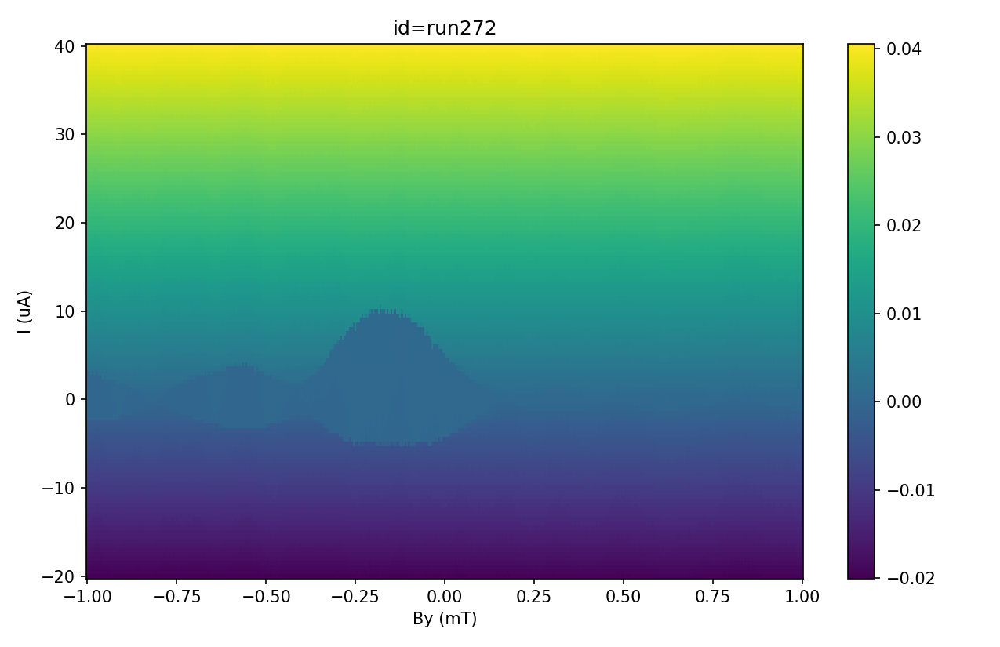

In [41]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_272/1e-3, I_272/1e-6, V_272/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run272')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [42]:
saiz=np.shape(V_272)
# print(saiz)
Is_272=np.zeros(saiz[0])
Ir_272=np.zeros(saiz[0])
fV_272=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_272)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_272[i,37:42])
        if V_272[i,j]-DCoff > 5e-7:
            Is_272[i]=I_272[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_272[i,37:42])
        if -V_272[i,j]-DCoff < 0.5e-6:
            Ir_272[i]=I_272[i,j]
            break


<IPython.core.display.Javascript object>


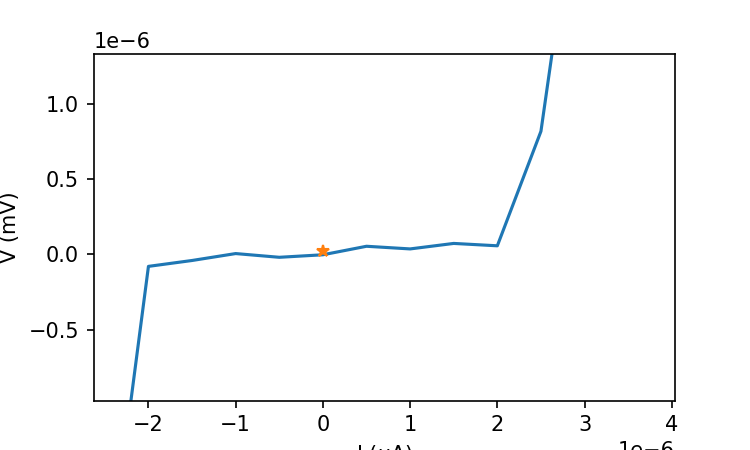

2.09225118e-08


In [26]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_272[10,37:42])
plt.plot(I_272[10,:],V_272[10,:]-DCoff)
# plt.plot(V_271[10,:])
plt.plot(I_272[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


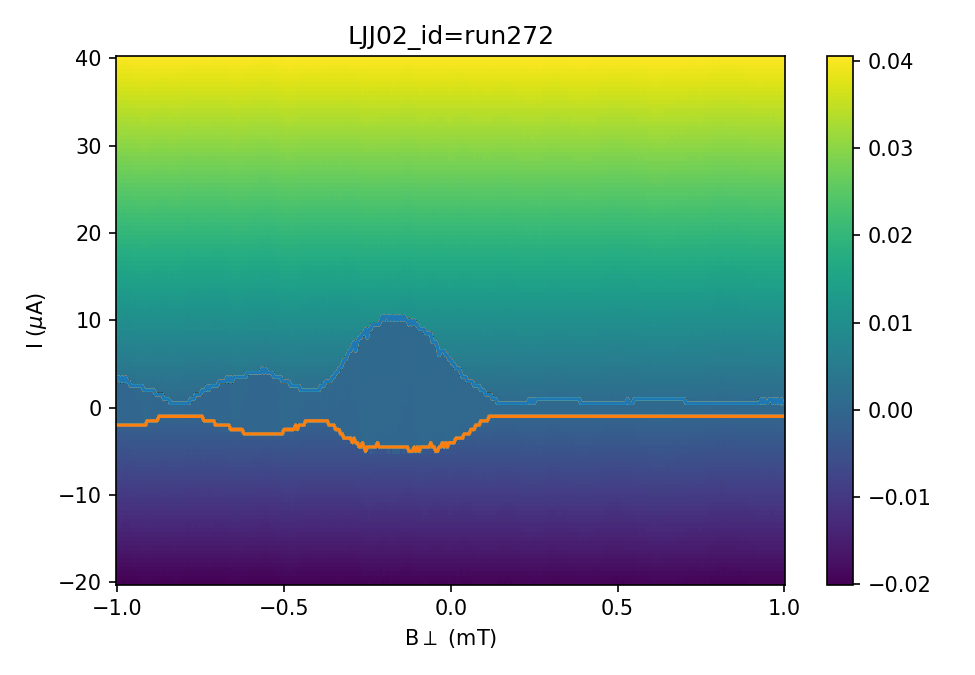

In [43]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_272[Arange:Brange,:]/1e-3, I_272[Arange:Brange,:]/1e-6, V_272[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_272/1e-3, I_272/1e-6, V_272/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_231/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run272')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_272[Arange:Brange,:]/1e-3,Is_272[Arange:Brange]/1e-6)
plt.plot(By_272[Arange:Brange,:]/1e-3,Ir_272[Arange:Brange]/1e-6)

np.savetxt('Is_272.csv', (Is_272), fmt='%s', delimiter=',')
np.savetxt('Ir_272.csv', (Ir_272), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run273 R=20 mT

In [28]:
runid=273
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [29]:
By_273=By_field
I_273=I
V_273=V
R_273=R_DC1

np.savetxt('L01_273_By.csv', (By_273), fmt='%s', delimiter=',')
np.savetxt('L01_273_I.csv', (I_273), fmt='%s', delimiter=',')
np.savetxt('L01_273_V.csv', (V_273), fmt='%s', delimiter=',')
np.savetxt('L01_273_R.csv', (R_273), fmt='%s', delimiter=',')

In [44]:
By_273=np.loadtxt('L01_273_By.csv', delimiter=",")
I_273=np.loadtxt('L01_273_I.csv', delimiter=",")
V_273=np.loadtxt('L01_273_V.csv', delimiter=",")
R_273=np.loadtxt('L01_273_R.csv', delimiter=",")
# Is_273=np.loadtxt('Is_273.csv', delimiter=",")
# Ir_273=np.loadtxt('Ir_273.csv', delimiter=",")

In [45]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_273/1e-3, I_273/1e-6, V_273/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run273')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

<IPython.core.display.Javascript object>

In [46]:
saiz=np.shape(V_273)
# print(saiz)
Is_273=np.zeros(saiz[0])
Ir_273=np.zeros(saiz[0])
fV_273=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_273)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_273[i,37:42])
        if V_273[i,j]-DCoff > 5e-7:
            Is_273[i]=I_273[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_273[i,37:42])
        if -V_273[i,j]-DCoff < 0.5e-6:
            Ir_273[i]=I_273[i,j]
            break


<IPython.core.display.Javascript object>


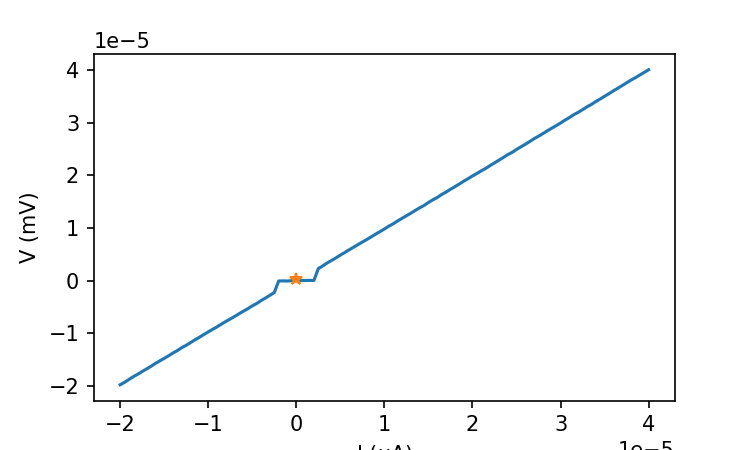

3.7104601999999994e-07


In [32]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_273[10,37:42])
plt.plot(I_273[10,:],V_273[10,:]-DCoff)
# plt.plot(V_271[10,:])
plt.plot(I_273[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


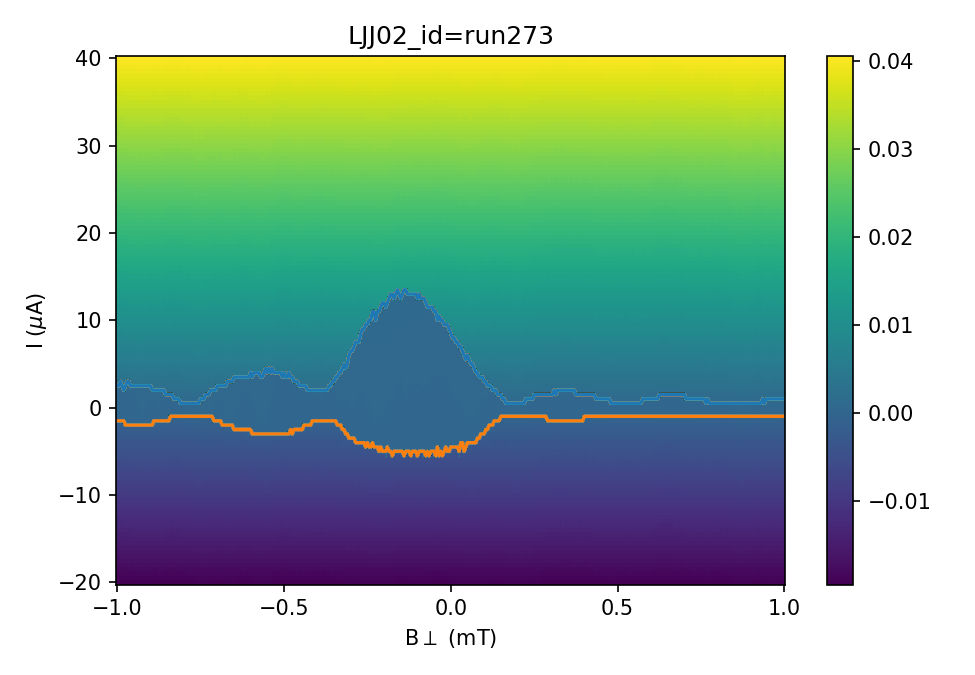

In [47]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_273[Arange:Brange,:]/1e-3, I_273[Arange:Brange,:]/1e-6, V_273[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_273/1e-3, I_273/1e-6, V_273/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_231/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run273')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_273[Arange:Brange,:]/1e-3,Is_273[Arange:Brange]/1e-6)
plt.plot(By_273[Arange:Brange,:]/1e-3,Ir_273[Arange:Brange]/1e-6)

np.savetxt('Is_273.csv', (Is_273), fmt='%s', delimiter=',')
np.savetxt('Ir_273.csv', (Ir_273), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run274 R=10 mT

In [34]:
runid=274
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [35]:
By_274=By_field
I_274=I
V_274=V
R_274=R_DC1

np.savetxt('L01_274_By.csv', (By_273), fmt='%s', delimiter=',')
np.savetxt('L01_274_I.csv', (I_273), fmt='%s', delimiter=',')
np.savetxt('L01_274_V.csv', (V_273), fmt='%s', delimiter=',')
np.savetxt('L01_274_R.csv', (R_273), fmt='%s', delimiter=',')

In [48]:
By_274=np.loadtxt('L01_274_By.csv', delimiter=",")
I_274=np.loadtxt('L01_274_I.csv', delimiter=",")
V_274=np.loadtxt('L01_274_V.csv', delimiter=",")
R_274=np.loadtxt('L01_274_R.csv', delimiter=",")
# Is_274=np.loadtxt('Is_274.csv', delimiter=",")
# Ir_274=np.loadtxt('Ir_274.csv', delimiter=",")

<IPython.core.display.Javascript object>


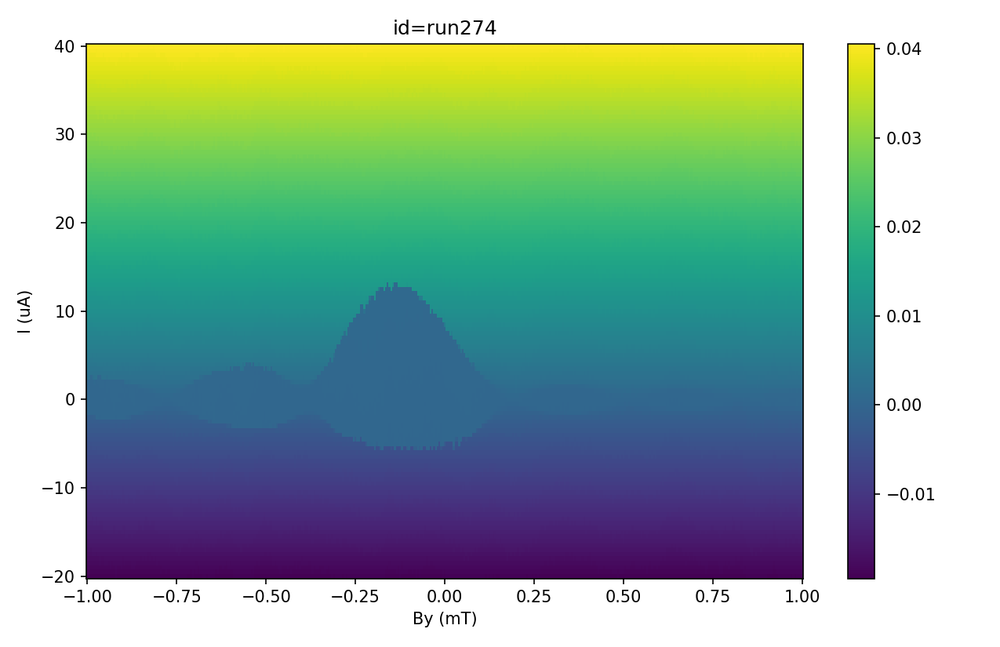

In [49]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_274/1e-3, I_274/1e-6, V_274/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run274')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [50]:
saiz=np.shape(V_274)
# print(saiz)
Is_274=np.zeros(saiz[0])
Ir_274=np.zeros(saiz[0])
fV_274=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_274)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_274[i,37:42])
        if V_274[i,j]-DCoff > 6e-7:
            Is_274[i]=I_274[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_274[i,37:42])
        if -V_274[i,j]-DCoff < 0.5e-6:
            Ir_274[i]=I_274[i,j]
            break


<IPython.core.display.Javascript object>


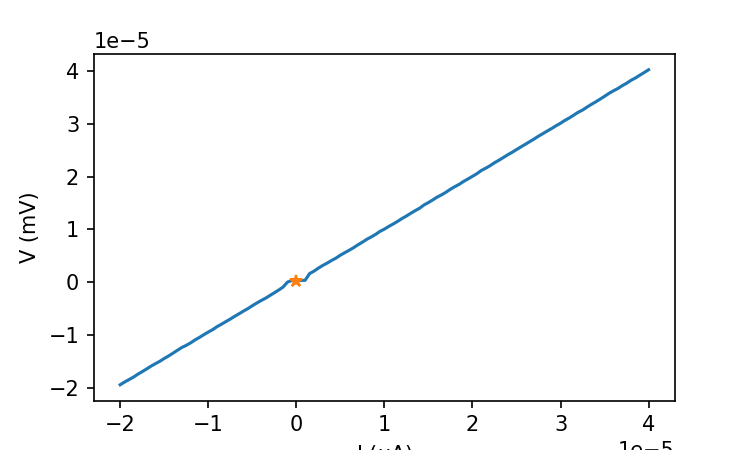

1.6732965999999996e-07


In [38]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_274[10,37:42])
plt.plot(I_274[10,:],V_274[10,:]-DCoff)
# plt.plot(V_274[10,:])
plt.plot(I_274[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


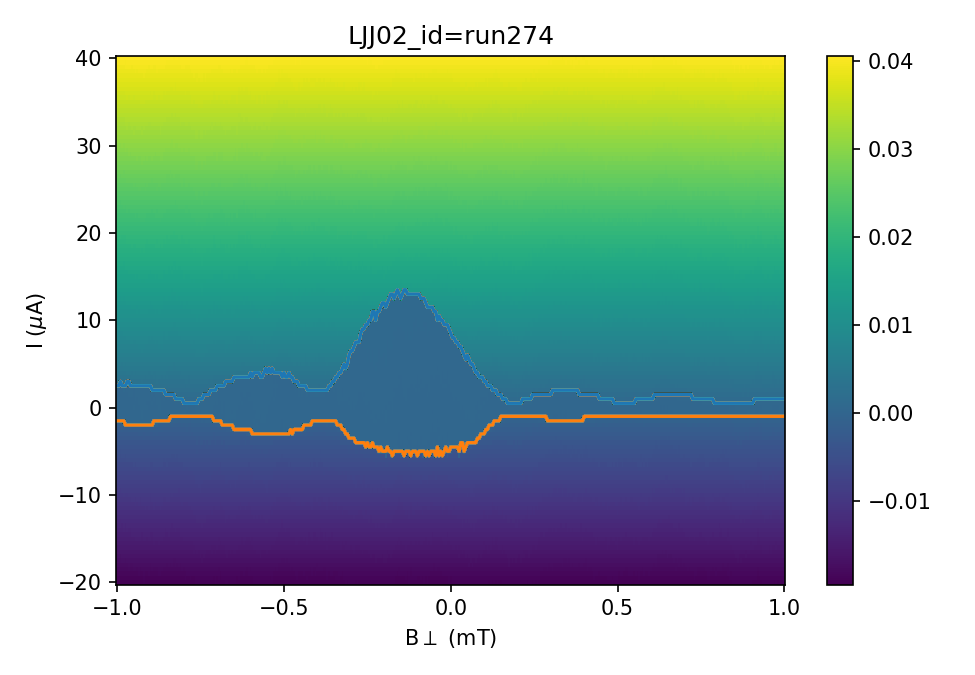

In [51]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_274[Arange:Brange,:]/1e-3, I_274[Arange:Brange,:]/1e-6, V_274[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_274/1e-3, I_274/1e-6, V_274/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_231/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run274')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_274[Arange:Brange,:]/1e-3,Is_274[Arange:Brange]/1e-6)
plt.plot(By_274[Arange:Brange,:]/1e-3,Ir_274[Arange:Brange]/1e-6)

np.savetxt('Is_274.csv', (Is_274), fmt='%s', delimiter=',')
np.savetxt('Ir_274.csv', (Ir_274), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run275 R=0 mT

In [44]:
runid=275
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [45]:
By_275=By_field
I_275=I
V_275=V
R_275=R_DC1

np.savetxt('L01_275_By.csv', (By_275), fmt='%s', delimiter=',')
np.savetxt('L01_275_I.csv', (I_275), fmt='%s', delimiter=',')
np.savetxt('L01_275_V.csv', (V_275), fmt='%s', delimiter=',')
np.savetxt('L01_275_R.csv', (R_275), fmt='%s', delimiter=',')

In [52]:
By_275=np.loadtxt('L01_275_By.csv', delimiter=",")
I_275=np.loadtxt('L01_275_I.csv', delimiter=",")
V_275=np.loadtxt('L01_275_V.csv', delimiter=",")
R_275=np.loadtxt('L01_275_R.csv', delimiter=",")
# Is_275=np.loadtxt('Is_275.csv', delimiter=",")
# Ir_275=np.loadtxt('Ir_275.csv', delimiter=",")

<IPython.core.display.Javascript object>


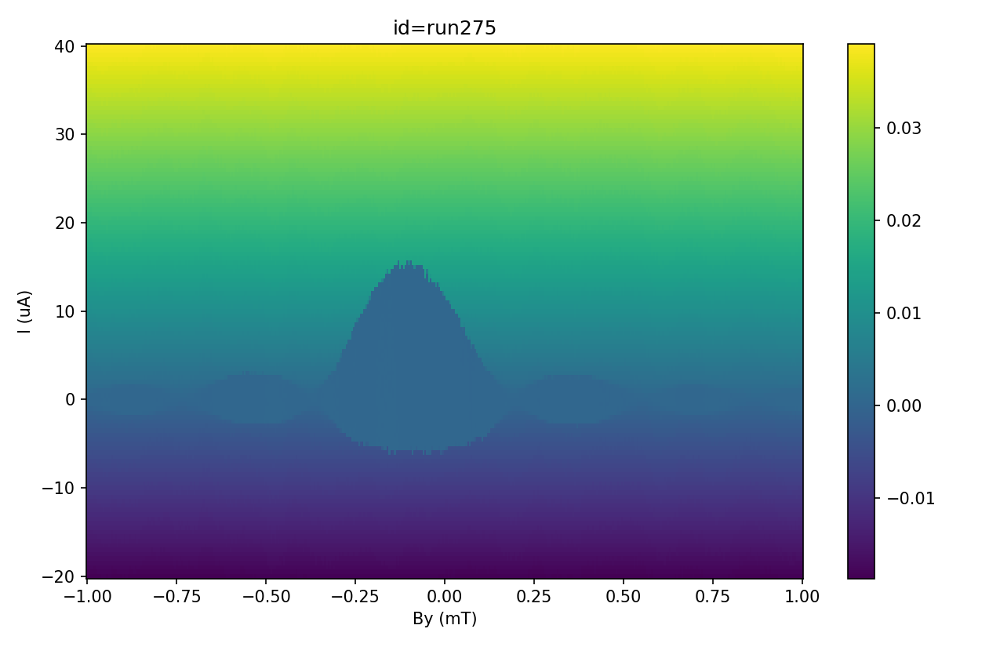

In [53]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_275/1e-3, I_275/1e-6, V_275/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run275')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [54]:
saiz=np.shape(V_275)
# print(saiz)
Is_275=np.zeros(saiz[0])
Ir_275=np.zeros(saiz[0])
fV_275=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_275)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_275[i,37:42])
        if V_275[i,j]-DCoff > 6e-7:
            Is_275[i]=I_275[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_275[i,37:42])
        if -V_275[i,j]-DCoff < 0.5e-6:
            Ir_275[i]=I_275[i,j]
            break


<IPython.core.display.Javascript object>


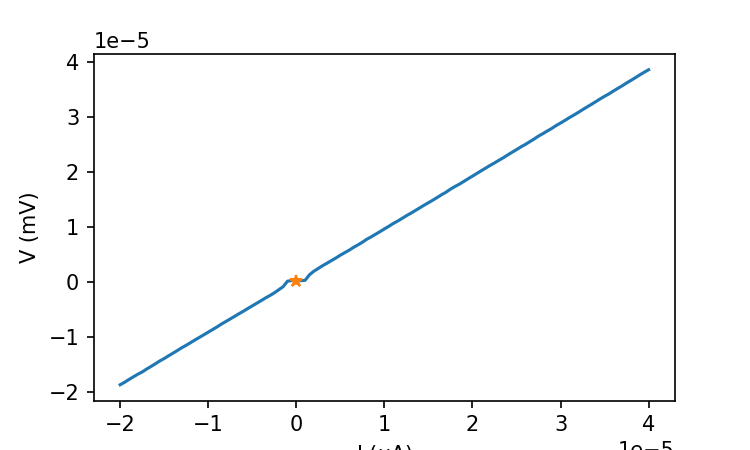

2.3624078e-07


In [48]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_275[10,37:42])
plt.plot(I_275[10,:],V_275[10,:]-DCoff)
# plt.plot(V_275[10,:])
plt.plot(I_275[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


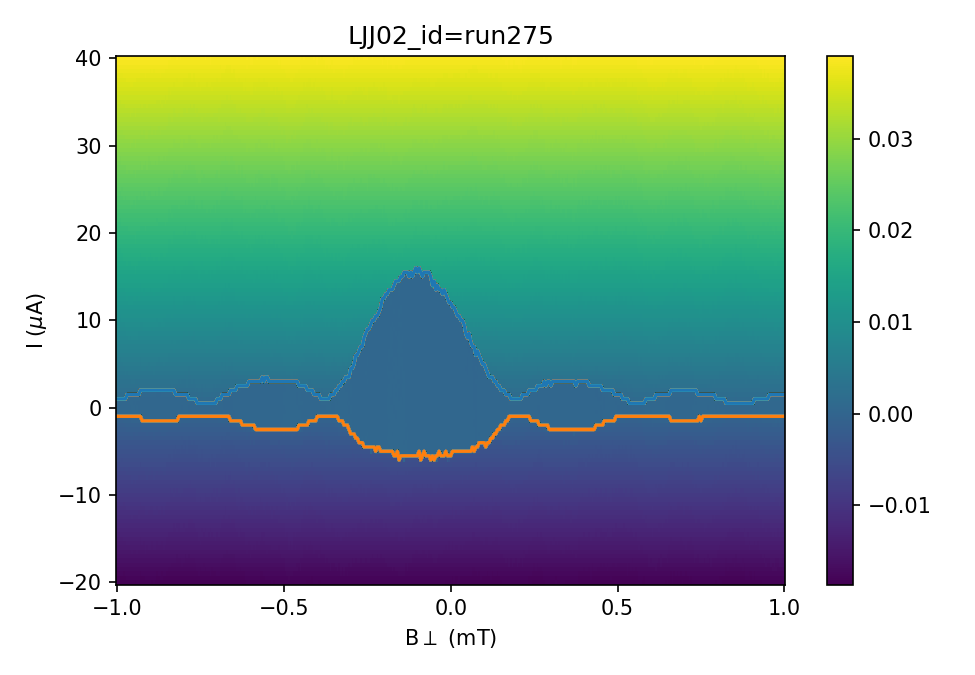

In [55]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_275[Arange:Brange,:]/1e-3, I_275[Arange:Brange,:]/1e-6, V_275[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_275/1e-3, I_275/1e-6, V_275/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_231/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run275')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_275[Arange:Brange,:]/1e-3,Is_275[Arange:Brange]/1e-6)
plt.plot(By_275[Arange:Brange,:]/1e-3,Ir_275[Arange:Brange]/1e-6)

np.savetxt('Is_275.csv', (Is_275), fmt='%s', delimiter=',')
np.savetxt('Ir_275.csv', (Ir_275), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run 271 to 275 comparison

<IPython.core.display.Javascript object>


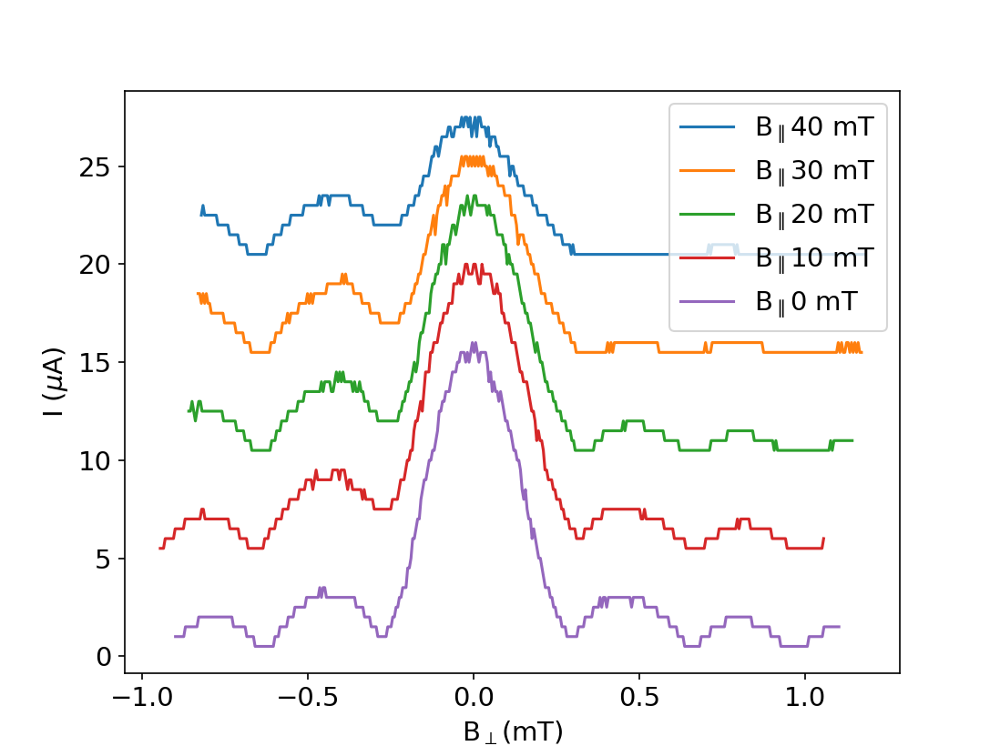

In [57]:
# By_218=np.loadtxt('L01_218_By.csv', delimiter=",")
# By_219=np.loadtxt('L01_219_By.csv', delimiter=",")
# Is_218=np.loadtxt('Is_218.csv', delimiter=",")
# Ir_219=np.loadtxt('Ir_219.csv', delimiter=",")
plt.figure(figsize=(5, 3))
# x=np.linspace(0,400,401)
plt.plot(By_271[:,1]/1e-3+0.179,Is_271[:]/1e-6+20,label='B$_{\parallel}$40 mT')
plt.plot(By_272[:,1]/1e-3+0.169,Is_272[:]/1e-6+15,label='B$_{\parallel}$30 mT')
plt.plot(By_273[:,1]/1e-3+0.141,Is_273[:]/1e-6+10,label='B$_{\parallel}$20 mT')
plt.plot(By_274[:,1]/1e-3+0.055,Is_274[:]/1e-6+5,label='B$_{\parallel}$10 mT')
plt.plot(By_275[:,1]/1e-3+0.101,Is_275[:]/1e-6+0,label='B$_{\parallel}$0 mT')
# plt.plot(By_272[:,1]/1e-3,Is_272[:]/1e-6)
# plt.plot(By_219[:,1]/1e-3+0.165,Ir_219[:]/1e-6,'-r')
plt.rcParams.update({'font.size': 14})
# plt.plot(((x-11)*6e-6+By_218[0,1])/1e-3,Is_218[:]/1e-6)
# plt.plot((-x*6e-6+By_219[0,1])/1e-3,np.abs(Ir_219[:]/1e-6),'-b')

# plt.plot(I_218[211,40:121]/1e-6,(V_218[211,40:121]-V_218[211,40])/1e-3)
# plt.plot(-(I_219[200,40:121])/1e-6,np.abs(V_219[200,40:121]-V_219[200,40])/1e-3)
plt.xlabel('B$_\perp$(mT)')
plt.ylabel('I ($\mu$A)')
plt.legend(loc='upper right')

## Run 276 (R=-10), -20, -30, -40 to 279(R=-40)

### Run276 R=-10 mT

In [6]:
runid=276
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [7]:
By_276=By_field
I_276=I
V_276=V
R_276=R_DC1

np.savetxt('L01_276_By.csv', (By_276), fmt='%s', delimiter=',')
np.savetxt('L01_276_I.csv', (I_276), fmt='%s', delimiter=',')
np.savetxt('L01_276_V.csv', (V_276), fmt='%s', delimiter=',')
np.savetxt('L01_276_R.csv', (R_276), fmt='%s', delimiter=',')

In [5]:
By_276=np.loadtxt('L01_276_By.csv', delimiter=",")
I_276=np.loadtxt('L01_276_I.csv', delimiter=",")
V_276=np.loadtxt('L01_276_V.csv', delimiter=",")
R_276=np.loadtxt('L01_276_R.csv', delimiter=",")
Is_276=np.loadtxt('Is_276.csv', delimiter=",")
Ir_276=np.loadtxt('Ir_276.csv', delimiter=",")

<IPython.core.display.Javascript object>


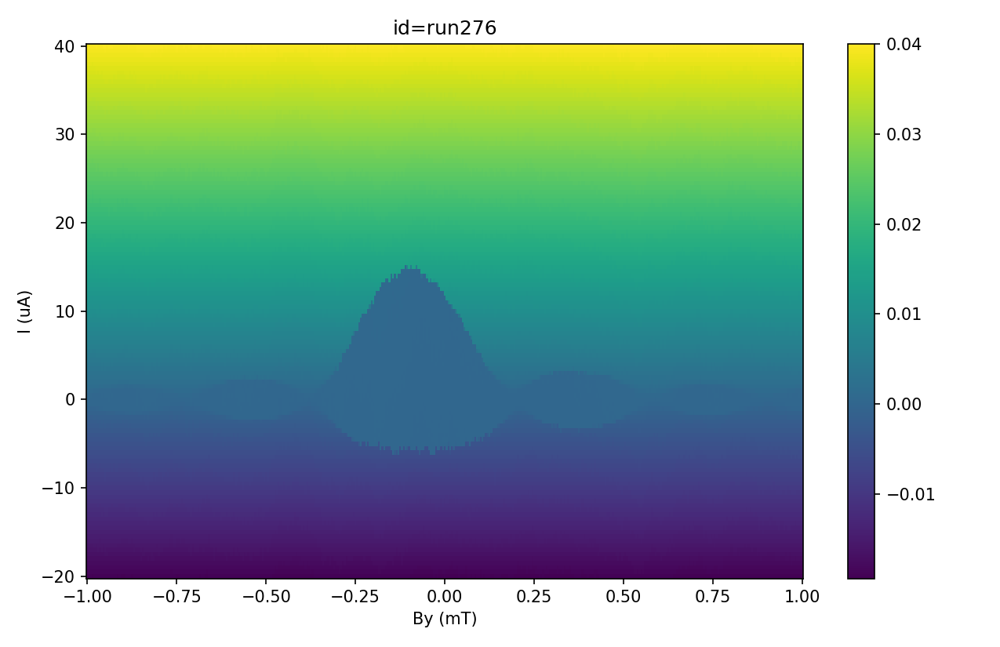

In [9]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_276/1e-3, I_276/1e-6, V_276/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run276')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [10]:
saiz=np.shape(V_276)
# print(saiz)
Is_276=np.zeros(saiz[0])
Ir_276=np.zeros(saiz[0])
fV_276=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_276)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_276[i,37:42])
        if V_276[i,j]-DCoff > 6e-7:
            Is_276[i]=I_276[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_276[i,37:42])
        if -V_276[i,j]-DCoff < 0.5e-6:
            Ir_276[i]=I_276[i,j]
            break


<IPython.core.display.Javascript object>


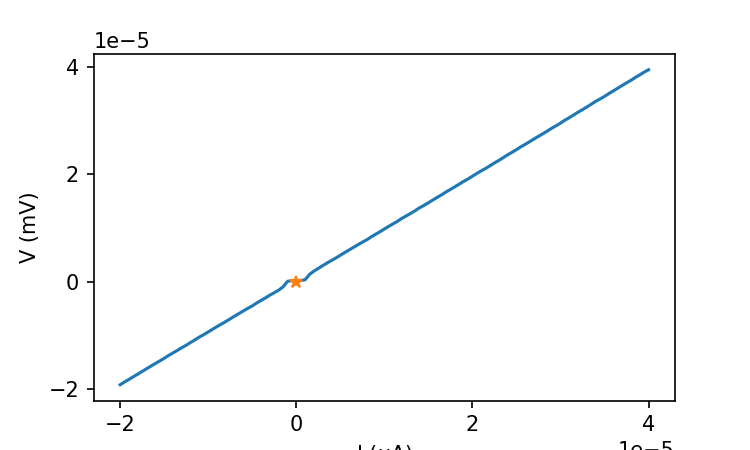

6.719675999999999e-08


In [11]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_276[10,37:42])
plt.plot(I_276[10,:],V_276[10,:]-DCoff)
# plt.plot(V_276[10,:])
plt.plot(I_276[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


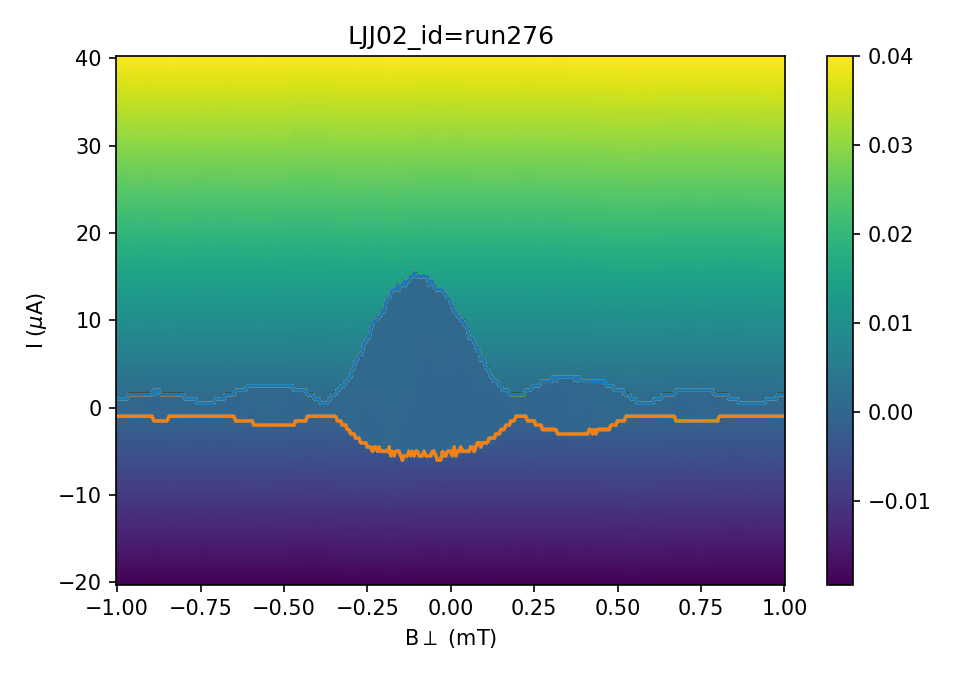

In [12]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_276[Arange:Brange,:]/1e-3, I_276[Arange:Brange,:]/1e-6, V_276[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_276/1e-3, I_276/1e-6, V_276/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_276/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run276')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_276[Arange:Brange,:]/1e-3,Is_276[Arange:Brange]/1e-6)
plt.plot(By_276[Arange:Brange,:]/1e-3,Ir_276[Arange:Brange]/1e-6)

np.savetxt('Is_276.csv', (Is_276), fmt='%s', delimiter=',')
np.savetxt('Ir_276.csv', (Ir_276), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run277 R=-20 mT

In [13]:
runid=277
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [14]:
By_277=By_field
I_277=I
V_277=V
R_277=R_DC1

np.savetxt('L01_277_By.csv', (By_277), fmt='%s', delimiter=',')
np.savetxt('L01_277_I.csv', (I_277), fmt='%s', delimiter=',')
np.savetxt('L01_277_V.csv', (V_277), fmt='%s', delimiter=',')
np.savetxt('L01_277_R.csv', (R_277), fmt='%s', delimiter=',')

In [5]:
By_277=np.loadtxt('L01_277_By.csv', delimiter=",")
I_277=np.loadtxt('L01_277_I.csv', delimiter=",")
V_277=np.loadtxt('L01_277_V.csv', delimiter=",")
R_277=np.loadtxt('L01_277_R.csv', delimiter=",")
Is_277=np.loadtxt('Is_277.csv', delimiter=",")
Ir_277=np.loadtxt('Ir_277.csv', delimiter=",")

<IPython.core.display.Javascript object>


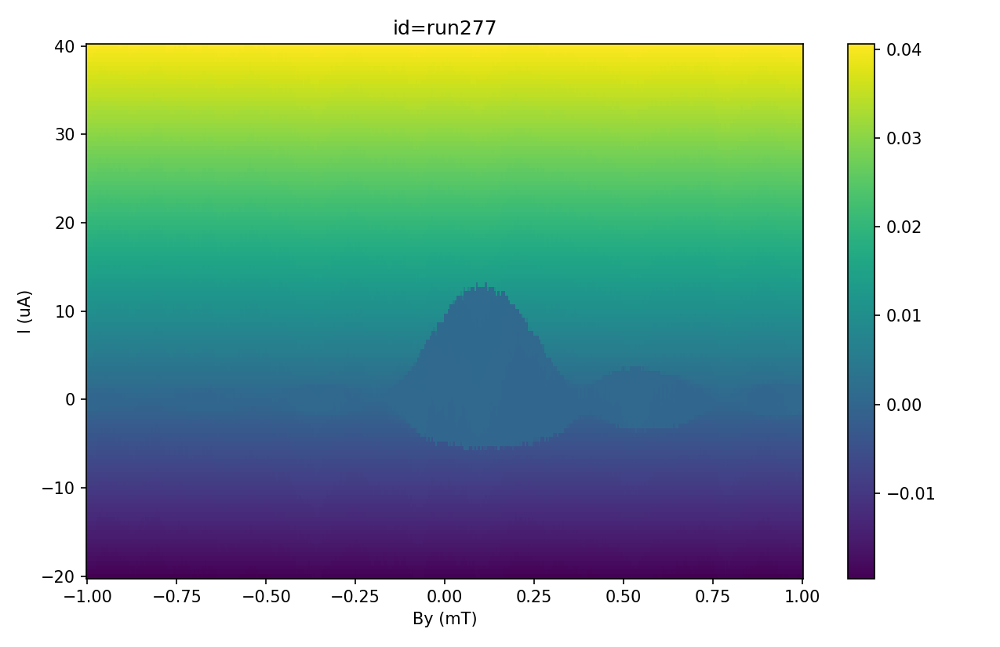

In [15]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_277/1e-3, I_277/1e-6, V_277/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run277')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [17]:
saiz=np.shape(V_277)
# print(saiz)
Is_277=np.zeros(saiz[0])
Ir_277=np.zeros(saiz[0])
fV_277=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_277)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_277[i,37:42])
        if V_277[i,j]-DCoff > 6e-7:
            Is_277[i]=I_277[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_277[i,37:42])
        if -V_277[i,j]-DCoff < 0.5e-6:
            Ir_277[i]=I_277[i,j]
            break


<IPython.core.display.Javascript object>


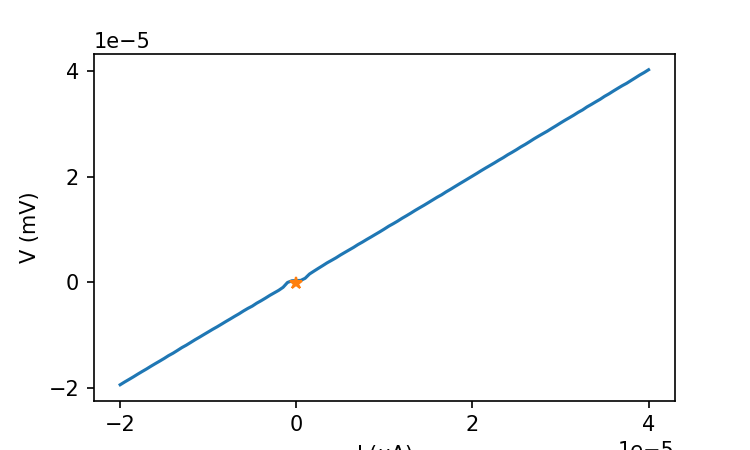

-1.7116482e-07


In [16]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_277[10,37:42])
plt.plot(I_277[10,:],V_277[10,:]-DCoff)
# plt.plot(V_277[10,:])
plt.plot(I_277[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


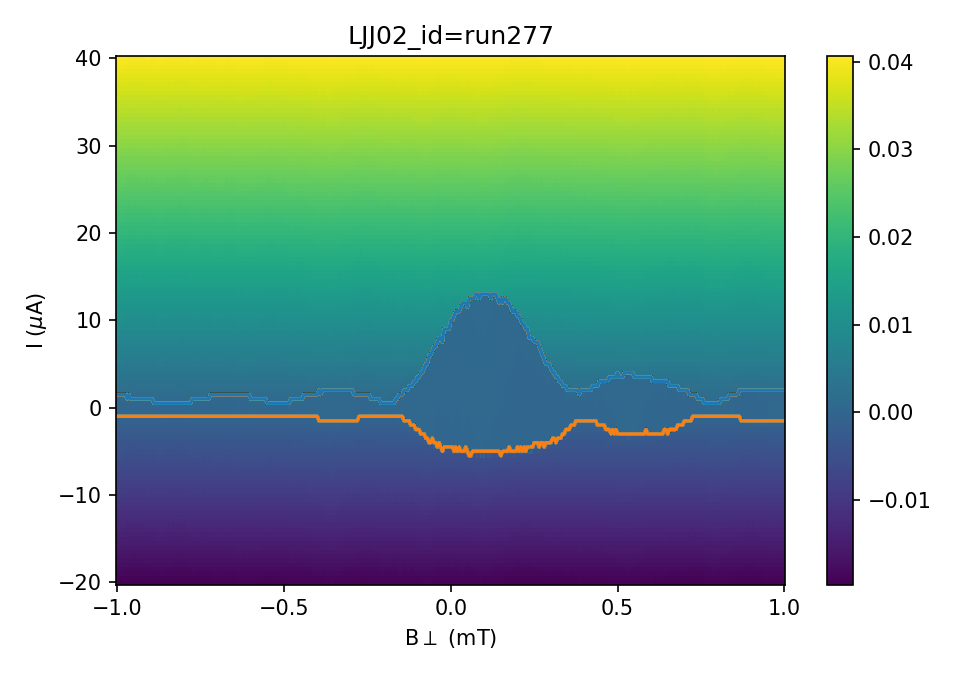

In [18]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_277[Arange:Brange,:]/1e-3, I_277[Arange:Brange,:]/1e-6, V_277[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_277/1e-3, I_277/1e-6, V_277/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_277/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run277')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_277[Arange:Brange,:]/1e-3,Is_277[Arange:Brange]/1e-6)
plt.plot(By_277[Arange:Brange,:]/1e-3,Ir_277[Arange:Brange]/1e-6)

np.savetxt('Is_277.csv', (Is_277), fmt='%s', delimiter=',')
np.savetxt('Ir_277.csv', (Ir_277), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run278 R=-30 mT

In [20]:
runid=278
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [21]:
By_278=By_field
I_278=I
V_278=V
R_278=R_DC1

np.savetxt('L01_278_By.csv', (By_278), fmt='%s', delimiter=',')
np.savetxt('L01_278_I.csv', (I_278), fmt='%s', delimiter=',')
np.savetxt('L01_278_V.csv', (V_278), fmt='%s', delimiter=',')
np.savetxt('L01_278_R.csv', (R_278), fmt='%s', delimiter=',')

In [5]:
By_278=np.loadtxt('L01_278_By.csv', delimiter=",")
I_278=np.loadtxt('L01_278_I.csv', delimiter=",")
V_278=np.loadtxt('L01_278_V.csv', delimiter=",")
R_278=np.loadtxt('L01_278_R.csv', delimiter=",")
Is_278=np.loadtxt('Is_278.csv', delimiter=",")
Ir_278=np.loadtxt('Ir_278.csv', delimiter=",")

<IPython.core.display.Javascript object>


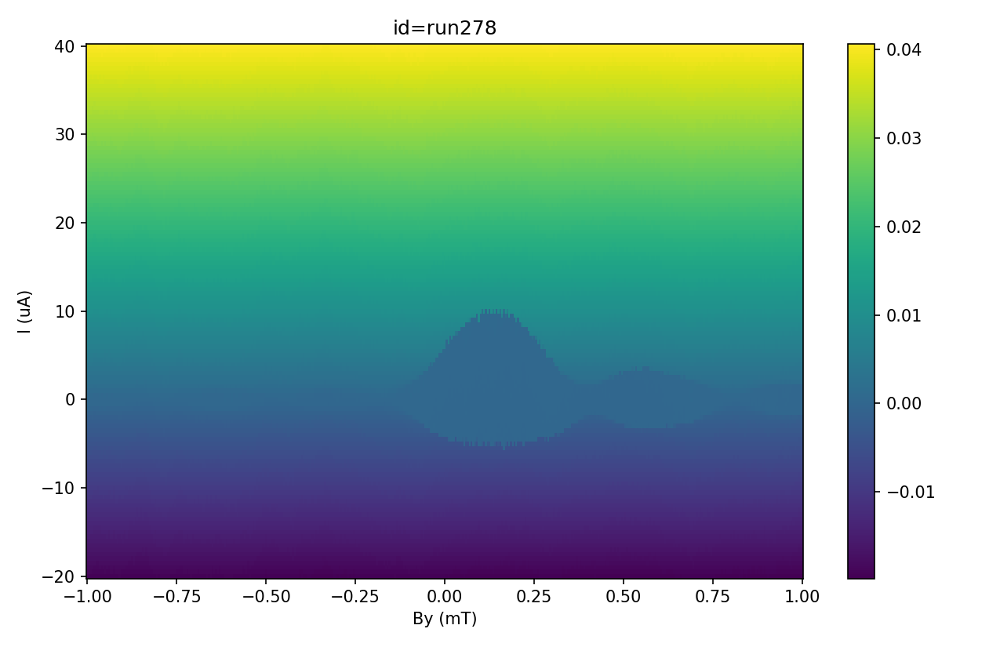

In [22]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_278/1e-3, I_278/1e-6, V_278/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run278')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [23]:
saiz=np.shape(V_278)
# print(saiz)
Is_278=np.zeros(saiz[0])
Ir_278=np.zeros(saiz[0])
fV_278=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_278)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_278[i,37:42])
        if V_278[i,j]-DCoff > 6e-7:
            Is_278[i]=I_278[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_278[i,37:42])
        if -V_278[i,j]-DCoff < 0.5e-6:
            Ir_278[i]=I_278[i,j]
            break


<IPython.core.display.Javascript object>


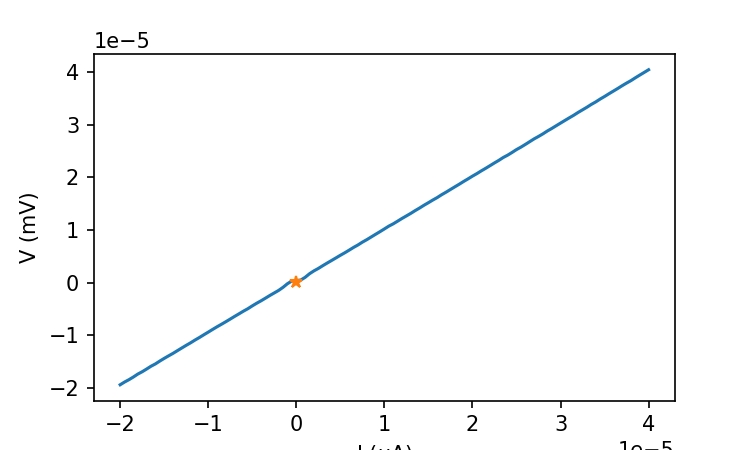

5.997648e-08


In [24]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_278[10,37:42])
plt.plot(I_278[10,:],V_278[10,:]-DCoff)
# plt.plot(V_278[10,:])
plt.plot(I_278[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


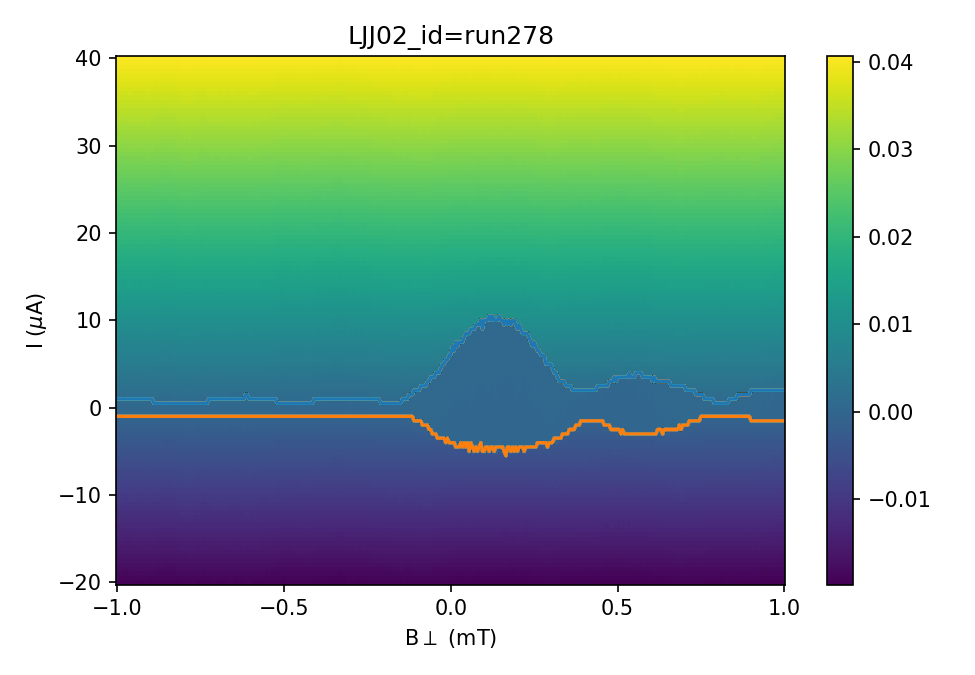

In [26]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_278[Arange:Brange,:]/1e-3, I_278[Arange:Brange,:]/1e-6, V_278[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_278/1e-3, I_278/1e-6, V_278/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_278/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run278')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_278[Arange:Brange,:]/1e-3,Is_278[Arange:Brange]/1e-6)
plt.plot(By_278[Arange:Brange,:]/1e-3,Ir_278[Arange:Brange]/1e-6)

np.savetxt('Is_278.csv', (Is_278), fmt='%s', delimiter=',')
np.savetxt('Ir_278.csv', (Ir_278), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run279 R=-40 mT

In [27]:
runid=279
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [28]:
By_279=By_field
I_279=I
V_279=V
R_279=R_DC1

np.savetxt('L01_279_By.csv', (By_279), fmt='%s', delimiter=',')
np.savetxt('L01_279_I.csv', (I_279), fmt='%s', delimiter=',')
np.savetxt('L01_279_V.csv', (V_279), fmt='%s', delimiter=',')
np.savetxt('L01_279_R.csv', (R_279), fmt='%s', delimiter=',')

In [5]:
By_279=np.loadtxt('L01_279_By.csv', delimiter=",")
I_279=np.loadtxt('L01_279_I.csv', delimiter=",")
V_279=np.loadtxt('L01_279_V.csv', delimiter=",")
R_279=np.loadtxt('L01_279_R.csv', delimiter=",")
Is_279=np.loadtxt('Is_279.csv', delimiter=",")
Ir_279=np.loadtxt('Ir_279.csv', delimiter=",")

<IPython.core.display.Javascript object>


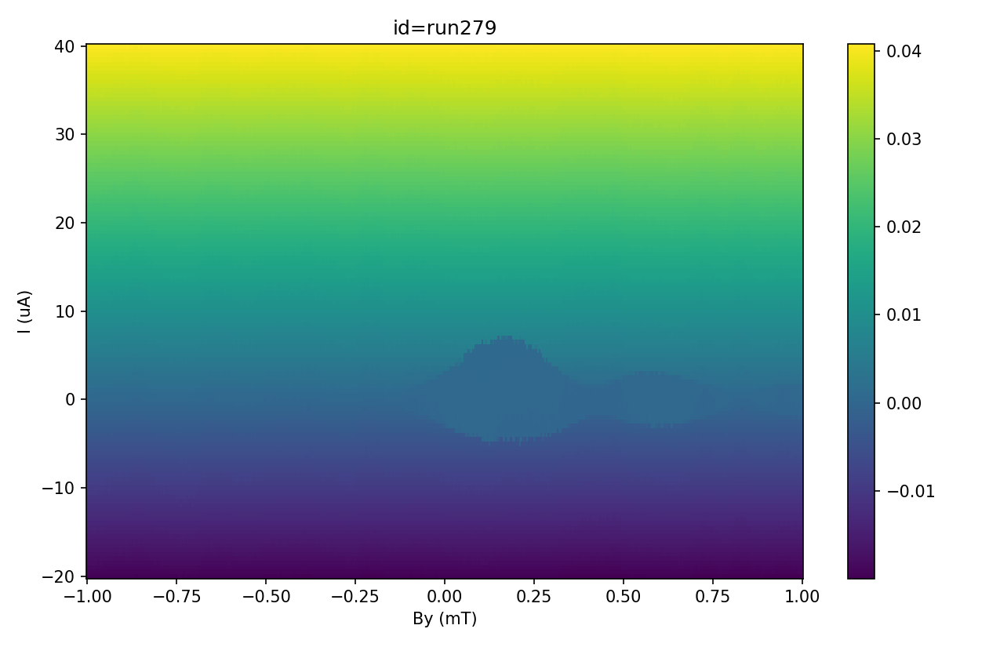

In [29]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_279/1e-3, I_279/1e-6, V_279/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run279')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [30]:
saiz=np.shape(V_279)
# print(saiz)
Is_279=np.zeros(saiz[0])
Ir_279=np.zeros(saiz[0])
fV_279=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_279)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_279[i,37:42])
        if V_279[i,j]-DCoff > 6e-7:
            Is_279[i]=I_279[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_279[i,37:42])
        if -V_279[i,j]-DCoff < 0.5e-6:
            Ir_279[i]=I_279[i,j]
            break


<IPython.core.display.Javascript object>


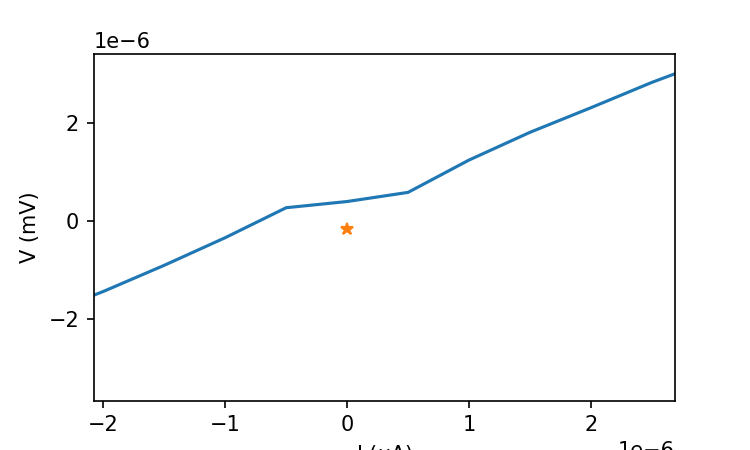

-1.590039e-07


In [31]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_279[10,37:42])
plt.plot(I_279[10,:],V_279[10,:]-DCoff)
# plt.plot(V_279[10,:])
plt.plot(I_279[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


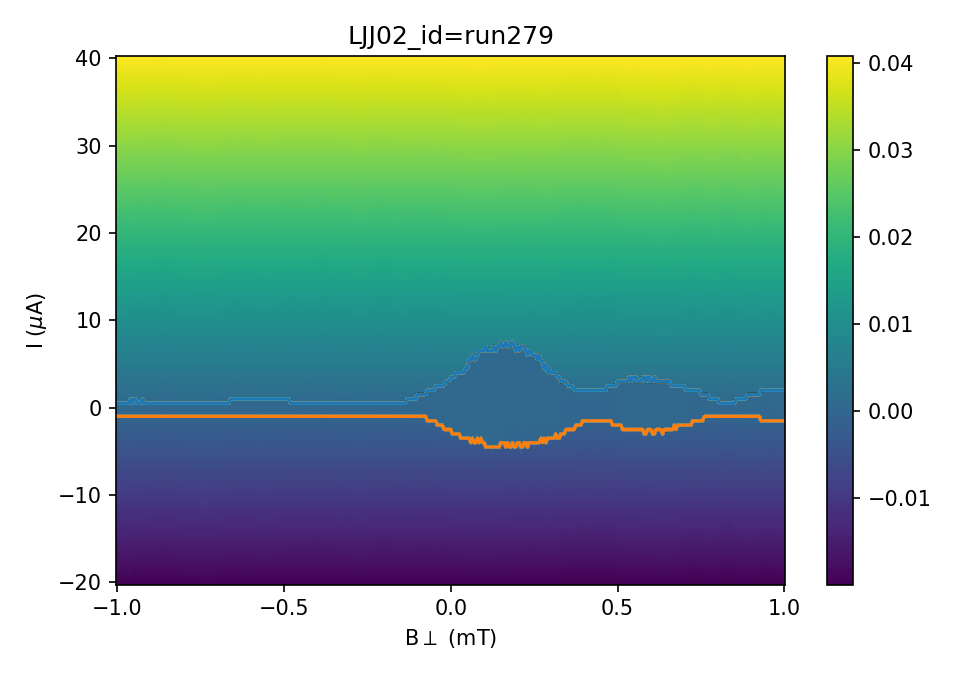

In [32]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_279[Arange:Brange,:]/1e-3, I_279[Arange:Brange,:]/1e-6, V_279[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_279/1e-3, I_279/1e-6, V_279/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_279/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run279')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_279[Arange:Brange,:]/1e-3,Is_279[Arange:Brange]/1e-6)
plt.plot(By_279[Arange:Brange,:]/1e-3,Ir_279[Arange:Brange]/1e-6)

np.savetxt('Is_279.csv', (Is_279), fmt='%s', delimiter=',')
np.savetxt('Ir_279.csv', (Ir_279), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run 271 to 279 comparison

In [21]:
By_271=np.loadtxt('L01_271_By.csv', delimiter=",")
I_271=np.loadtxt('L01_271_I.csv', delimiter=",")
V_271=np.loadtxt('L01_271_V.csv', delimiter=",")
R_271=np.loadtxt('L01_271_R.csv', delimiter=",")
Is_271=np.loadtxt('Is_271.csv', delimiter=",")
Ir_271=np.loadtxt('Ir_271.csv', delimiter=",")

By_272=np.loadtxt('L01_272_By.csv', delimiter=",")
I_272=np.loadtxt('L01_272_I.csv', delimiter=",")
V_272=np.loadtxt('L01_272_V.csv', delimiter=",")
R_272=np.loadtxt('L01_272_R.csv', delimiter=",")
Is_272=np.loadtxt('Is_272.csv', delimiter=",")
Ir_272=np.loadtxt('Ir_272.csv', delimiter=",")

By_273=np.loadtxt('L01_273_By.csv', delimiter=",")
I_273=np.loadtxt('L01_273_I.csv', delimiter=",")
V_273=np.loadtxt('L01_273_V.csv', delimiter=",")
R_273=np.loadtxt('L01_273_R.csv', delimiter=",")
Is_273=np.loadtxt('Is_273.csv', delimiter=",")
Ir_273=np.loadtxt('Ir_273.csv', delimiter=",")

By_274=np.loadtxt('L01_274_By.csv', delimiter=",")
I_274=np.loadtxt('L01_274_I.csv', delimiter=",")
V_274=np.loadtxt('L01_274_V.csv', delimiter=",")
R_274=np.loadtxt('L01_274_R.csv', delimiter=",")
Is_274=np.loadtxt('Is_274.csv', delimiter=",")
Ir_274=np.loadtxt('Ir_274.csv', delimiter=",")

By_275=np.loadtxt('L01_275_By.csv', delimiter=",")
I_275=np.loadtxt('L01_275_I.csv', delimiter=",")
V_275=np.loadtxt('L01_275_V.csv', delimiter=",")
R_275=np.loadtxt('L01_275_R.csv', delimiter=",")
Is_275=np.loadtxt('Is_275.csv', delimiter=",")
Ir_275=np.loadtxt('Ir_275.csv', delimiter=",")

By_276=np.loadtxt('L01_276_By.csv', delimiter=",")
I_276=np.loadtxt('L01_276_I.csv', delimiter=",")
V_276=np.loadtxt('L01_276_V.csv', delimiter=",")
R_276=np.loadtxt('L01_276_R.csv', delimiter=",")
Is_276=np.loadtxt('Is_276.csv', delimiter=",")
Ir_276=np.loadtxt('Ir_276.csv', delimiter=",")

By_277=np.loadtxt('L01_277_By.csv', delimiter=",")
I_277=np.loadtxt('L01_277_I.csv', delimiter=",")
V_277=np.loadtxt('L01_277_V.csv', delimiter=",")
R_277=np.loadtxt('L01_277_R.csv', delimiter=",")
Is_277=np.loadtxt('Is_277.csv', delimiter=",")
Ir_277=np.loadtxt('Ir_277.csv', delimiter=",")

By_278=np.loadtxt('L01_278_By.csv', delimiter=",")
I_278=np.loadtxt('L01_278_I.csv', delimiter=",")
V_278=np.loadtxt('L01_278_V.csv', delimiter=",")
R_278=np.loadtxt('L01_278_R.csv', delimiter=",")
Is_278=np.loadtxt('Is_278.csv', delimiter=",")
Ir_278=np.loadtxt('Ir_278.csv', delimiter=",")

By_279=np.loadtxt('L01_279_By.csv', delimiter=",")
I_279=np.loadtxt('L01_279_I.csv', delimiter=",")
V_279=np.loadtxt('L01_279_V.csv', delimiter=",")
R_279=np.loadtxt('L01_279_R.csv', delimiter=",")
Is_279=np.loadtxt('Is_279.csv', delimiter=",")
Ir_279=np.loadtxt('Ir_279.csv', delimiter=",")

<IPython.core.display.Javascript object>


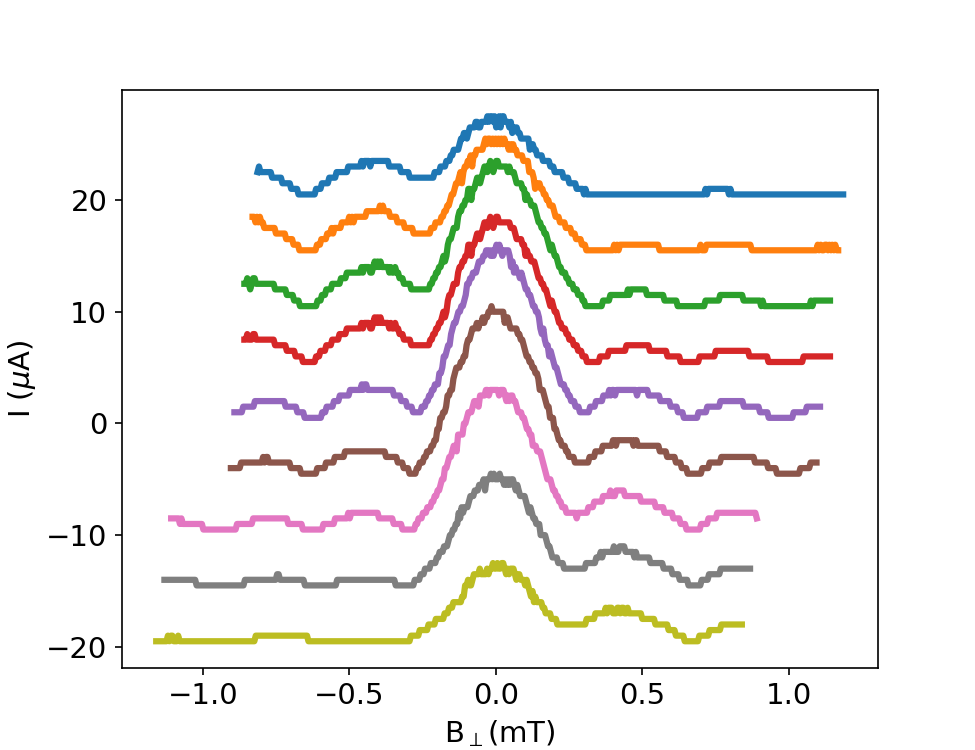

Text(0, 0.5, 'I ($\\mu$A)')

In [23]:
# By_218=np.loadtxt('L01_218_By.csv', delimiter=",")
# By_219=np.loadtxt('L01_219_By.csv', delimiter=",")
# Is_218=np.loadtxt('Is_218.csv', delimiter=",")
# Ir_219=np.loadtxt('Ir_219.csv', delimiter=",")
plt.figure(figsize=(6.5, 5))
# x=np.linspace(0,400,401)
plt.plot(By_271[:,1]/1e-3+0.186,Is_271[:]/1e-6+20,label='B$_{\parallel}$40 mT', linewidth=3)
plt.plot(By_272[:,1]/1e-3+0.169,Is_272[:]/1e-6+15,label='B$_{\parallel}$30 mT', linewidth=3)
plt.plot(By_273[:,1]/1e-3+0.141,Is_273[:]/1e-6+10,label='B$_{\parallel}$20 mT', linewidth=3)
plt.plot(By_274[:,1]/1e-3+0.141,Is_274[:]/1e-6+5,label='B$_{\parallel}$10 mT', linewidth=3)
plt.plot(By_275[:,1]/1e-3+0.107,Is_275[:]/1e-6+0,label='B$_{\parallel}$0 mT', linewidth=3)
plt.plot(By_276[:,1]/1e-3+0.095,Is_276[:]/1e-6-5,label='B$_{\parallel}$-10 mT', linewidth=3)
plt.plot(By_277[:,1]/1e-3-0.109,Is_277[:]/1e-6-10,label='B$_{\parallel}$-20 mT', linewidth=3)
plt.plot(By_278[:,1]/1e-3-0.132,Is_278[:]/1e-6-15,label='B$_{\parallel}$-30 mT', linewidth=3)
plt.plot(By_279[:,1]/1e-3-0.160,Is_279[:]/1e-6-20,label='B$_{\parallel}$-40 mT', linewidth=3)
# plt.plot(By_275[:,1]/1e-3+0.101,Is_275[:]/1e-6+0,label='B$_{\parallel}$0 mT')
plt.rcParams.update({'font.size': 14})
# plt.plot(((x-11)*6e-6+By_218[0,1])/1e-3,Is_218[:]/1e-6)
# plt.plot((-x*6e-6+By_219[0,1])/1e-3,np.abs(Ir_219[:]/1e-6),'-b')

# plt.plot(I_218[211,40:121]/1e-6,(V_218[211,40:121]-V_218[211,40])/1e-3)
# plt.plot(-(I_219[200,40:121])/1e-6,np.abs(V_219[200,40:121]-V_219[200,40])/1e-3)
plt.xlabel('B$_\perp$(mT)')
plt.ylabel('I ($\mu$A)')
# plt.legend(loc='lower right')

## Run 280(R=40) and 281(R=0) theta=30 degree

### Run280 R=40 mT theta=30 degree

In [63]:
runid=280
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [64]:
By_280=By_field
I_280=I
V_280=V
R_280=R_DC1

np.savetxt('L01_280_By.csv', (By_280), fmt='%s', delimiter=',')
np.savetxt('L01_280_I.csv', (I_280), fmt='%s', delimiter=',')
np.savetxt('L01_280_V.csv', (V_280), fmt='%s', delimiter=',')
np.savetxt('L01_280_R.csv', (R_280), fmt='%s', delimiter=',')

In [5]:
By_280=np.loadtxt('L01_280_By.csv', delimiter=",")
I_280=np.loadtxt('L01_280_I.csv', delimiter=",")
V_280=np.loadtxt('L01_280_V.csv', delimiter=",")
R_280=np.loadtxt('L01_280_R.csv', delimiter=",")
Is_280=np.loadtxt('Is_280.csv', delimiter=",")
Ir_280=np.loadtxt('Ir_280.csv', delimiter=",")

<IPython.core.display.Javascript object>


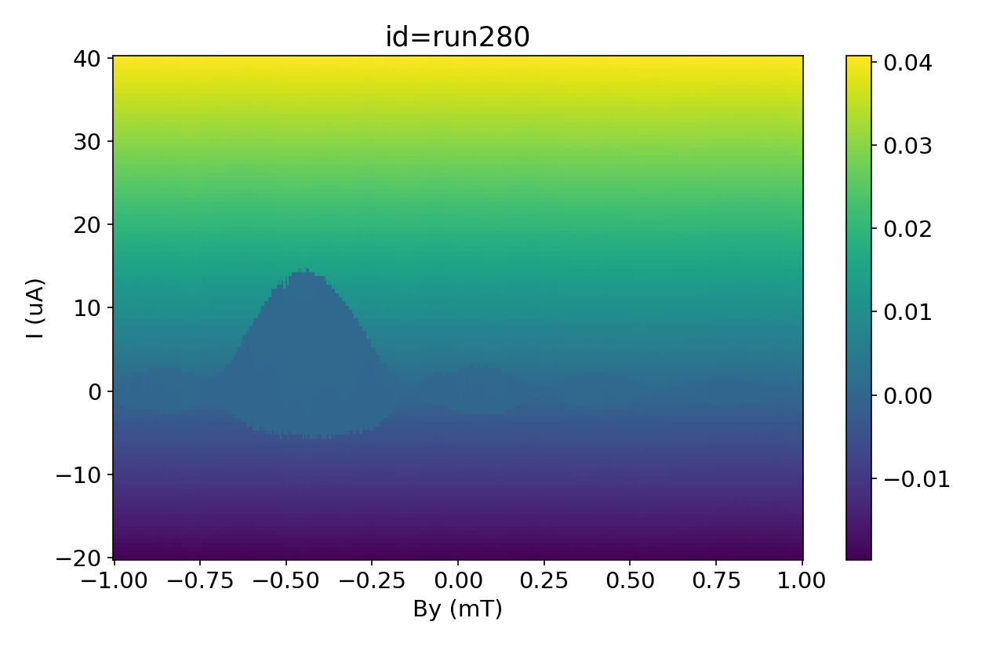

In [66]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_280/1e-3, I_280/1e-6, V_280/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run280')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [67]:
saiz=np.shape(V_280)
# print(saiz)
Is_280=np.zeros(saiz[0])
Ir_280=np.zeros(saiz[0])
fV_280=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_280)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_280[i,37:42])
        if V_280[i,j]-DCoff > 6e-7:
            Is_280[i]=I_280[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_280[i,37:42])
        if -V_280[i,j]-DCoff < 0.5e-6:
            Ir_280[i]=I_280[i,j]
            break


C:\Users\chung\AppData\Local\Temp/ipykernel_33592/351651652.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(5, 3))


<IPython.core.display.Javascript object>


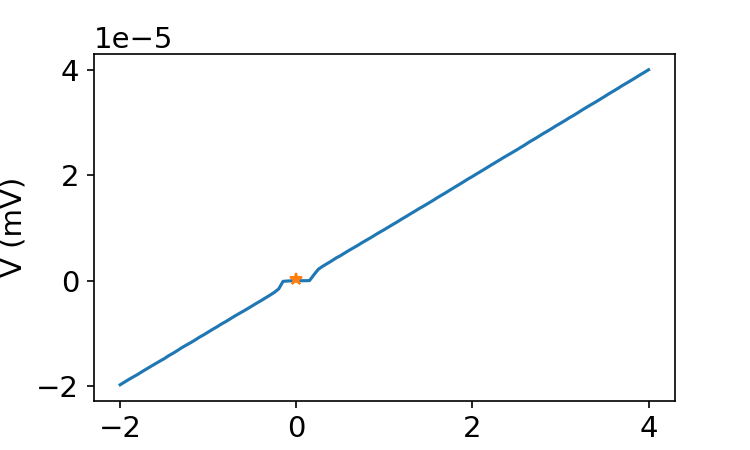

2.7326534e-07


In [68]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_280[10,37:42])
plt.plot(I_280[10,:],V_280[10,:]-DCoff)
# plt.plot(V_280[10,:])
plt.plot(I_280[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


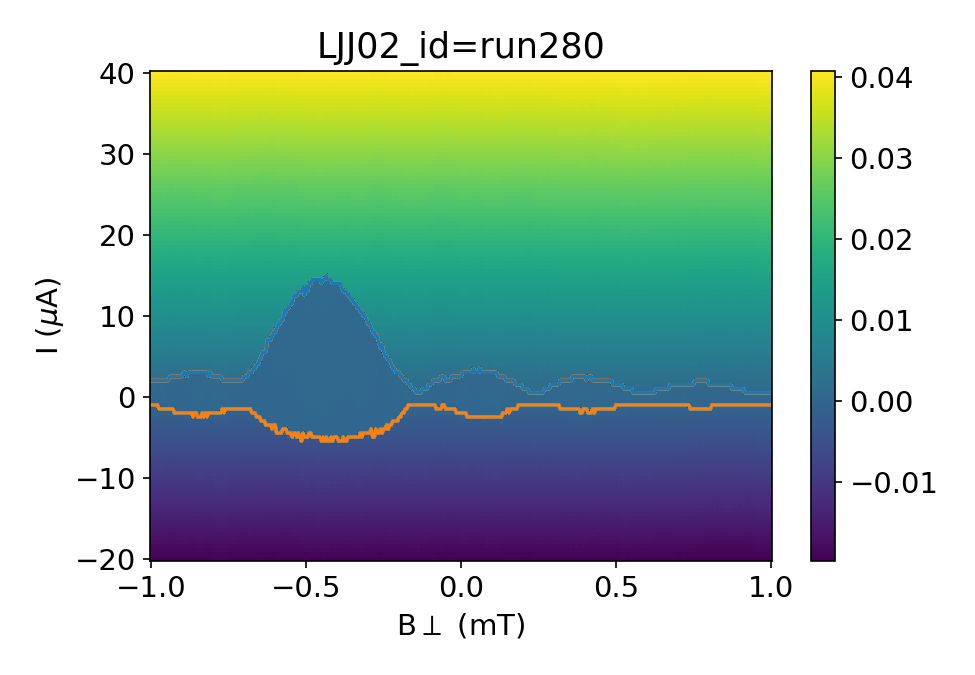

In [69]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_280[Arange:Brange,:]/1e-3, I_280[Arange:Brange,:]/1e-6, V_280[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_280/1e-3, I_280/1e-6, V_280/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_280/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run280')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_280[Arange:Brange,:]/1e-3,Is_280[Arange:Brange]/1e-6)
plt.plot(By_280[Arange:Brange,:]/1e-3,Ir_280[Arange:Brange]/1e-6)

np.savetxt('Is_280.csv', (Is_280), fmt='%s', delimiter=',')
np.savetxt('Ir_280.csv', (Ir_280), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run281 R=0 mT theta=30 degree

In [70]:
runid=281
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [71]:
By_281=By_field
I_281=I
V_281=V
R_281=R_DC1

np.savetxt('L01_281_By.csv', (By_281), fmt='%s', delimiter=',')
np.savetxt('L01_281_I.csv', (I_281), fmt='%s', delimiter=',')
np.savetxt('L01_281_V.csv', (V_281), fmt='%s', delimiter=',')
np.savetxt('L01_281_R.csv', (R_281), fmt='%s', delimiter=',')

In [5]:
By_281=np.loadtxt('L01_281_By.csv', delimiter=",")
I_281=np.loadtxt('L01_281_I.csv', delimiter=",")
V_281=np.loadtxt('L01_281_V.csv', delimiter=",")
R_281=np.loadtxt('L01_281_R.csv', delimiter=",")
Is_281=np.loadtxt('Is_281.csv', delimiter=",")
Ir_281=np.loadtxt('Ir_281.csv', delimiter=",")

<IPython.core.display.Javascript object>


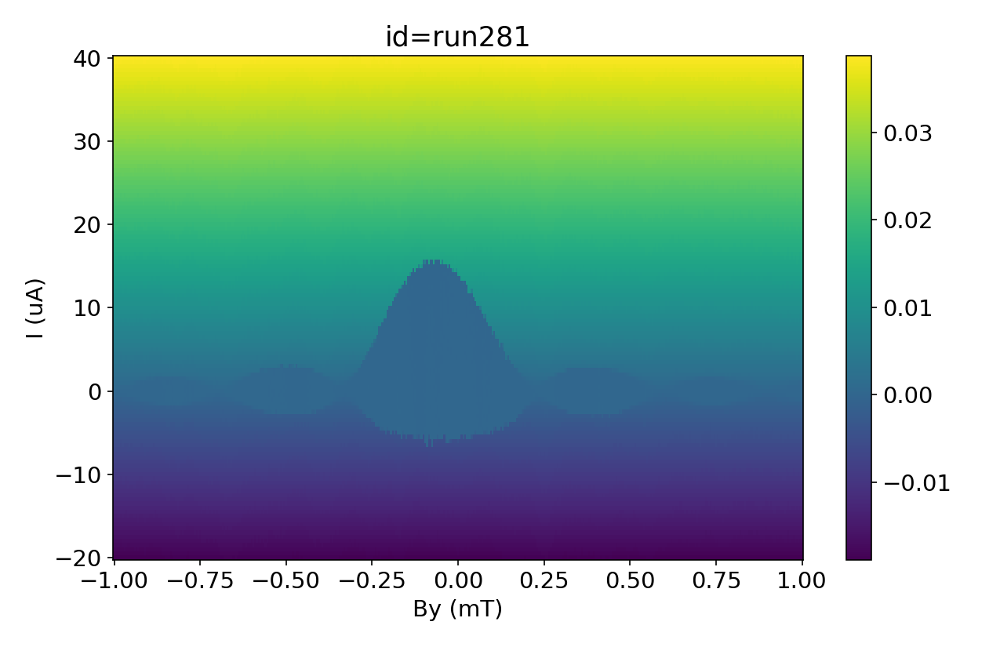

In [72]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_281/1e-3, I_281/1e-6, V_281/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run281')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [73]:
saiz=np.shape(V_281)
# print(saiz)
Is_281=np.zeros(saiz[0])
Ir_281=np.zeros(saiz[0])
fV_281=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_281)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_281[i,37:42])
        if V_281[i,j]-DCoff > 5e-7:
            Is_281[i]=I_281[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_281[i,37:42])
        if -V_281[i,j]-DCoff < 0.5e-6:
            Ir_281[i]=I_281[i,j]
            break


<IPython.core.display.Javascript object>


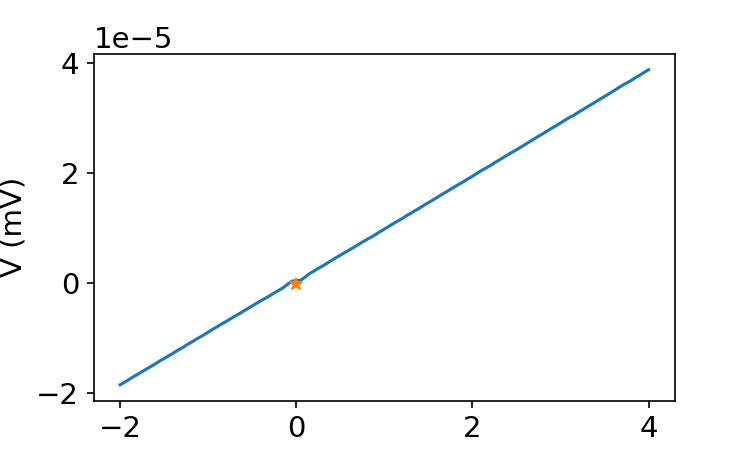

-1.5242622e-07


In [74]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_281[10,37:42])
plt.plot(I_281[10,:],V_281[10,:]-DCoff)
# plt.plot(V_281[10,:])
plt.plot(I_281[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


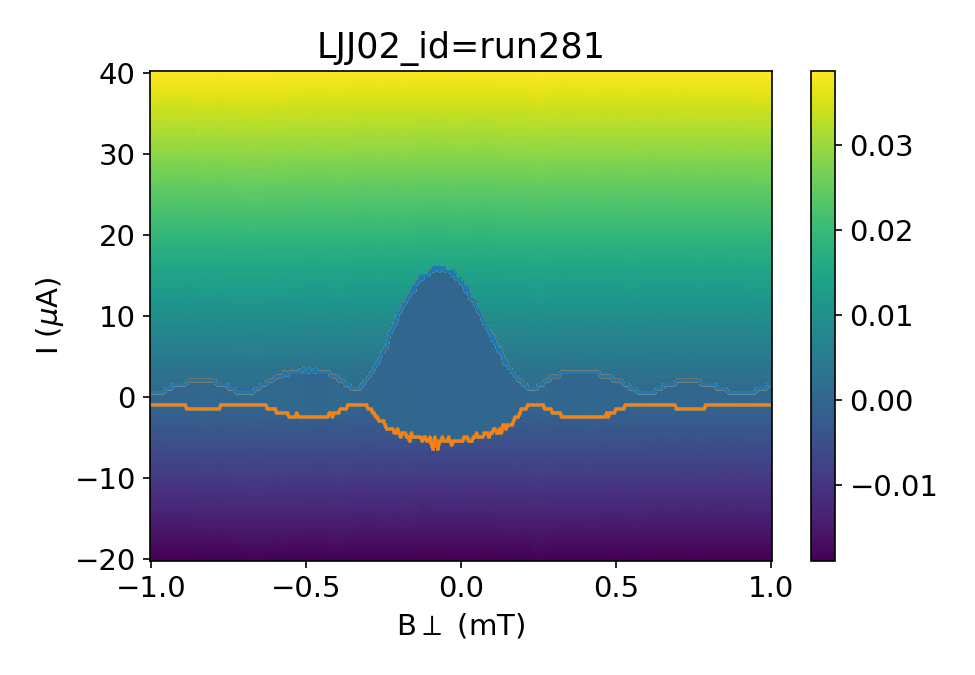

In [75]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_281[Arange:Brange,:]/1e-3, I_281[Arange:Brange,:]/1e-6, V_281[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_281/1e-3, I_281/1e-6, V_281/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_281/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run281')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_281[Arange:Brange,:]/1e-3,Is_281[Arange:Brange]/1e-6)
plt.plot(By_281[Arange:Brange,:]/1e-3,Ir_281[Arange:Brange]/1e-6)

np.savetxt('Is_281.csv', (Is_281), fmt='%s', delimiter=',')
np.savetxt('Ir_281.csv', (Ir_281), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run282 R=-40 mT theta=210

In [76]:
runid=282
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [77]:
By_282=By_field
I_282=I
V_282=V
R_282=R_DC1

np.savetxt('L01_282_By.csv', (By_282), fmt='%s', delimiter=',')
np.savetxt('L01_282_I.csv', (I_282), fmt='%s', delimiter=',')
np.savetxt('L01_282_V.csv', (V_282), fmt='%s', delimiter=',')
np.savetxt('L01_282_R.csv', (R_282), fmt='%s', delimiter=',')

In [79]:
By_282=np.loadtxt('L01_282_By.csv', delimiter=",")
I_282=np.loadtxt('L01_282_I.csv', delimiter=",")
V_282=np.loadtxt('L01_282_V.csv', delimiter=",")
R_282=np.loadtxt('L01_282_R.csv', delimiter=",")
# Is_282=np.loadtxt('Is_282.csv', delimiter=",")
# Ir_282=np.loadtxt('Ir_282.csv', delimiter=",")

<IPython.core.display.Javascript object>


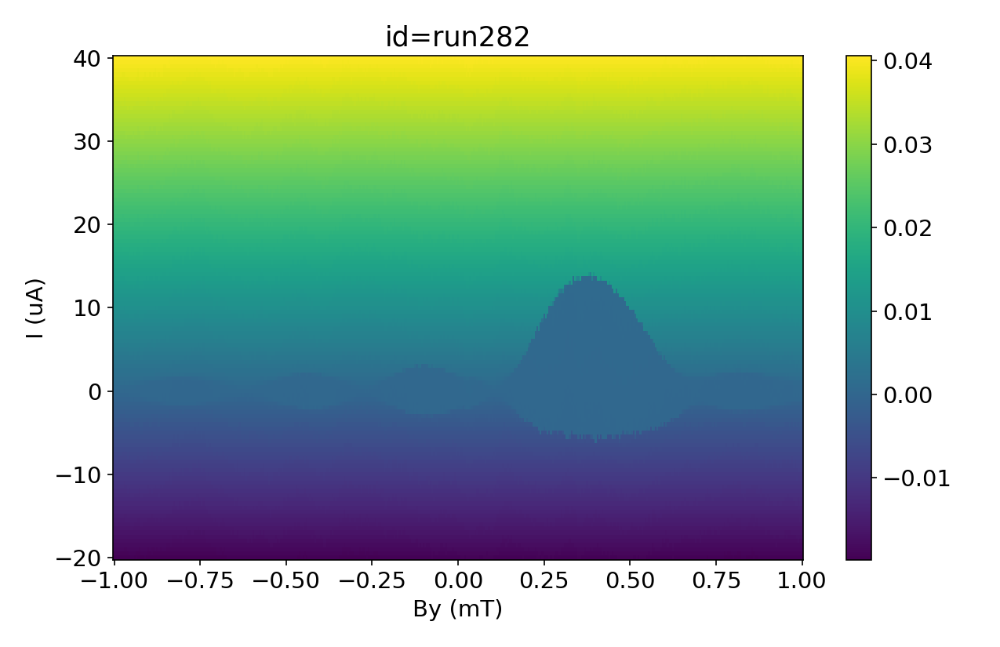

In [80]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_282/1e-3, I_282/1e-6, V_282/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run282')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [88]:
saiz=np.shape(V_282)
# print(saiz)
Is_282=np.zeros(saiz[0])
Ir_282=np.zeros(saiz[0])
fV_282=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_282)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_282[i,37:42])
        if V_282[i,j]-DCoff > 7e-7:
            Is_282[i]=I_282[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_282[i,37:42])
        if -V_282[i,j]-DCoff < 0.5e-6:
            Ir_282[i]=I_282[i,j]
            break


<IPython.core.display.Javascript object>


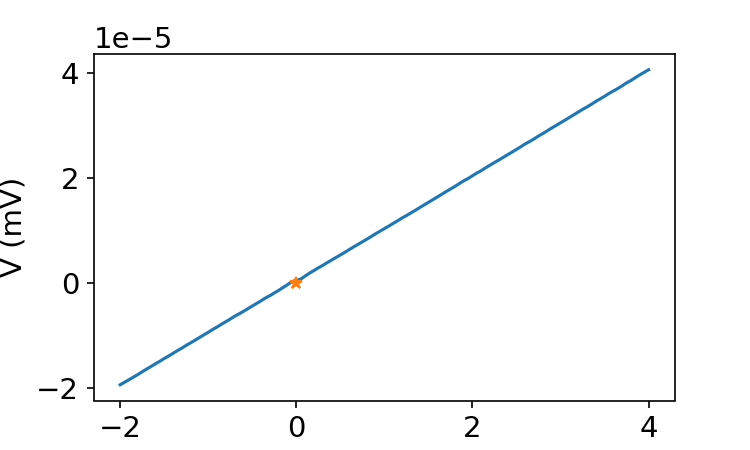

-4.6712959999999997e-08


In [82]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_282[10,37:42])
plt.plot(I_282[10,:],V_282[10,:]-DCoff)
# plt.plot(V_282[10,:])
plt.plot(I_282[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


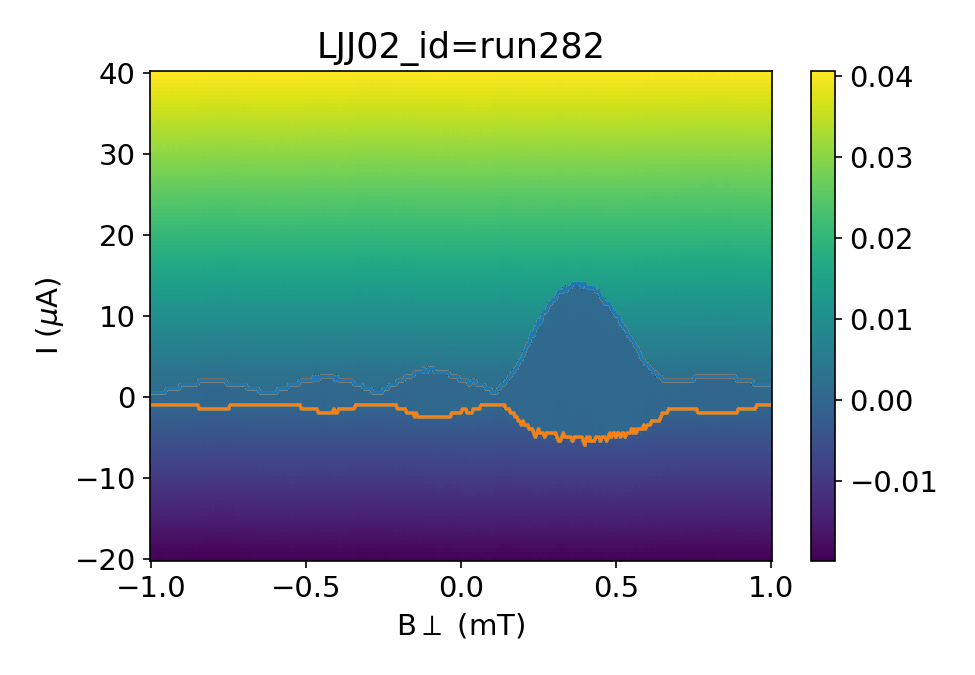

In [89]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_282[Arange:Brange,:]/1e-3, I_282[Arange:Brange,:]/1e-6, V_282[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_282/1e-3, I_282/1e-6, V_282/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_282/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run282')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_282[Arange:Brange,:]/1e-3,Is_282[Arange:Brange]/1e-6)
plt.plot(By_282[Arange:Brange,:]/1e-3,Ir_282[Arange:Brange]/1e-6)

np.savetxt('Is_282.csv', (Is_282), fmt='%s', delimiter=',')
np.savetxt('Ir_282.csv', (Ir_282), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run280-282

C:\Users\chung\AppData\Local\Temp/ipykernel_33592/1620027492.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(5, 3))


<IPython.core.display.Javascript object>


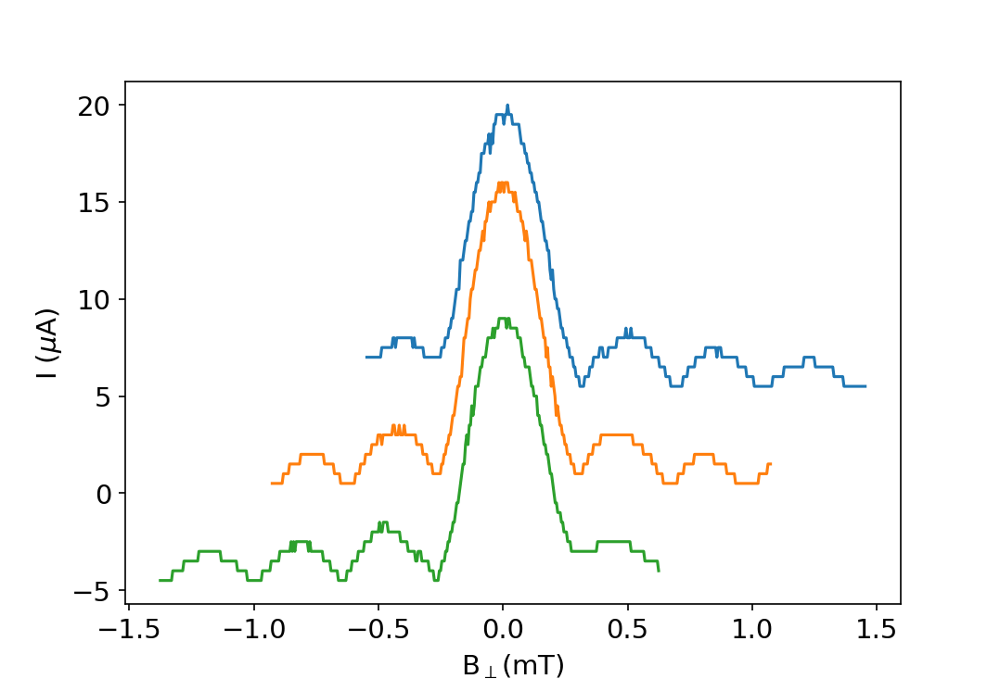

Text(0, 0.5, 'I ($\\mu$A)')

In [90]:
# By_218=np.loadtxt('L01_218_By.csv', delimiter=",")
# By_219=np.loadtxt('L01_219_By.csv', delimiter=",")
# Is_218=np.loadtxt('Is_218.csv', delimiter=",")
# Ir_219=np.loadtxt('Ir_219.csv', delimiter=",")
plt.figure(figsize=(5, 3))
# x=np.linspace(0,400,401)
plt.plot(By_280[:,1]/1e-3+0.453,Is_280[:]/1e-6+5,label='B$_{\parallel}$40 mT')
# plt.plot(By_272[:,1]/1e-3+0.169,Is_272[:]/1e-6+15,label='B$_{\parallel}$30 mT')
# plt.plot(By_273[:,1]/1e-3+0.141,Is_273[:]/1e-6+10,label='B$_{\parallel}$20 mT')
# plt.plot(By_274[:,1]/1e-3+0.141,Is_274[:]/1e-6+5,label='B$_{\parallel}$10 mT')
plt.plot(By_281[:,1]/1e-3+0.073,Is_281[:]/1e-6+0,label='B$_{\parallel}$0 mT')
# plt.plot(By_276[:,1]/1e-3+0.095,Is_276[:]/1e-6-5,label='B$_{\parallel}$-10 mT')
# plt.plot(By_277[:,1]/1e-3-0.109,Is_277[:]/1e-6-10,label='B$_{\parallel}$-20 mT')
# plt.plot(By_278[:,1]/1e-3-0.132,Is_278[:]/1e-6-15,label='B$_{\parallel}$-30 mT')
plt.plot(By_282[:,1]/1e-3-0.376,Is_282[:]/1e-6-5,label='B$_{\parallel}$-40 mT')
# plt.plot(By_275[:,1]/1e-3+0.101,Is_275[:]/1e-6+0,label='B$_{\parallel}$0 mT')
plt.rcParams.update({'font.size': 14})
# plt.plot(((x-11)*6e-6+By_218[0,1])/1e-3,Is_218[:]/1e-6)
# plt.plot((-x*6e-6+By_219[0,1])/1e-3,np.abs(Ir_219[:]/1e-6),'-b')

# plt.plot(I_218[211,40:121]/1e-6,(V_218[211,40:121]-V_218[211,40])/1e-3)
# plt.plot(-(I_219[200,40:121])/1e-6,np.abs(V_219[200,40:121]-V_219[200,40])/1e-3)
plt.xlabel('B$_\perp$(mT)')
plt.ylabel('I ($\mu$A)')
# plt.legend(loc='lower right')

## Temperature dependence 283(90 mK), 284(137 mK), 285(253 mK), 286(350 mK), 288(500 mK), 289 (700 mK)

### Run283 R=20 mT theta=300

In [5]:
runid=283
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [6]:
By_283=By_field
I_283=I
V_283=V
R_283=R_DC1

np.savetxt('L01_283_By.csv', (By_283), fmt='%s', delimiter=',')
np.savetxt('L01_283_I.csv', (I_283), fmt='%s', delimiter=',')
np.savetxt('L01_283_V.csv', (V_283), fmt='%s', delimiter=',')
np.savetxt('L01_283_R.csv', (R_283), fmt='%s', delimiter=',')

In [5]:
By_283=np.loadtxt('L01_283_By.csv', delimiter=",")
I_283=np.loadtxt('L01_283_I.csv', delimiter=",")
V_283=np.loadtxt('L01_283_V.csv', delimiter=",")
R_283=np.loadtxt('L01_283_R.csv', delimiter=",")
Is_283=np.loadtxt('Is_283.csv', delimiter=",")
Ir_283=np.loadtxt('Ir_283.csv', delimiter=",")

<IPython.core.display.Javascript object>


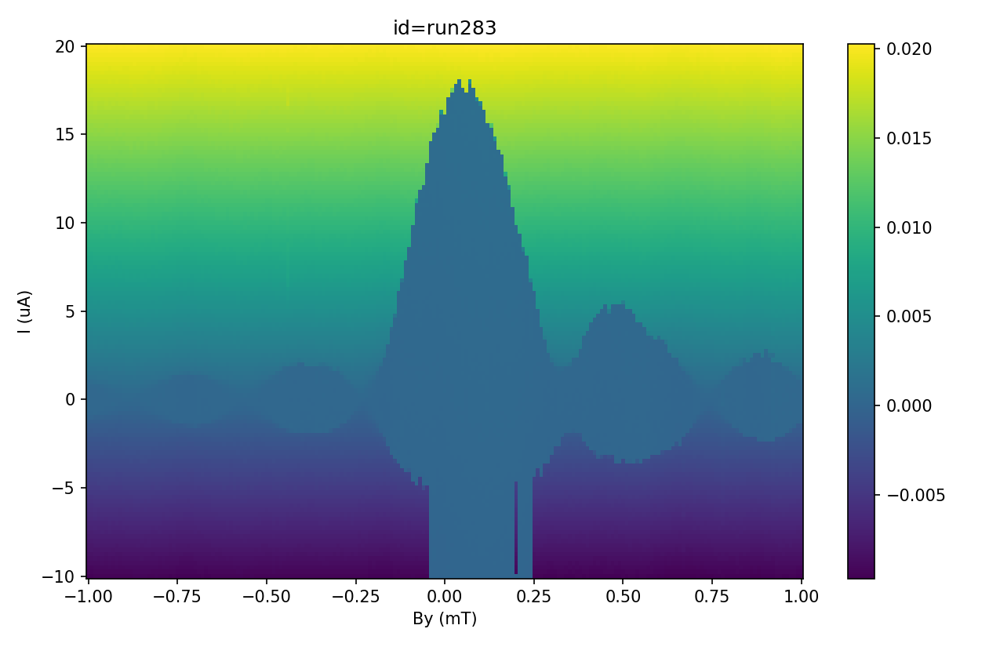

In [7]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_283/1e-3, I_283/1e-6, V_283/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run283')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [12]:
saiz=np.shape(V_283)
# print(saiz)
Is_283=np.zeros(saiz[0])
Ir_283=np.zeros(saiz[0])
fV_283=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_283)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_283[i,37:42])
        if V_283[i,j]-DCoff > 7e-7:
            Is_283[i]=I_283[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_283[i,37:42])
        if -V_283[i,j]-DCoff < 0.5e-6:
            Ir_283[i]=I_283[i,j]
            break


<IPython.core.display.Javascript object>


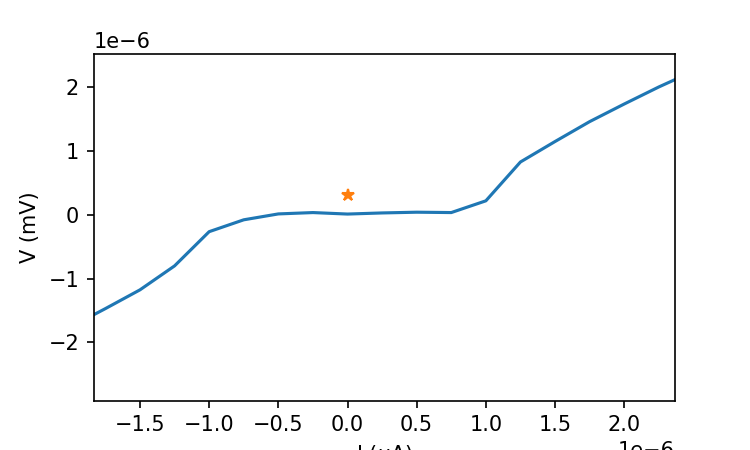

3.040239e-07


In [10]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_283[50,37:42])
plt.plot(I_283[50,:],V_283[50,:]-DCoff)
# plt.plot(V_283[10,:])
plt.plot(I_283[10,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


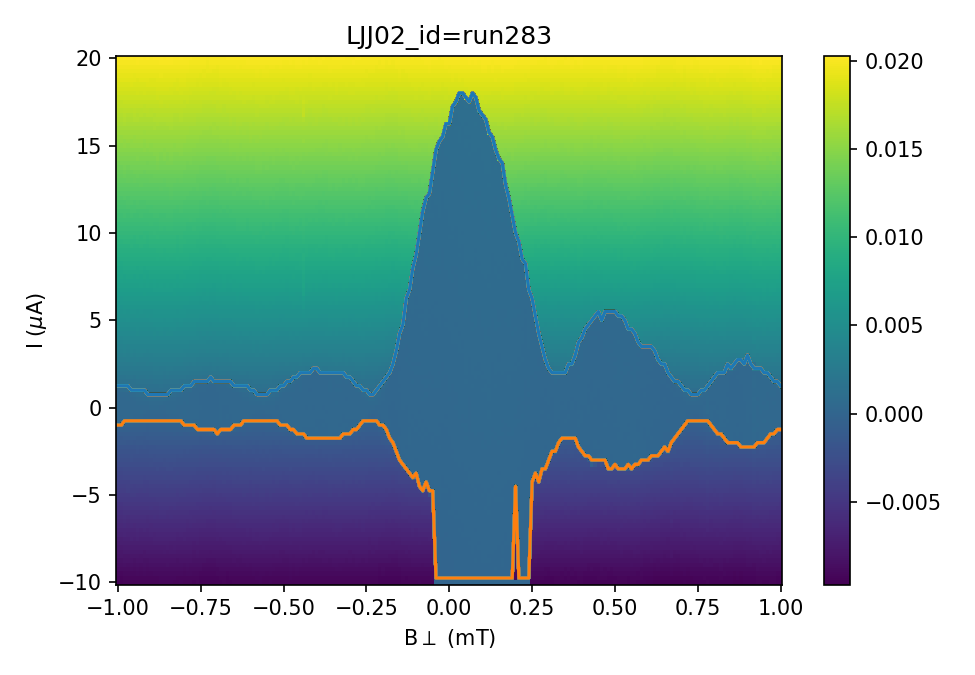

In [13]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_283[Arange:Brange,:]/1e-3, I_283[Arange:Brange,:]/1e-6, V_283[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_283/1e-3, I_283/1e-6, V_283/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_283/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run283')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_283[Arange:Brange,:]/1e-3,Is_283[Arange:Brange]/1e-6)
plt.plot(By_283[Arange:Brange,:]/1e-3,Ir_283[Arange:Brange]/1e-6)

np.savetxt('Is_283.csv', (Is_283), fmt='%s', delimiter=',')
np.savetxt('Ir_283.csv', (Ir_283), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run284 R=20 mT theta=300

In [14]:
runid=284
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [15]:
By_284=By_field
I_284=I
V_284=V
R_284=R_DC1

np.savetxt('L01_284_By.csv', (By_284), fmt='%s', delimiter=',')
np.savetxt('L01_284_I.csv', (I_284), fmt='%s', delimiter=',')
np.savetxt('L01_284_V.csv', (V_284), fmt='%s', delimiter=',')
np.savetxt('L01_284_R.csv', (R_284), fmt='%s', delimiter=',')

In [6]:
By_284=np.loadtxt('L01_284_By.csv', delimiter=",")
I_284=np.loadtxt('L01_284_I.csv', delimiter=",")
V_284=np.loadtxt('L01_284_V.csv', delimiter=",")
R_284=np.loadtxt('L01_284_R.csv', delimiter=",")
Is_284=np.loadtxt('Is_284.csv', delimiter=",")
Ir_284=np.loadtxt('Ir_284.csv', delimiter=",")

<IPython.core.display.Javascript object>


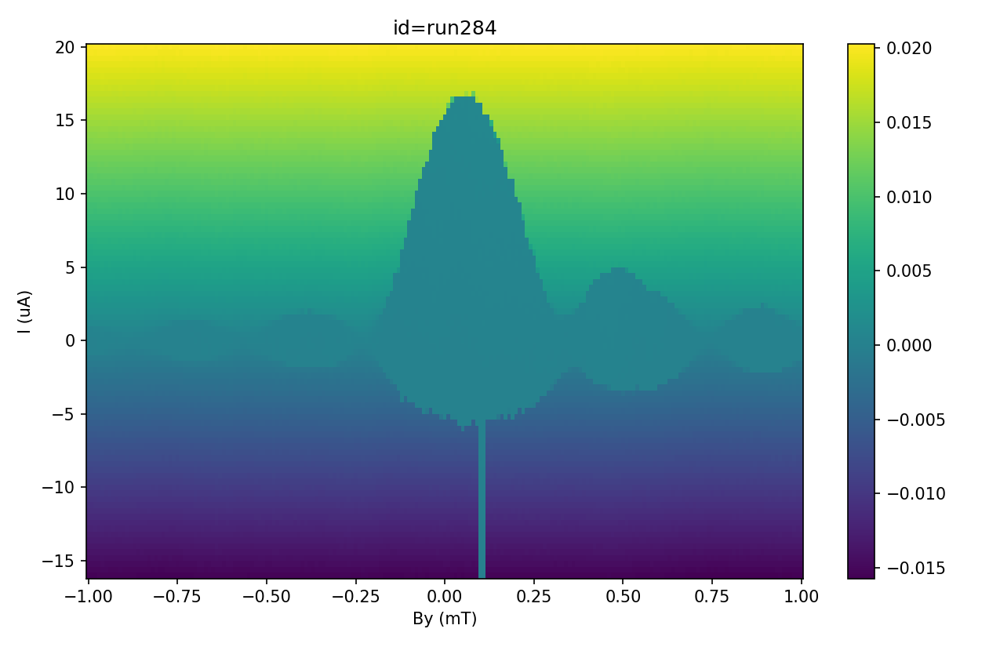

In [16]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_284/1e-3, I_284/1e-6, V_284/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run284')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [22]:
saiz=np.shape(V_284)
# print(saiz)
Is_284=np.zeros(saiz[0])
Ir_284=np.zeros(saiz[0])
fV_284=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_284)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_284[i,37:42])
        if V_284[i,j]-DCoff > 7e-7:
            Is_284[i]=I_284[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_284[i,37:42])
        if -V_284[i,j]-DCoff < 0.5e-6:
            Ir_284[i]=I_284[i,j]
            break


<IPython.core.display.Javascript object>


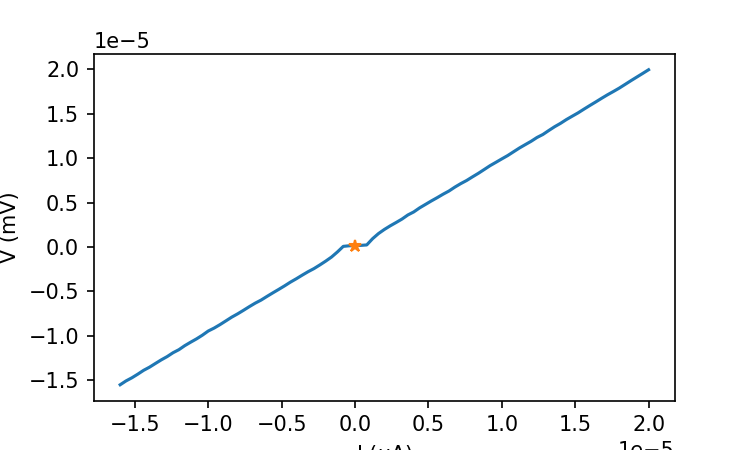

1.2023046e-07


In [18]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_284[50,37:42])
plt.plot(I_284[50,:],V_284[50,:]-DCoff)
# plt.plot(V_284[50,:])
plt.plot(I_284[50,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


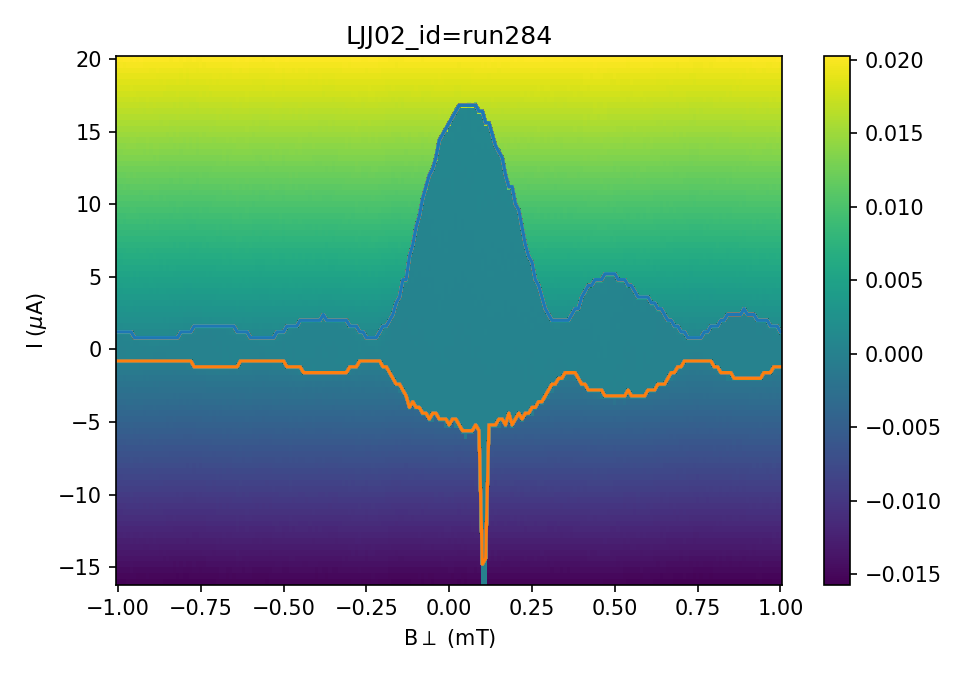

In [23]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_284[Arange:Brange,:]/1e-3, I_284[Arange:Brange,:]/1e-6, V_284[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_284/1e-3, I_284/1e-6, V_284/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_284/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run284')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_284[Arange:Brange,:]/1e-3,Is_284[Arange:Brange]/1e-6)
plt.plot(By_284[Arange:Brange,:]/1e-3,Ir_284[Arange:Brange]/1e-6)

np.savetxt('Is_284.csv', (Is_284), fmt='%s', delimiter=',')
np.savetxt('Ir_284.csv', (Ir_284), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run285 R=20 mT theta=300

In [24]:
runid=285
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [25]:
By_285=By_field
I_285=I
V_285=V
R_285=R_DC1

np.savetxt('L01_285_By.csv', (By_285), fmt='%s', delimiter=',')
np.savetxt('L01_285_I.csv', (I_285), fmt='%s', delimiter=',')
np.savetxt('L01_285_V.csv', (V_285), fmt='%s', delimiter=',')
np.savetxt('L01_285_R.csv', (R_285), fmt='%s', delimiter=',')

In [7]:
By_285=np.loadtxt('L01_285_By.csv', delimiter=",")
I_285=np.loadtxt('L01_285_I.csv', delimiter=",")
V_285=np.loadtxt('L01_285_V.csv', delimiter=",")
R_285=np.loadtxt('L01_285_R.csv', delimiter=",")
Is_285=np.loadtxt('Is_285.csv', delimiter=",")
Ir_285=np.loadtxt('Ir_285.csv', delimiter=",")

<IPython.core.display.Javascript object>


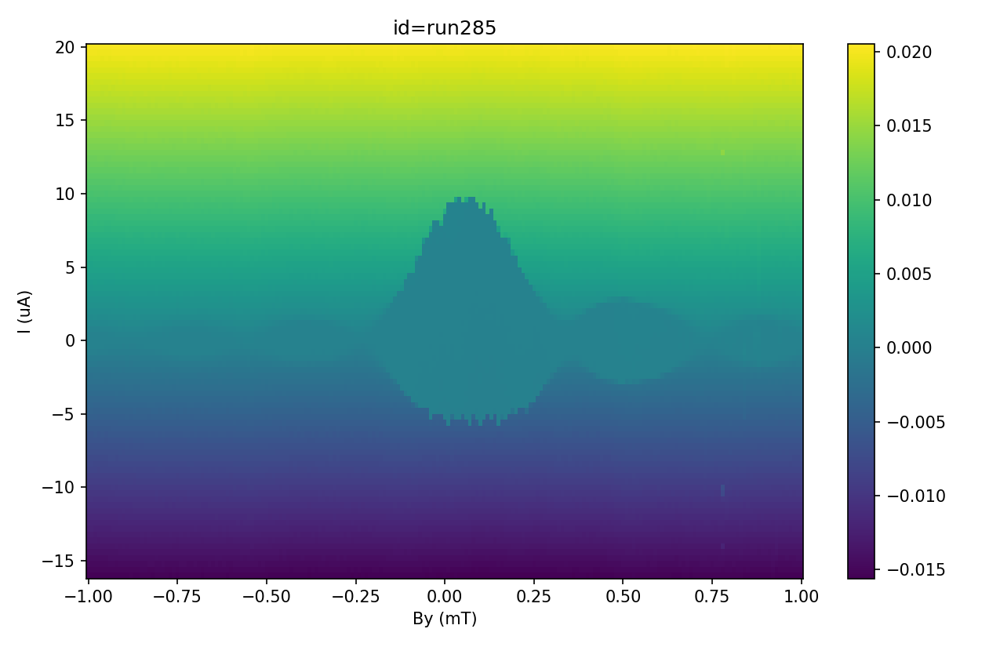

In [26]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_285/1e-3, I_285/1e-6, V_285/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run285')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [27]:
saiz=np.shape(V_285)
# print(saiz)
Is_285=np.zeros(saiz[0])
Ir_285=np.zeros(saiz[0])
fV_285=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_285)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_285[i,37:42])
        if V_285[i,j]-DCoff > 7e-7:
            Is_285[i]=I_285[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_285[i,37:42])
        if -V_285[i,j]-DCoff < 0.5e-6:
            Ir_285[i]=I_285[i,j]
            break


<IPython.core.display.Javascript object>


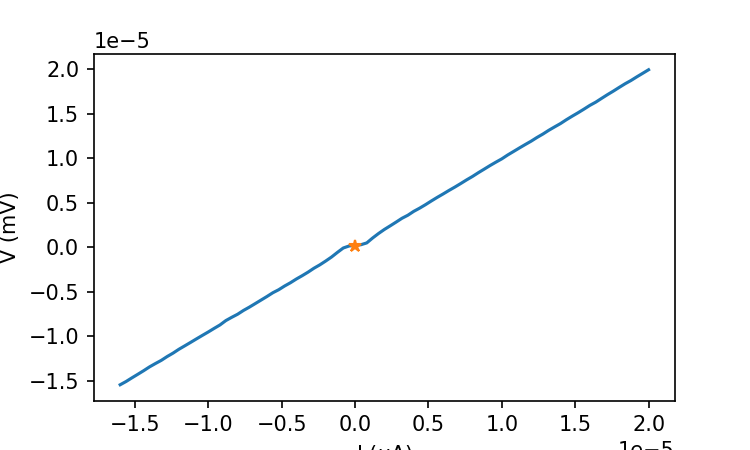

1.5980878000000002e-07


In [28]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_285[50,37:42])
plt.plot(I_285[50,:],V_285[50,:]-DCoff)
# plt.plot(V_285[50,:])
plt.plot(I_285[50,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


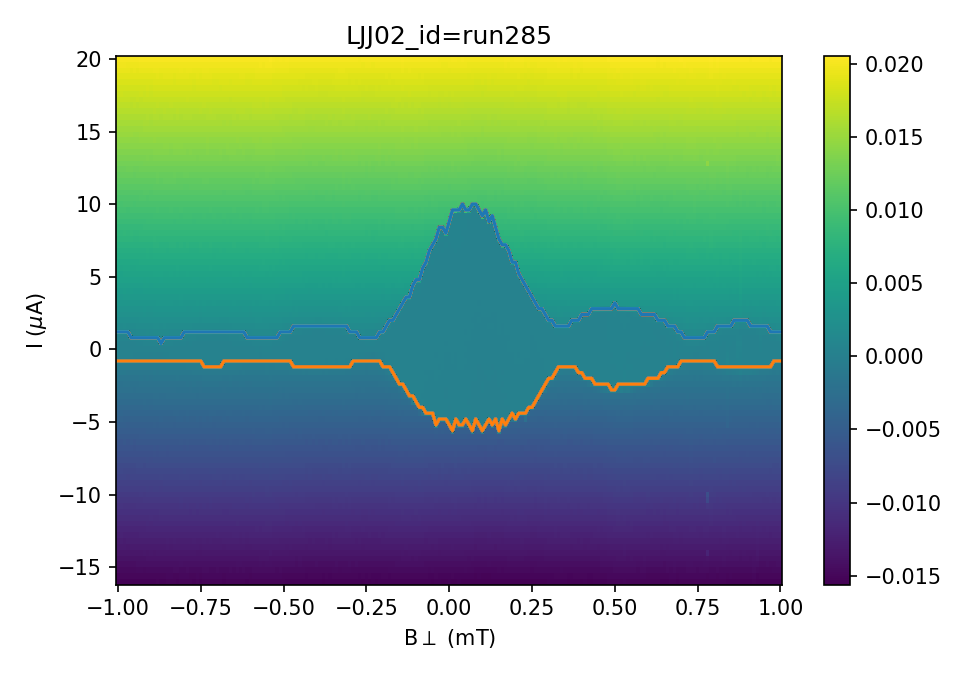

In [29]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_285[Arange:Brange,:]/1e-3, I_285[Arange:Brange,:]/1e-6, V_285[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_285/1e-3, I_285/1e-6, V_285/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_285/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run285')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_285[Arange:Brange,:]/1e-3,Is_285[Arange:Brange]/1e-6)
plt.plot(By_285[Arange:Brange,:]/1e-3,Ir_285[Arange:Brange]/1e-6)

np.savetxt('Is_285.csv', (Is_285), fmt='%s', delimiter=',')
np.savetxt('Ir_285.csv', (Ir_285), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run286 R=20 mT theta=300

In [16]:
runid=286
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [31]:
By_286=By_field
I_286=I
V_286=V
R_286=R_DC1

np.savetxt('L01_286_By.csv', (By_286), fmt='%s', delimiter=',')
np.savetxt('L01_286_I.csv', (I_286), fmt='%s', delimiter=',')
np.savetxt('L01_286_V.csv', (V_286), fmt='%s', delimiter=',')
np.savetxt('L01_286_R.csv', (R_286), fmt='%s', delimiter=',')

In [8]:
By_286=np.loadtxt('L01_286_By.csv', delimiter=",")
I_286=np.loadtxt('L01_286_I.csv', delimiter=",")
V_286=np.loadtxt('L01_286_V.csv', delimiter=",")
R_286=np.loadtxt('L01_286_R.csv', delimiter=",")
Is_286=np.loadtxt('Is_286.csv', delimiter=",")
Ir_286=np.loadtxt('Ir_286.csv', delimiter=",")

<IPython.core.display.Javascript object>


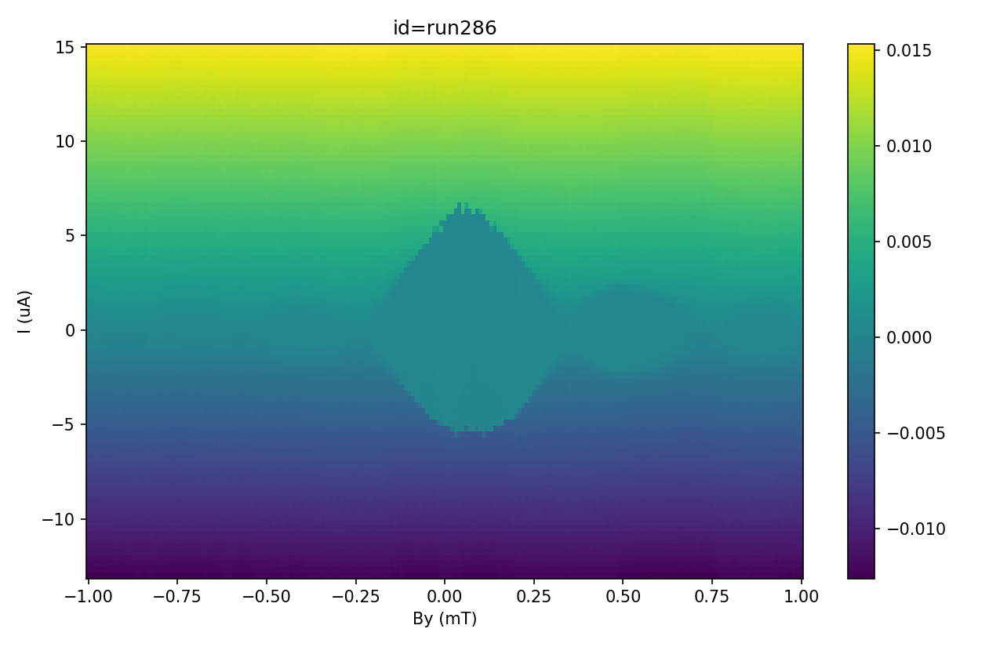

In [32]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_286/1e-3, I_286/1e-6, V_286/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run286')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 

fig.tight_layout()
#plt.grid()
plt.show()

In [33]:
saiz=np.shape(V_286)
# print(saiz)
Is_286=np.zeros(saiz[0])
Ir_286=np.zeros(saiz[0])
fV_286=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_286)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_286[i,37:42])
        if V_286[i,j]-DCoff > 7e-7:
            Is_286[i]=I_286[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_286[i,37:42])
        if -V_286[i,j]-DCoff < 0.5e-6:
            Ir_286[i]=I_286[i,j]
            break


<IPython.core.display.Javascript object>


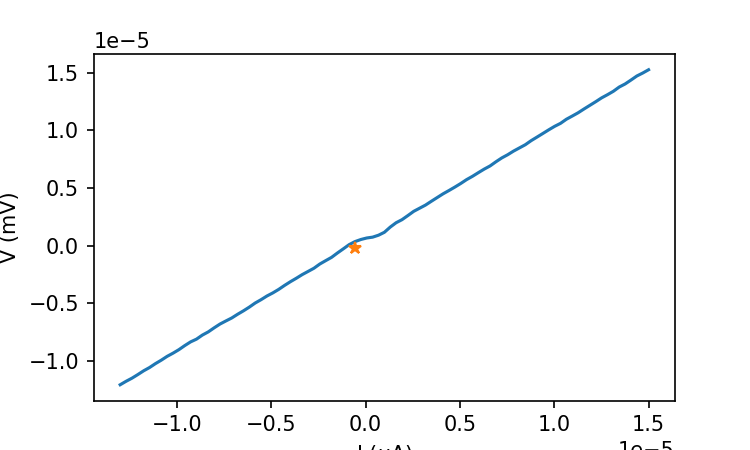

-2.3553433999999996e-07


In [34]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_286[50,37:42])
plt.plot(I_286[50,:],V_286[50,:]-DCoff)
# plt.plot(V_286[50,:])
plt.plot(I_286[50,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


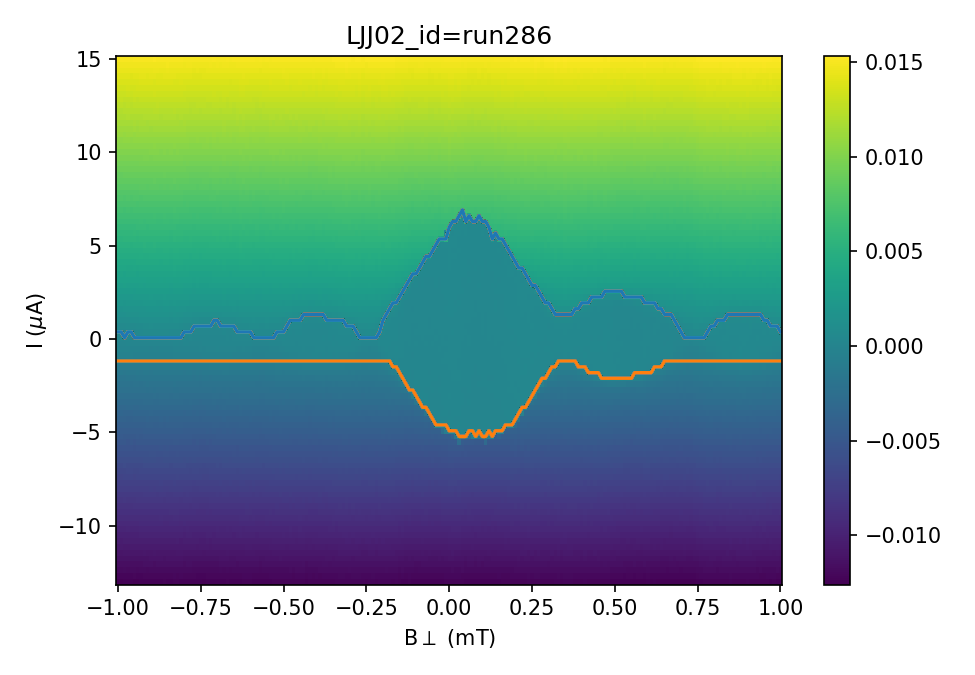

In [35]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_286[Arange:Brange,:]/1e-3, I_286[Arange:Brange,:]/1e-6, V_286[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_286/1e-3, I_286/1e-6, V_286/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_286/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run286')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_286[Arange:Brange,:]/1e-3,Is_286[Arange:Brange]/1e-6)
plt.plot(By_286[Arange:Brange,:]/1e-3,Ir_286[Arange:Brange]/1e-6)

np.savetxt('Is_286.csv', (Is_286), fmt='%s', delimiter=',')
np.savetxt('Ir_286.csv', (Ir_286), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run288 R=20 mT theta=300

In [17]:
runid=288
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [18]:
By_288=By_field
I_288=I
V_288=V
R_288=R_DC1

np.savetxt('L01_288_By.csv', (By_288), fmt='%s', delimiter=',')
np.savetxt('L01_288_I.csv', (I_288), fmt='%s', delimiter=',')
np.savetxt('L01_288_V.csv', (V_288), fmt='%s', delimiter=',')
np.savetxt('L01_288_R.csv', (R_288), fmt='%s', delimiter=',')

In [8]:
By_288=np.loadtxt('L01_288_By.csv', delimiter=",")
I_288=np.loadtxt('L01_288_I.csv', delimiter=",")
V_288=np.loadtxt('L01_288_V.csv', delimiter=",")
R_288=np.loadtxt('L01_288_R.csv', delimiter=",")
Is_288=np.loadtxt('Is_288.csv', delimiter=",")
Ir_288=np.loadtxt('Ir_288.csv', delimiter=",")

<IPython.core.display.Javascript object>


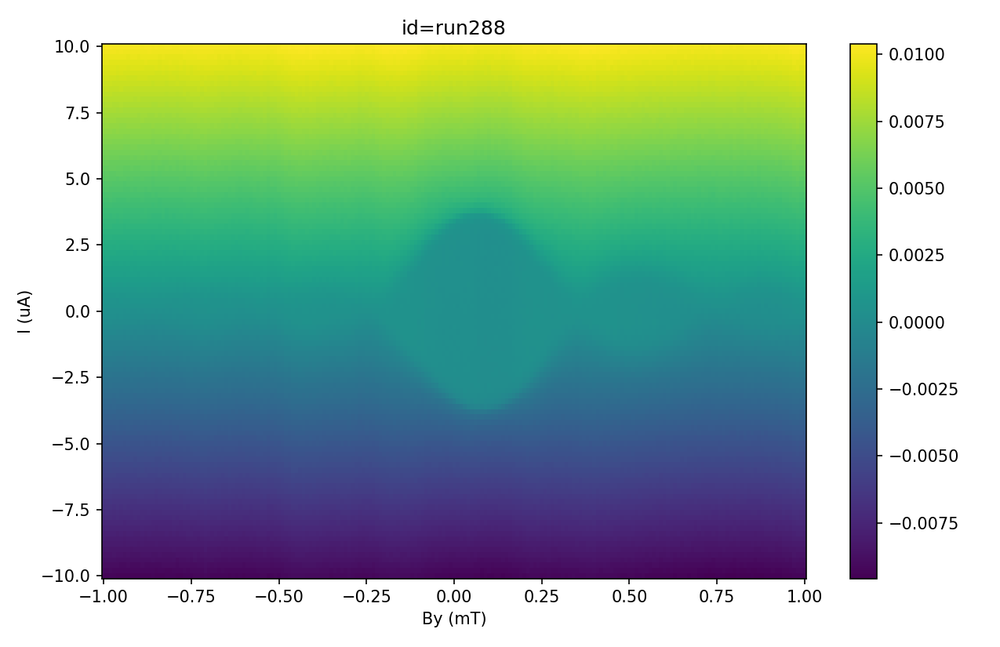

In [19]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_288/1e-3, I_288/1e-6, V_288/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run288')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 

fig.tight_layout()
#plt.grid()
plt.show()

In [29]:
saiz=np.shape(V_288)
# print(saiz)
Is_288=np.zeros(saiz[0])
Ir_288=np.zeros(saiz[0])
fV_288=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_288)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_288[i,45:55])
        if V_288[i,j]-DCoff > 7e-7:
            Is_288[i]=I_288[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_288[i,45:55])
        if -V_288[i,j]-DCoff < 0.7e-6:
            Ir_288[i]=I_288[i,j]
            break


<IPython.core.display.Javascript object>


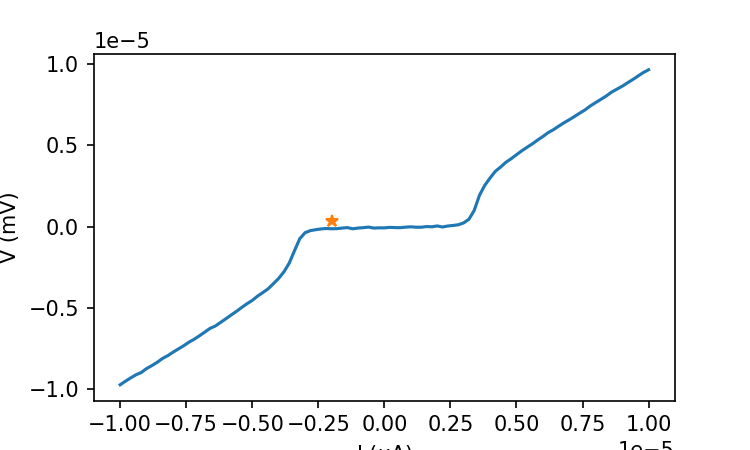

3.73873596e-07


In [26]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_288[50,45:55])
plt.plot(I_288[100,:],V_288[100,:]-DCoff)
# plt.plot(V_288[50,:])
plt.plot(I_288[50,40],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


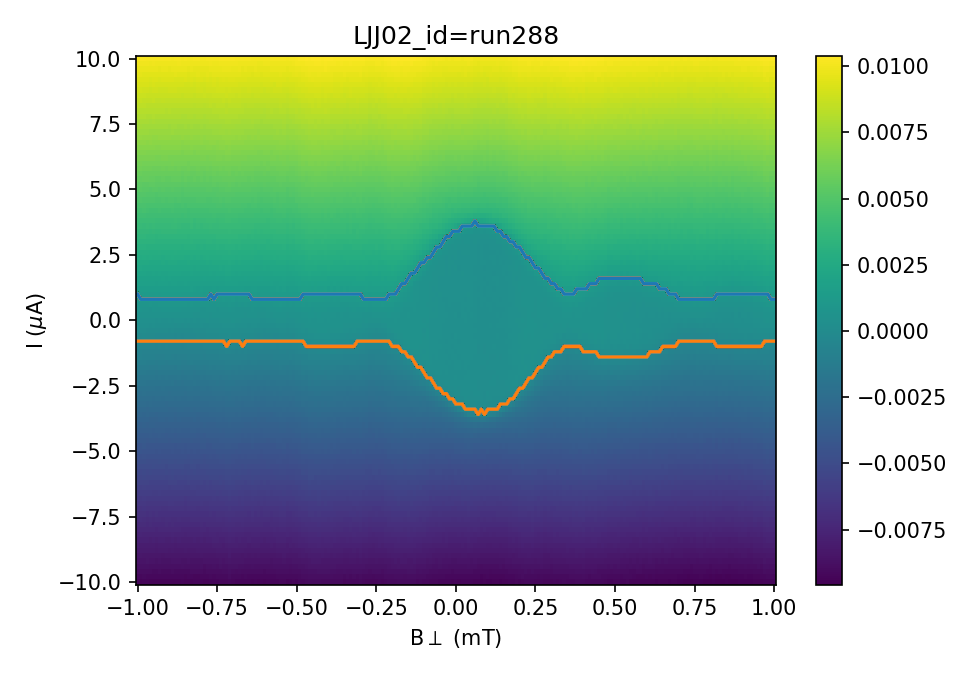

In [30]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_288[Arange:Brange,:]/1e-3, I_288[Arange:Brange,:]/1e-6, V_288[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_288/1e-3, I_288/1e-6, V_288/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_288/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run288')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_288[Arange:Brange,:]/1e-3,Is_288[Arange:Brange]/1e-6)
plt.plot(By_288[Arange:Brange,:]/1e-3,Ir_288[Arange:Brange]/1e-6)

np.savetxt('Is_288.csv', (Is_288), fmt='%s', delimiter=',')
np.savetxt('Ir_288.csv', (Ir_288), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run289 R=20 mT theta=300

In [31]:
runid=289
dataset = qc.load_by_id(runid)

V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if Bx_field[i]!=Bx_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N

#DC Bias vs. field 
R_DC1 = V/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
R_DC1 = np.diff(R_DC1, axis = 1)
I=I.reshape(NB,NI)
By_field =By_field.reshape(NB,NI)
V = V.reshape(NB,NI)

In [32]:
By_289=By_field
I_289=I
V_289=V
R_289=R_DC1

np.savetxt('L01_289_By.csv', (By_289), fmt='%s', delimiter=',')
np.savetxt('L01_289_I.csv', (I_289), fmt='%s', delimiter=',')
np.savetxt('L01_289_V.csv', (V_289), fmt='%s', delimiter=',')
np.savetxt('L01_289_R.csv', (R_289), fmt='%s', delimiter=',')

In [8]:
By_289=np.loadtxt('L01_2889_By.csv', delimiter=",")
I_289=np.loadtxt('L01_289_I.csv', delimiter=",")
V_289=np.loadtxt('L01_289_V.csv', delimiter=",")
R_289=np.loadtxt('L01_289_R.csv', delimiter=",")
Is_289=np.loadtxt('Is_289.csv', delimiter=",")
Ir_289=np.loadtxt('Ir_289.csv', delimiter=",")

<IPython.core.display.Javascript object>


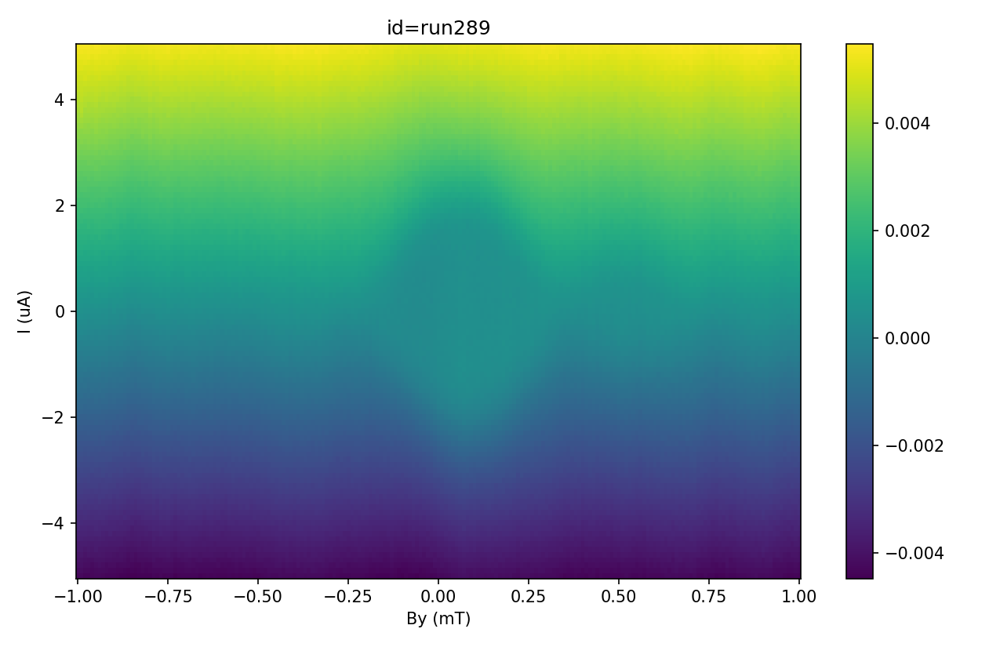

In [33]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8.5,5.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=200
Brange=800

# im = ax0.pcolormesh(By_49[Arange:Brange,:]/1e-3, I[Arange:Brange,:]/1e-6, Keithley1[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_289/1e-3, I_289/1e-6, V_289/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('id=run289')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 

fig.tight_layout()
#plt.grid()
plt.show()

In [41]:
saiz=np.shape(V_289)
# print(saiz)
Is_289=np.zeros(saiz[0])
Ir_289=np.zeros(saiz[0])
fV_289=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_289)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_289[i,45:55])
        if V_289[i,j]-DCoff > 3e-7:
            Is_289[i]=I_289[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_289[i,45:55])
        if -V_289[i,j]-DCoff < 0.3e-6:
            Ir_289[i]=I_289[i,j]
            break


<IPython.core.display.Javascript object>


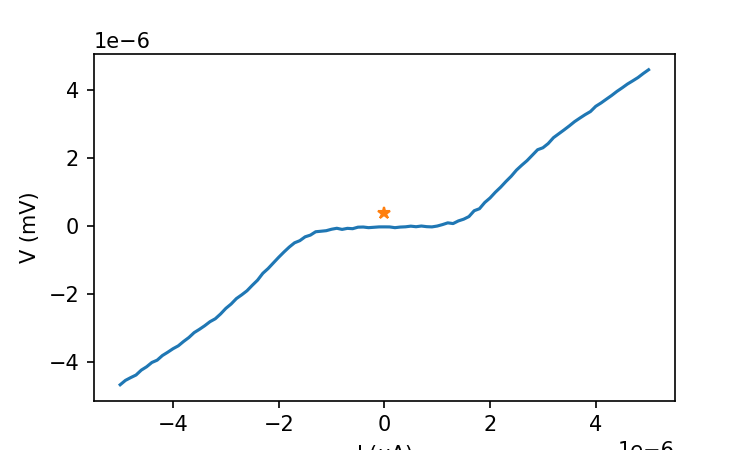

3.876746034e-07


In [38]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_289[50,45:55])
plt.plot(I_289[100,:],V_289[100,:]-DCoff)
# plt.plot(V_289[50,:])
plt.plot(I_289[50,50],DCoff, '*')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

# DCoff=np.mean(V_50[500,145:155])
print(DCoff)

<IPython.core.display.Javascript object>


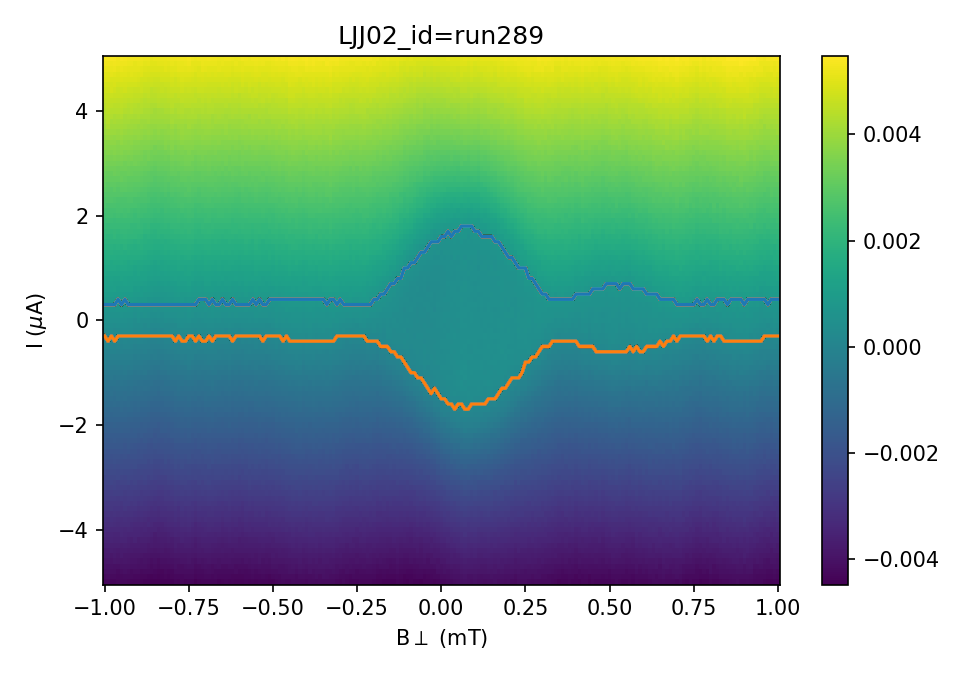

In [42]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=0
Brange=400

# im = ax0.pcolormesh(By_289[Arange:Brange,:]/1e-3, I_289[Arange:Brange,:]/1e-6, V_289[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
im = ax0.pcolormesh(By_289/1e-3, I_289/1e-6, V_289/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(V_289/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('LJJ02_id=run289')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot(By_289[Arange:Brange,:]/1e-3,Is_289[Arange:Brange]/1e-6)
plt.plot(By_289[Arange:Brange,:]/1e-3,Ir_289[Arange:Brange]/1e-6)

np.savetxt('Is_289.csv', (Is_289), fmt='%s', delimiter=',')
np.savetxt('Ir_289.csv', (Ir_289), fmt='%s', delimiter=',')

fig.tight_layout()
#plt.grid()
plt.show()

### Run 283 to 289 

<IPython.core.display.Javascript object>


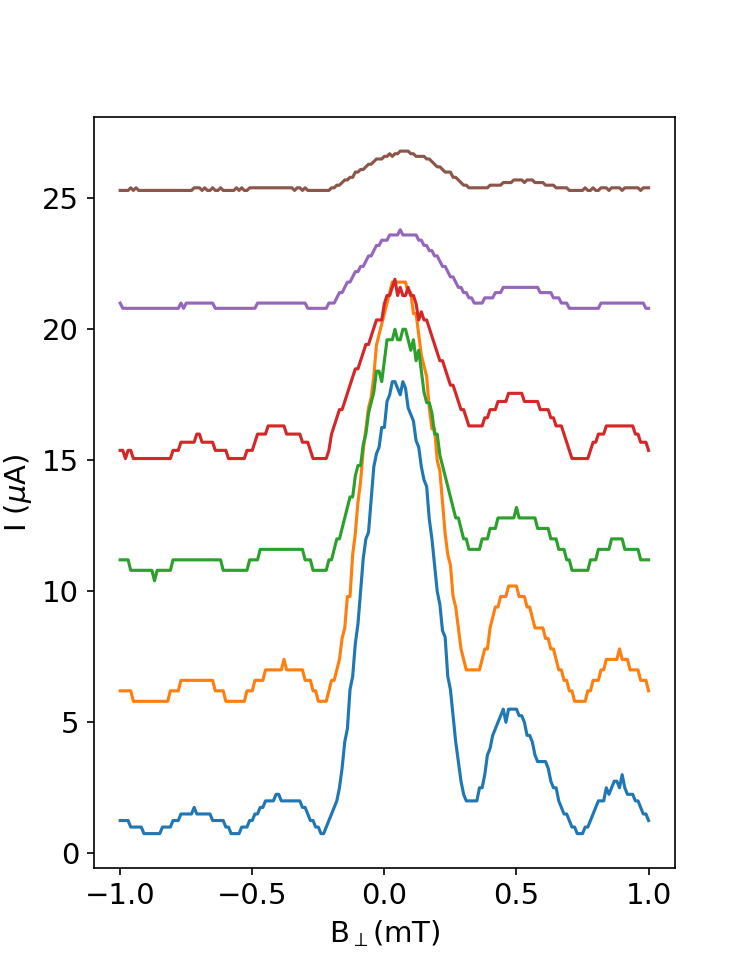

Text(0, 0.5, 'I ($\\mu$A)')

In [48]:
plt.figure(figsize=(5, 6.5))
# x=np.linspace(0,400,401)
plt.plot(By_283[:,1]/1e-3,Is_283[:]/1e-6,label='T=90 mK')
plt.plot(By_284[:,1]/1e-3,Is_284[:]/1e-6+5,label='T=137 mK')
plt.plot(By_285[:,1]/1e-3,Is_285[:]/1e-6+10,label='T=253 mK')
plt.plot(By_286[:,1]/1e-3,Is_286[:]/1e-6+15,label='T=350 mK')
plt.plot(By_288[:,1]/1e-3,Is_288[:]/1e-6+20,label='T=500 mK')
plt.plot(By_289[:,1]/1e-3,Is_289[:]/1e-6+25,label='T=700 mK')
# plt.plot(By_275[:,1]/1e-3+0.101,Is_275[:]/1e-6+0,label='B$_{\parallel}$0 mT')
plt.rcParams.update({'font.size': 14})
# plt.plot(((x-11)*6e-6+By_218[0,1])/1e-3,Is_218[:]/1e-6)
# plt.plot((-x*6e-6+By_219[0,1])/1e-3,np.abs(Ir_219[:]/1e-6),'-b')

# plt.plot(I_218[211,40:121]/1e-6,(V_218[211,40:121]-V_218[211,40])/1e-3)
# plt.plot(-(I_219[200,40:121])/1e-6,np.abs(V_219[200,40:121]-V_219[200,40])/1e-3)
plt.xlabel('B$_\perp$(mT)')
plt.ylabel('I ($\mu$A)')
# plt.legend(loc='upper left')

# Sample 013 dev3

## Run 8 IV_By

In [ ]:
By_8=By_field
I_8=I
V_8=Keithley1
R_8=R_DC1

In [ ]:
fig, (ax0,ax1) = plt.subplots(nrows=2, figsize=(8.5,5))
# fig, (ax0) = plt.subplots(nrows=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)

im = ax0.pcolormesh(By_8/1e-3, I_8/1e-6, V_8, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax0)
ax0.set_title('013 id=8')
ax0.set(xlabel='By ($m$T)', ylabel='I ($\mu$A)') 

im = ax1.pcolormesh((By_8*np.sin(0.028))/1e-3, I_8/1e-6, V_8, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax1)
ax1.set_title('013 id=8 after correction')
ax1.set(xlabel='B$\perp$ ($m$T)', ylabel='I ($\mu$A)') 

fig.tight_layout()
#plt.grid()
plt.show()

## Run 9 IV_By

In [ ]:
By_9=By_field
I_9=I
V_9=Keithley1
R_9=R_DC1

In [ ]:
fig, (ax0,ax1) = plt.subplots(nrows=2, figsize=(8.5,5))
# fig, (ax0) = plt.subplots(nrows=1, figsize=(8.5,5))
fig.subplots_adjust(hspace=55)

im = ax0.pcolormesh(By_9/1e-3, I_9/1e-6, V_9, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax0)
ax0.set_title('013 id=9')
ax0.set(xlabel='By ($m$T)', ylabel='I ($\mu$A)') 

im = ax1.pcolormesh((By_9*np.sin(0.023595))/1e-3, I_9/1e-6, V_9, cmap = 'viridis')#, vmin=0, vmax=200)
fig.colorbar(im, ax=ax1)
ax1.set_title('013 id=9 after correction')
ax1.set(xlabel='B$\perp$ ($m$T)', ylabel='I ($\mu$A)') 

fig.tight_layout()
#plt.grid()
plt.show()

In [ ]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=1162
Brange=1371

im = ax0.pcolormesh((By_9[Arange:Brange,:]*np.sin(0.023595))/1e-3, I_9[Arange:Brange,:]/1e-6, V_9[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('013_id=run9 corrected')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

In [ ]:
(By_9[Arange,0]*np.sin(0.023595))-(By_9[Brange,0]*np.sin(0.023595))

In [ ]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=500
Brange=2000

im = ax0.pcolormesh((By_9[Arange:Brange,:]*np.sin(0.023595))/1e-3, I_9[Arange:Brange,:]/1e-6, V_9[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('013_id=run9 corrected')
ax0.set(xlabel='By (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()

### Ic analysis run9

In [ ]:
saiz=np.shape(V_9)
print(saiz)

In [ ]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
DCoff=np.mean(V_9[1035,95:105])
plt.plot(I_9[1035,:],V_9[1035,:]-DCoff)
plt.xlabel('I ($\mu$A)')
plt.ylabel('V (mV)')

DCoff=np.mean(V_9[1035,95:105])
print(DCoff)

In [ ]:
Is_9=np.zeros(saiz[0])
Ir_9=np.zeros(saiz[0])
fV_9=np.zeros((saiz[0],saiz[1]))
saiz=np.shape(V_9)
for i in range(saiz[0]):
    for j in range(1,saiz[1]):
        DCoff=np.mean(V_9[i,95:105])
        if V_9[i,j]-DCoff > 0.5e-5:
            Is_9[i]=I_9[i,j]
            break
    
#     fV_9[i,:]=np.flip(V_9[i,:], 0)
    for j in range(1,saiz[1]):
        DCoff=np.mean(-V_9[i,95:105])
        if -V_9[i,j]-DCoff < 0.5e-5:
            Ir_9[i]=I_9[i,j]
            break

In [ ]:
plt.figure(figsize=(8, 3))
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
# plt.plot(By_9[:,0],Is_9)
# plt.plot(Is_9[Arange:Brange])
# plt.plot(Ir_9[Arange:Brange])
plt.plot(Is_9[:])
plt.plot(Ir_9[:])
# plt.xlabel('By (mT)')
# plt.ylabel('V (mV)')


In [ ]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(6.5,4.5))
fig.subplots_adjust(hspace=55)
# cmap = plt.get_cmap('hot')

Arange=1200
Brange=1300

im = ax0.pcolormesh((By_9[Arange:Brange,:]*np.sin(0.028))/1e-3, I_9[Arange:Brange,:]/1e-6, V_9[Arange:Brange,:]/1e-3, cmap = 'viridis')#, vmax=100,vmin=0)
# im = ax0.pcolormesh(Bx_24/1e-3, I_24/1e-6, V_24/1e-3, cmap = 'viridis')#, vmax=1
fig.colorbar(im, ax=ax0)
ax0.set_title('013_id=run9 corrected')
ax0.set(xlabel='B$\perp$ (mT)', ylabel='I ($\mu$A)') 

plt.plot((By_9[Arange:Brange,:]*np.sin(0.028))/1e-3,Is_9[Arange:Brange]/1e-6)
plt.plot((By_9[Arange:Brange,:]*np.sin(0.028))/1e-3,Ir_9[Arange:Brange]/1e-6)


fig.tight_layout()
#plt.grid()
plt.show()

In [ ]:
## Find the phase offset
plt.figure(figsize=(5, 3.5))
Arange=1200
Brange=1300
plt.plot((By_9[Arange:Brange,:]*np.sin(0.028))/1e-3,Is_9[Arange:Brange])
plt.plot((By_9[Arange:Brange,:]*np.sin(0.028))/1e-3,-Ir_9[Arange:Brange])
# plt.plot(Is_9[:])
# plt.plot(Ir_9[:])
plt.xlabel('B$\perp$ (mT)')
plt.ylabel('I ($\mu$A)')


In [ ]:
np.savetxt('By_9.csv', (By_9*np.sin(0.028)), fmt='%s', delimiter=',')
np.savetxt('Is_9.csv', (Is_9), fmt='%s', delimiter=',')
np.savetxt('Ir_9.csv', (Ir_9), fmt='%s', delimiter=',')

# fitting to Ic value

In [ ]:
# Ref : https://iopscience.iop.org/article/10.1088/0031-8949/2015/T164/014002/pdf

B=(np.linspace(0,10,2501)-5)
# A=(np.linspace(0,2000,5001)-1000)
I1_0=1
I2_0=1

I_test=np.abs((I1_0*np.sin(B)/B-I2_0*np.sin(B)/B)**2+4*(((I1_0*np.sin(B)/B)*(I2_0*np.sin(B)/B))*np.cos(50*B)))**0.5
# I=np.abs((I1_0*np.sin(B)/B-I2_0*np.sin(B)/B)**2+4*(((I1_0*np.sin(B)/B)*(I2_0*np.sin(B)/B))*np.cos(50*B)))**0.5

In [ ]:
## Find the phase offset
plt.figure(figsize=(8.5, 3.5))

plt.plot(B,I_test)
# plt.xlabel('B$\perp$ (mT)')
# plt.ylabel('I (uA)')

In [ ]:
print(I)

In [ ]:
# Ref : https://iopscience.iop.org/article/10.1088/0031-8949/2015/T164/014002/pdf

B=(np.linspace(0,4,2501)-2)
# A=(np.linspace(0,2000,5001)-1000)
I1_0=1e-6
I2_0=0.1e-6

I=np.abs((I1_0*np.sin(B)/B-I2_0*np.sin(B)/B)**2+4*(((I1_0*np.sin(B)/B)*(I2_0*np.sin(B)/B))*np.cos(50*B)))**0.5

In [ ]:
## Find the phase offset
plt.figure(figsize=(8.5, 3.5))

plt.plot(B,I)
# plt.xlabel('B$\perp$ (mT)')
# plt.ylabel('I (uA)')


In [ ]:
# For Dev 2(012) fraunhofer period 201.25 uT and SQUID is 6.06 uT
# so the ratio of period should be 201.25/6.06~33.21

In [ ]:
# I=np.abs((I1_0*np.sin(B)/B-I2_0*np.sin(B)/B)**2+4*((I1_0*np.sin(B)/B*I2_0*np.sin(B)/B)*np.cos(50*B)))**0.5
def fun(x, a, b, c, d):
    return np.abs((a*np.sin(c*x)/c*x-b*np.sin(c*x)/c*x)**2+4*(((a*np.sin(c*x)/c*x)*(b*np.sin(c*x)/c*x))*np.cos(50*x)))**0.5+d


def func(x, a, b, d):
#     return np.abs((a*np.abs(np.sin(x)/x)-b*np.abs(np.sin(x)/x))**2+4*(((a*np.abs(np.sin(x)/x))*(b*np.abs(np.sin(x)/x))*np.cos(x*33.4))))**0.5+d
    return np.abs(((a*np.sin(x)/x)-b*(np.sin(x)/x))**2+4*(((a*(np.sin(x)/x))*(b*(np.sin(x)/x))*np.cos(x*33.4))))**0.5+d

def func2(x, a, d):
    return np.abs((a*np.abs(np.sin(x)/x)-(((Imax/2)**2)/a)*np.abs(np.sin(x)/x))**2+\
                  4*(((a*np.abs(np.sin(x)/x))*((((Imax/2)**2)/a)*np.abs(np.sin(x)/x))*np.cos(x*33.4))))**0.5+d

In [ ]:
Imax=max(ydata)
print(Imax)

In [ ]:
plt.figure(figsize=(8.5, 3.5))
B=(np.linspace(0,10,2501)-5)
# plt.plot(-(By_23[0:1251,0]-0.00582)/1e-3,(Is_23[0:1251]-7e-8)/1e-6)
plt.plot(-B[0:1251],(Is_23[0:1251]-7e-8)/1e-6)

In [ ]:
B=(np.linspace(0,10,2501)-5)
xdata=-B[900:1250]
ydata=(Is_23[900:1250])/1e-6
Imax=max(ydata)
# xdata=B[2501:5001]
# ydata=I_test[2501:5001]

poptc,pcovc= optimize.curve_fit(func,xdata,ydata, bounds=((0.36,0.36,-np.inf), (np.inf,np.inf,np.inf)))
# printopt (pcovc)
print(poptc)

In [ ]:
# Ref : https://iopscience.iop.org/article/10.1088/0031-8949/2015/T164/014002/pdf

# B=(np.linspace(0.1,5,450))
B=xdata
# A=(np.linspace(0,2000,5001)-1000)
I1_0=poptc[0]
I2_0=poptc[1]


# I=np.abs(((I1_0*np.sin(popt[2]*B)/popt[2]*B)-(I2_0*np.sin(popt[2]*B)/popt[2]*B))**2+4*(((I1_0*np.sin(popt[2]*B)/popt[2]*B)*(I2_0*np.sin(popt[2]*B)/(popt[2]*B)))*np.cos(popt[3]*B)))**0.5

I2=np.abs(((I1_0*np.sin(B)/B)-(I2_0*np.sin(B)/B))**2+\
          4*(((I1_0*np.sin(B)/B)*(I2_0*np.sin(B)/B))*np.cos(B*33.1)))**0.5

plt.figure(figsize=(5.5, 3.5))

plt.plot(B,I2)
plt.plot(xdata, ydata)
plt.legend(['fit','data'])
# plt.plot(Bper_23/1e-3,Is_23/1e-6)